In [27]:
import torch
import numpy as np
from torch import nn
import torch.optim as optim
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader,random_split
import wandb
from sklearn.metrics import classification_report,confusion_matrix

# 4.1

In [2]:
# Load MNIST dataset
transform = transforms.Compose([transforms.ToTensor()])
mnist_train = datasets.MNIST(
    root='./data', 
    train=True, 
    transform=transform, 
    download=True
)
mnist_test = datasets.MNIST(
    root='./data', 
    train=False, 
    transform=transform, 
    download=True
)
labels = mnist_train.targets

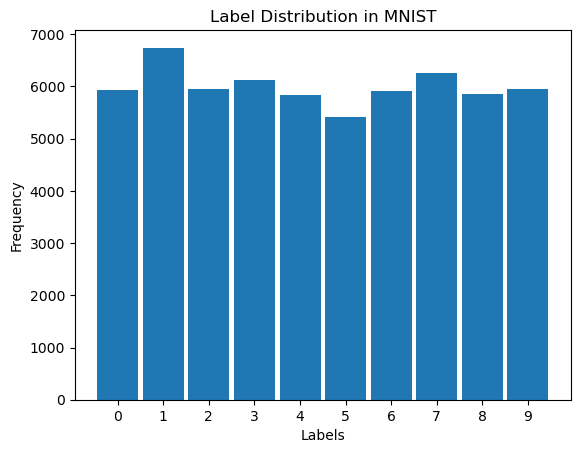

In [3]:
# Plot the label distribution
plt.hist(labels, range(11), rwidth=0.9, align='left')
plt.xlabel('Labels')
plt.ylabel('Frequency')
plt.title('Label Distribution in MNIST')
plt.xticks(range(10))
plt.show()

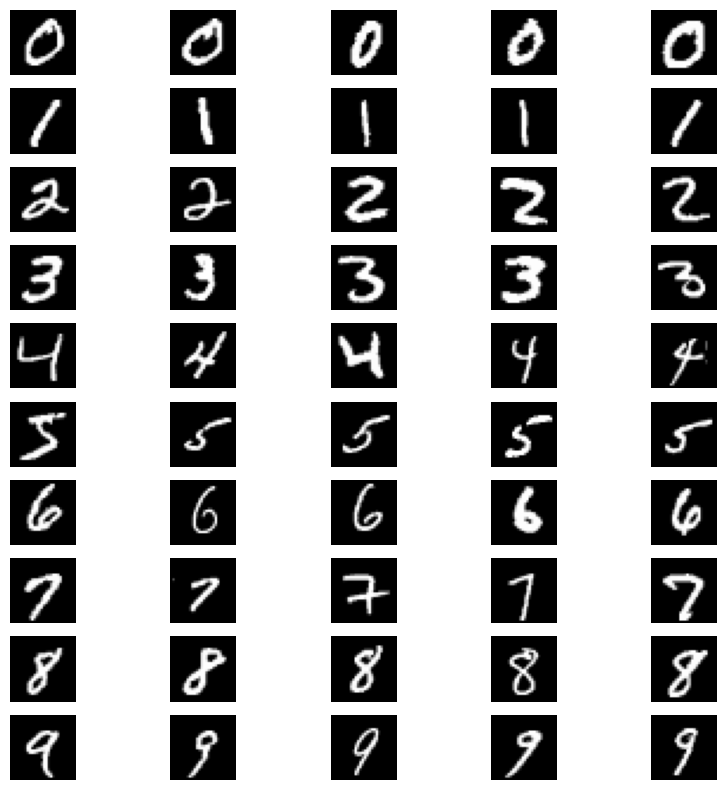

In [4]:
import random

# Create a dictionary to store image samples for each class
samples_per_class = {}
for i in range(10):
    samples_per_class[i] = []

# Collect 5 samples from each class
for i in range(len(mnist_train)):
    image, label = mnist_train[i]
    if len(samples_per_class[label]) < 5:
        samples_per_class[label].append(image)

# Display the samples
fig, axs = plt.subplots(10, 5, figsize=(10, 10))
for i in range(10):
    for j in range(5):
        axs[i, j].imshow(samples_per_class[i][j].squeeze(0), cmap='gray')
        axs[i, j].axis('off')
plt.show()


In [5]:
train_dataset_mnist, val_dataset_mnist = random_split(mnist_train, [len(mnist_train) - 20000, 20000])
train_loader = DataLoader(train_dataset_mnist,batch_size = 64,shuffle = True)
val_loader = DataLoader(val_dataset_mnist,batch_size = 64,shuffle = True)
test_loader = DataLoader(mnist_test,batch_size = 64,shuffle = True)

In [6]:
def visualize_feature_maps(model, image, label):
    print('Original Image')
    plt.imshow(image.squeeze(0), cmap = 'gray')
    plt.show()
    
    # Forward pass
    with torch.no_grad():
        maps_conv, maps_activation, maps_pooling, prob = model.feature_maps(image)
    
    for layer in range(len(maps_conv)):
        # Display the samples
        print(f"Feature maps of Convo layer {layer+1}")
        num_of_filters = maps_conv[layer].shape[0]
        fig = plt.figure(figsize=(8, 8))
        columns = int(np.sqrt(num_of_filters))
        rows = int(np.sqrt(num_of_filters))
        for i in range(1, columns*rows +1):
            img = maps_conv[layer][i-1]
            fig.add_subplot(rows, columns, i)
            plt.imshow(img, cmap = 'gray')
        plt.show()
        
        print(f"Feature maps of Activation layer {layer+1}")
        fig = plt.figure(figsize=(8, 8))
        columns = int(np.sqrt(num_of_filters))
        rows = int(np.sqrt(num_of_filters))
        for i in range(1, columns*rows +1):
            img = maps_activation[layer][i-1]
            fig.add_subplot(rows, columns, i)
            plt.imshow(img, cmap = 'gray')
        plt.show()
        
        print(f"Feature maps of Pooling layer {layer+1}")
        fig = plt.figure(figsize=(8, 8))
        columns = int(np.sqrt(num_of_filters))
        rows = int(np.sqrt(num_of_filters))
        for i in range(1, columns*rows +1):
            img = maps_pooling[layer][i-1]
            fig.add_subplot(rows, columns, i)
            plt.imshow(img, cmap='gray')
        plt.show()
        
    print(f"Predicted Class: {torch.argmax(prob)}, Actual Class: {label}")

#         plt.imshow(feature_map, cmap='viridis')
#     plt.show()


# 4.2

In [12]:
class CNN(nn.Module):
    def __init__(self,c_in, img_dim,dropout, num_classes=10, kernel1 = 3, kernel2 = 3):
        super(CNN, self).__init__()
#         image shape (N,c_in,dim,dim)
        kernel1 -= 1
        kernel2 -= 1
        self.conv1 = nn.Conv2d(c_in, 32, kernel_size=kernel1+1) # (N,c_out, dim-kernel1,dim-kernel1)
        self.relu1 = nn.ReLU()
        self.maxpool1 = nn.MaxPool2d(kernel_size=2) # (N,c_out, dim-kernel1 // 2,dim-kernel1 // 2)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=kernel2+1) # (N,c_out2, dim-kernel1 // 2 - kernel2,dim-kernel1 // 2 - kernel2)
        self.relu2 = nn.ReLU()
        self.maxpool2 = nn.MaxPool2d(kernel_size=2) # (N,c_out2, (((dim-kernel1) // 2) - kernel2) // 2,(((dim-kernel1) // 2) - kernel2) // 2)
        self.dropout = nn.Dropout2d(dropout)
        last_dim = (((img_dim-kernel1) // 2) - kernel2) // 2
        self.fc1 = nn.Linear(64 *last_dim*last_dim, num_classes)
        self.smax = nn.Softmax(dim=1)

    def forward(self, x):
        x = self.conv1(x)
        x = self.relu1(x)
        x = self.maxpool1(x)
        x = self.conv2(x)
        x = self.relu2(x)
        x = self.maxpool2(x)
        x = self.dropout(x)
        x = x.reshape(x.size(0), -1)
        x = self.fc1(x)
#         x = self.smax(x)
        return x
    
    def feature_maps(self, image):
        maps_conv = []
        maps_activation = []
        maps_pooling = []
        maps_conv1 = self.conv1(image)
        maps_conv.append(maps_conv1)
        maps_relu1 = self.relu1(maps_conv1)
        maps_activation.append(maps_relu1)
        maps_maxpool1 = self.maxpool1(maps_relu1)
        maps_pooling.append(maps_maxpool1)
        maps_conv2 = self.conv2(maps_maxpool1)
        maps_conv.append(maps_conv2)
        maps_relu2 = self.relu2(maps_conv2)
        maps_activation.append(maps_relu2)
        maps_maxpool2 = self.maxpool2(maps_relu2)
        maps_pooling.append(maps_maxpool2)
        x = self.dropout(maps_maxpool2.unsqueeze(0))
        x = x.reshape(x.size(0), -1)
        x = self.fc1(x)
        class_prob = self.smax(x)[0]
        return maps_conv,maps_activation, maps_pooling, class_prob

In [13]:
# Instantiate the model
model = CNN(1,28,0.5)

# Define loss and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

num_epochs = 10
train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []

for epoch in range(num_epochs):
    # Training loop
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    loss = 0
    idx = 0
    for images, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        idx += 1

        running_loss += loss.item()
        
    print(f'Epoch {epoch + 1}/{num_epochs}, Train Loss: {loss:.4f}')

    # Validation
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    loss = 0
    idx = 0
    accuracy = 0

    with torch.no_grad():
        for images, labels in val_loader:
            outputs = model(images)
            predicted = torch.argmax(outputs, dim = 1)
            correct = torch.sum(torch.where(predicted == labels,1.0,0.0))
            loss = criterion(outputs, labels)
            idx += 1
            accuracy += correct / images.shape[0]
    print(f'Epoch {epoch + 1}/{num_epochs}, Val Loss: {loss:.4f}')
    print(f'Epoch {epoch + 1}/{num_epochs}, Val Accuracy: {accuracy / len(val_loader):.4f}')

Epoch 1/10, Train Loss: 0.0629
Epoch 1/10, Val Loss: 0.0208
Epoch 1/10, Val Accuracy: 0.9699
Epoch 2/10, Train Loss: 0.0743
Epoch 2/10, Val Loss: 0.0446
Epoch 2/10, Val Accuracy: 0.9771
Epoch 3/10, Train Loss: 0.1264
Epoch 3/10, Val Loss: 0.1947
Epoch 3/10, Val Accuracy: 0.9787
Epoch 4/10, Train Loss: 0.1596
Epoch 4/10, Val Loss: 0.0032
Epoch 4/10, Val Accuracy: 0.9829
Epoch 5/10, Train Loss: 0.0521
Epoch 5/10, Val Loss: 0.0027
Epoch 5/10, Val Accuracy: 0.9849
Epoch 6/10, Train Loss: 0.0740
Epoch 6/10, Val Loss: 0.3025
Epoch 6/10, Val Accuracy: 0.9854
Epoch 7/10, Train Loss: 0.0999
Epoch 7/10, Val Loss: 0.0059
Epoch 7/10, Val Accuracy: 0.9858
Epoch 8/10, Train Loss: 0.0231
Epoch 8/10, Val Loss: 0.0156
Epoch 8/10, Val Accuracy: 0.9861
Epoch 9/10, Train Loss: 0.0133
Epoch 9/10, Val Loss: 0.0025
Epoch 9/10, Val Accuracy: 0.9852
Epoch 10/10, Train Loss: 0.0623
Epoch 10/10, Val Loss: 0.0333
Epoch 10/10, Val Accuracy: 0.9874


torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


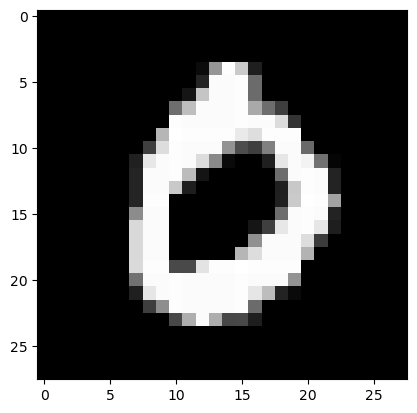

Feature maps of Convo layer 1


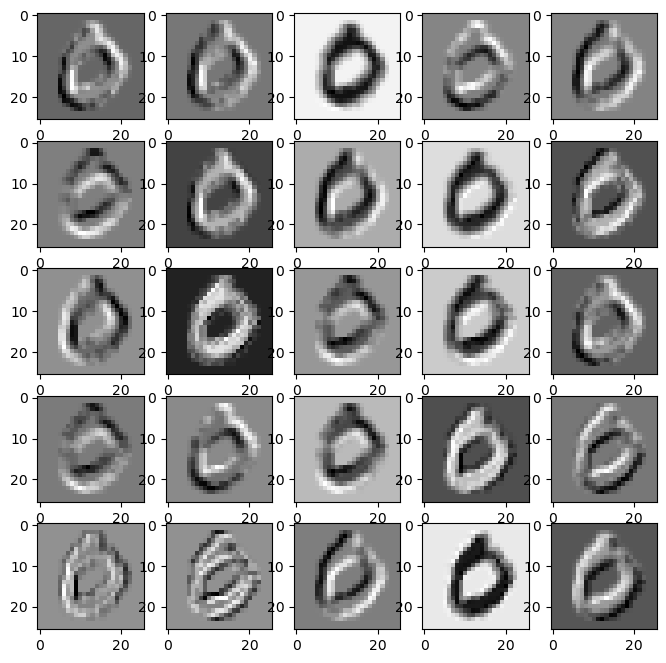

Feature maps of Activation layer 1


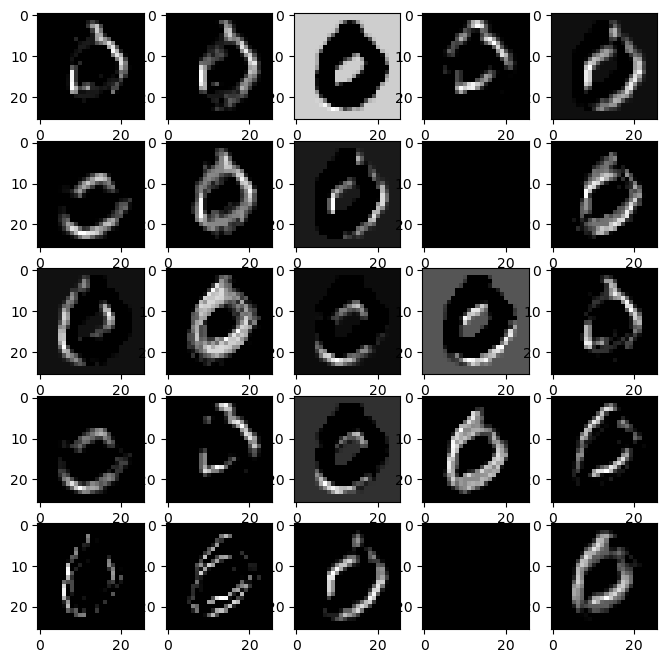

Feature maps of Pooling layer 1


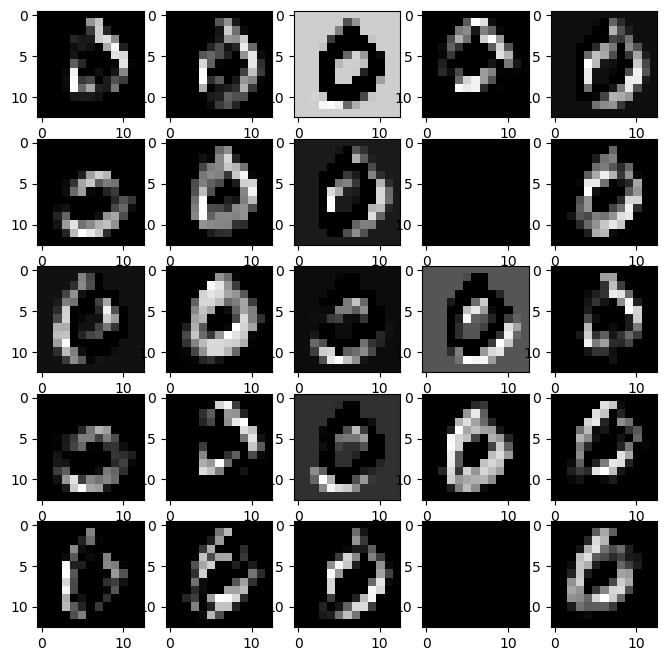

Feature maps of Convo layer 2


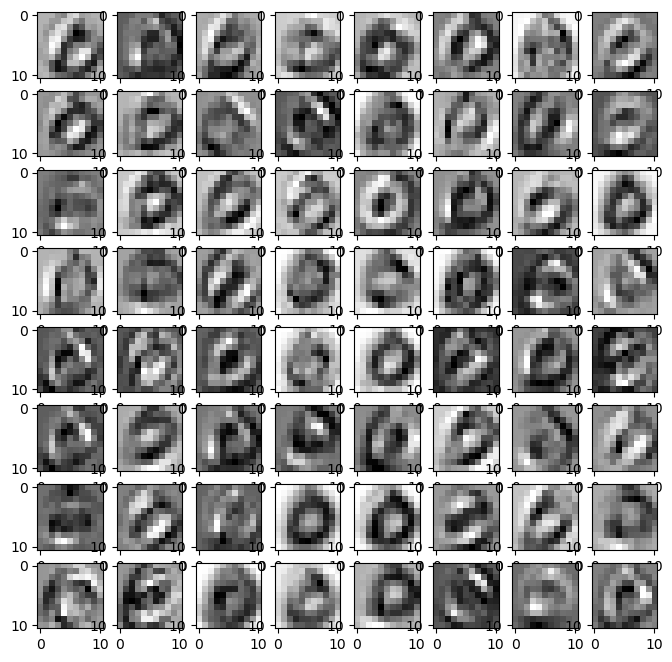

Feature maps of Activation layer 2


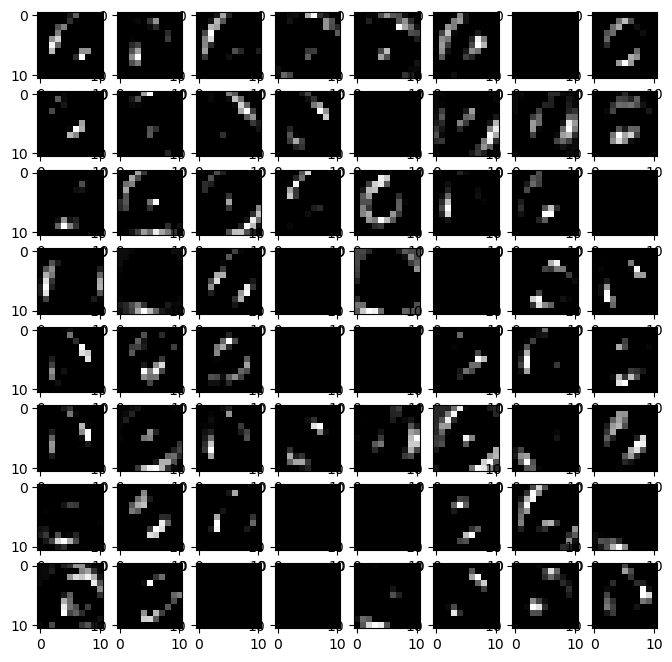

Feature maps of Pooling layer 2


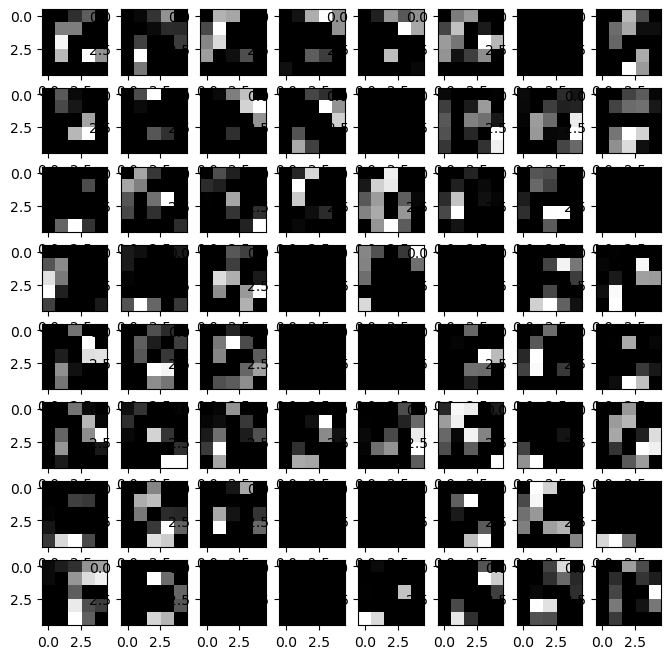

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


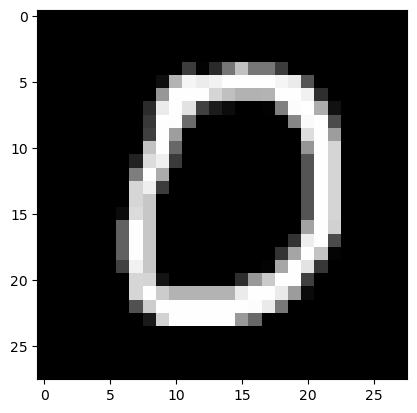

Feature maps of Convo layer 1


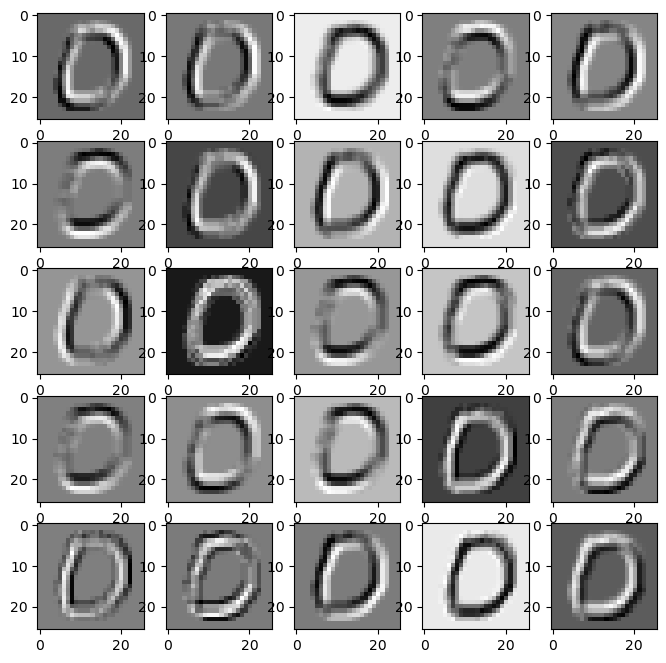

Feature maps of Activation layer 1


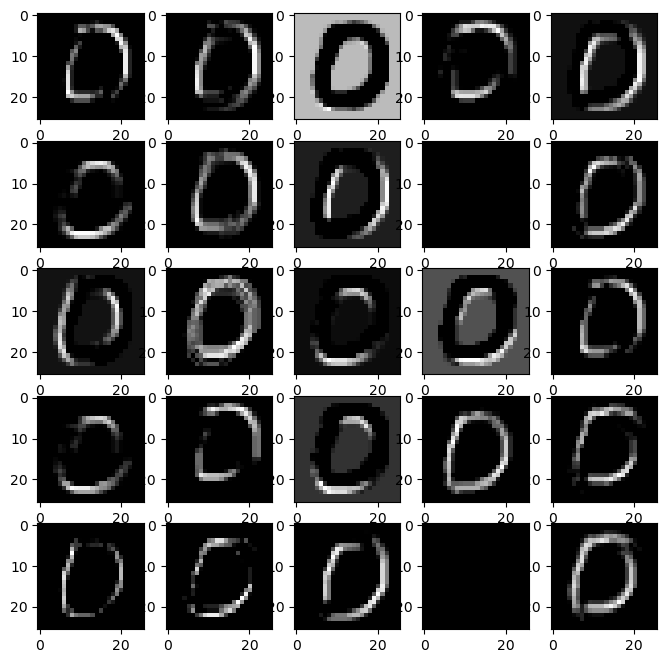

Feature maps of Pooling layer 1


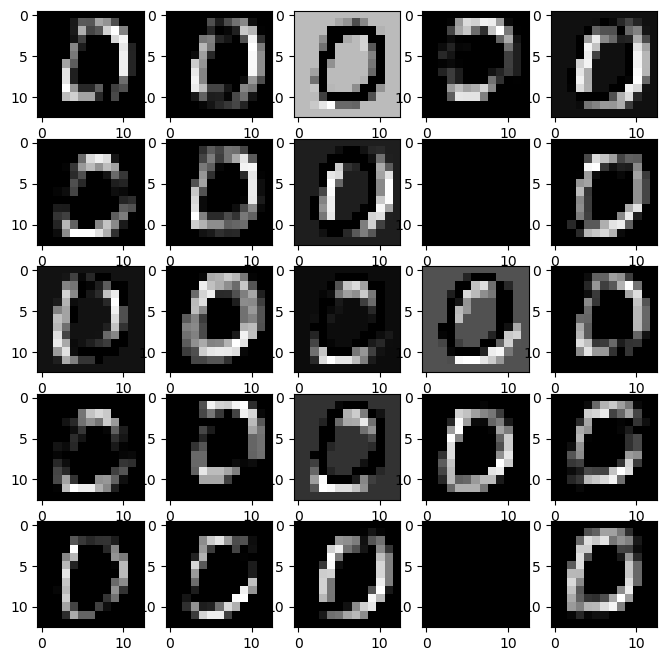

Feature maps of Convo layer 2


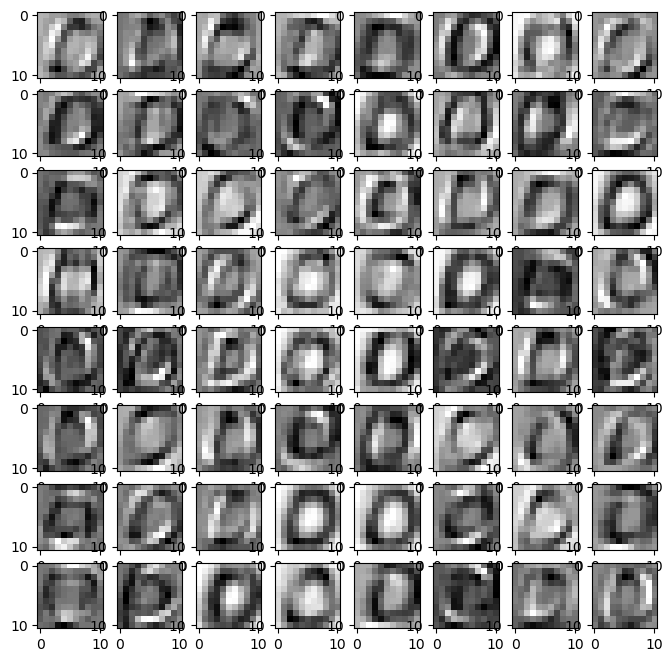

Feature maps of Activation layer 2


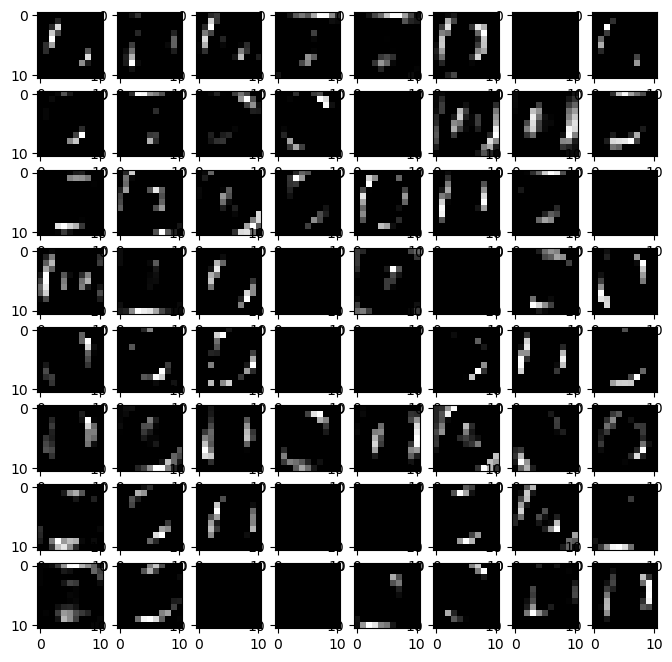

Feature maps of Pooling layer 2


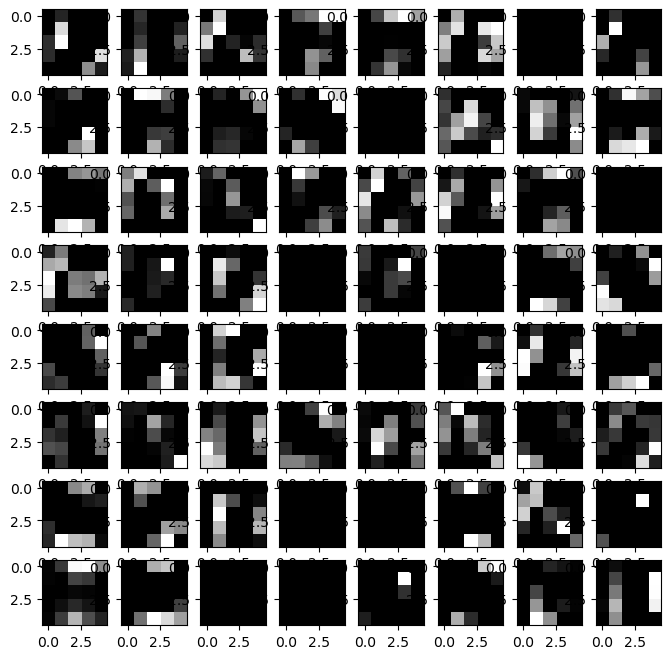

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


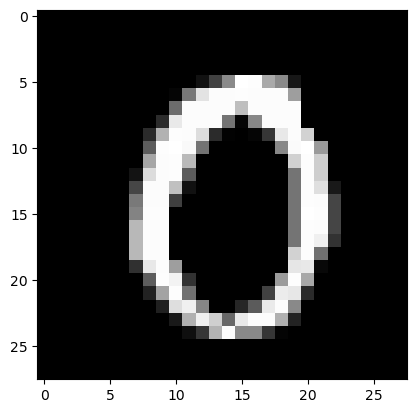

Feature maps of Convo layer 1


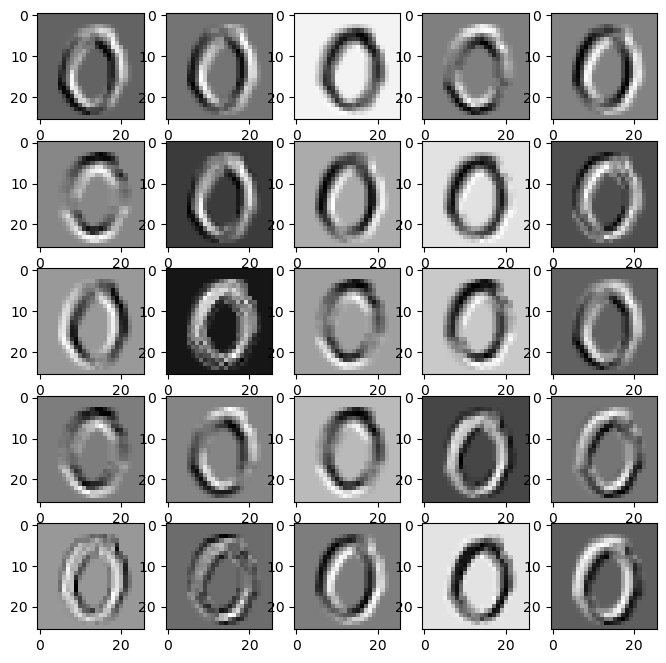

Feature maps of Activation layer 1


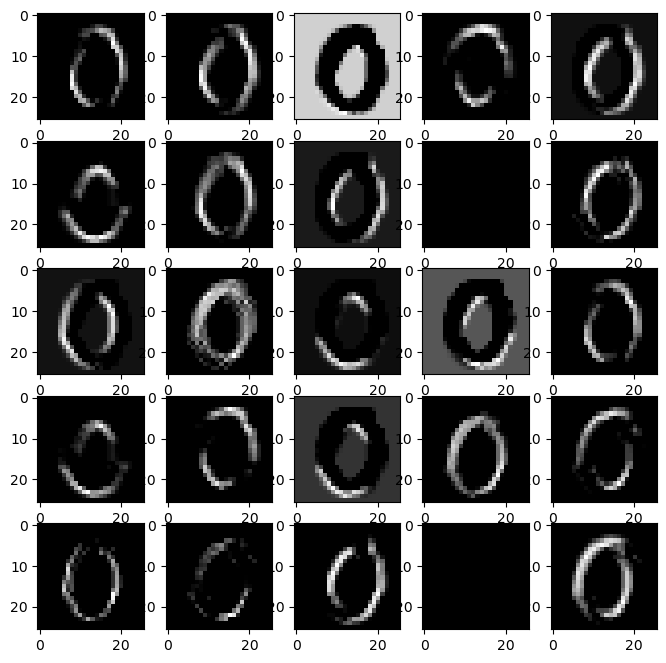

Feature maps of Pooling layer 1


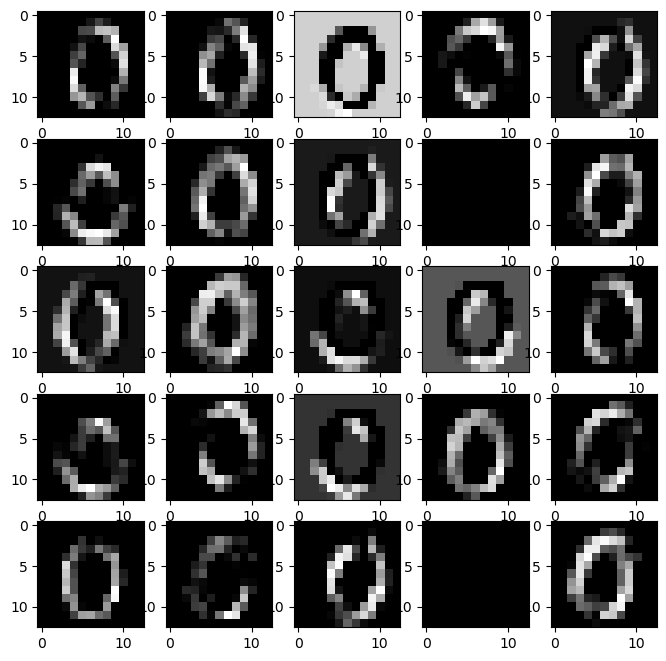

Feature maps of Convo layer 2


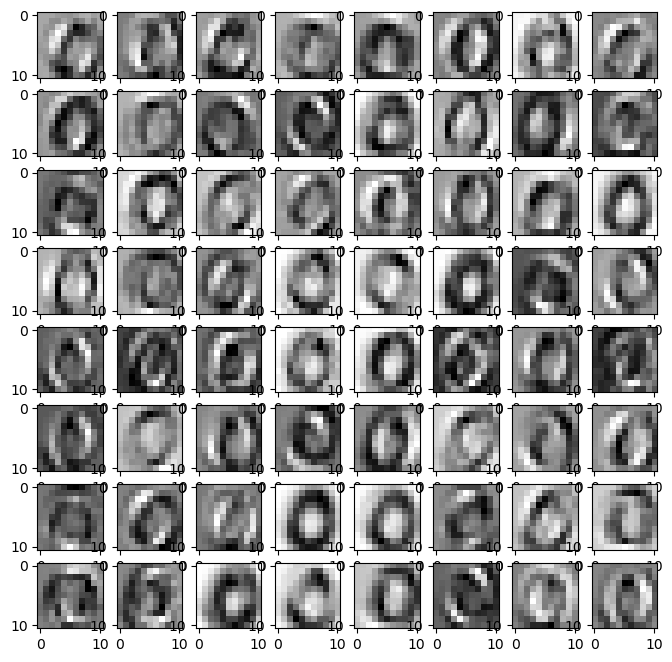

Feature maps of Activation layer 2


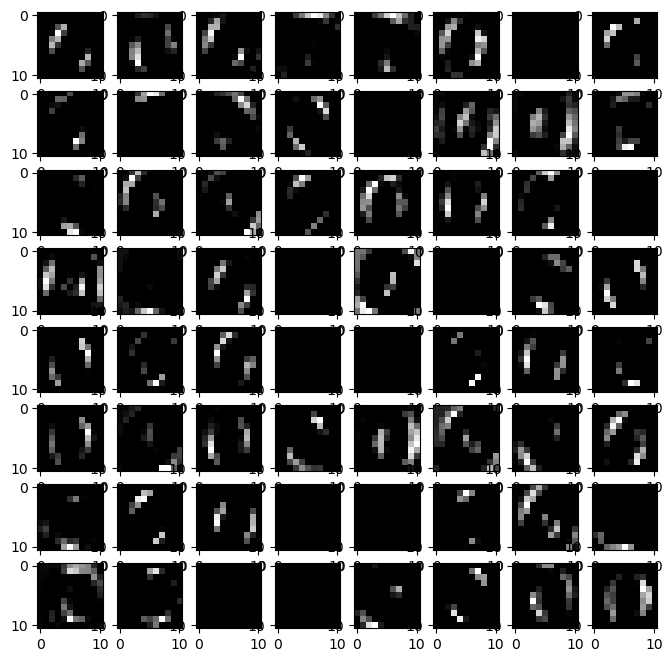

Feature maps of Pooling layer 2


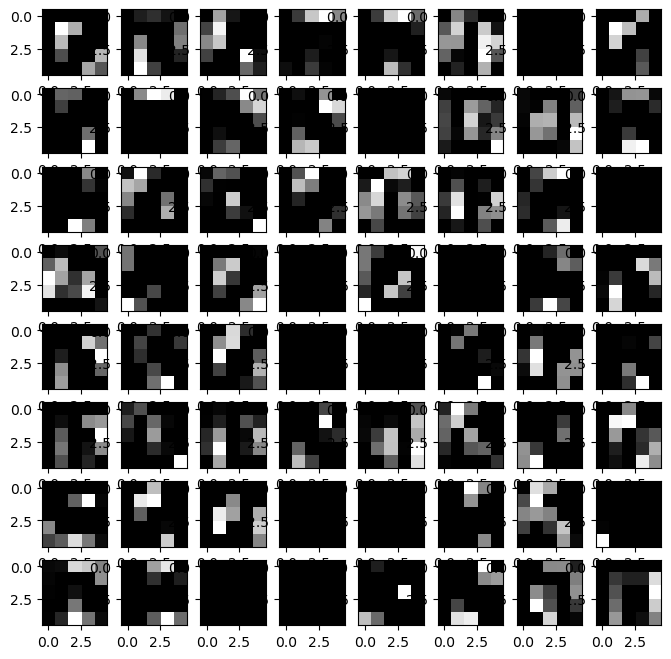

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


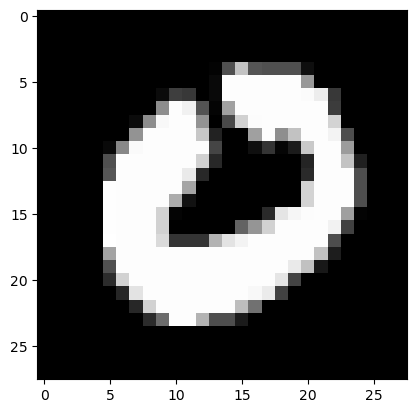

Feature maps of Convo layer 1


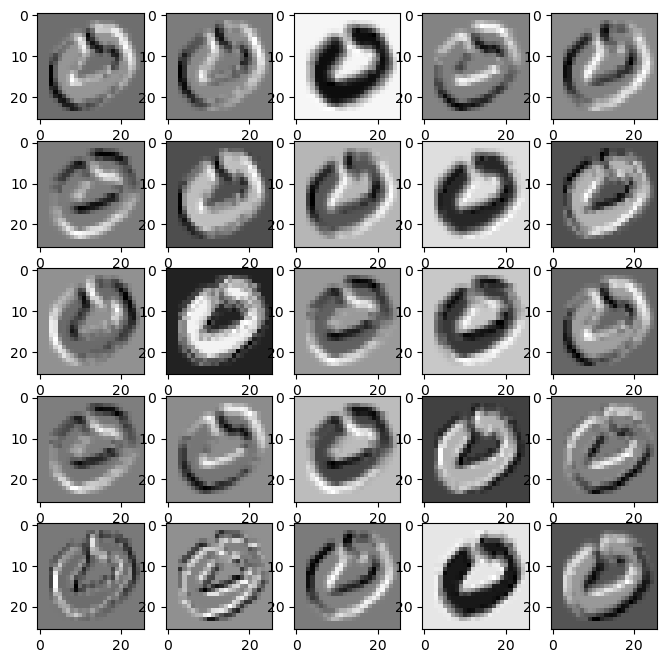

Feature maps of Activation layer 1


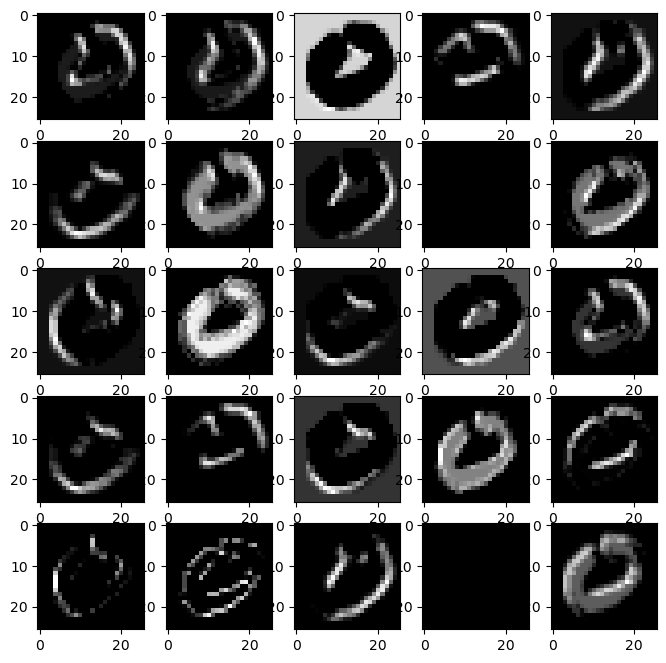

Feature maps of Pooling layer 1


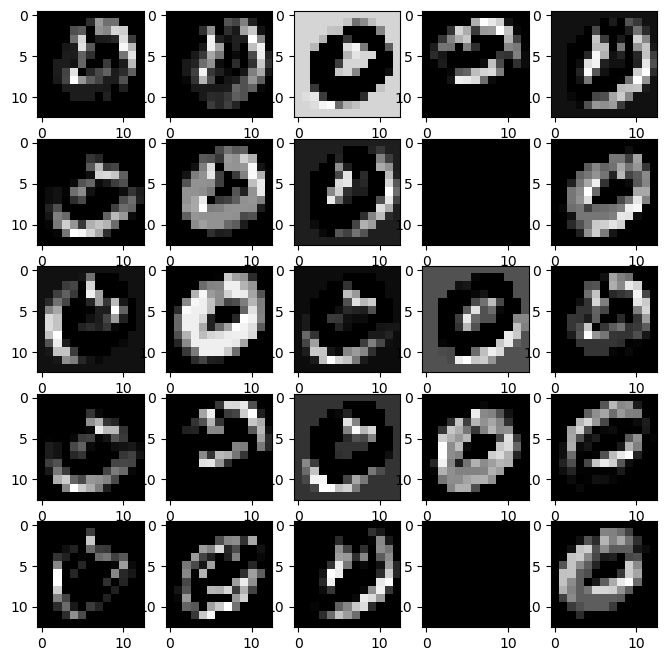

Feature maps of Convo layer 2


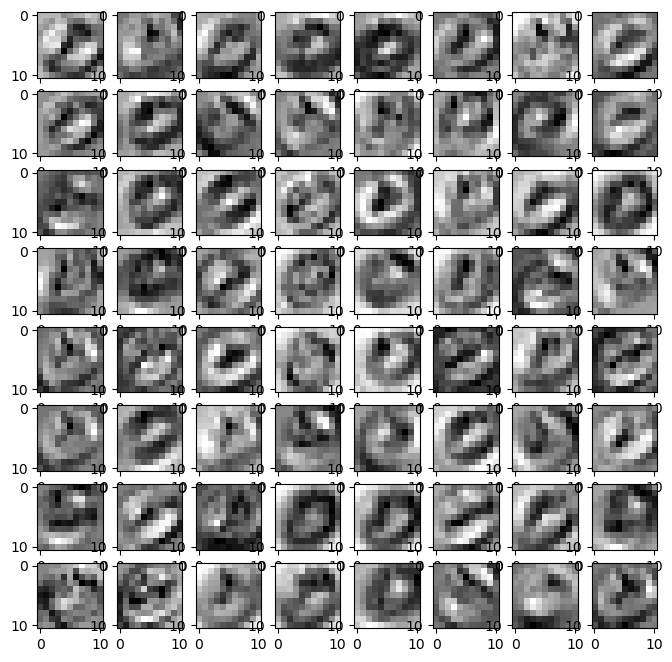

Feature maps of Activation layer 2


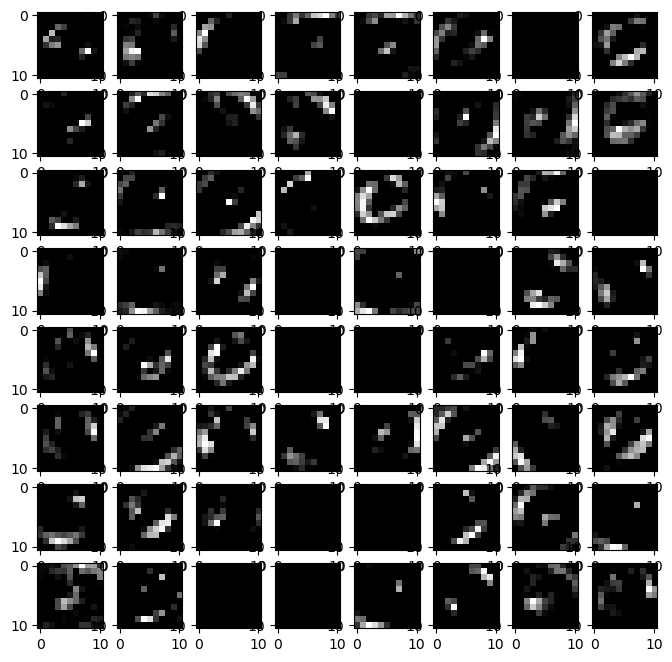

Feature maps of Pooling layer 2


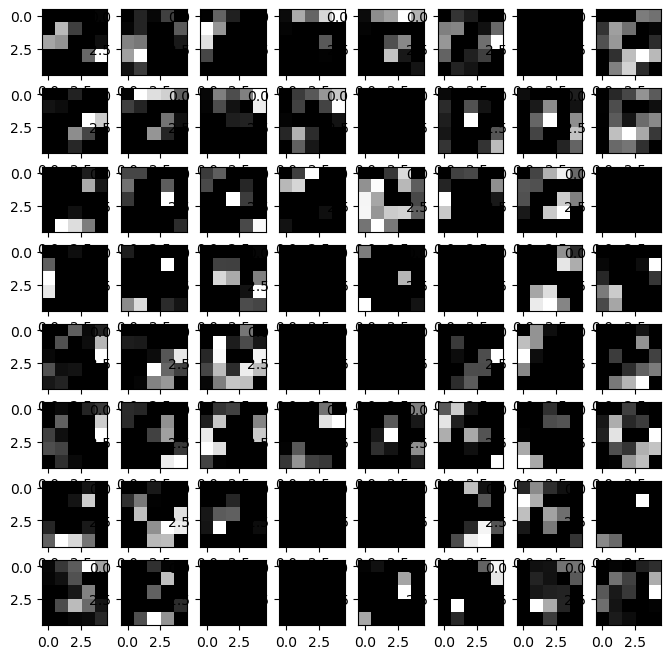

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


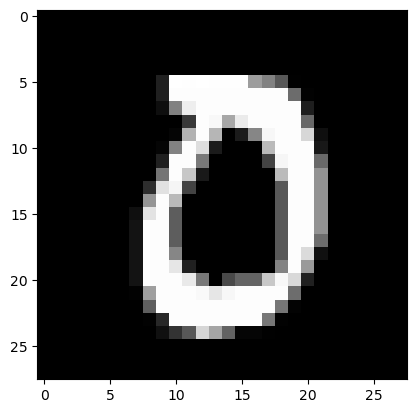

Feature maps of Convo layer 1


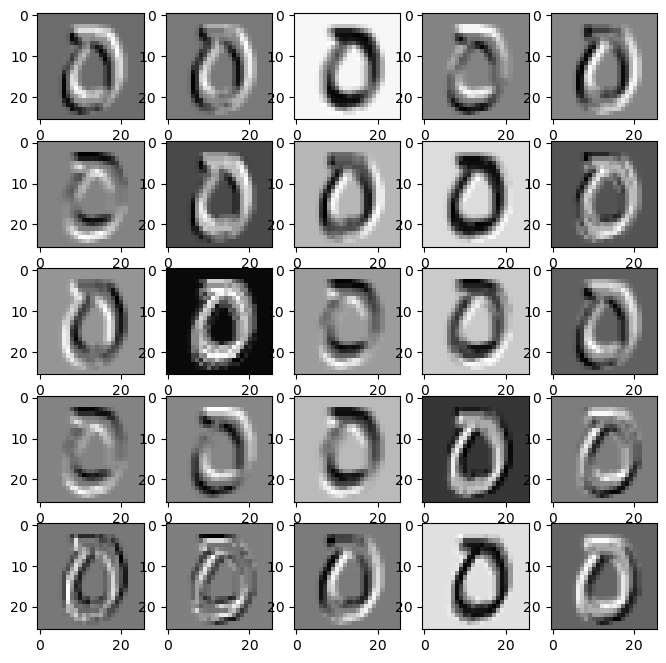

Feature maps of Activation layer 1


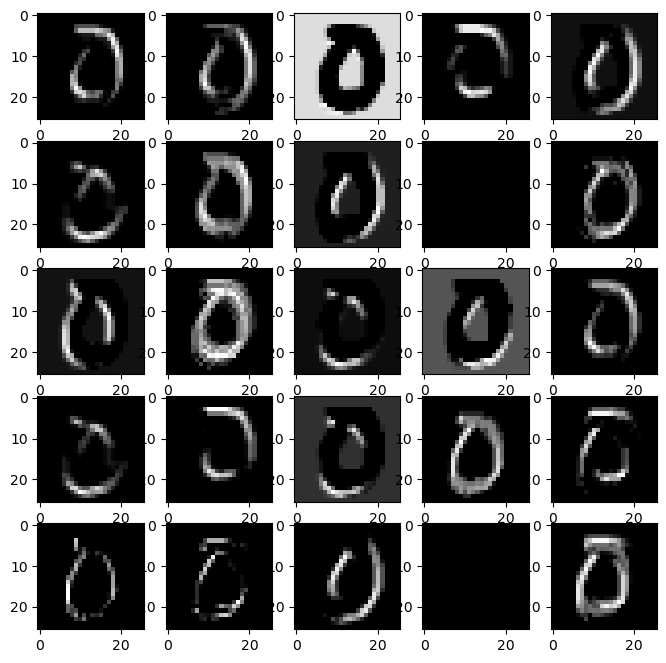

Feature maps of Pooling layer 1


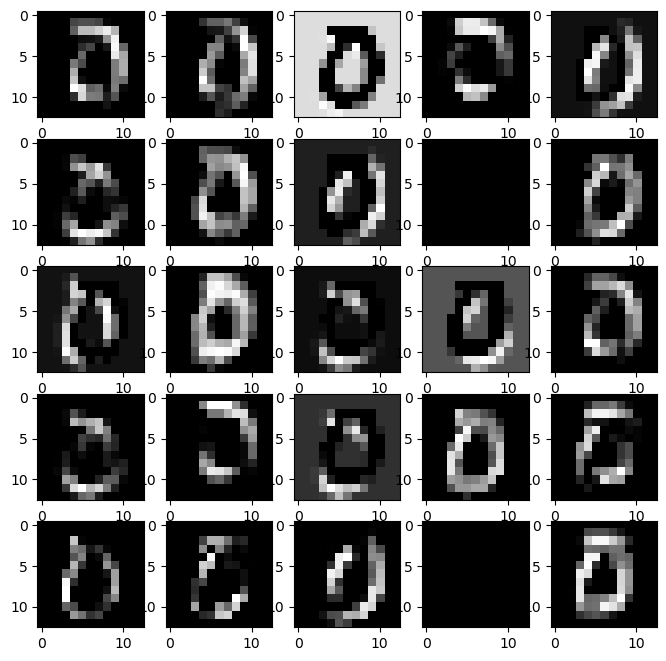

Feature maps of Convo layer 2


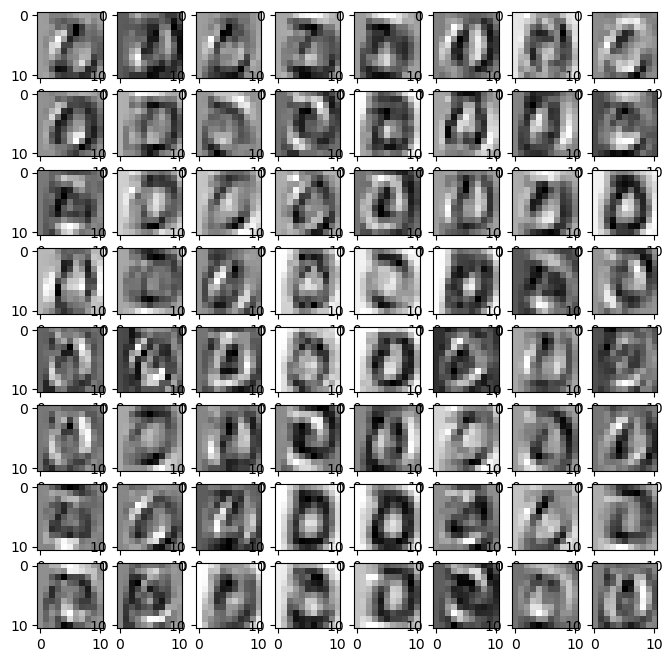

Feature maps of Activation layer 2


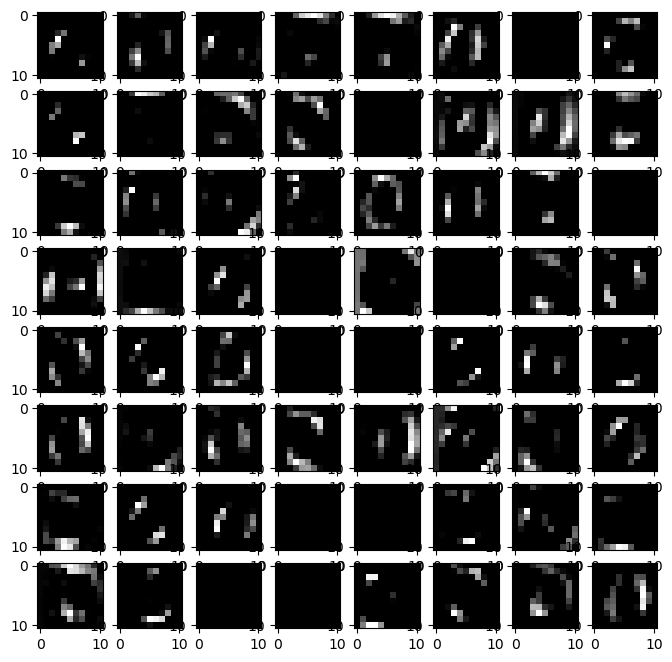

Feature maps of Pooling layer 2


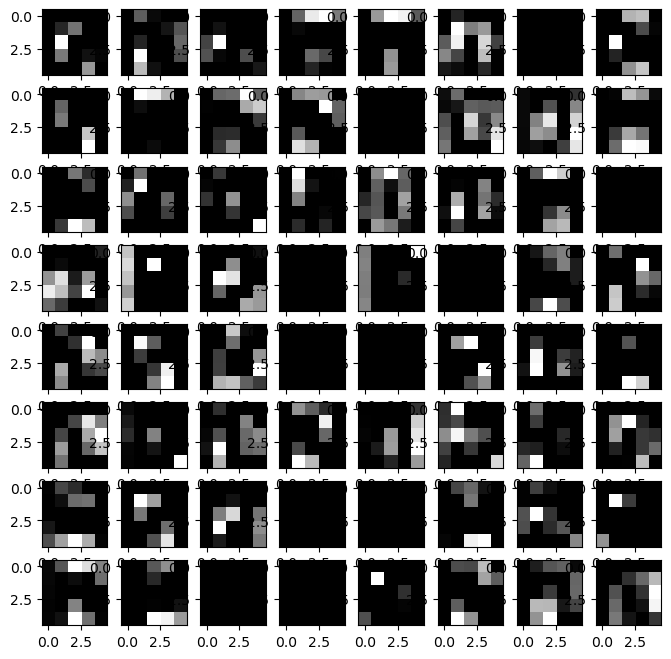

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


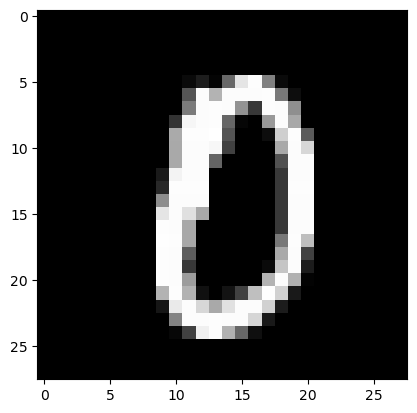

Feature maps of Convo layer 1


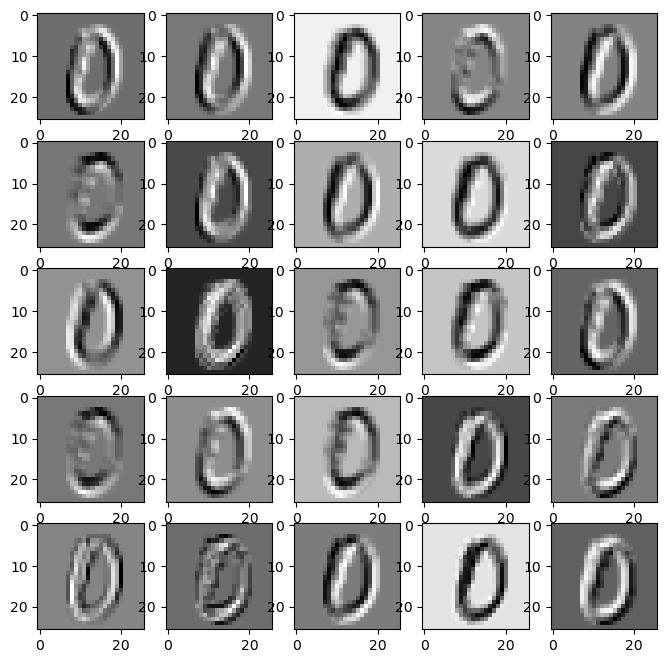

Feature maps of Activation layer 1


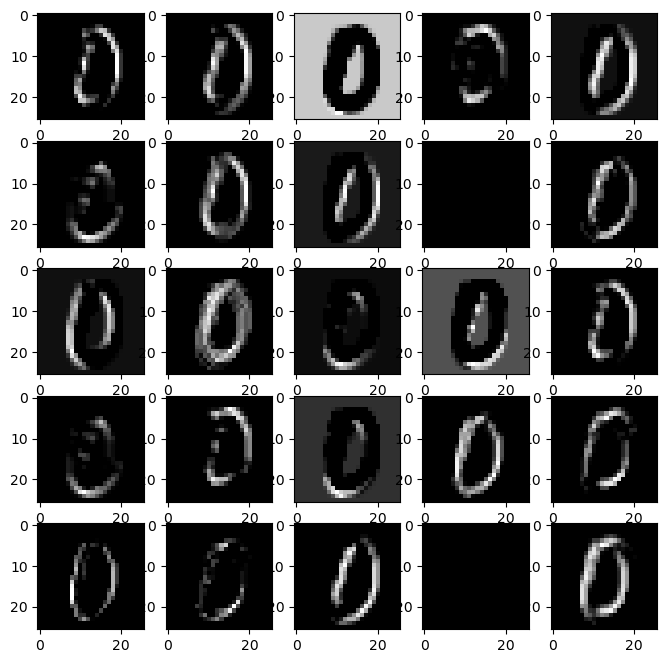

Feature maps of Pooling layer 1


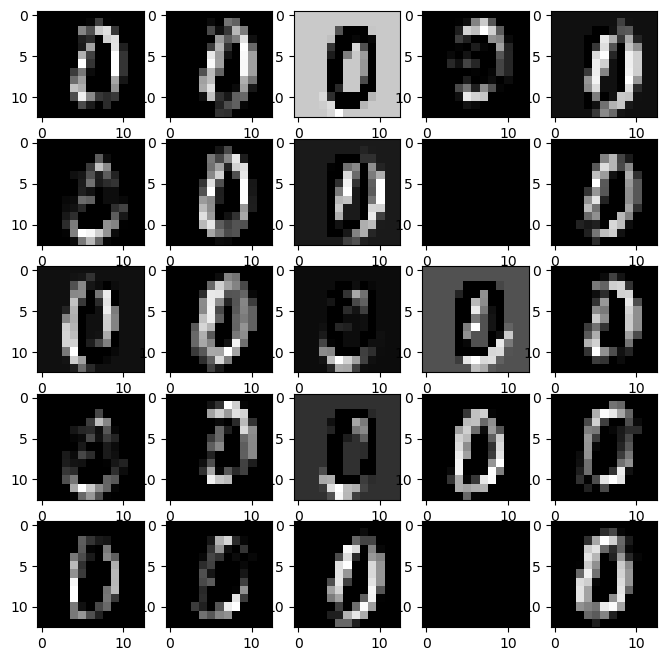

Feature maps of Convo layer 2


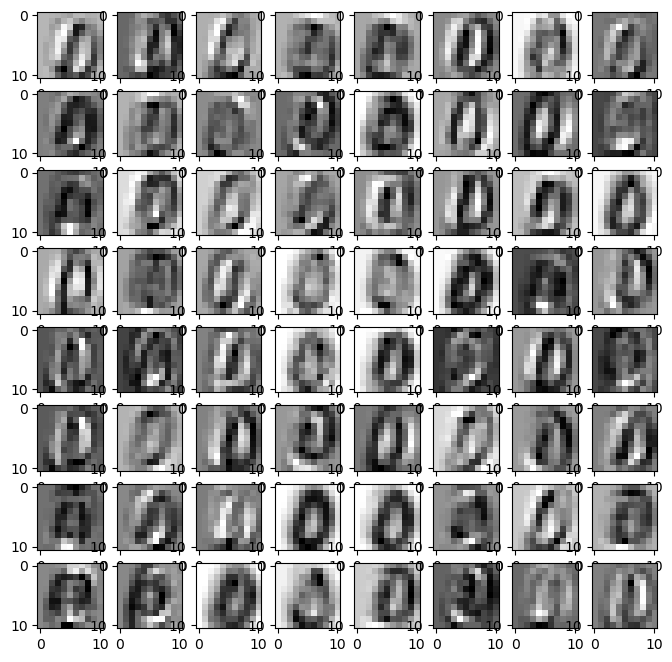

Feature maps of Activation layer 2


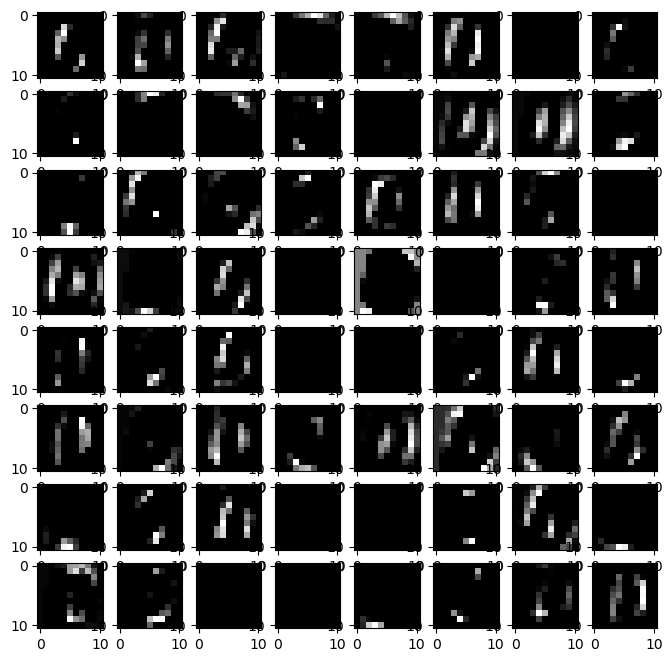

Feature maps of Pooling layer 2


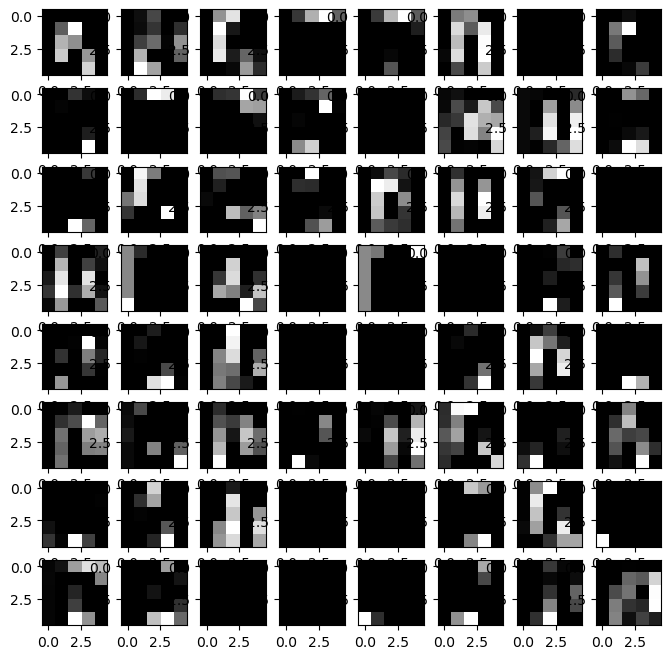

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


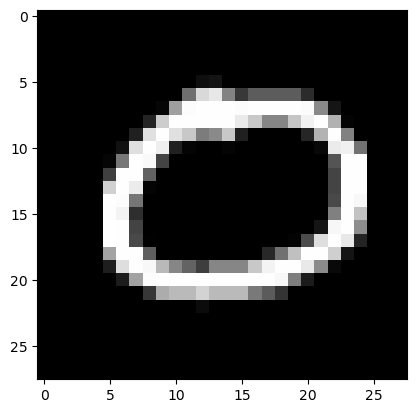

Feature maps of Convo layer 1


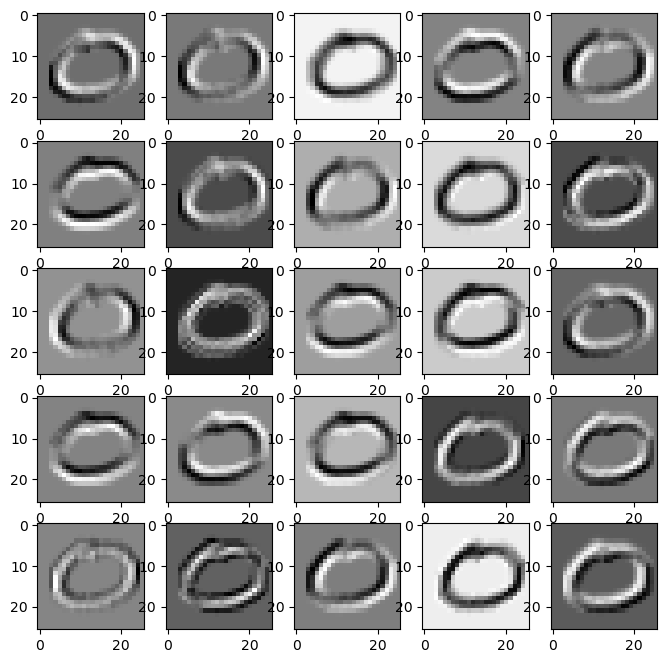

Feature maps of Activation layer 1


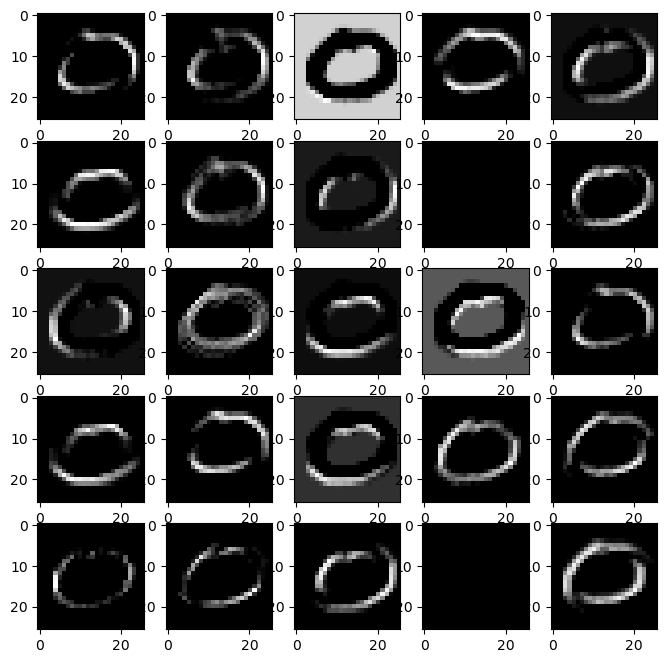

Feature maps of Pooling layer 1


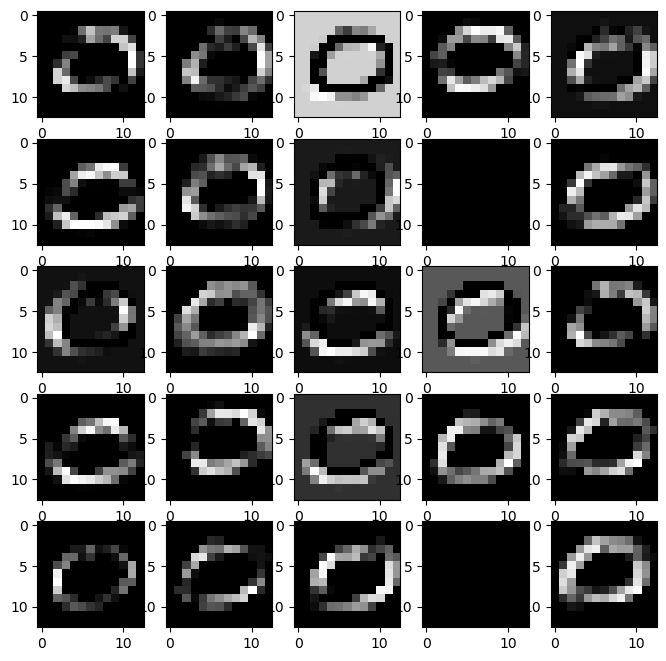

Feature maps of Convo layer 2


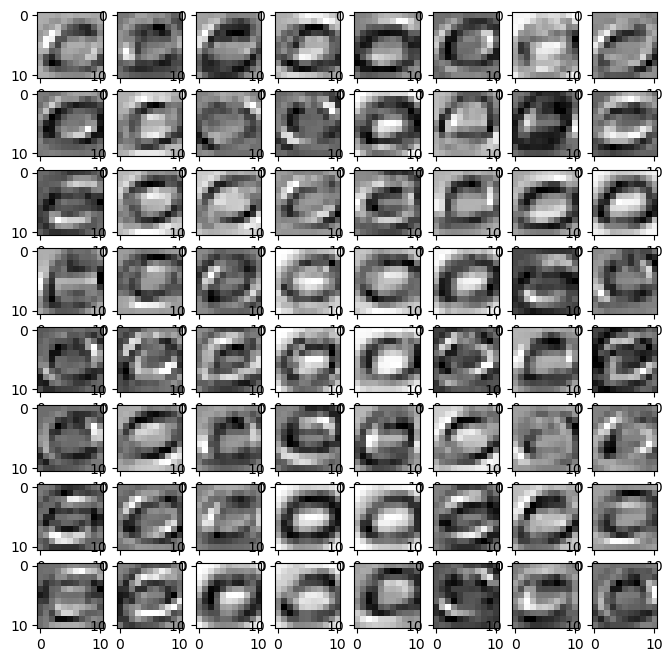

Feature maps of Activation layer 2


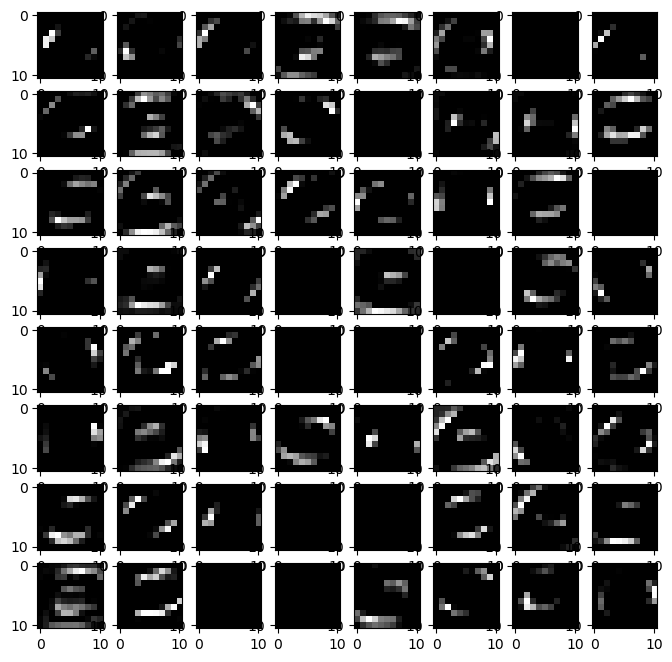

Feature maps of Pooling layer 2


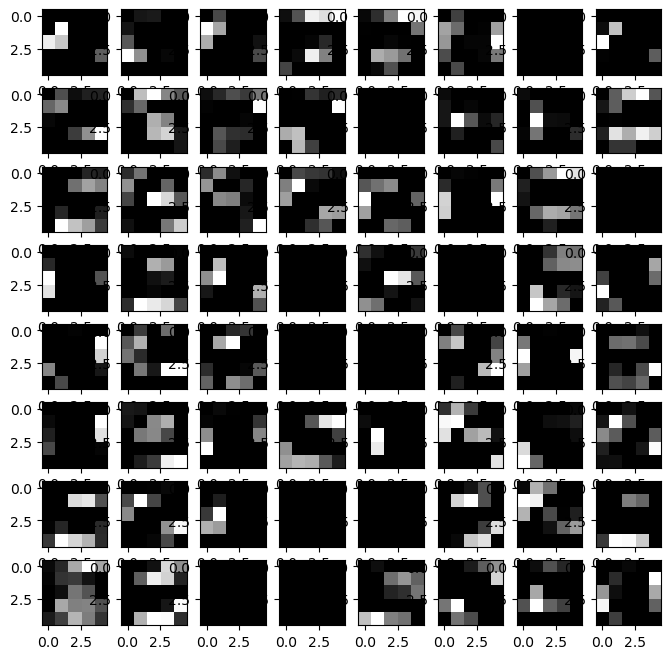

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


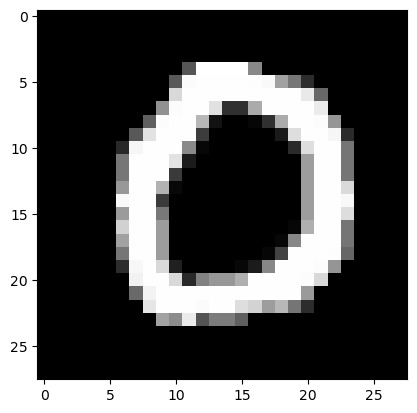

Feature maps of Convo layer 1


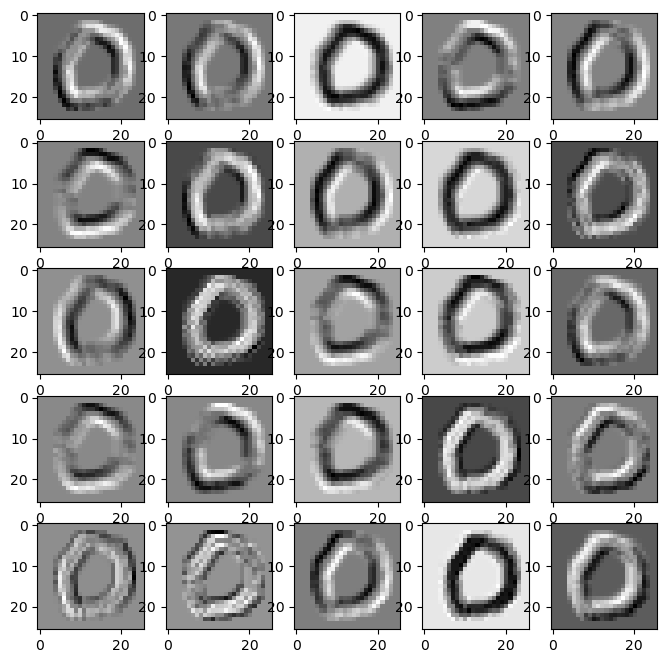

Feature maps of Activation layer 1


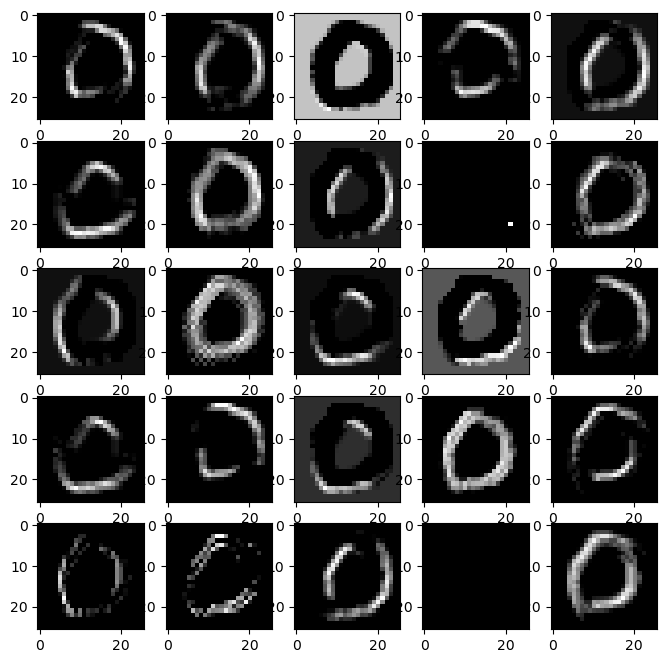

Feature maps of Pooling layer 1


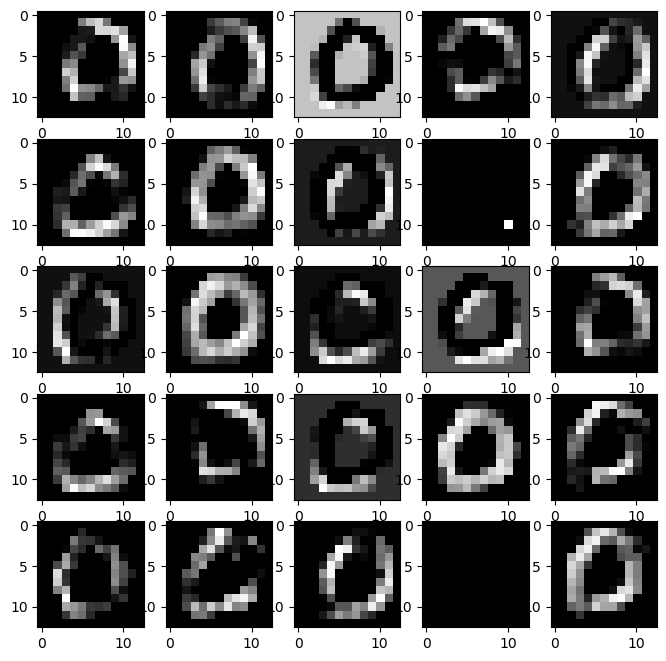

Feature maps of Convo layer 2


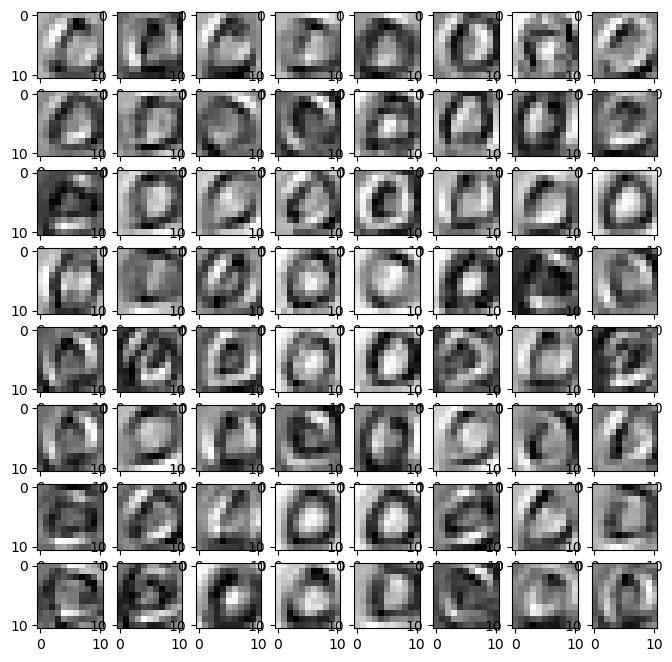

Feature maps of Activation layer 2


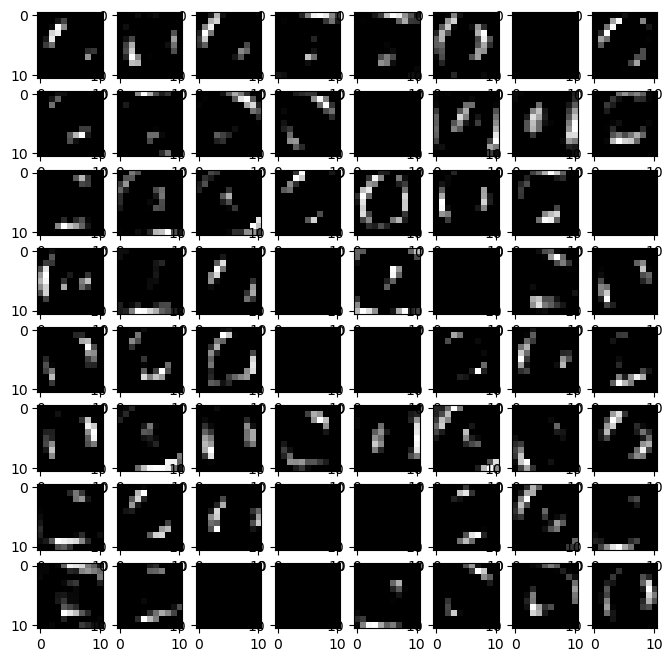

Feature maps of Pooling layer 2


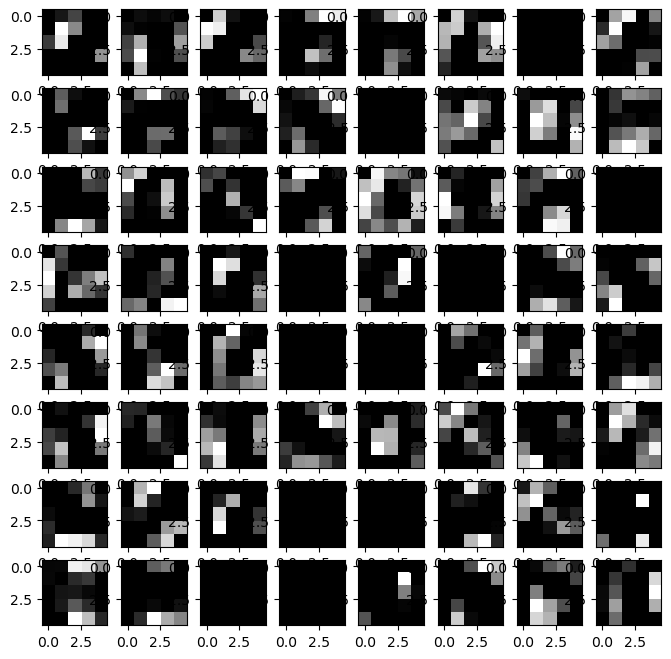

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


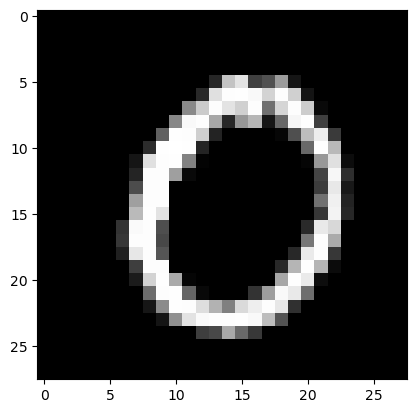

Feature maps of Convo layer 1


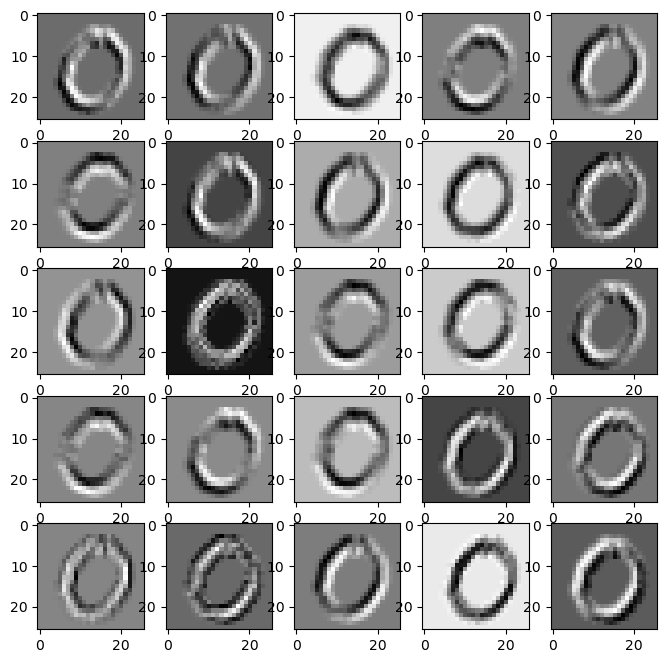

Feature maps of Activation layer 1


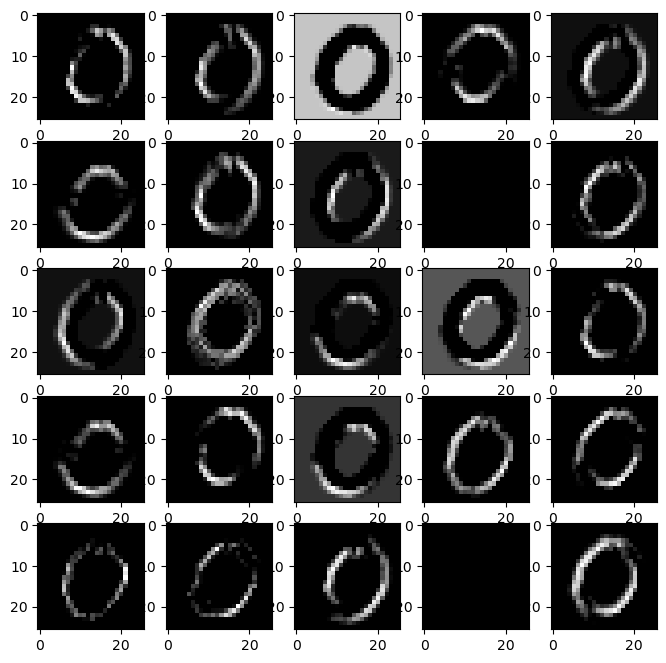

Feature maps of Pooling layer 1


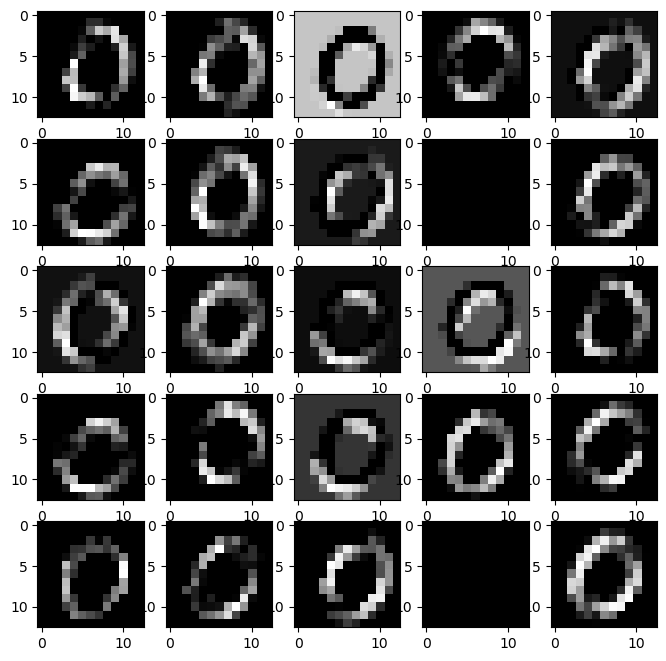

Feature maps of Convo layer 2


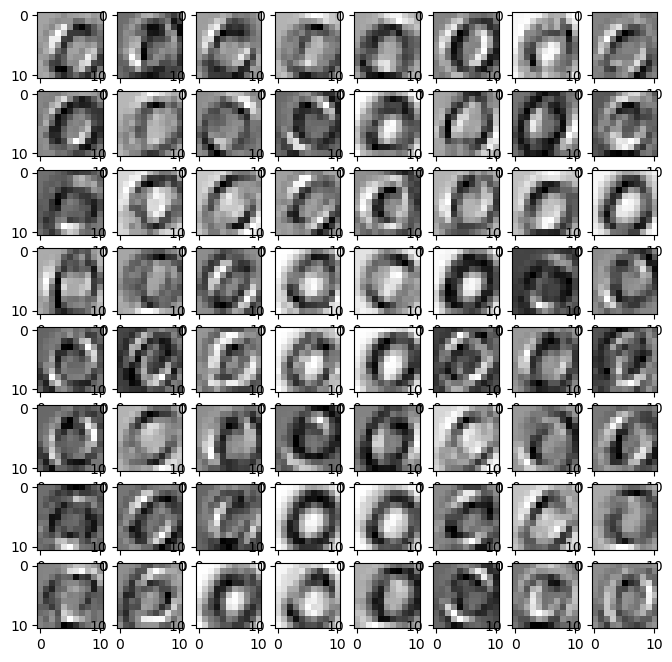

Feature maps of Activation layer 2


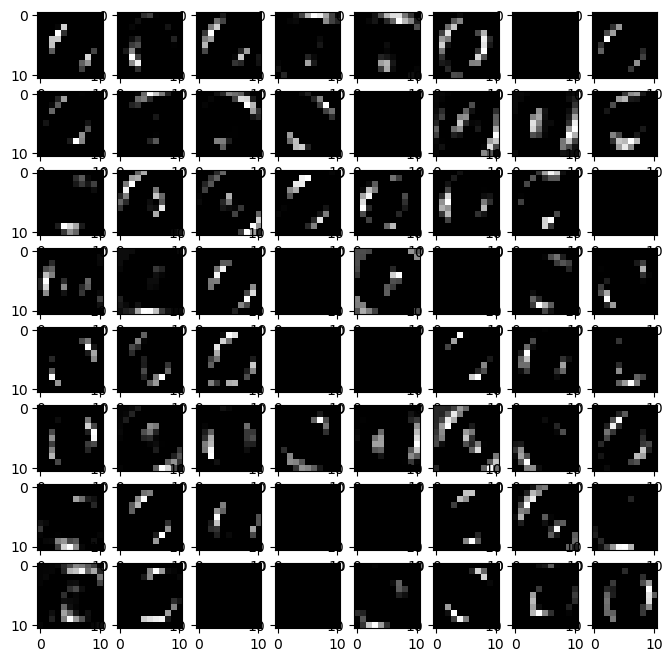

Feature maps of Pooling layer 2


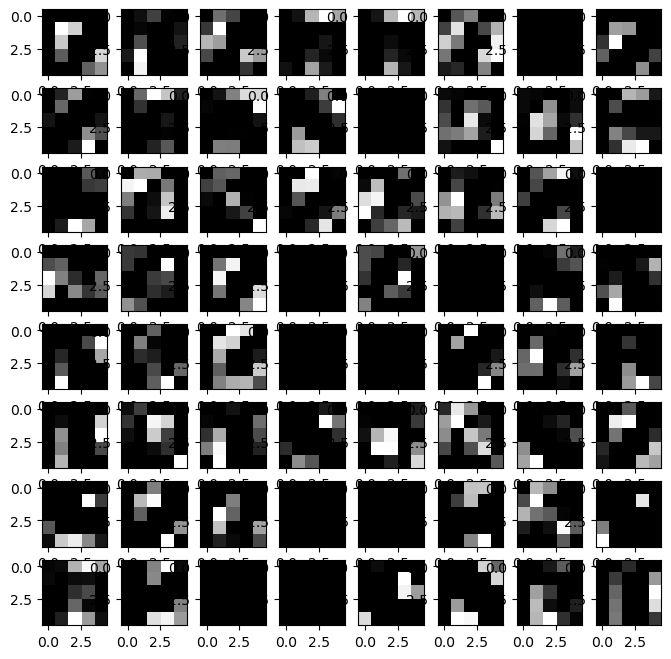

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


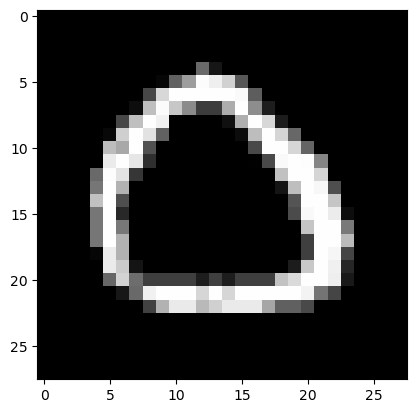

Feature maps of Convo layer 1


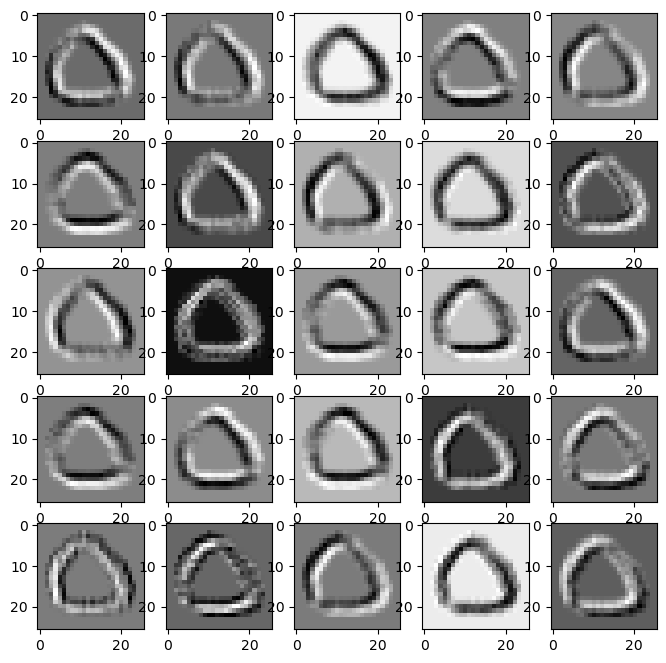

Feature maps of Activation layer 1


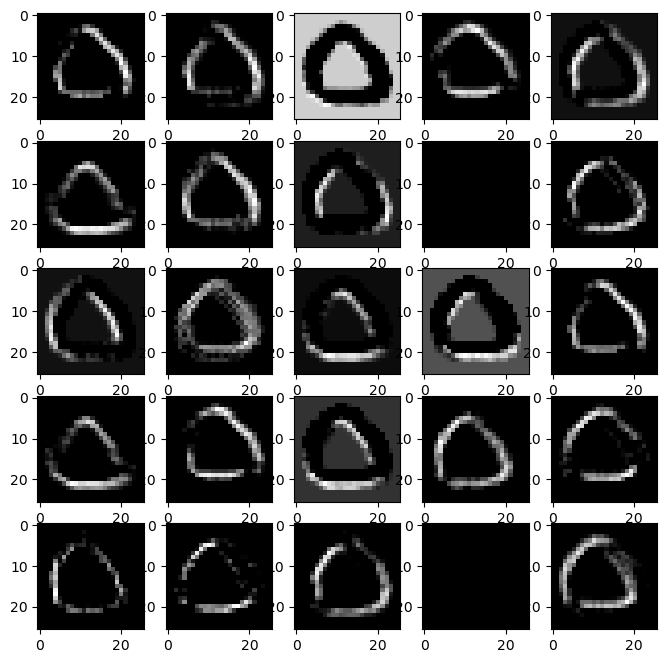

Feature maps of Pooling layer 1


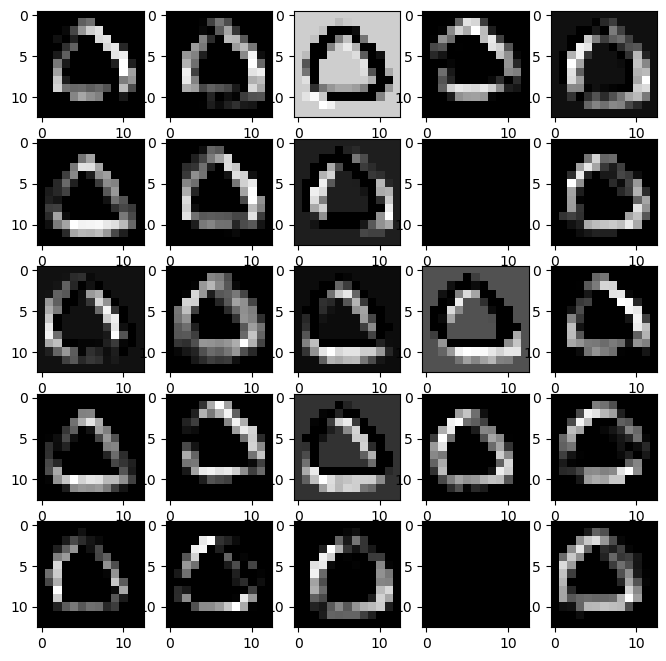

Feature maps of Convo layer 2


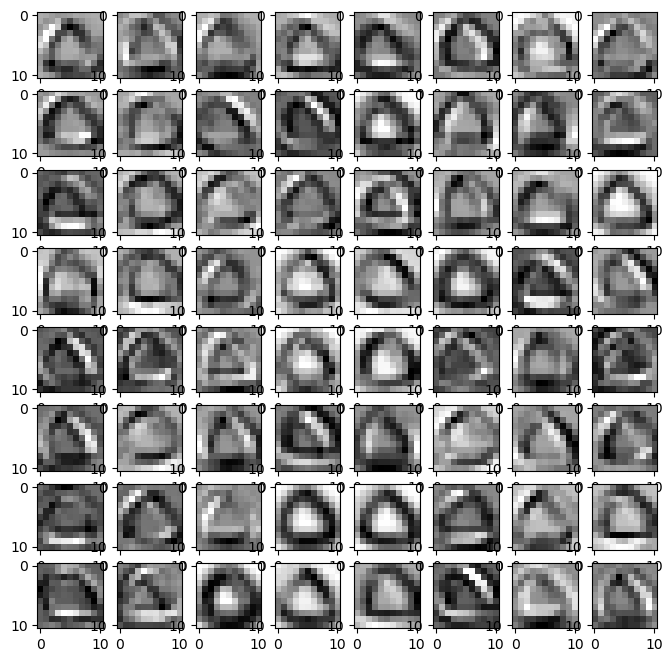

Feature maps of Activation layer 2


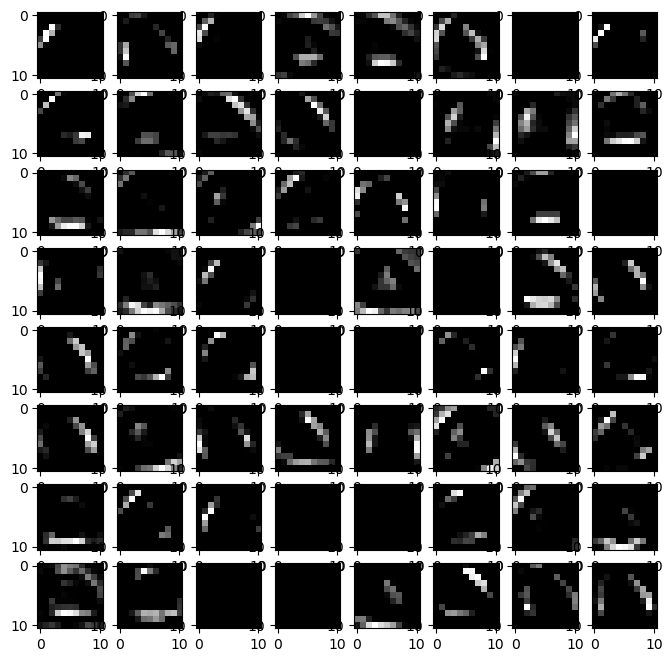

Feature maps of Pooling layer 2


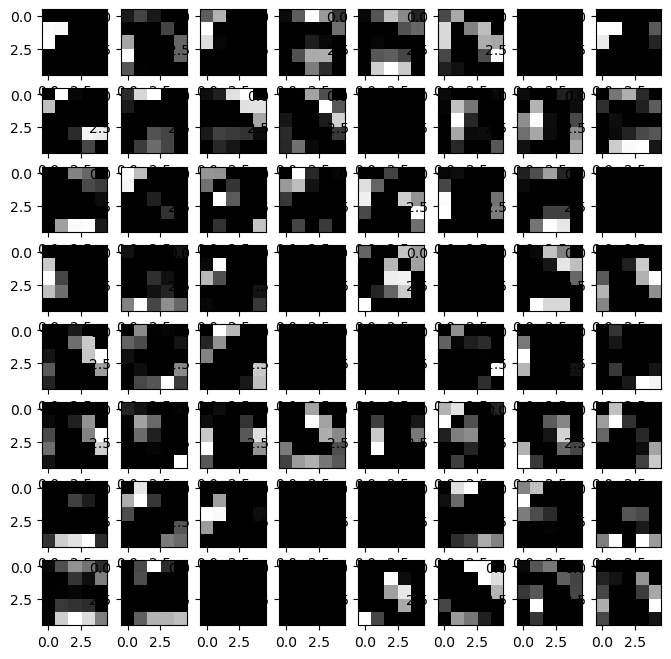

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


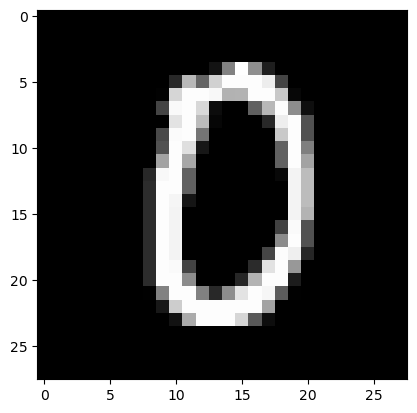

Feature maps of Convo layer 1


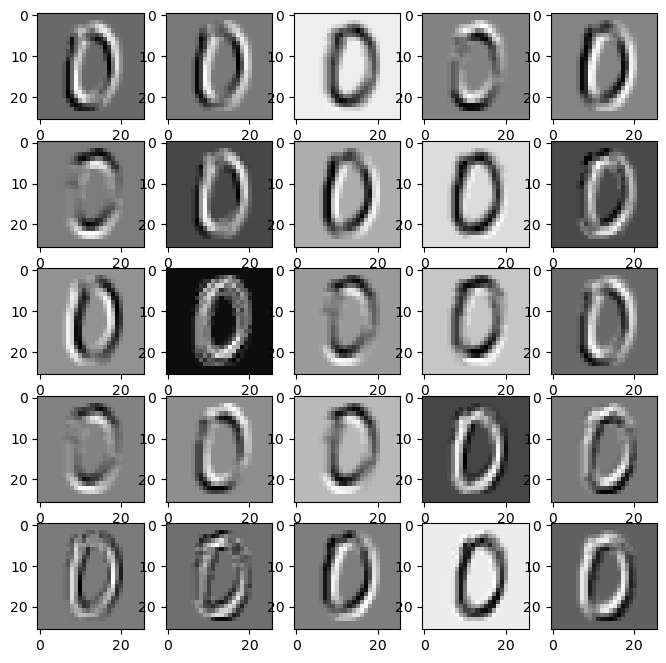

Feature maps of Activation layer 1


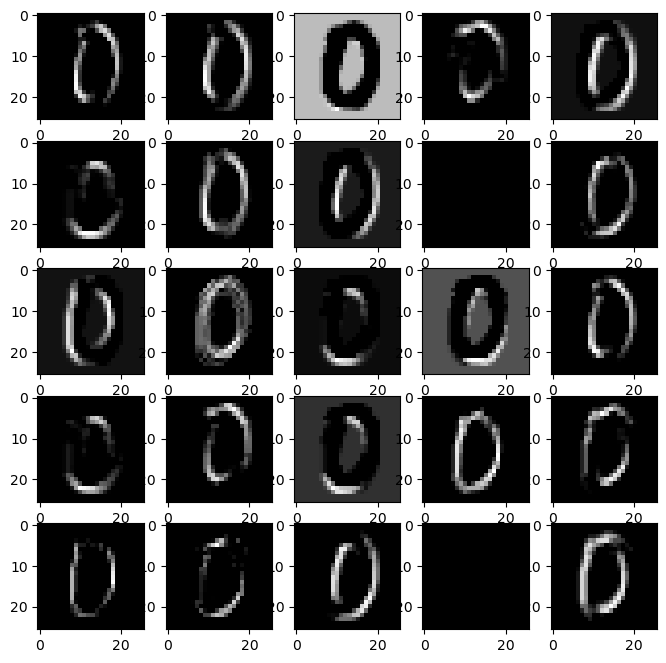

Feature maps of Pooling layer 1


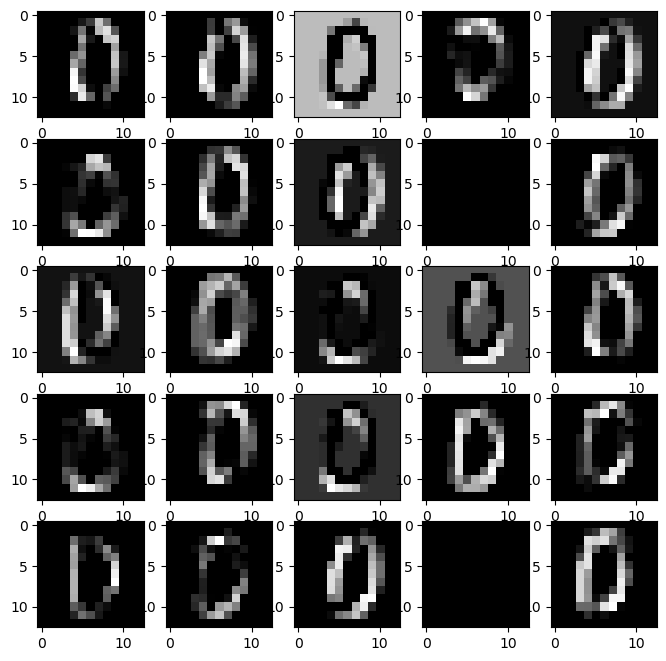

Feature maps of Convo layer 2


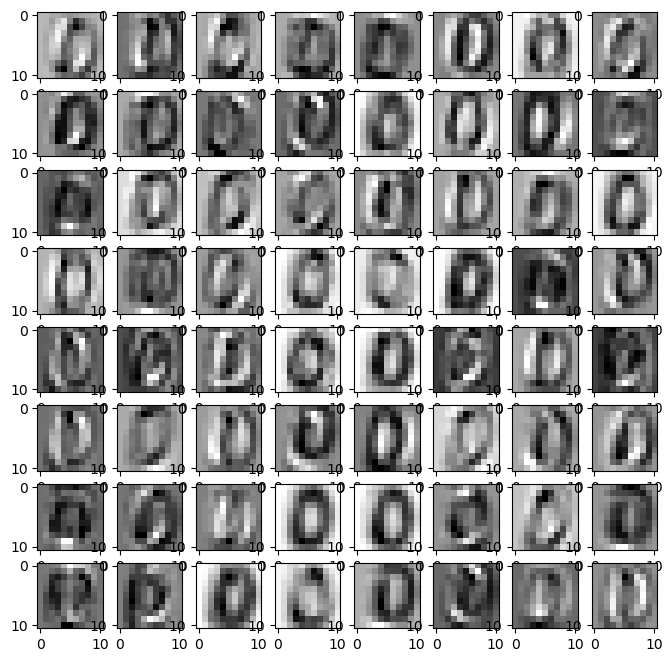

Feature maps of Activation layer 2


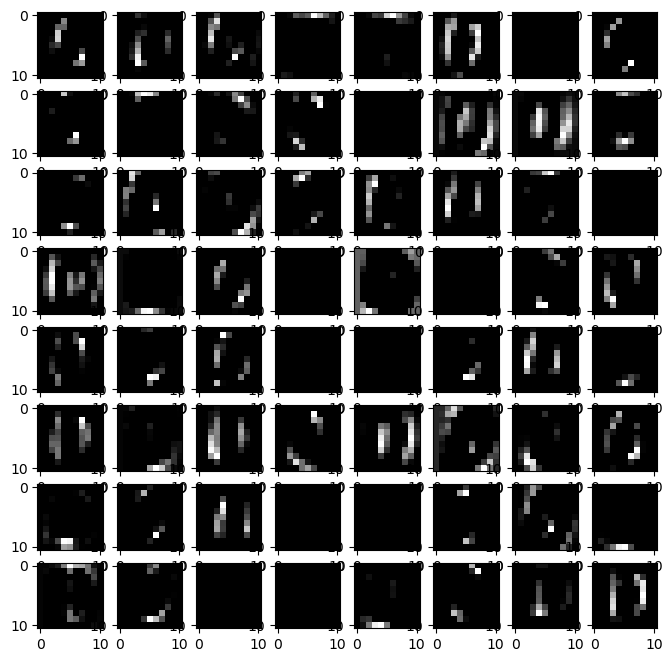

Feature maps of Pooling layer 2


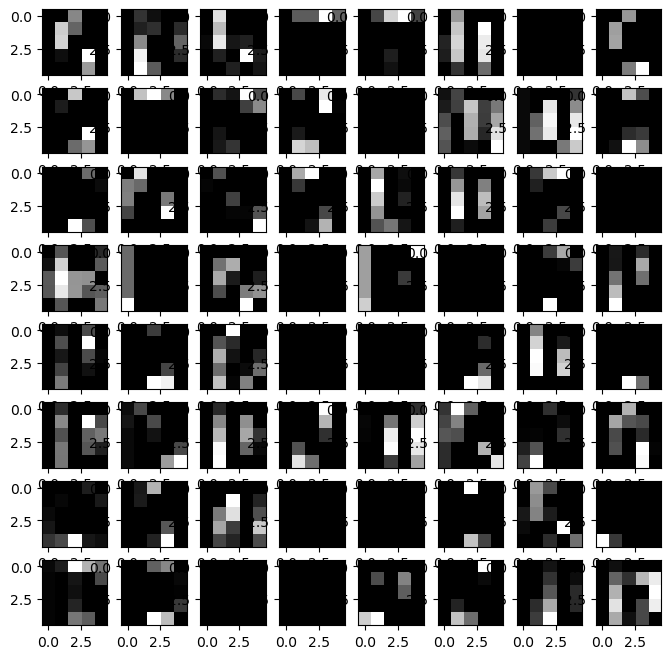

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


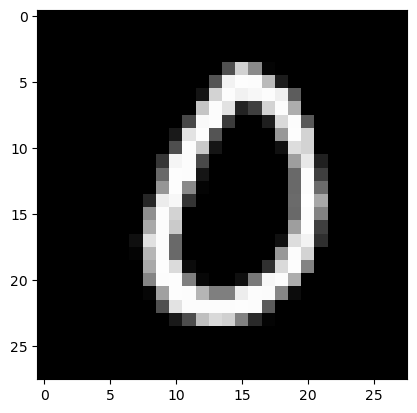

Feature maps of Convo layer 1


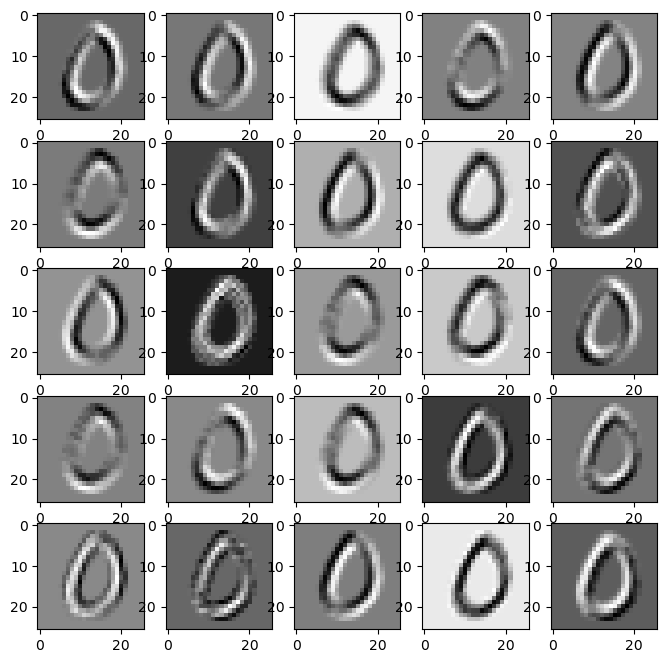

Feature maps of Activation layer 1


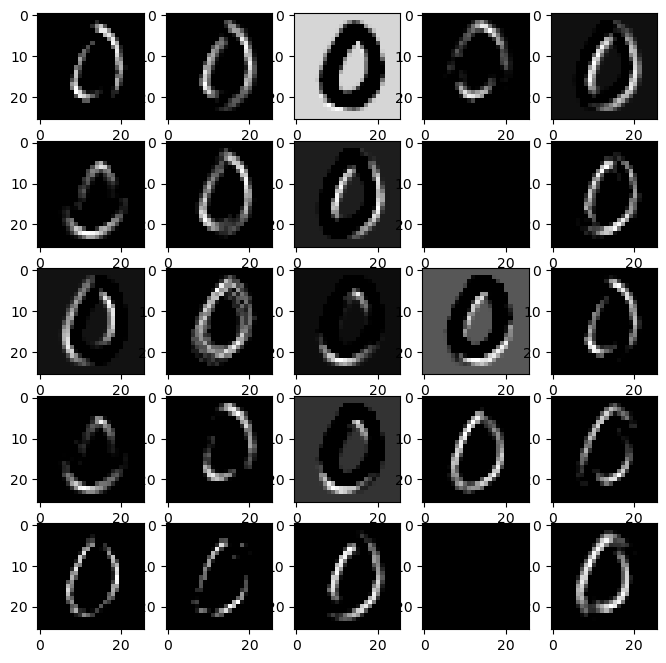

Feature maps of Pooling layer 1


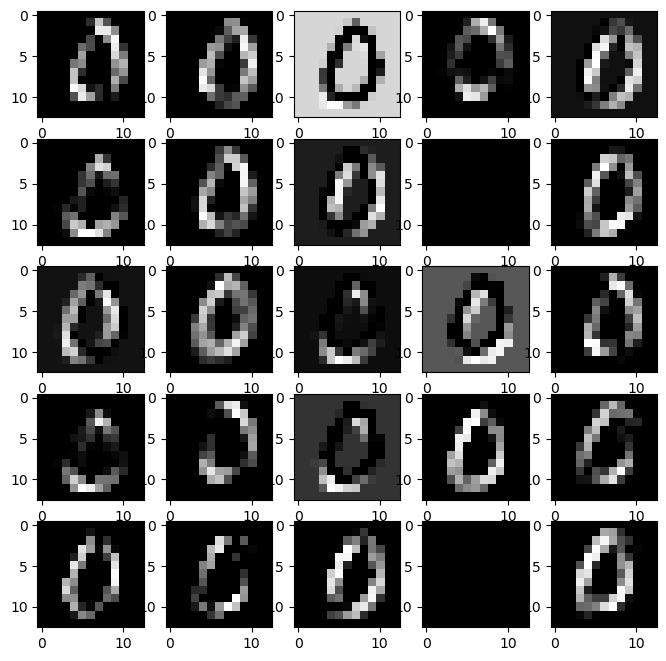

Feature maps of Convo layer 2


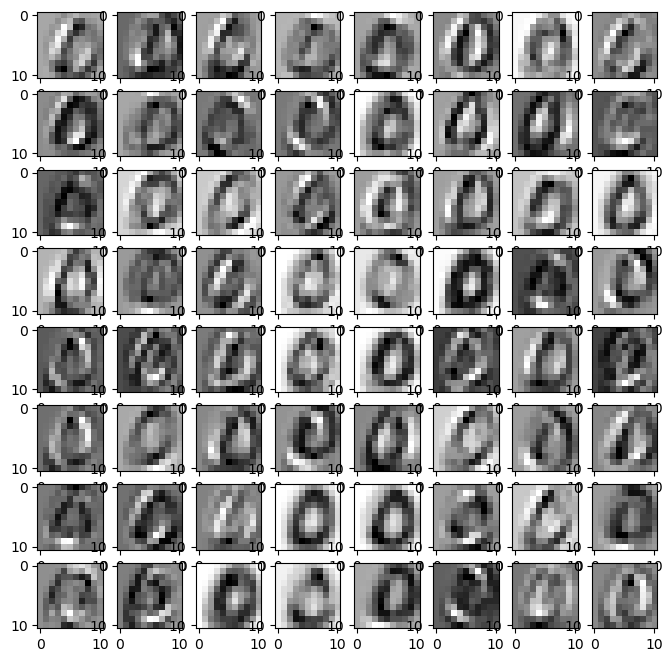

Feature maps of Activation layer 2


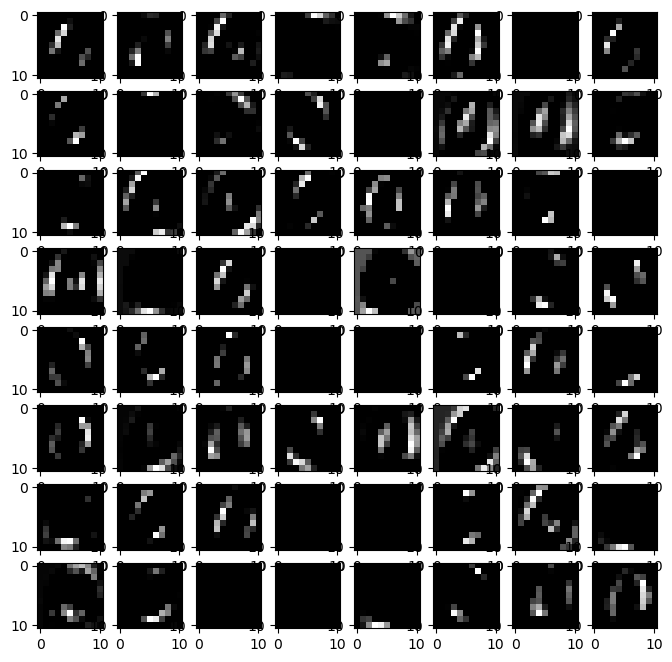

Feature maps of Pooling layer 2


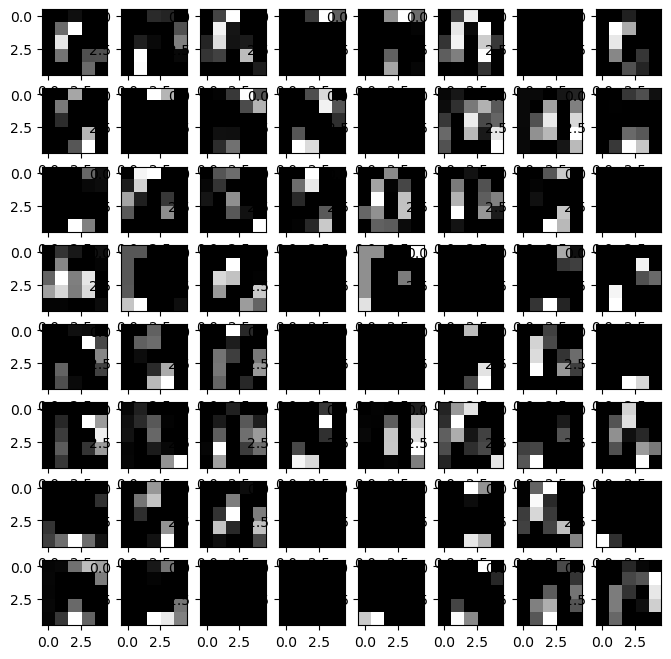

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


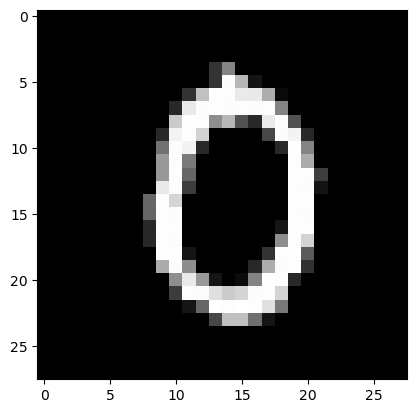

Feature maps of Convo layer 1


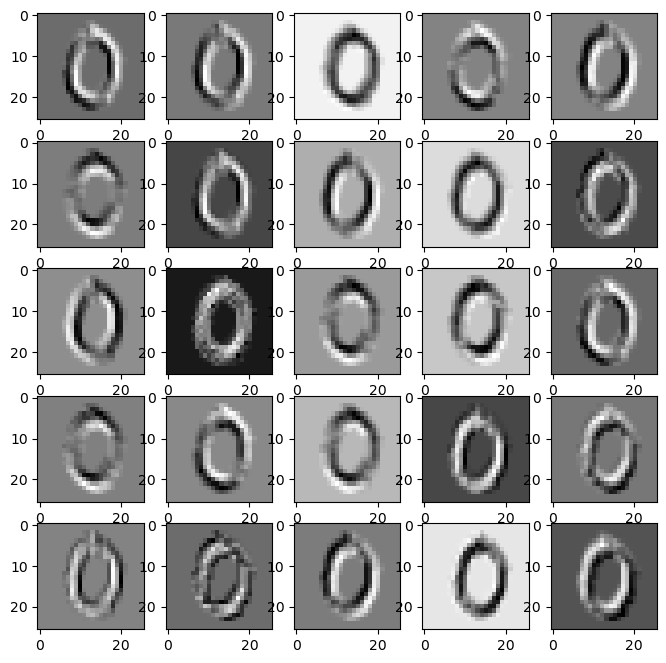

Feature maps of Activation layer 1


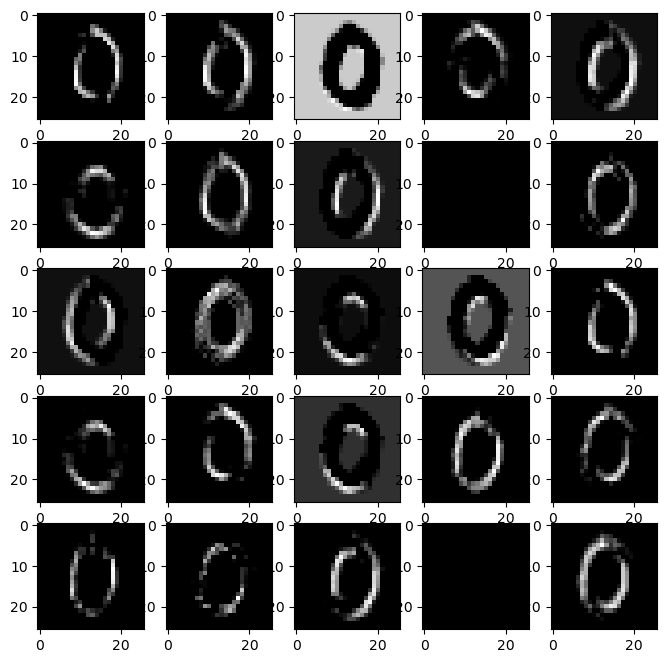

Feature maps of Pooling layer 1


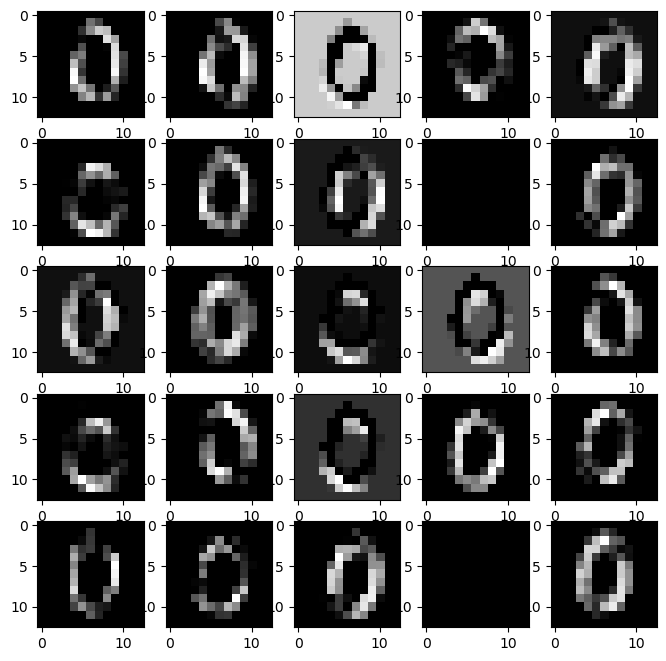

Feature maps of Convo layer 2


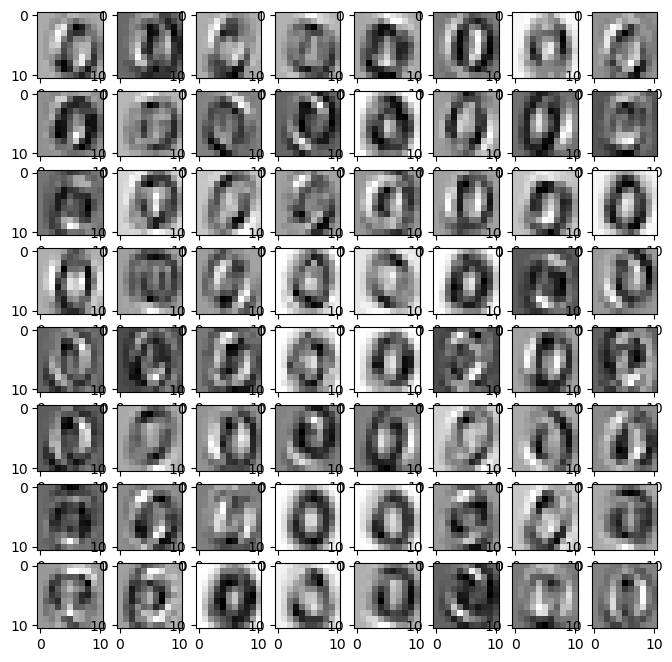

Feature maps of Activation layer 2


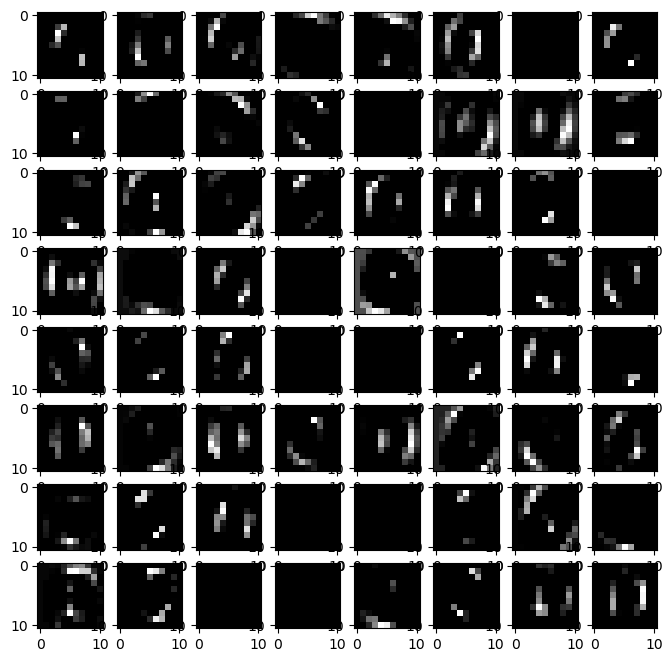

Feature maps of Pooling layer 2


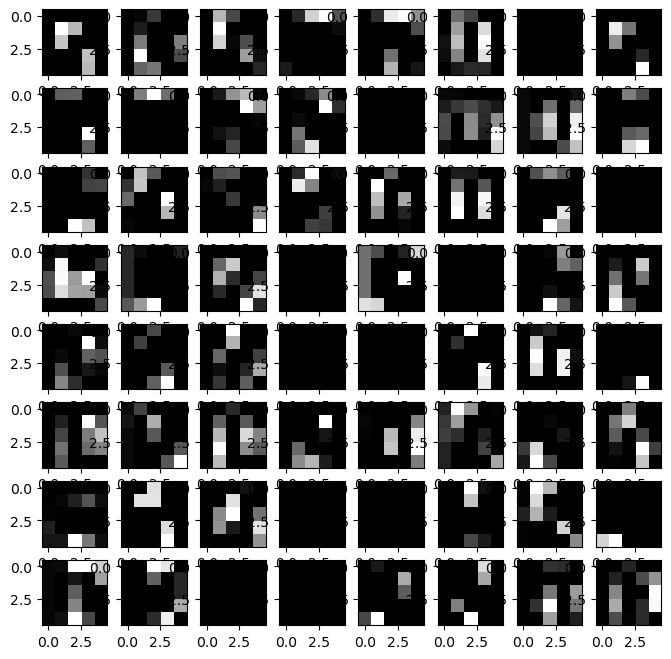

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


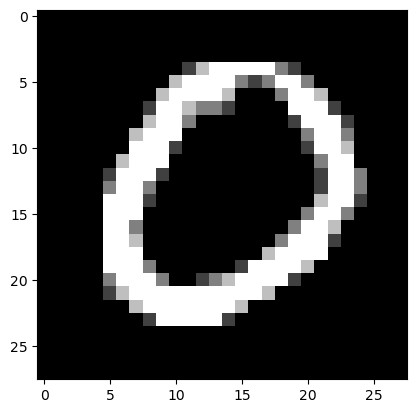

Feature maps of Convo layer 1


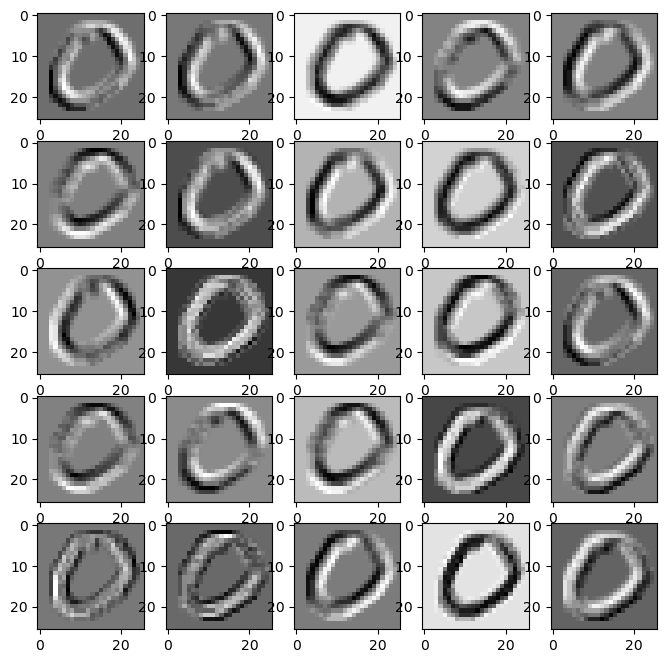

Feature maps of Activation layer 1


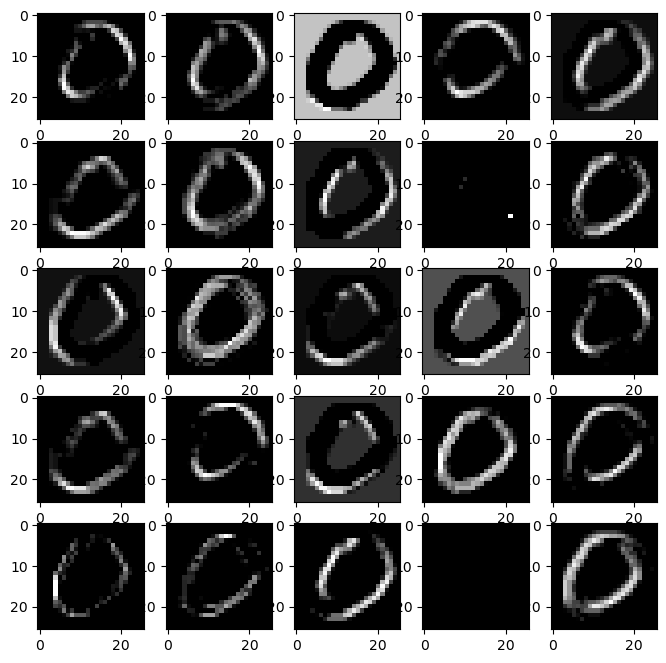

Feature maps of Pooling layer 1


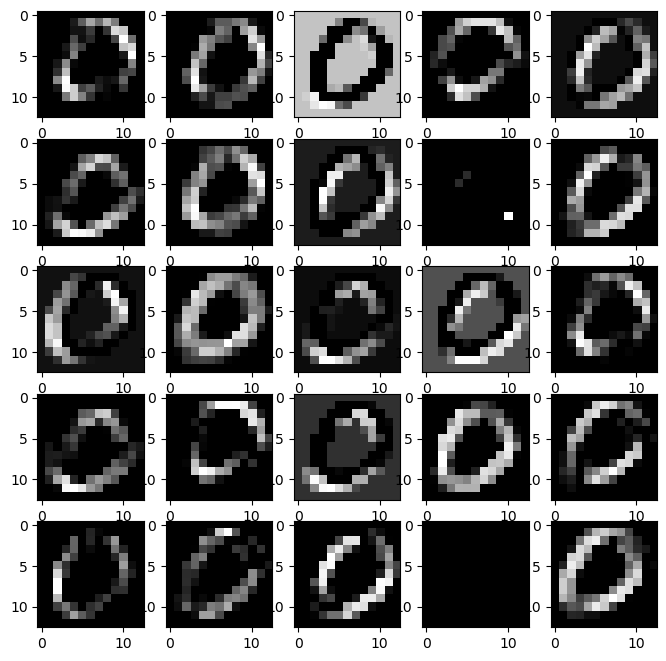

Feature maps of Convo layer 2


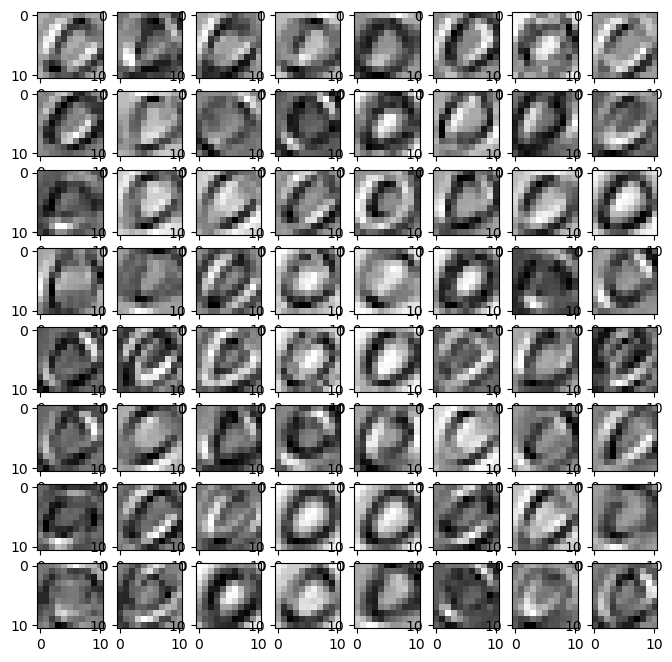

Feature maps of Activation layer 2


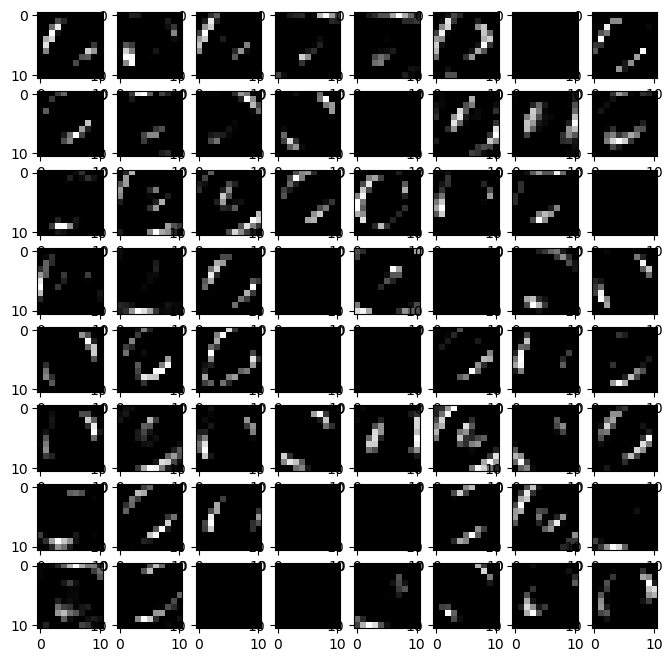

Feature maps of Pooling layer 2


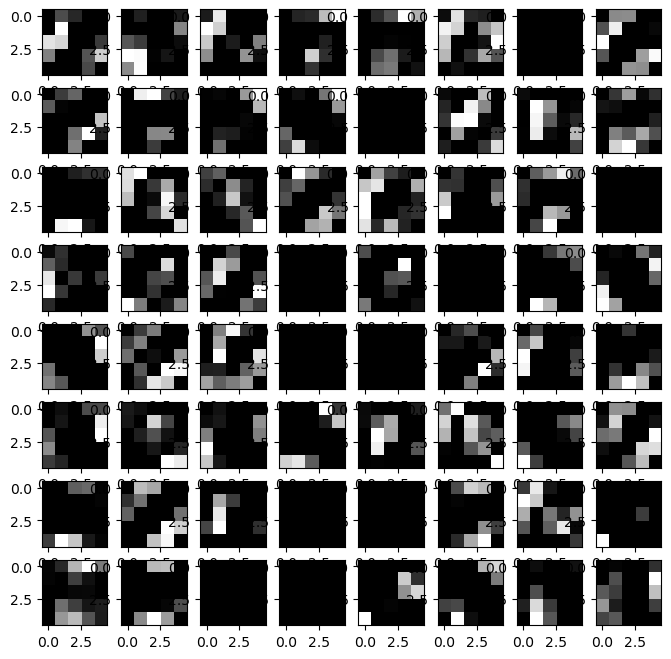

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


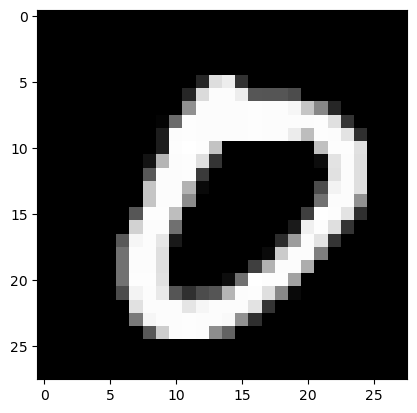

Feature maps of Convo layer 1


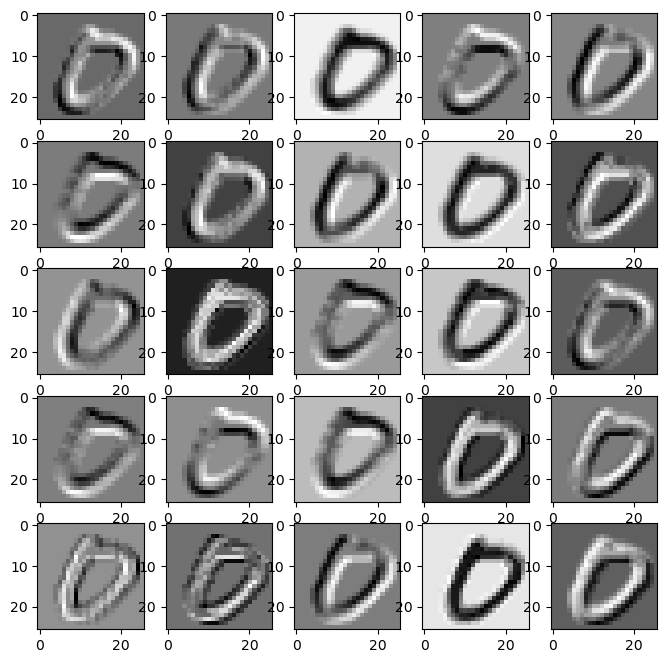

Feature maps of Activation layer 1


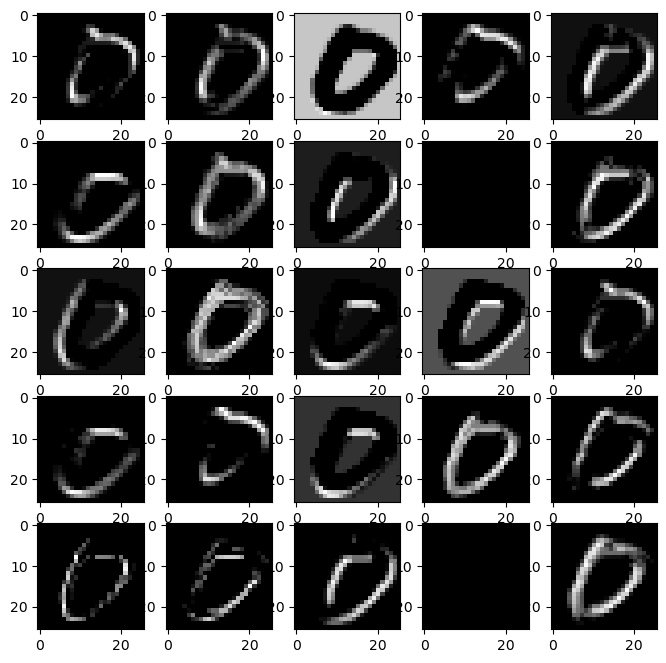

Feature maps of Pooling layer 1


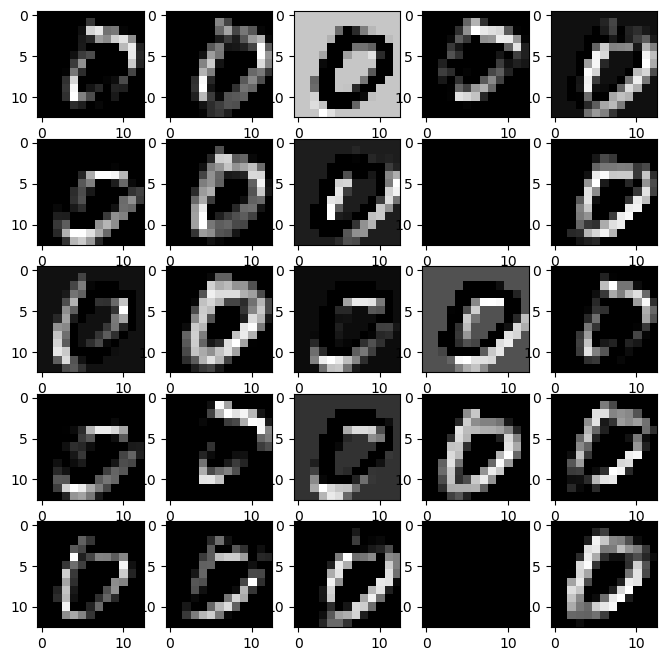

Feature maps of Convo layer 2


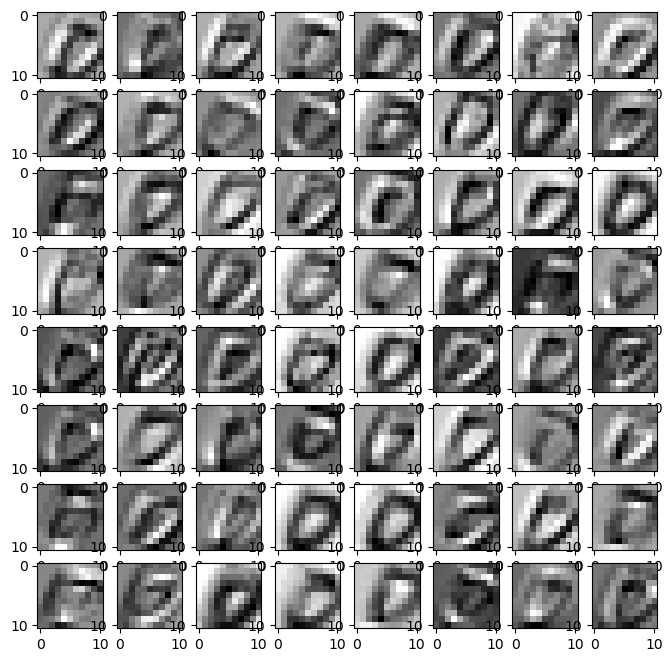

Feature maps of Activation layer 2


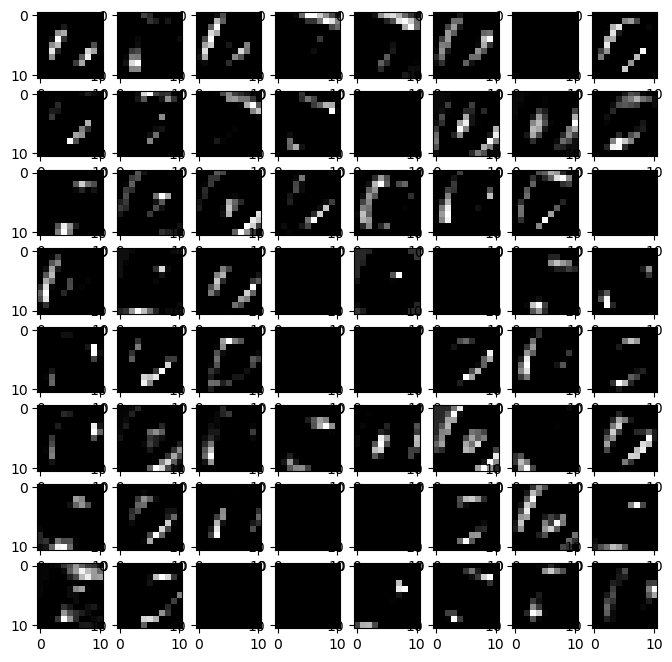

Feature maps of Pooling layer 2


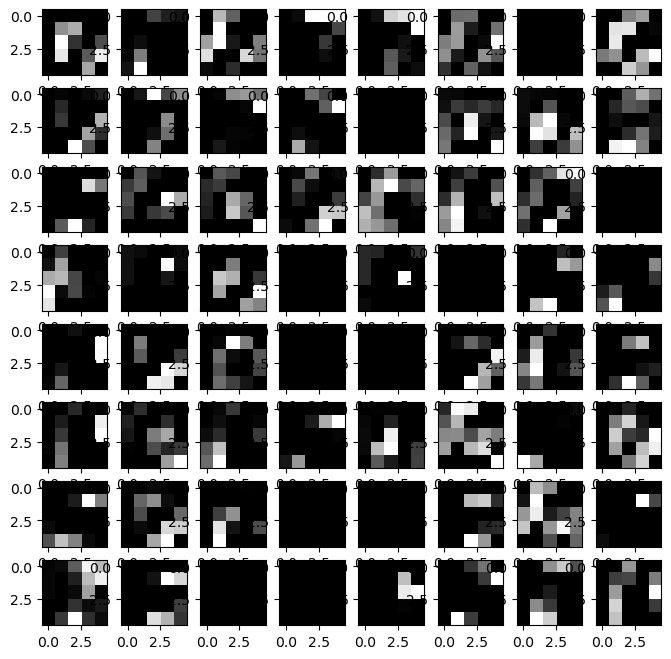

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


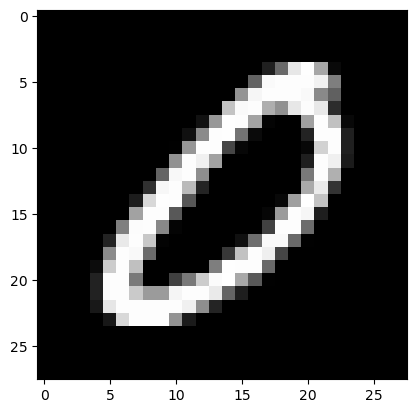

Feature maps of Convo layer 1


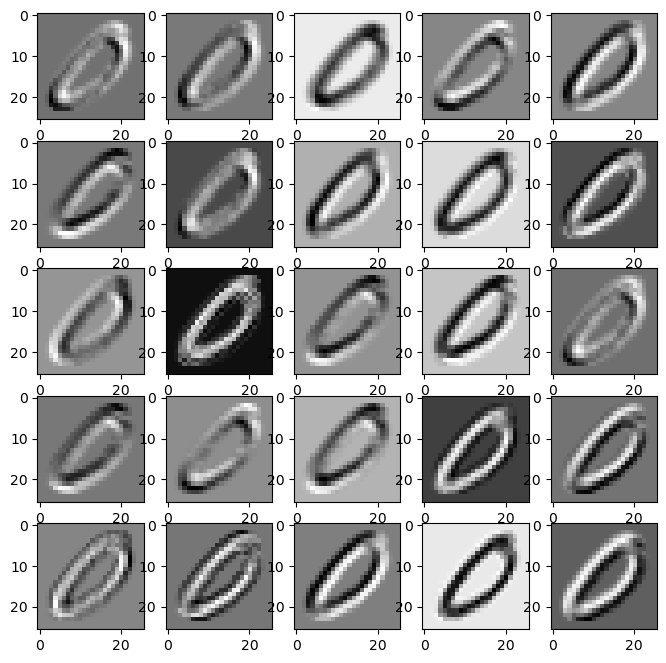

Feature maps of Activation layer 1


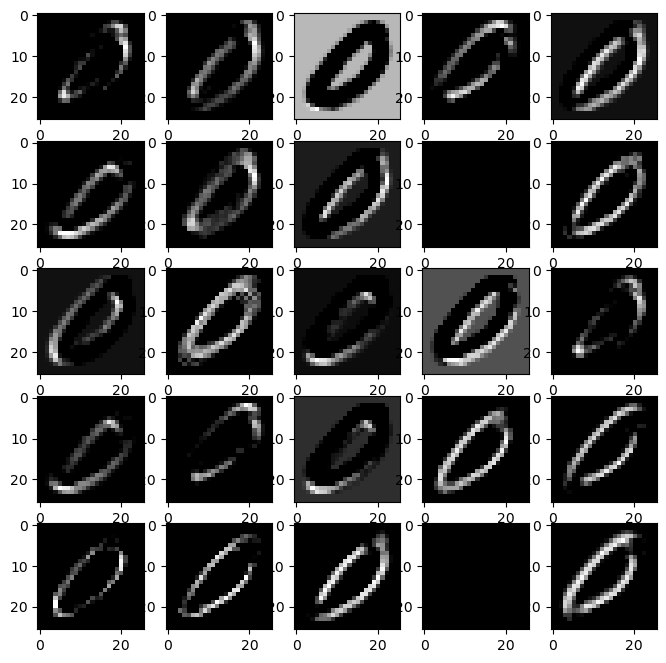

Feature maps of Pooling layer 1


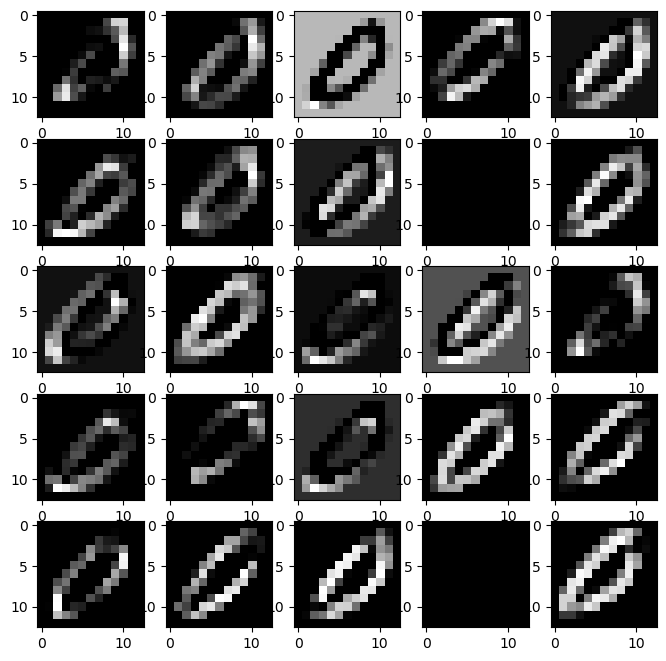

Feature maps of Convo layer 2


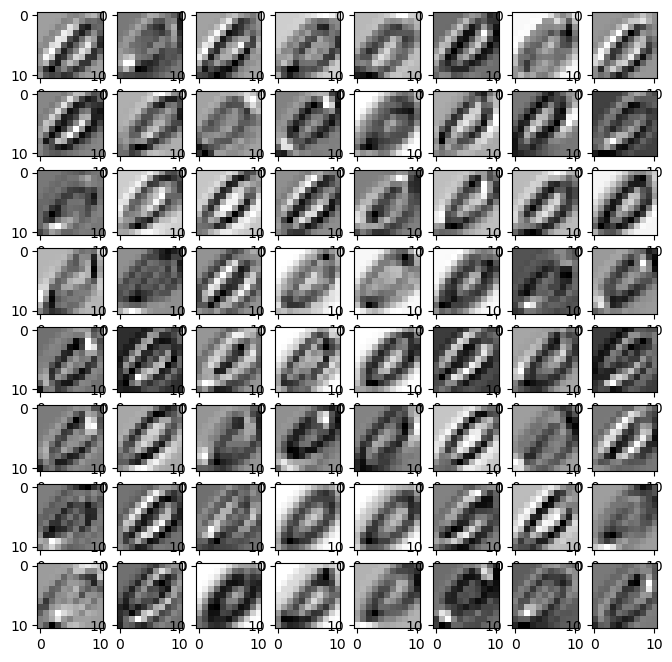

Feature maps of Activation layer 2


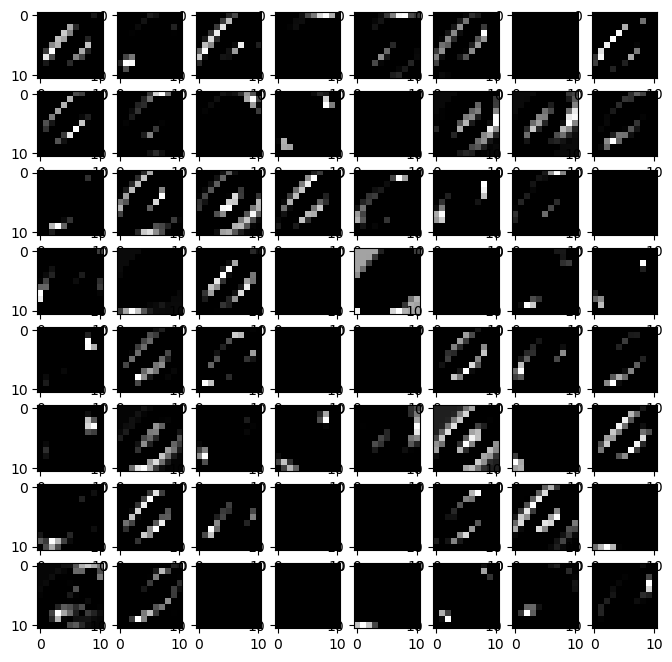

Feature maps of Pooling layer 2


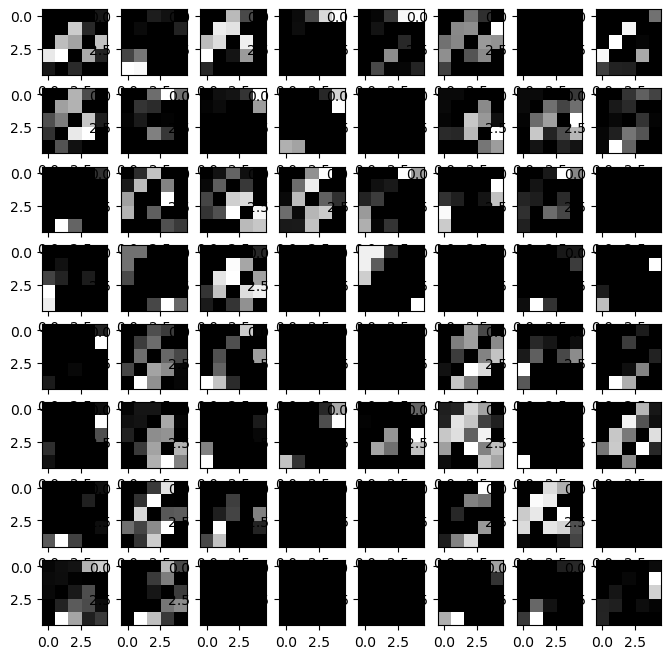

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


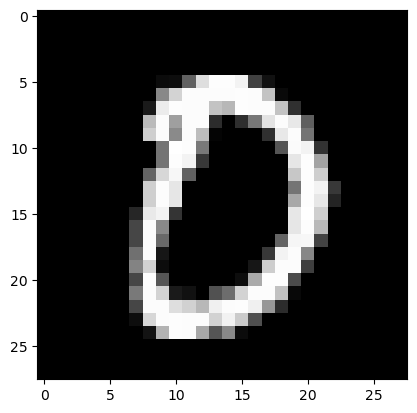

Feature maps of Convo layer 1


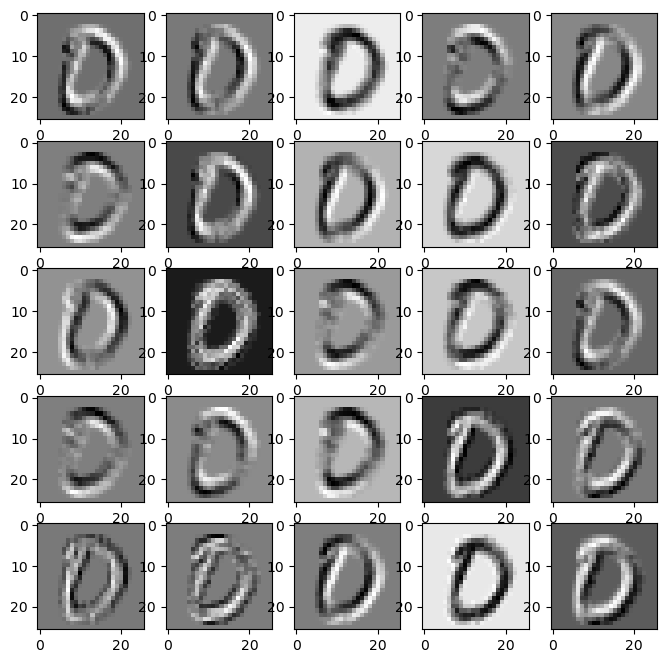

Feature maps of Activation layer 1


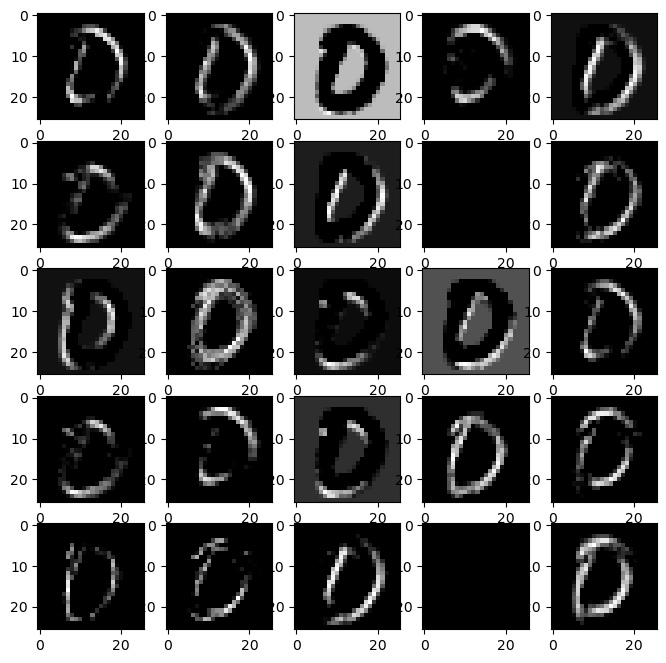

Feature maps of Pooling layer 1


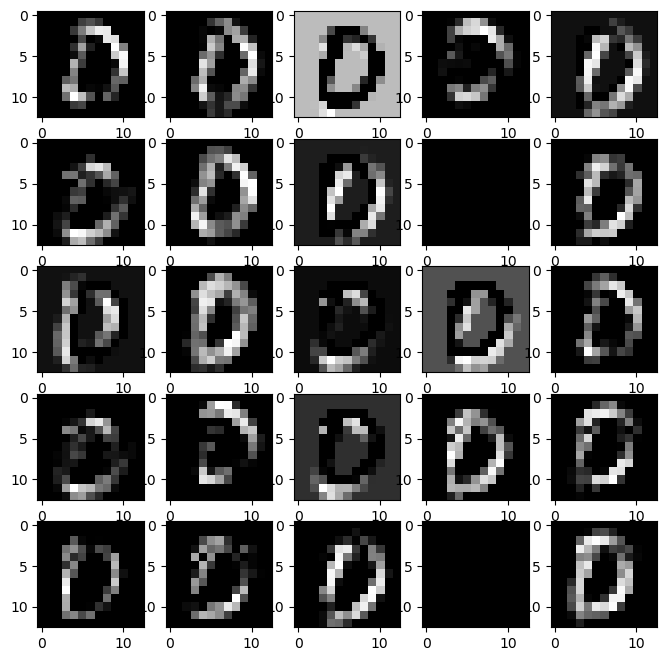

Feature maps of Convo layer 2


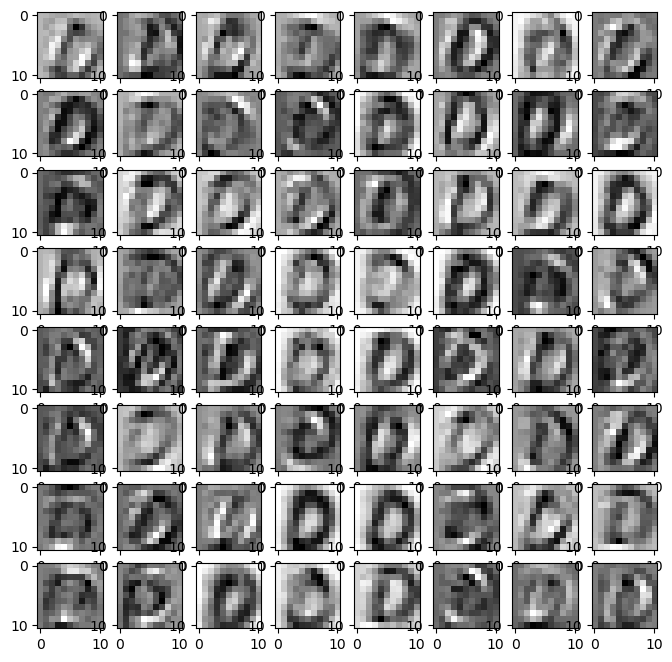

Feature maps of Activation layer 2


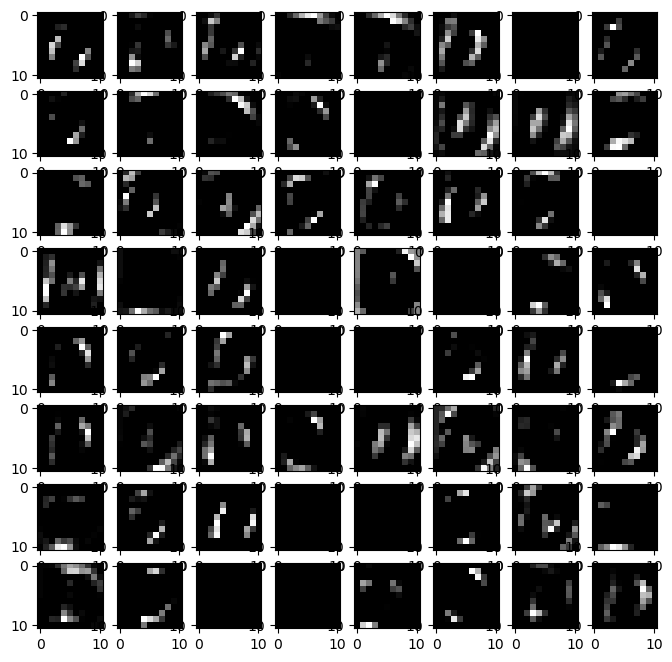

Feature maps of Pooling layer 2


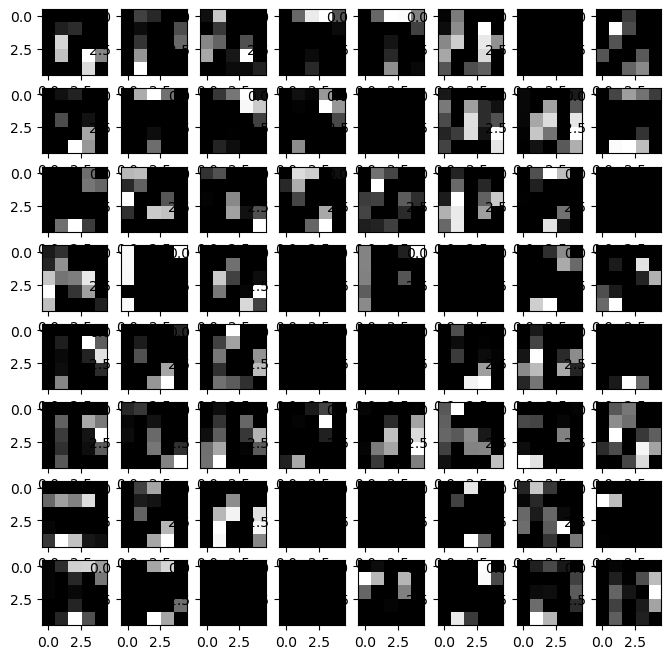

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


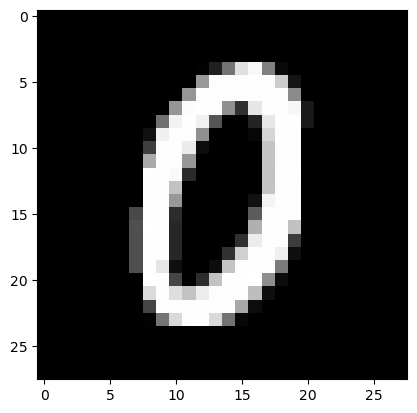

Feature maps of Convo layer 1


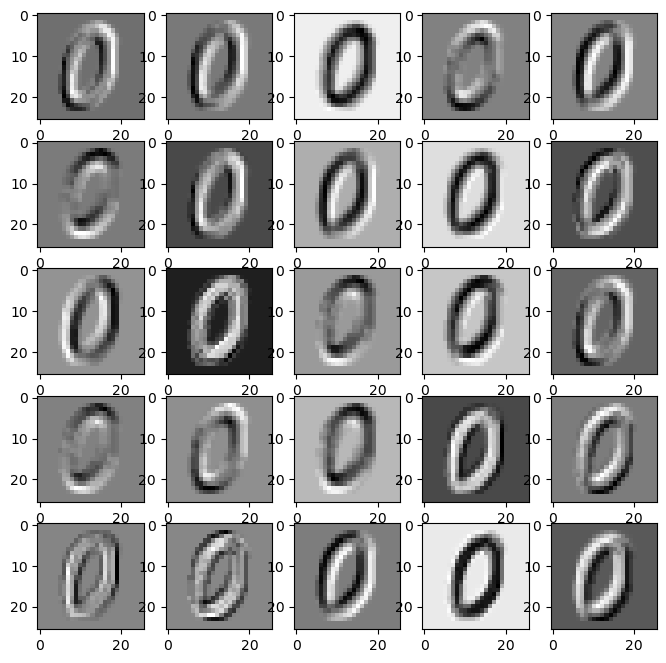

Feature maps of Activation layer 1


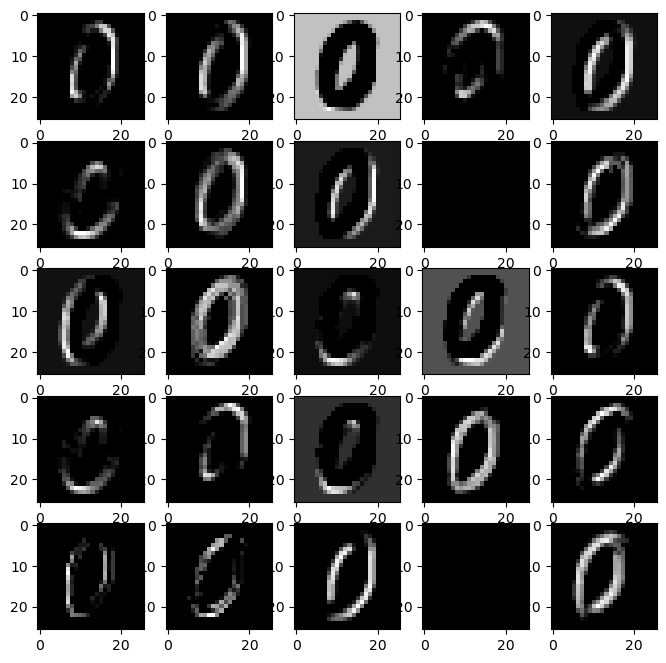

Feature maps of Pooling layer 1


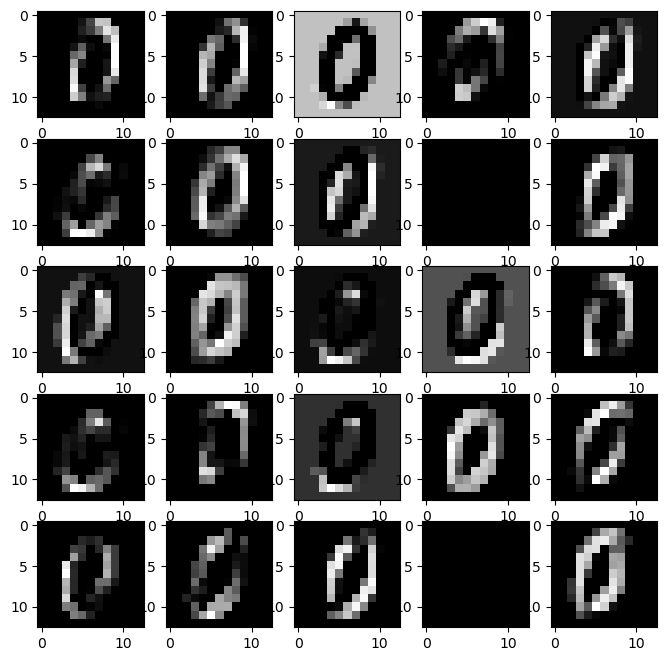

Feature maps of Convo layer 2


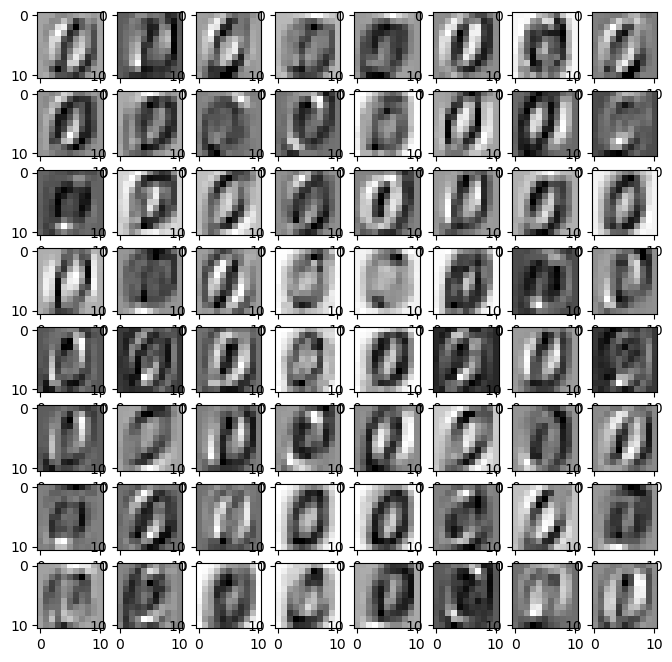

Feature maps of Activation layer 2


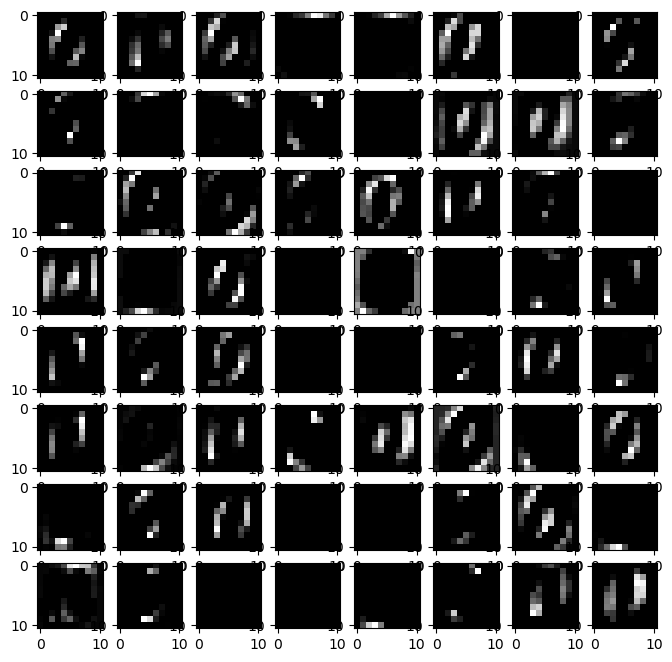

Feature maps of Pooling layer 2


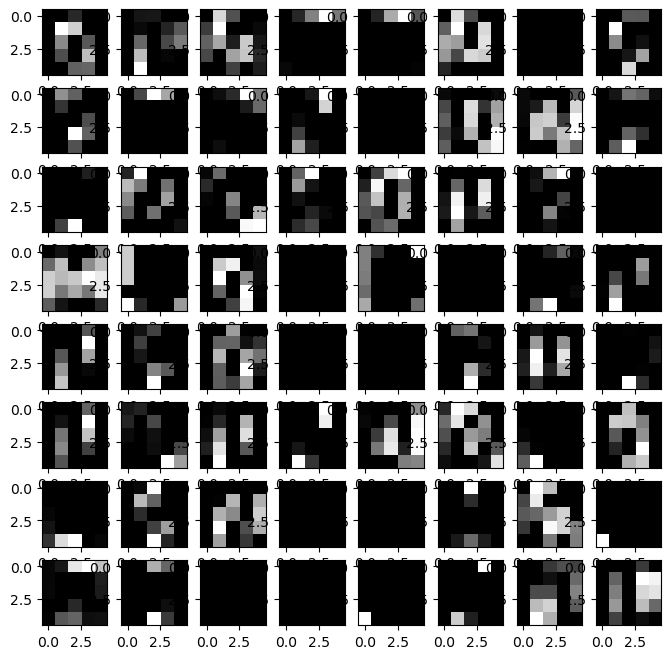

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


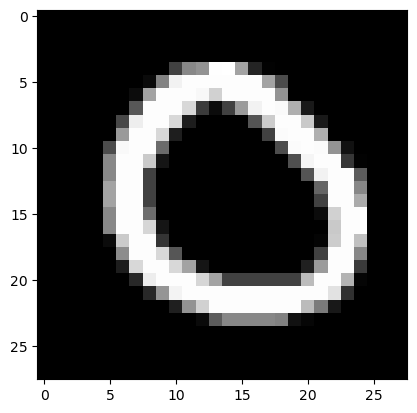

Feature maps of Convo layer 1


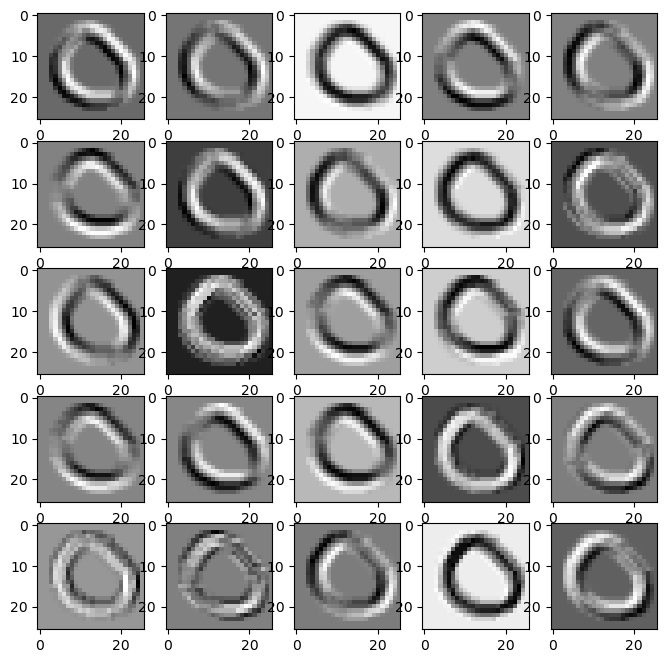

Feature maps of Activation layer 1


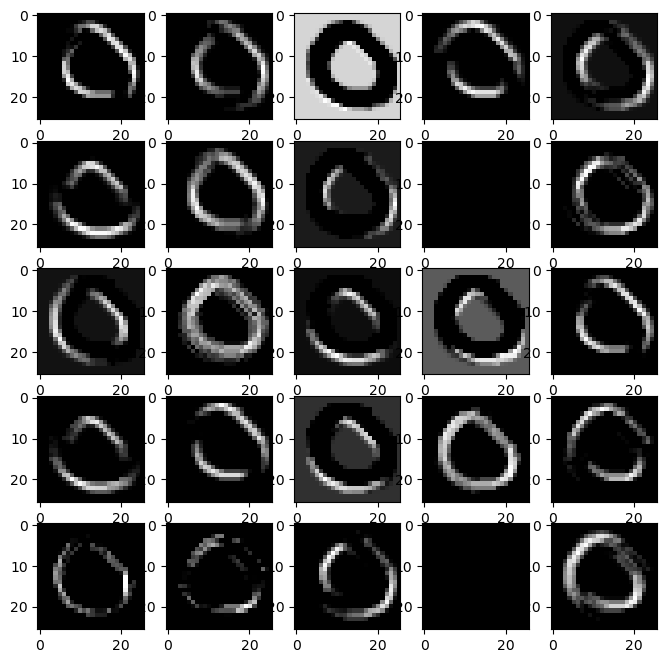

Feature maps of Pooling layer 1


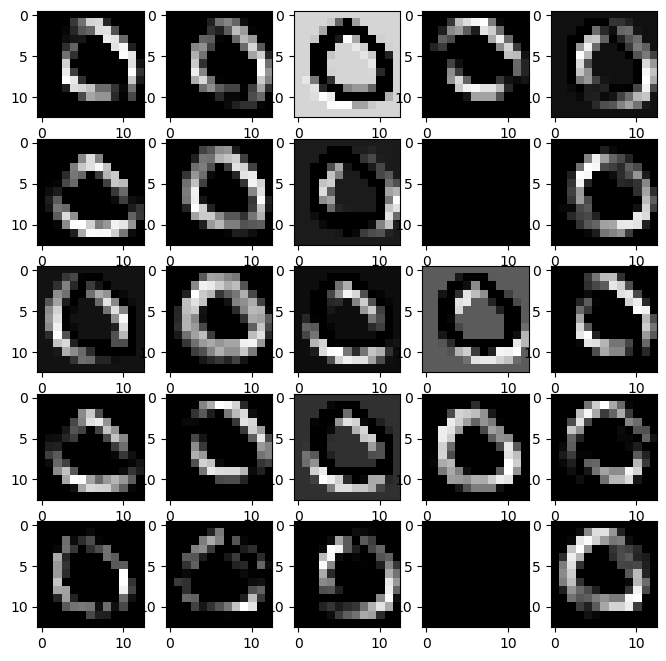

Feature maps of Convo layer 2


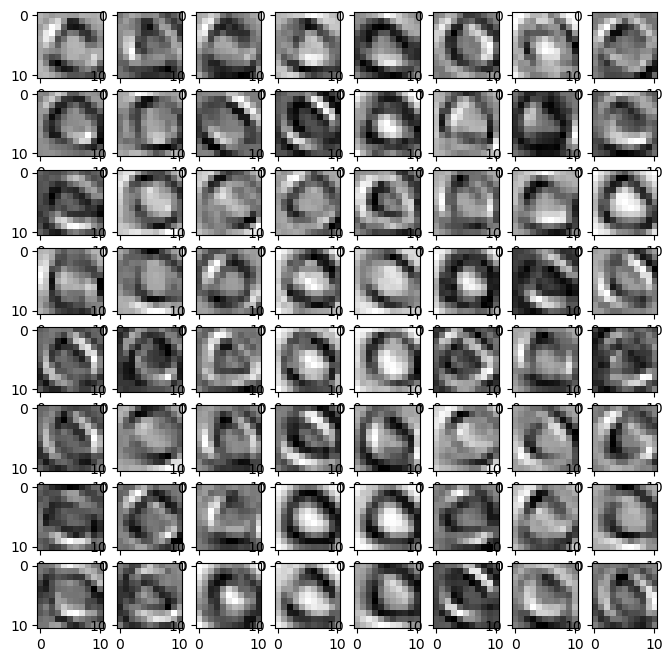

Feature maps of Activation layer 2


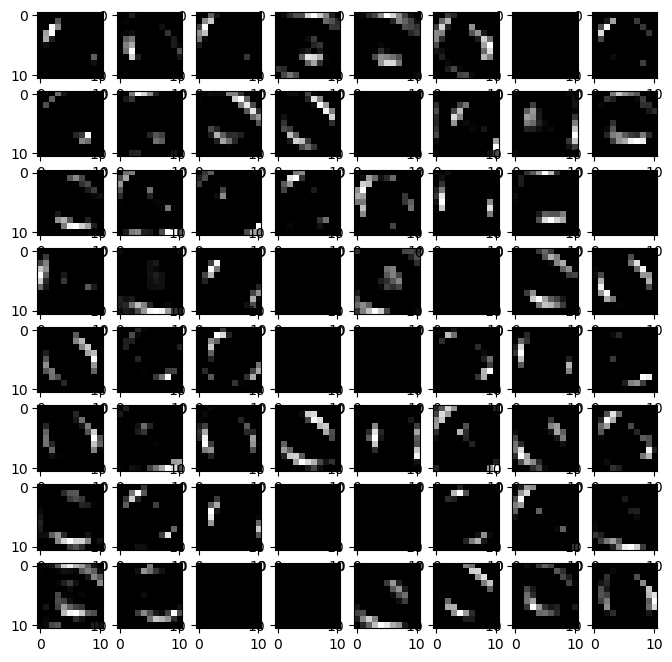

Feature maps of Pooling layer 2


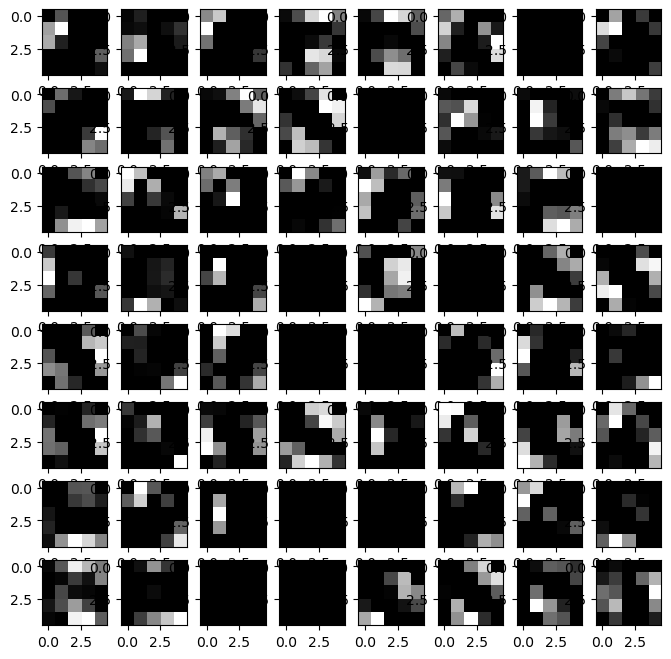

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


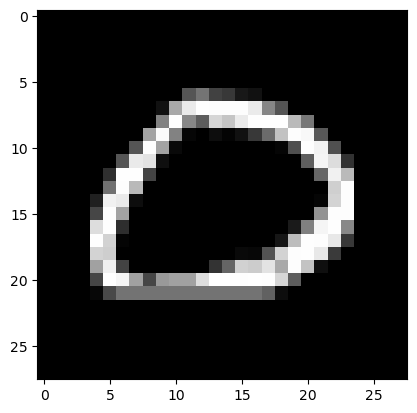

Feature maps of Convo layer 1


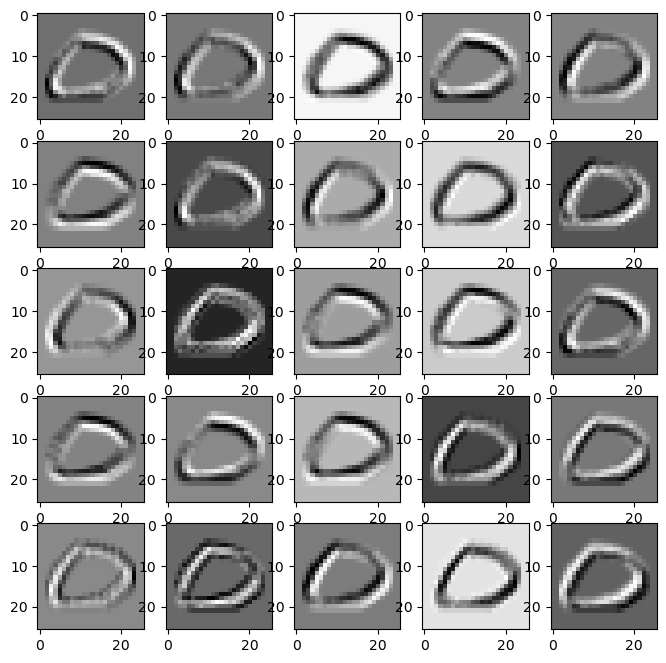

Feature maps of Activation layer 1


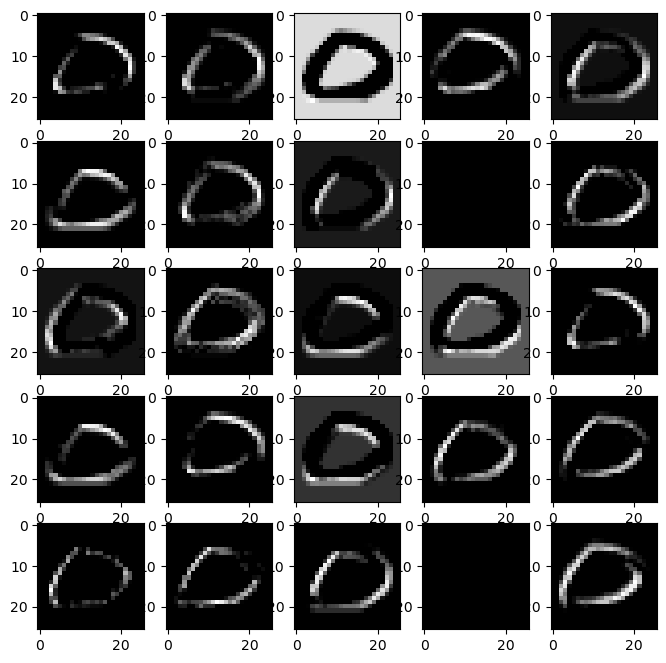

Feature maps of Pooling layer 1


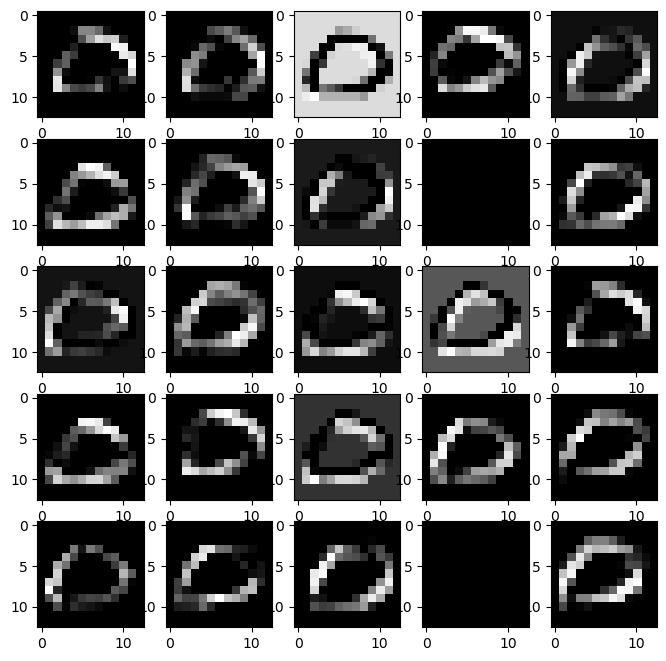

Feature maps of Convo layer 2


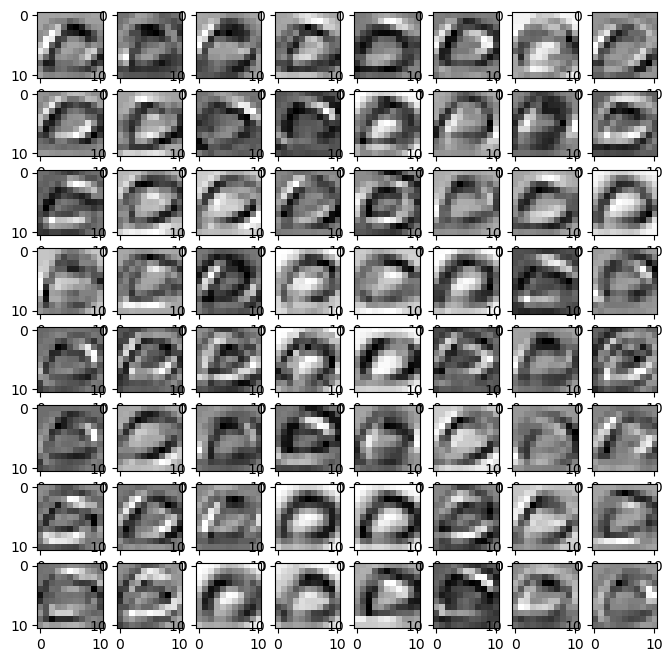

Feature maps of Activation layer 2


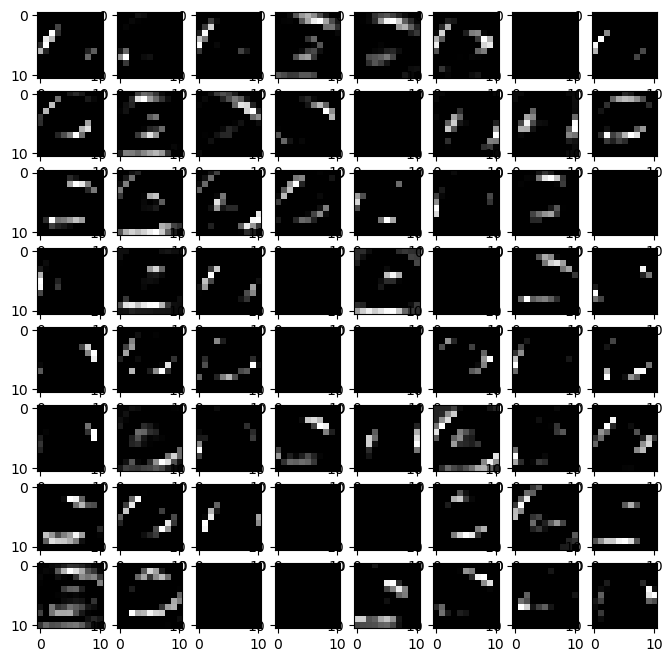

Feature maps of Pooling layer 2


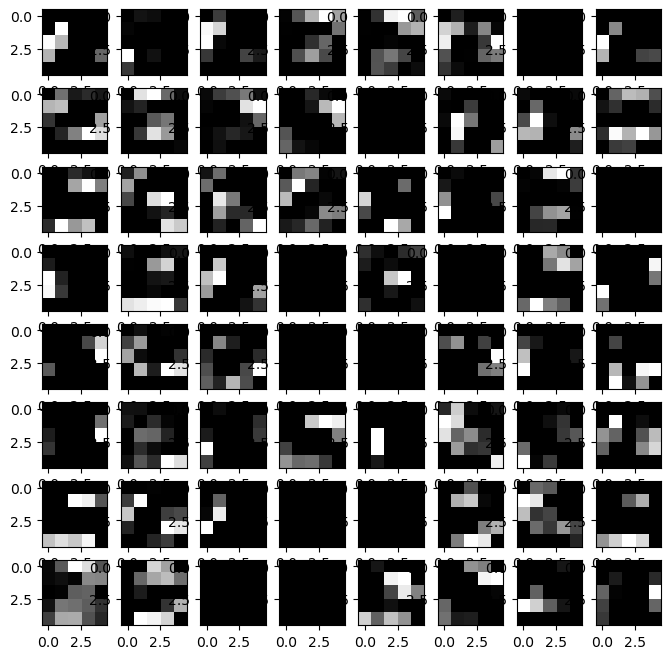

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


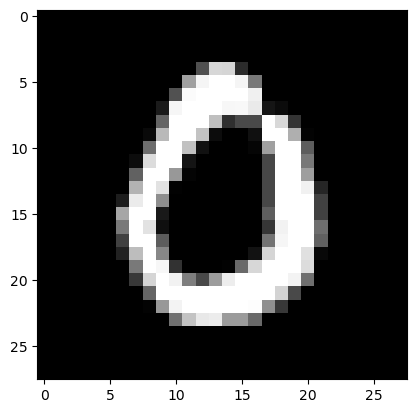

Feature maps of Convo layer 1


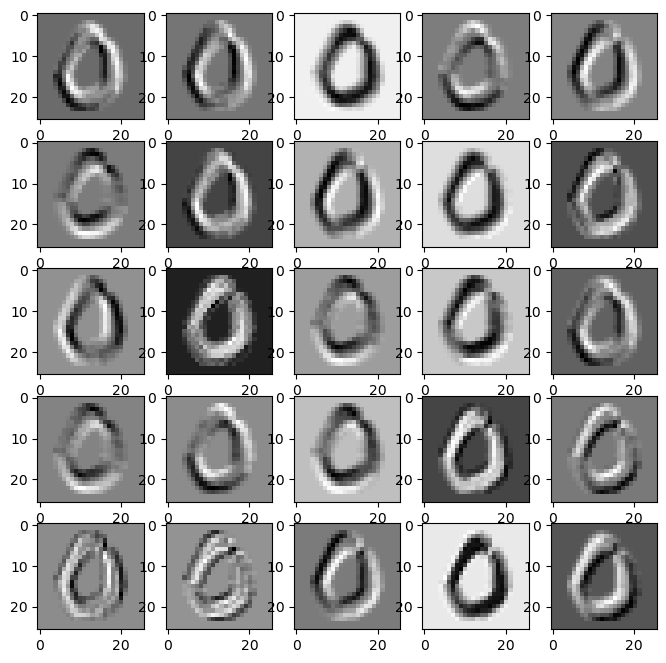

Feature maps of Activation layer 1


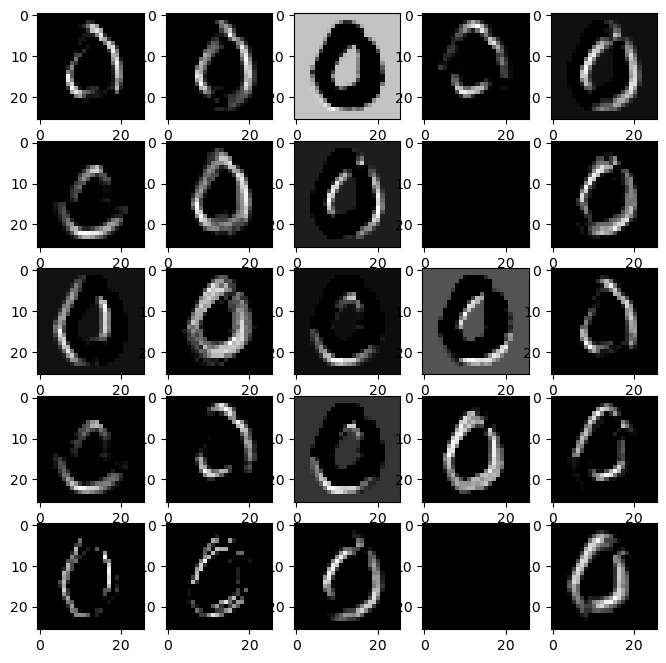

Feature maps of Pooling layer 1


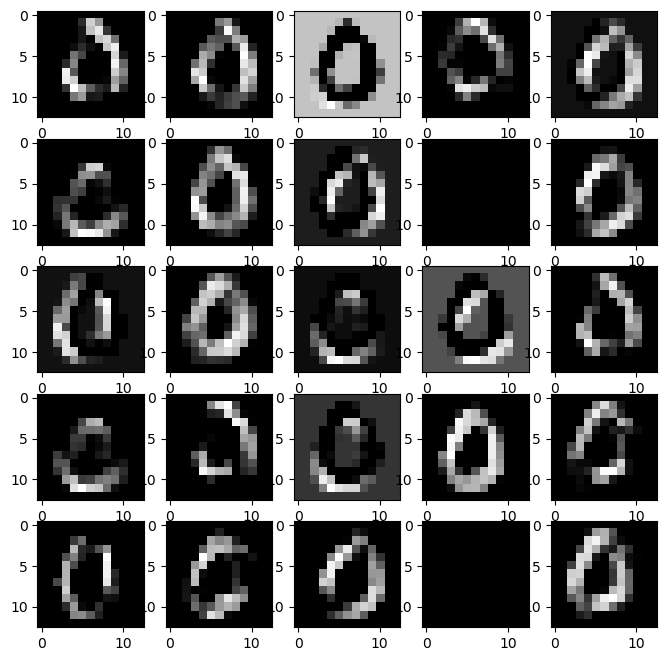

Feature maps of Convo layer 2


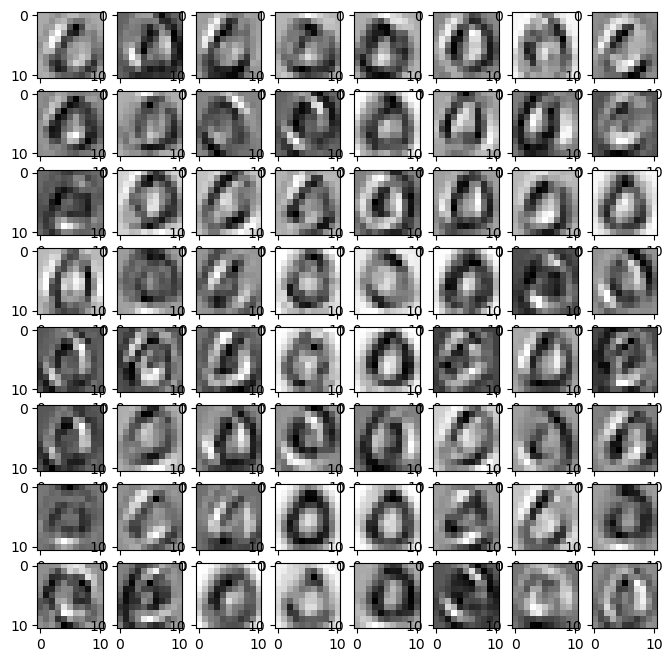

Feature maps of Activation layer 2


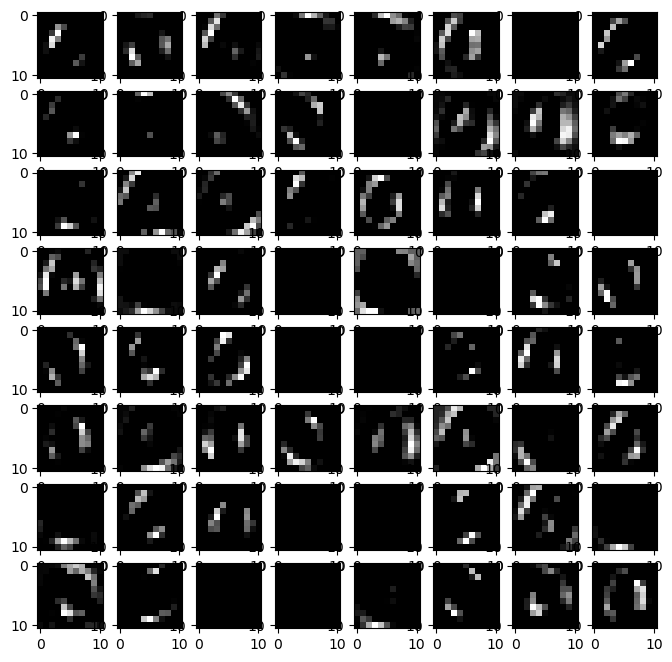

Feature maps of Pooling layer 2


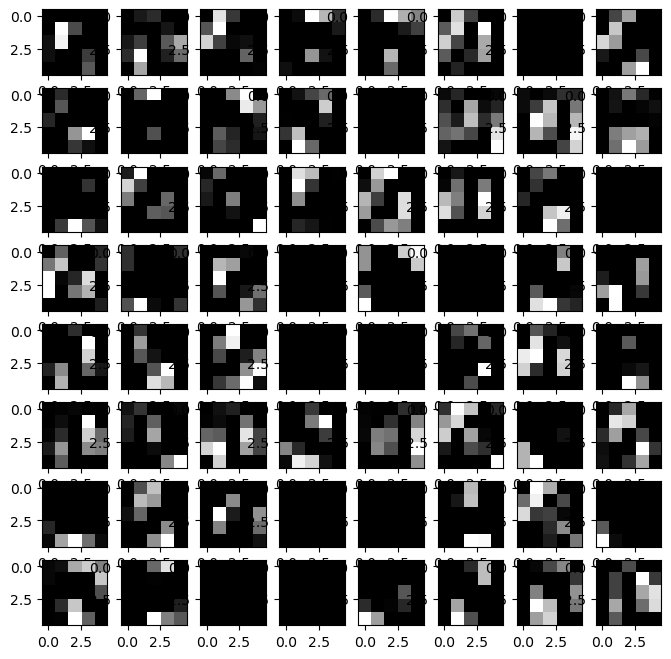

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


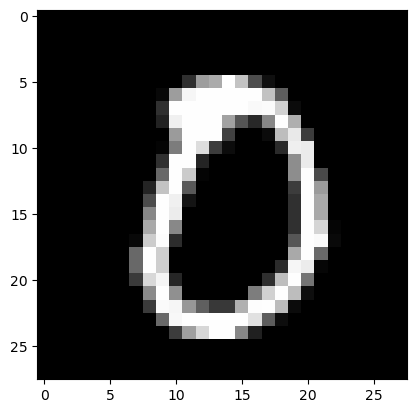

Feature maps of Convo layer 1


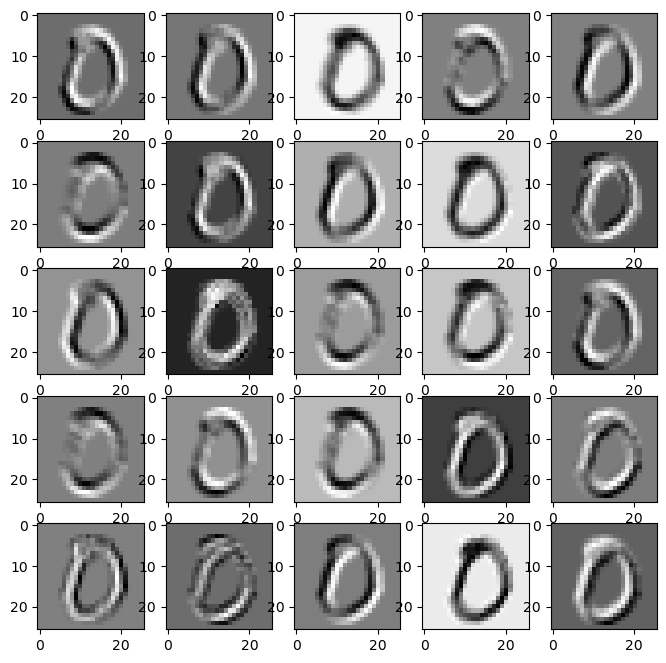

Feature maps of Activation layer 1


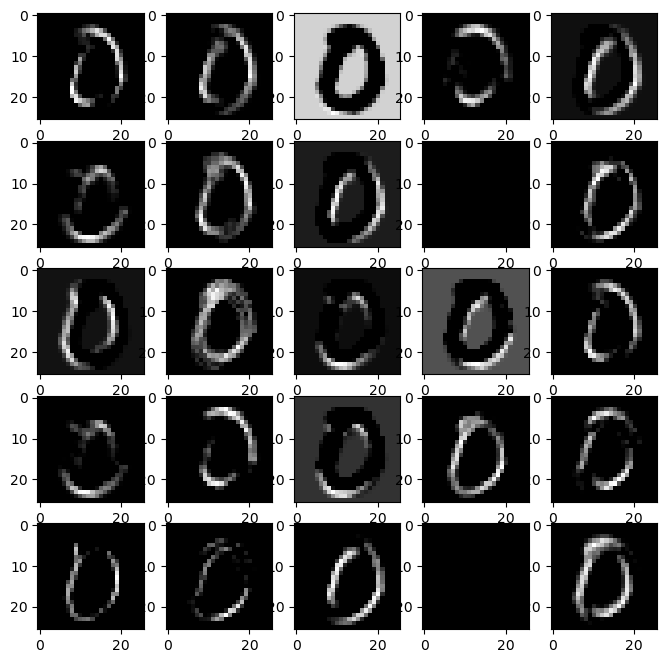

Feature maps of Pooling layer 1


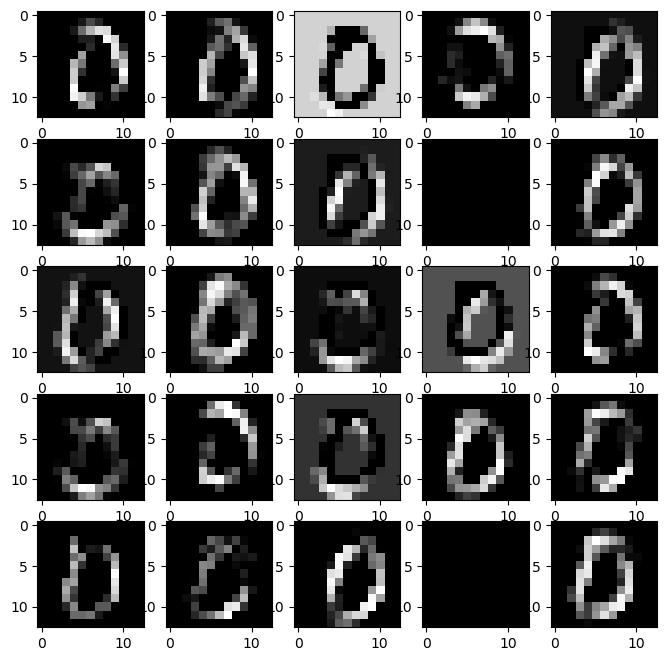

Feature maps of Convo layer 2


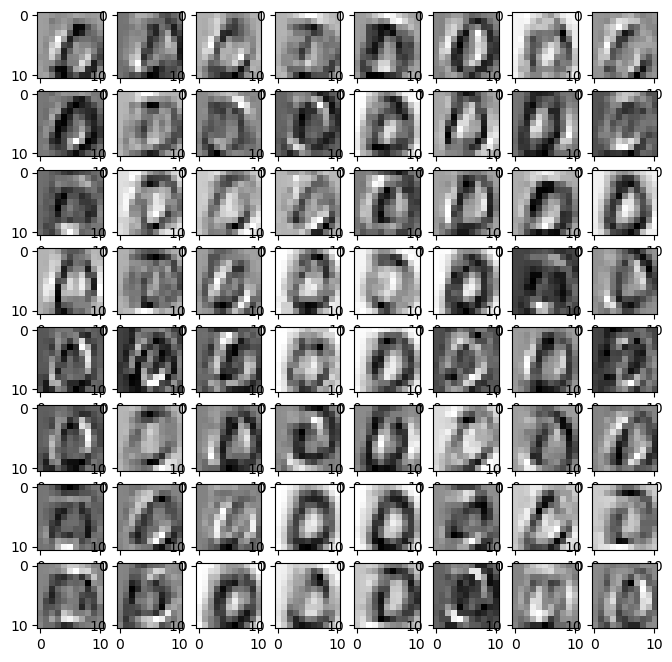

Feature maps of Activation layer 2


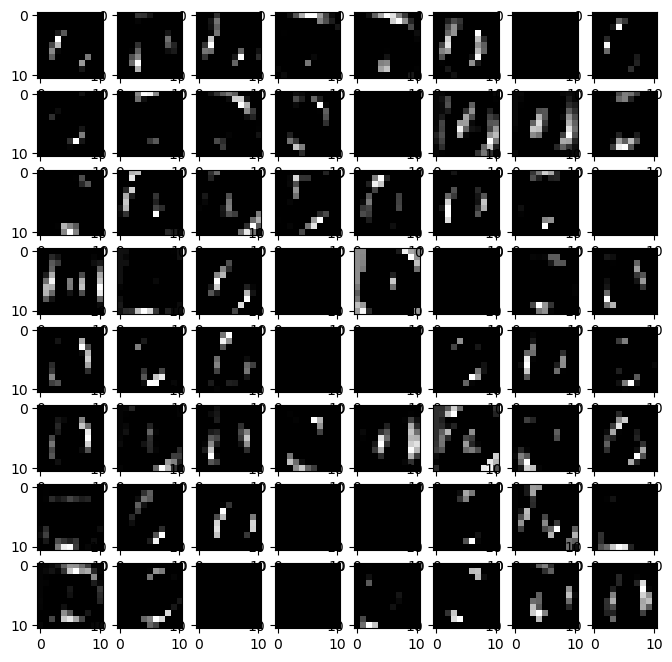

Feature maps of Pooling layer 2


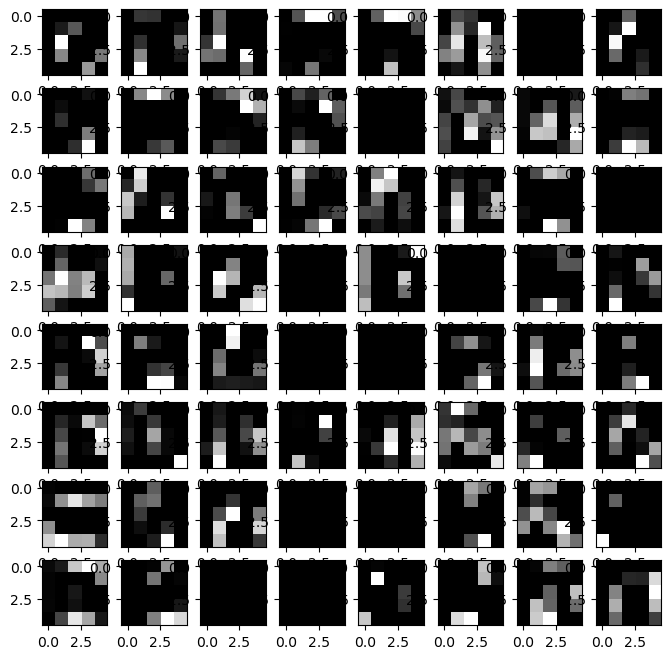

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


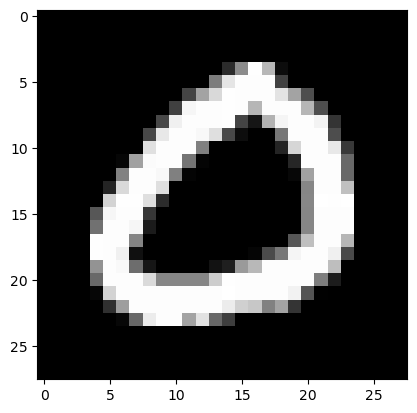

Feature maps of Convo layer 1


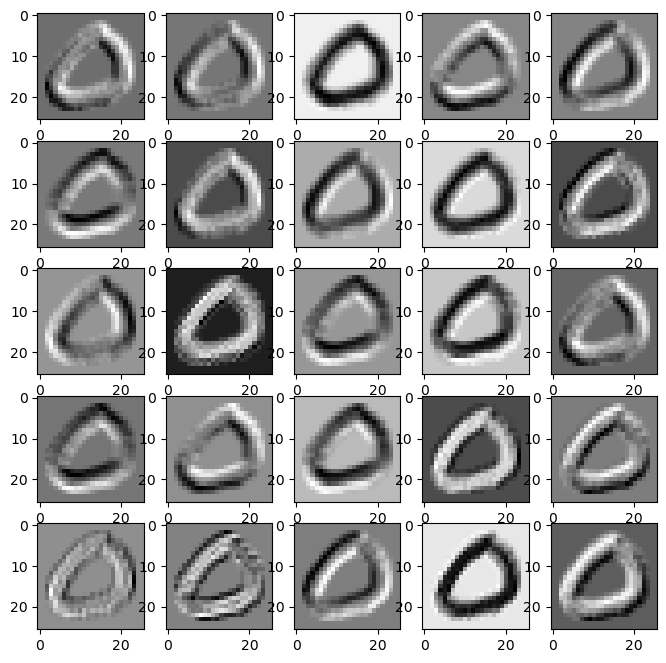

Feature maps of Activation layer 1


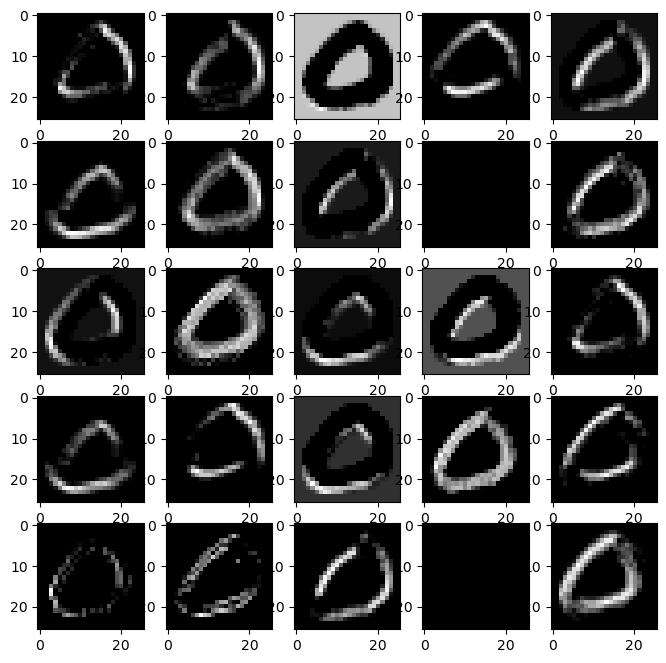

Feature maps of Pooling layer 1


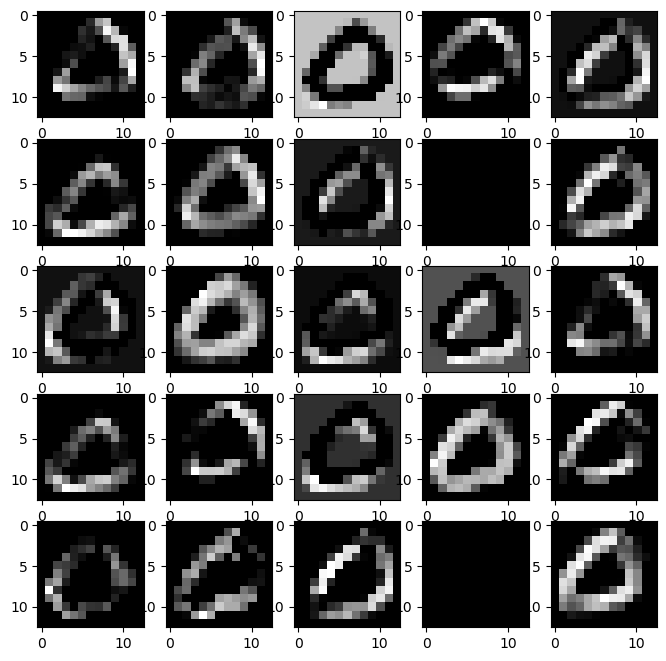

Feature maps of Convo layer 2


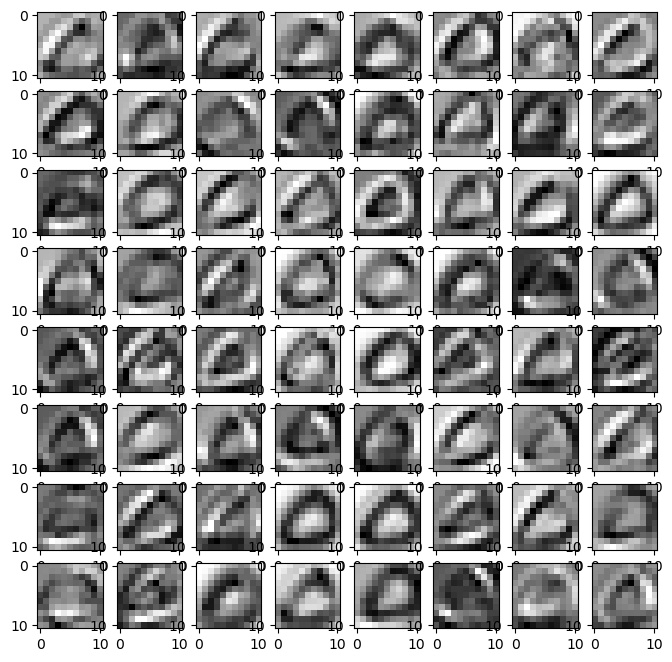

Feature maps of Activation layer 2


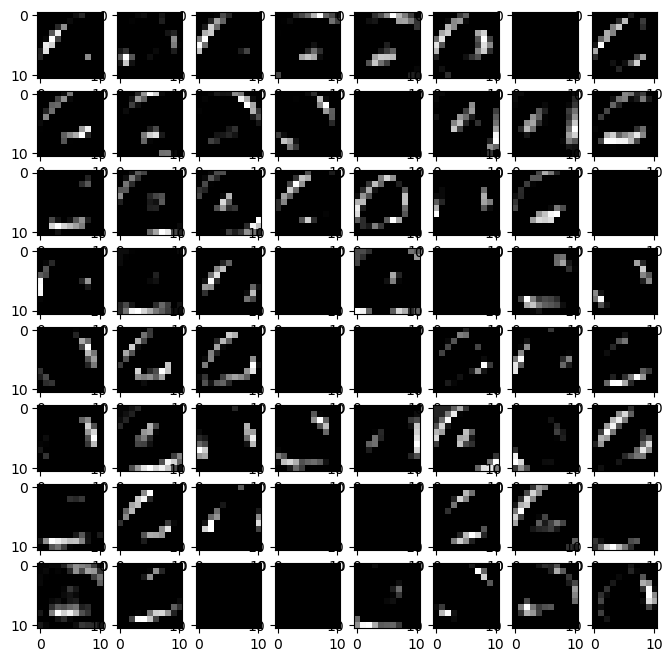

Feature maps of Pooling layer 2


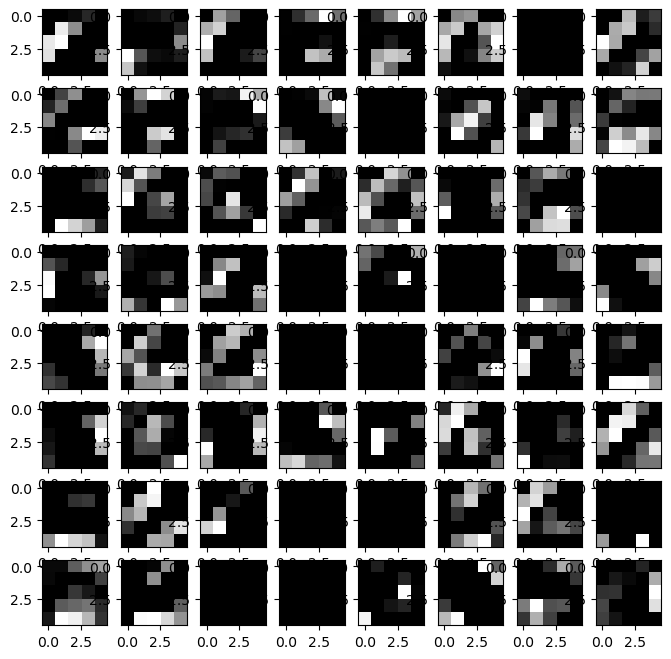

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
Original Image


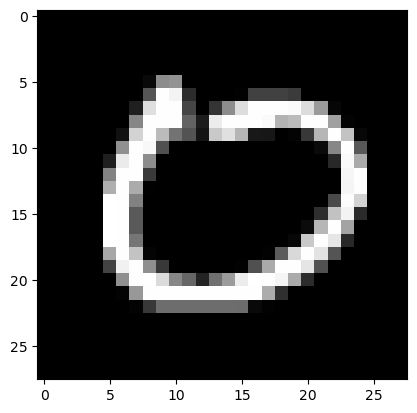

Feature maps of Convo layer 1


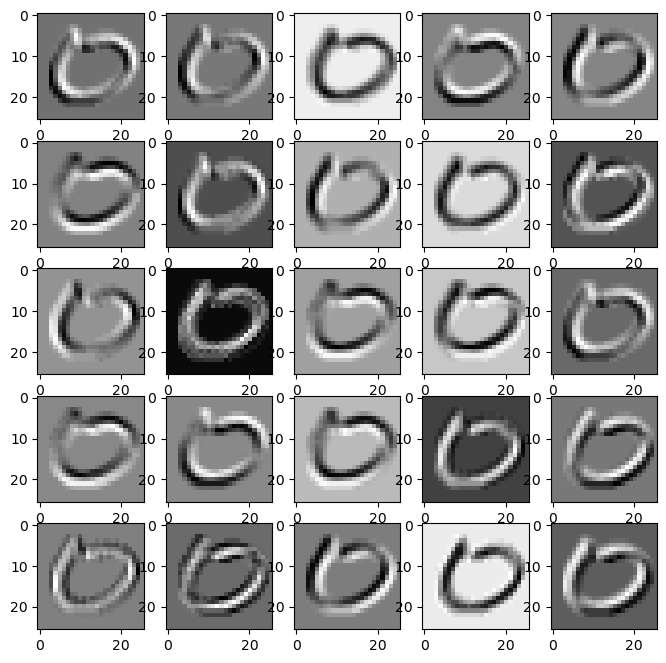

Feature maps of Activation layer 1


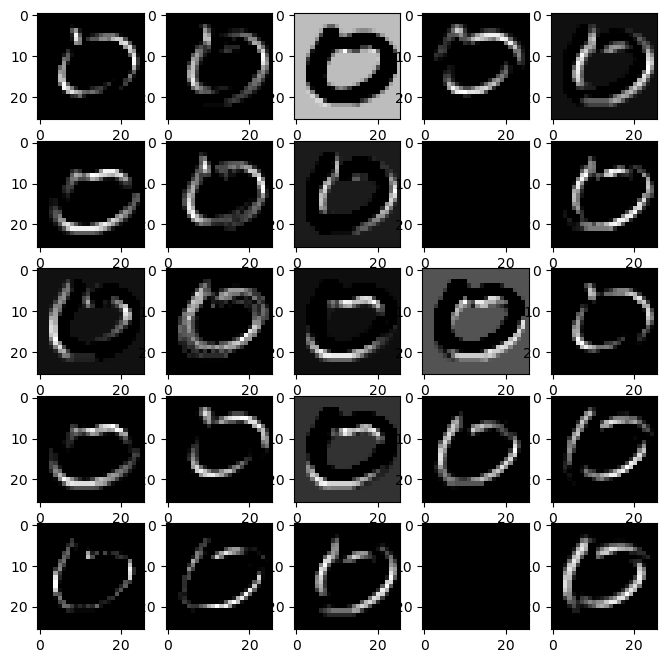

Feature maps of Pooling layer 1


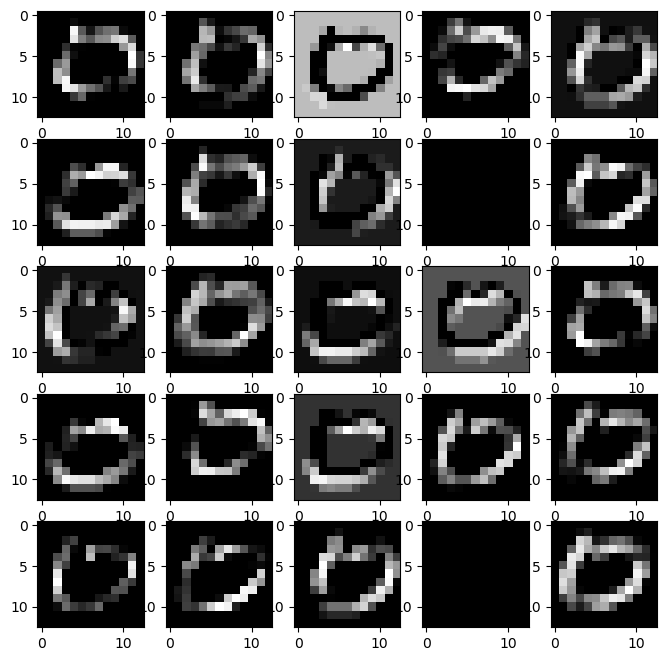

Feature maps of Convo layer 2


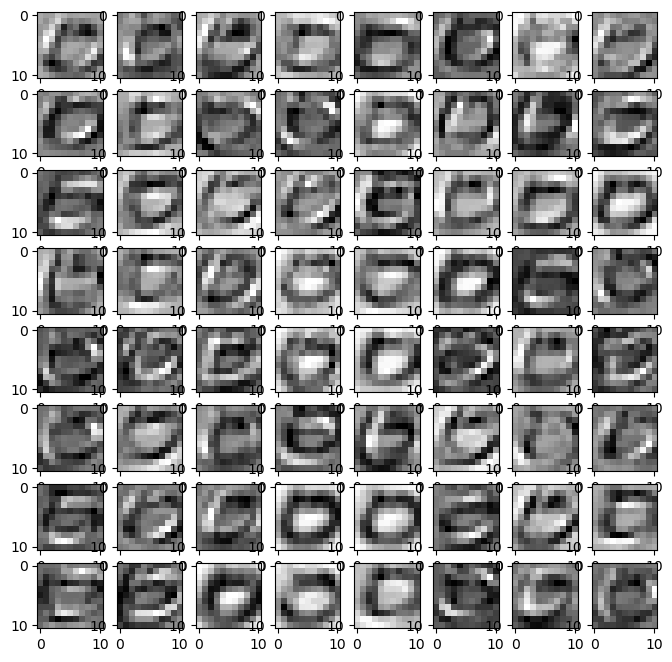

Feature maps of Activation layer 2


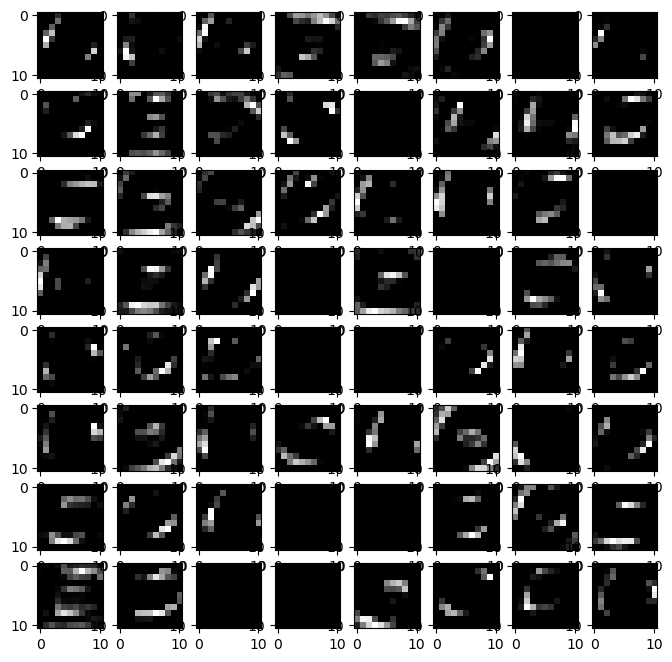

Feature maps of Pooling layer 2


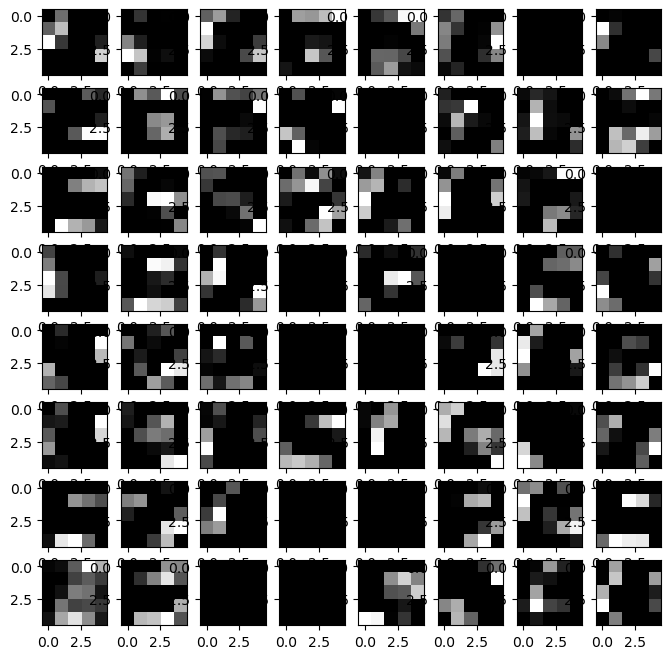

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


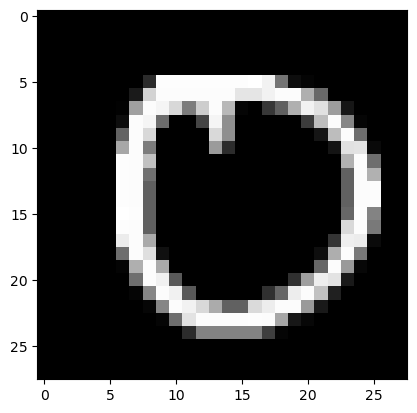

Feature maps of Convo layer 1


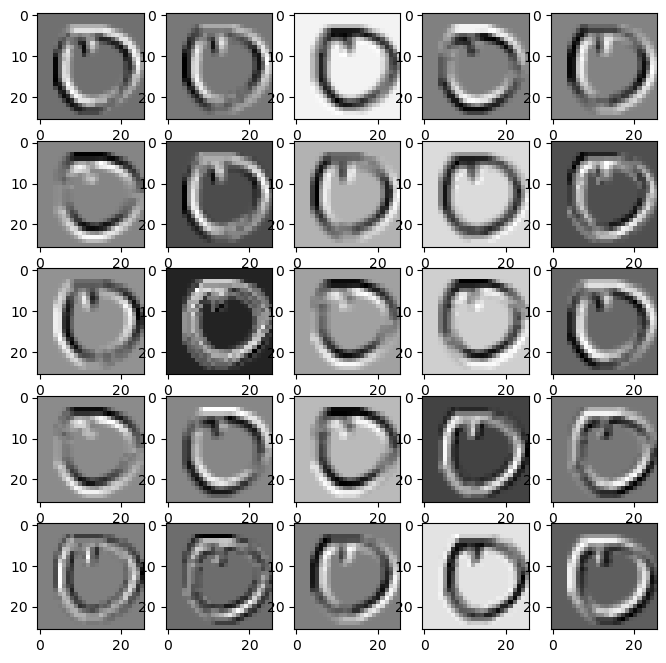

Feature maps of Activation layer 1


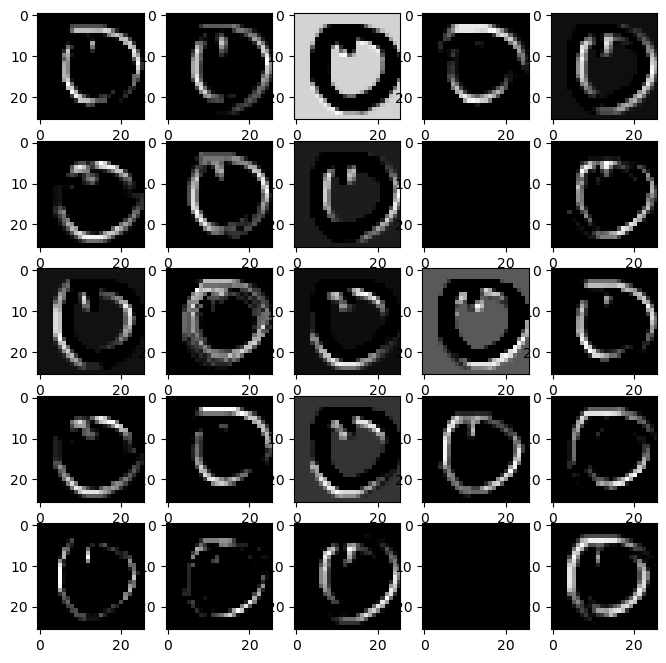

Feature maps of Pooling layer 1


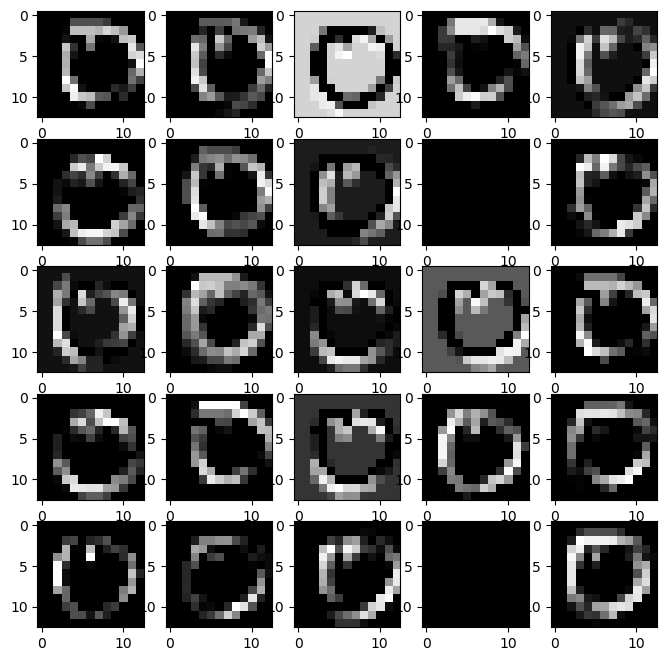

Feature maps of Convo layer 2


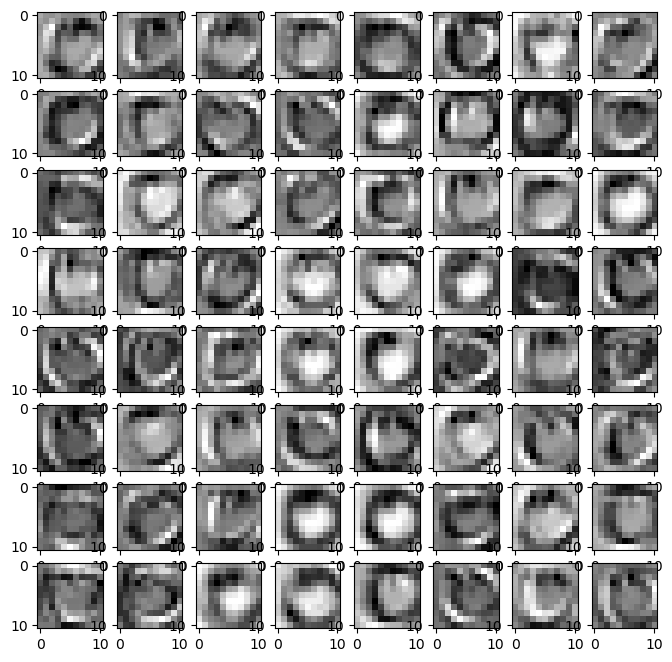

Feature maps of Activation layer 2


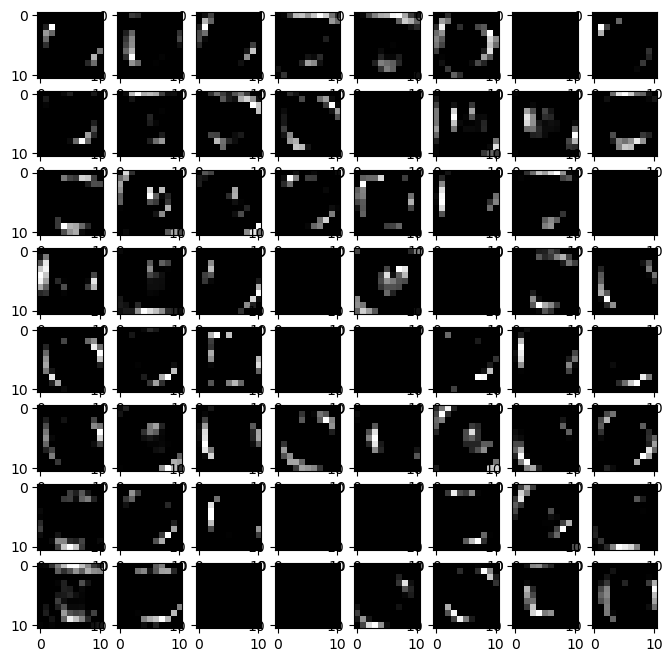

Feature maps of Pooling layer 2


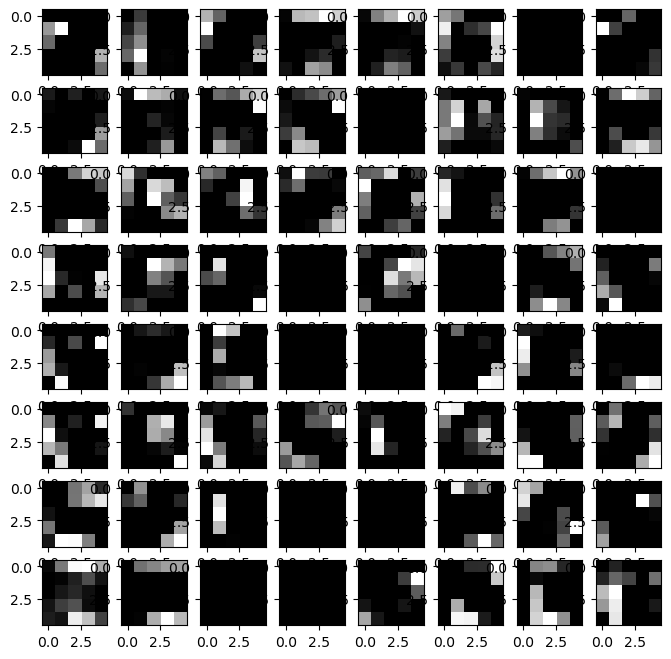

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


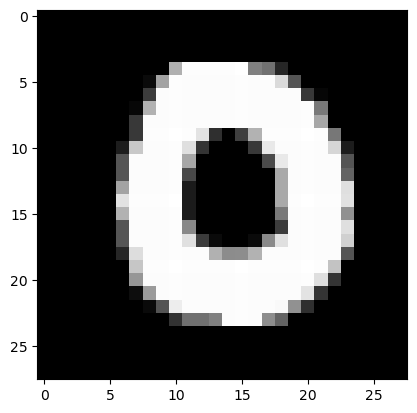

Feature maps of Convo layer 1


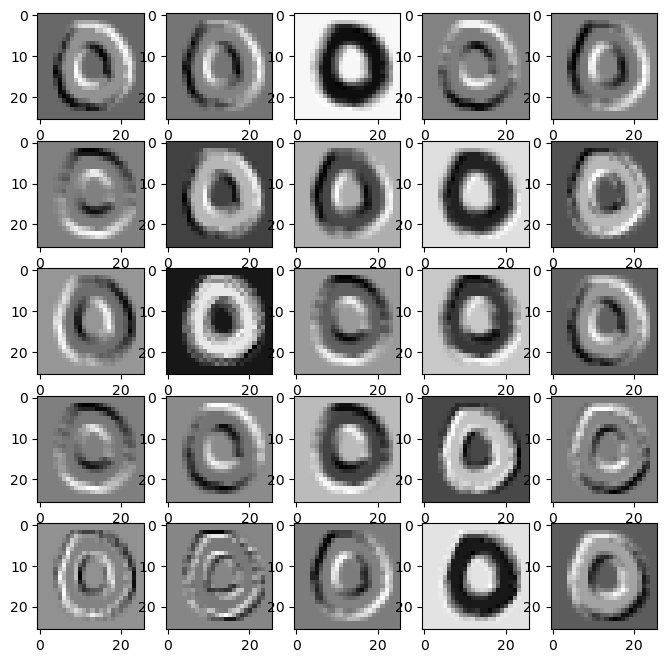

Feature maps of Activation layer 1


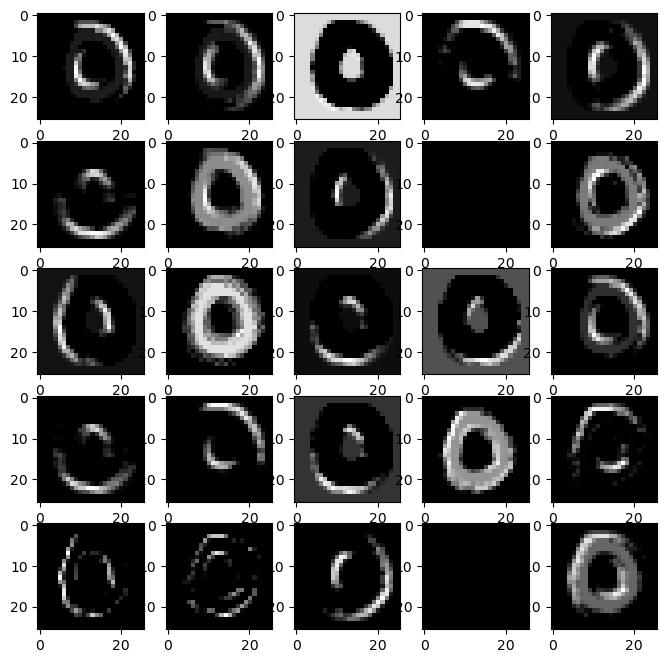

Feature maps of Pooling layer 1


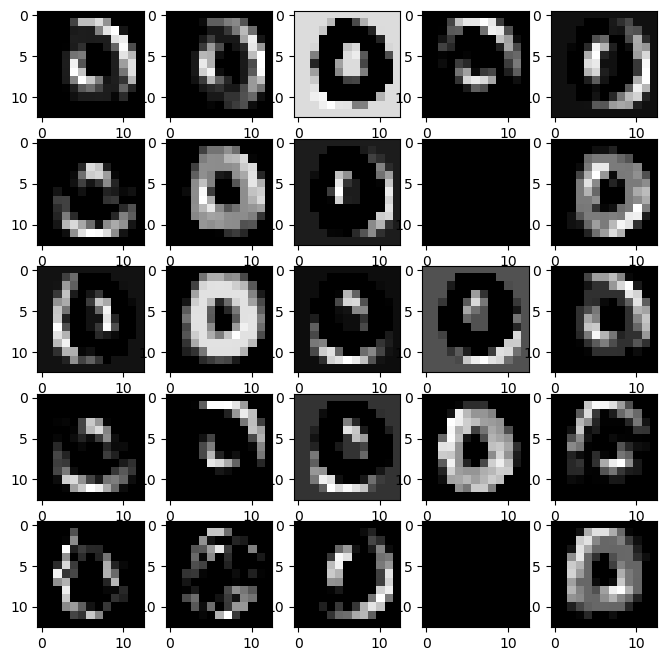

Feature maps of Convo layer 2


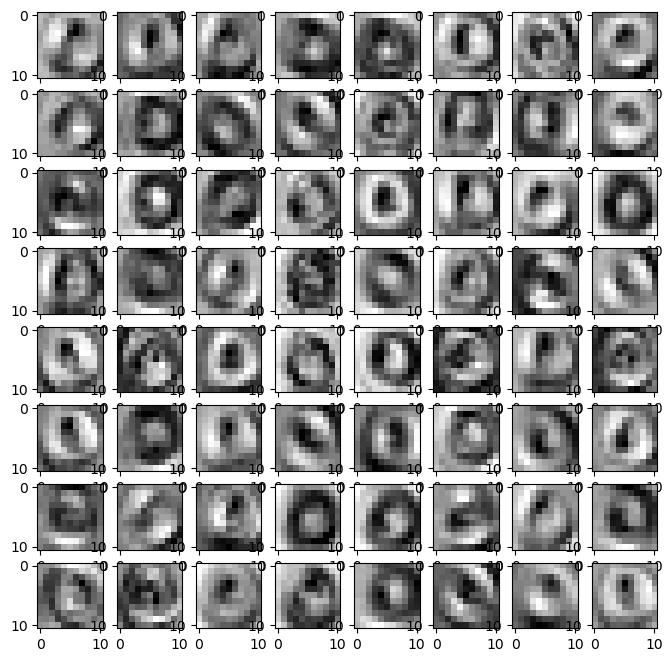

Feature maps of Activation layer 2


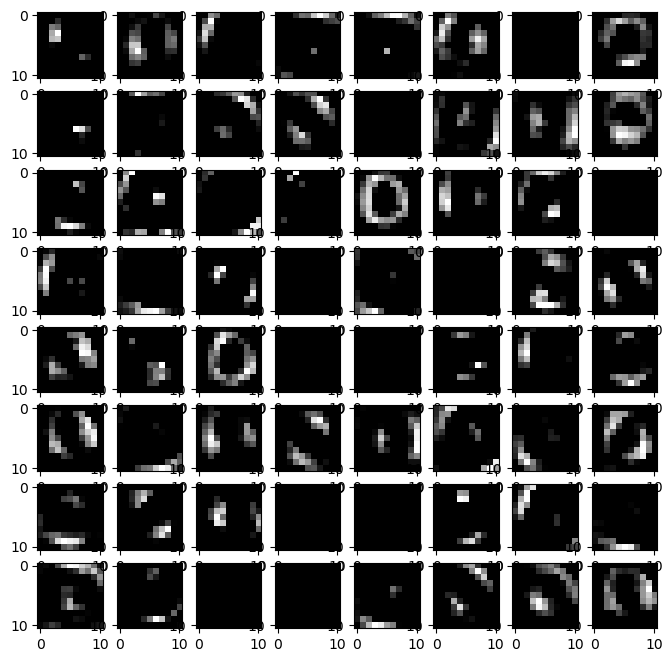

Feature maps of Pooling layer 2


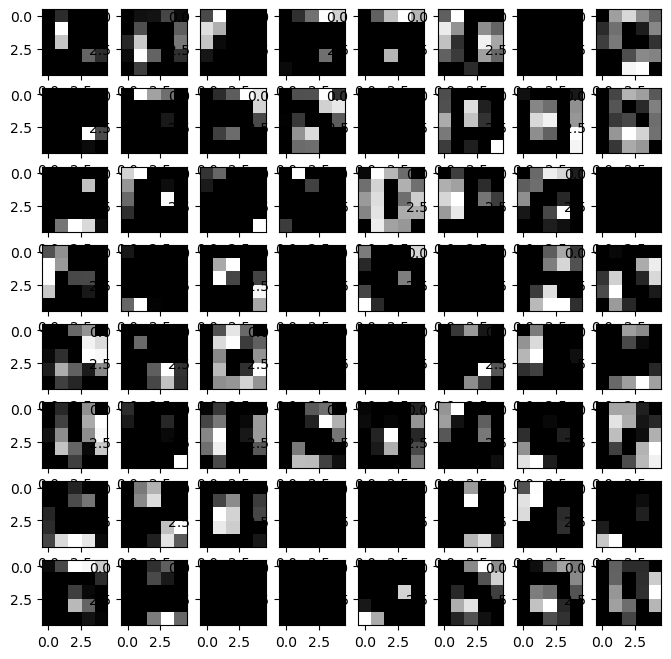

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
Original Image


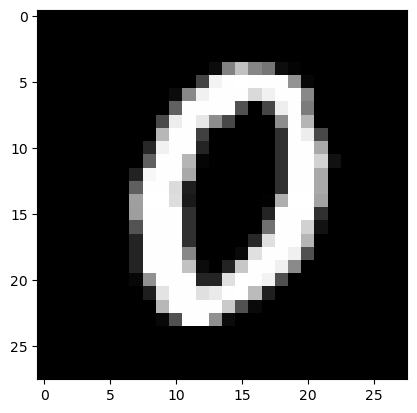

Feature maps of Convo layer 1


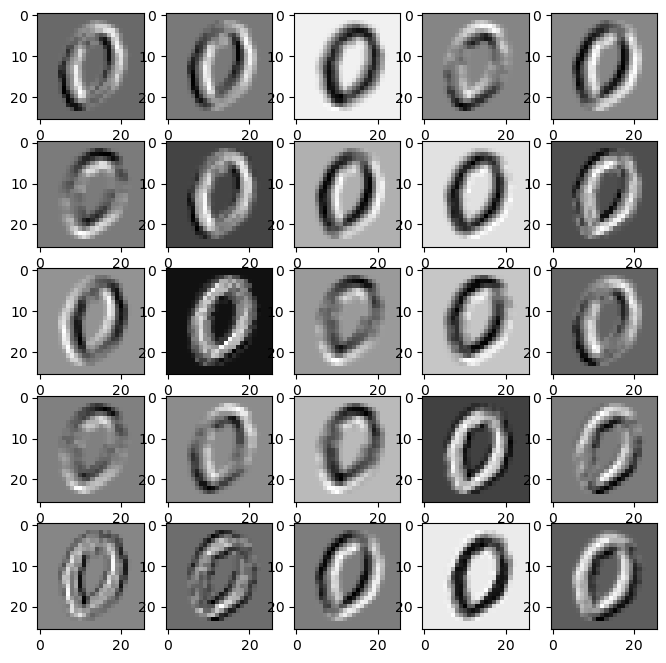

Feature maps of Activation layer 1


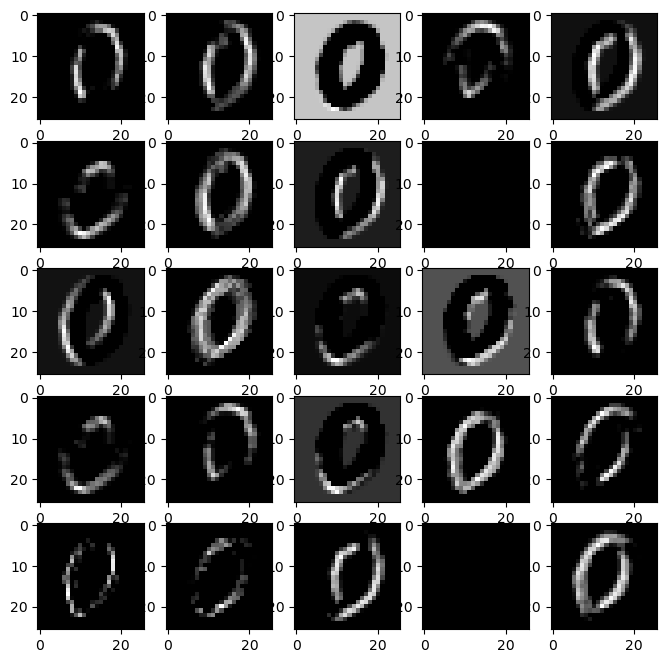

Feature maps of Pooling layer 1


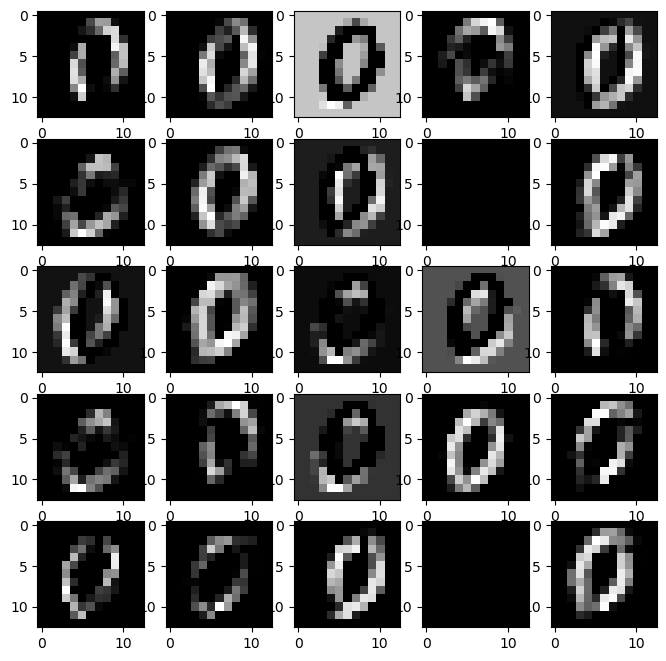

Feature maps of Convo layer 2


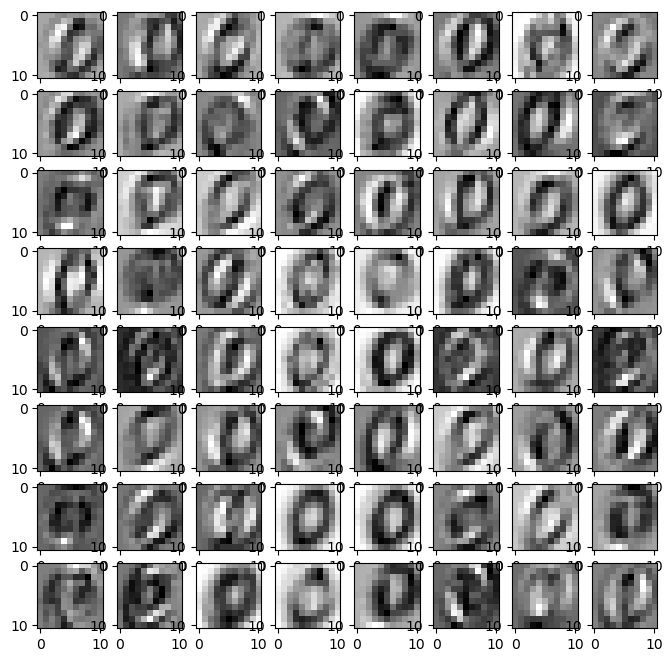

Feature maps of Activation layer 2


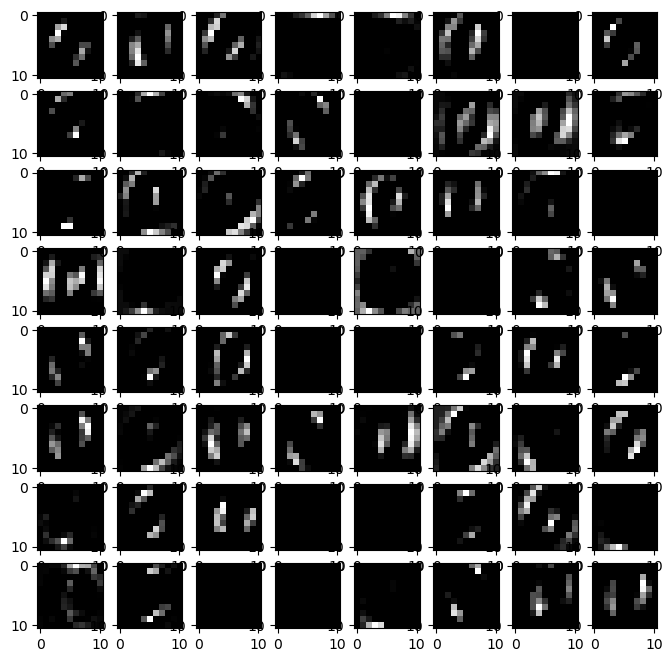

Feature maps of Pooling layer 2


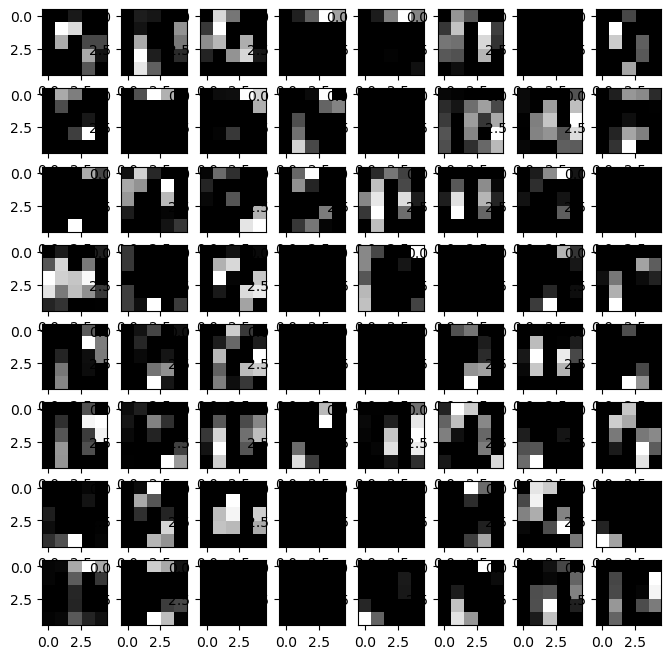

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


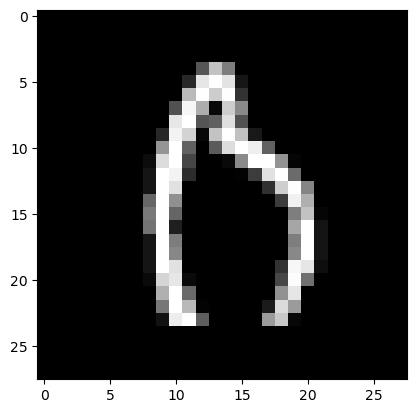

Feature maps of Convo layer 1


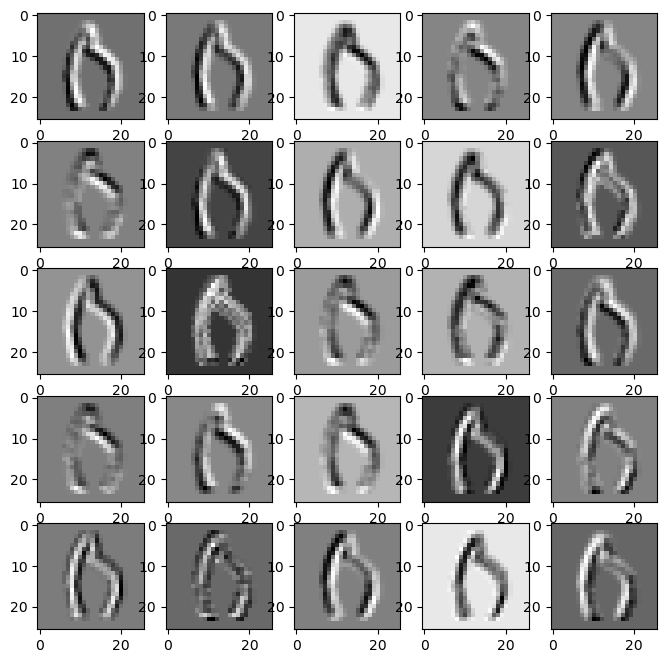

Feature maps of Activation layer 1


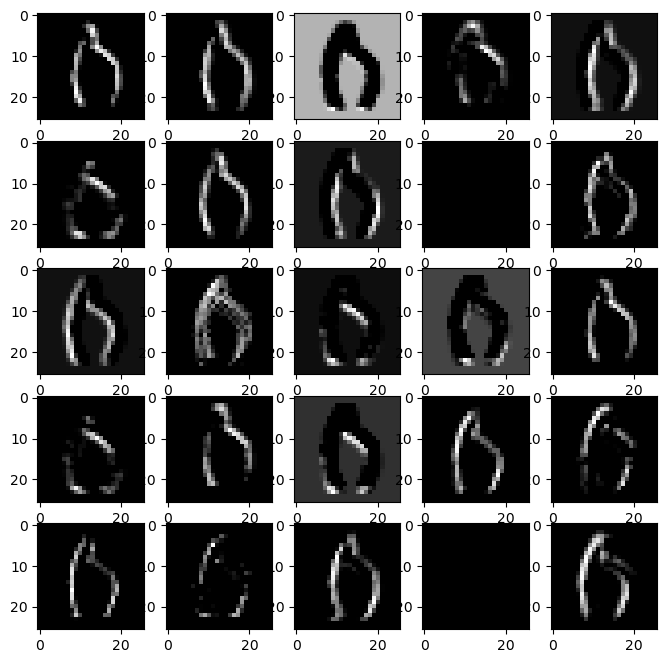

Feature maps of Pooling layer 1


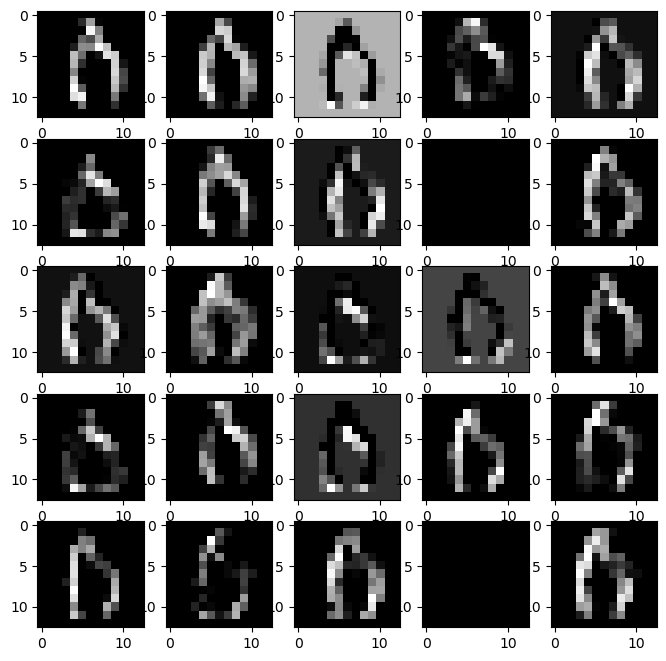

Feature maps of Convo layer 2


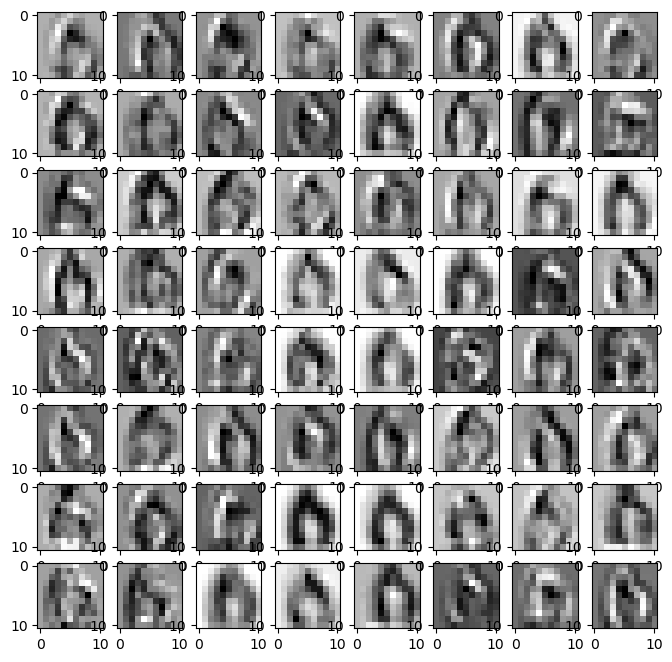

Feature maps of Activation layer 2


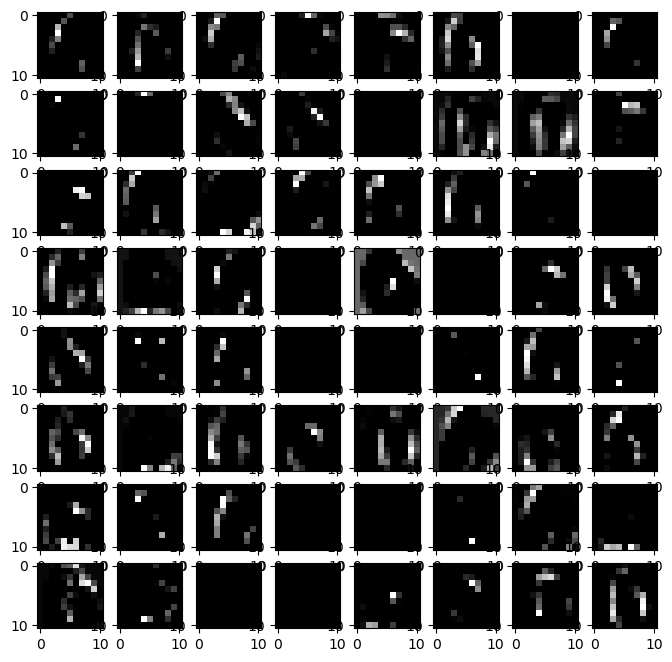

Feature maps of Pooling layer 2


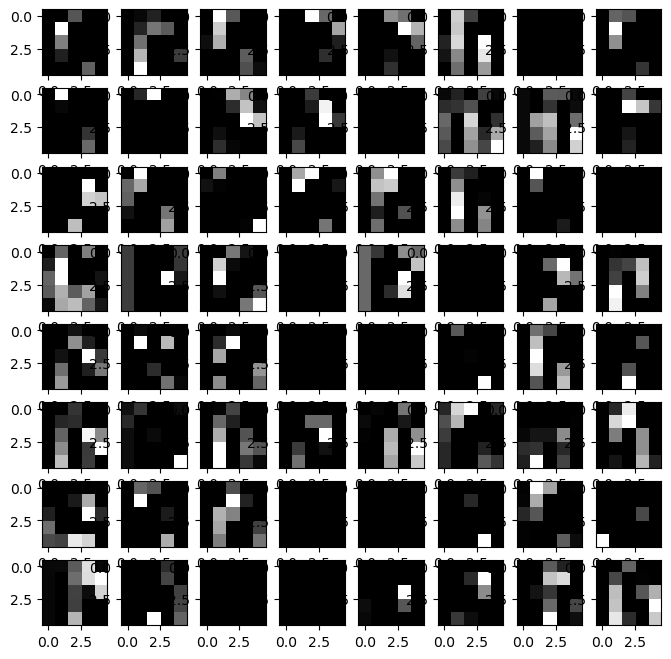

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


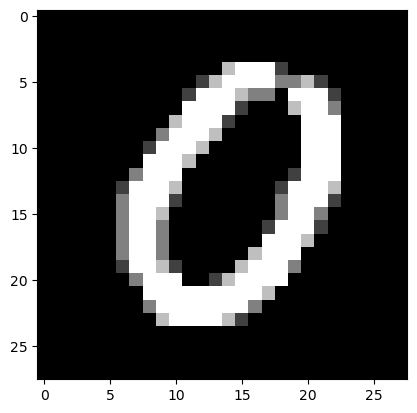

Feature maps of Convo layer 1


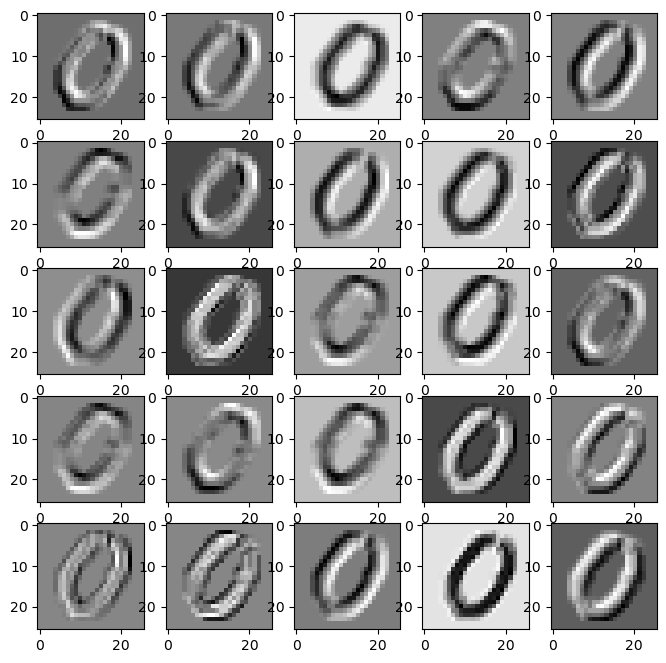

Feature maps of Activation layer 1


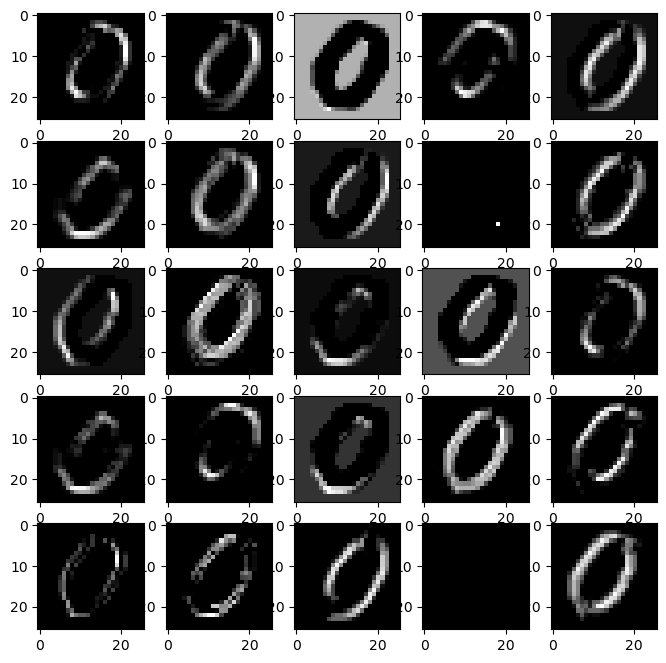

Feature maps of Pooling layer 1


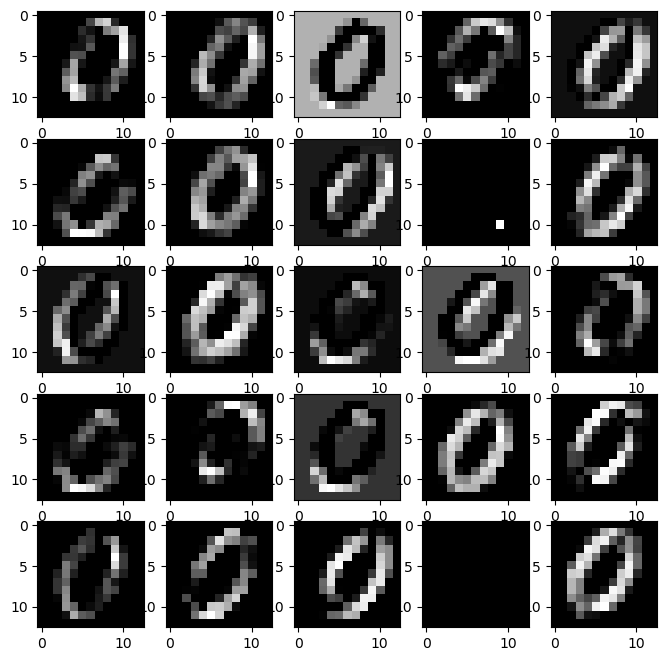

Feature maps of Convo layer 2


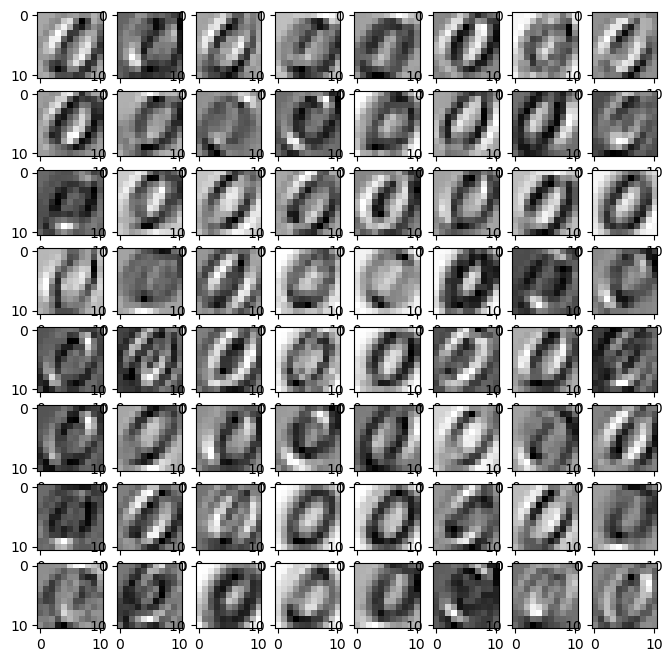

Feature maps of Activation layer 2


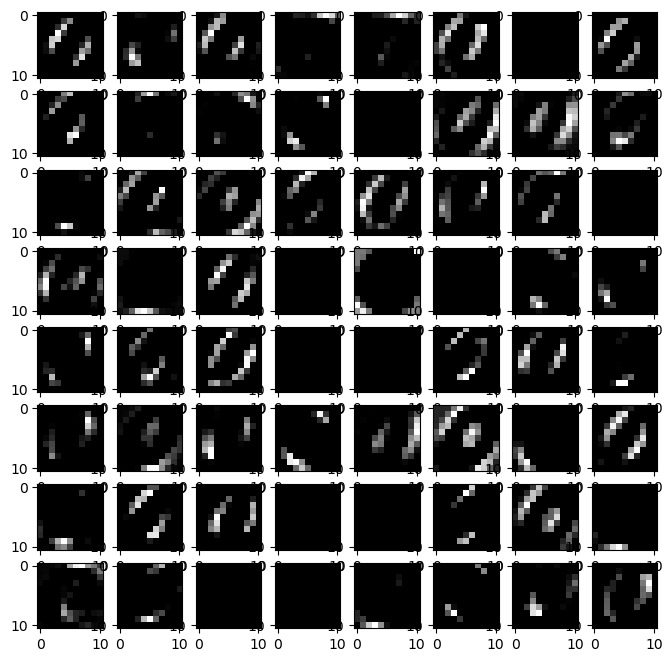

Feature maps of Pooling layer 2


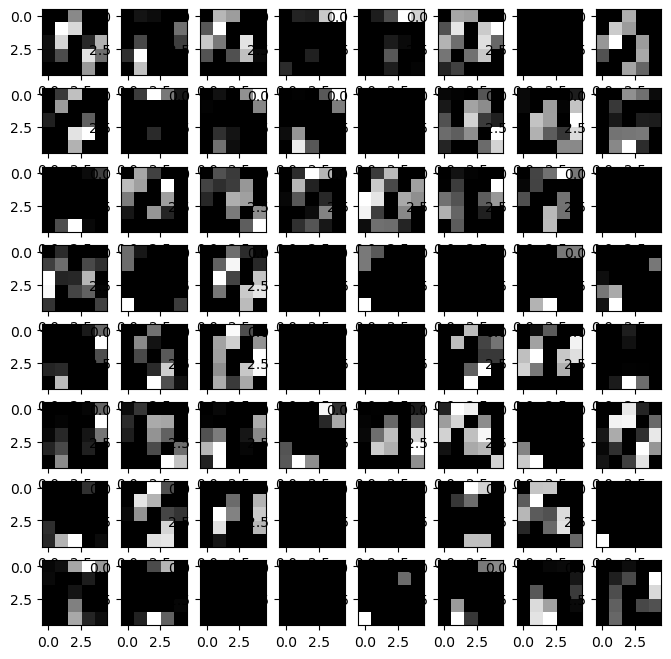

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


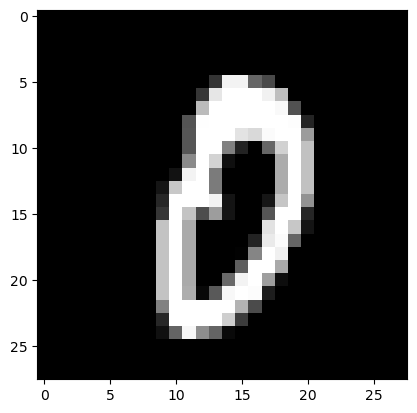

Feature maps of Convo layer 1


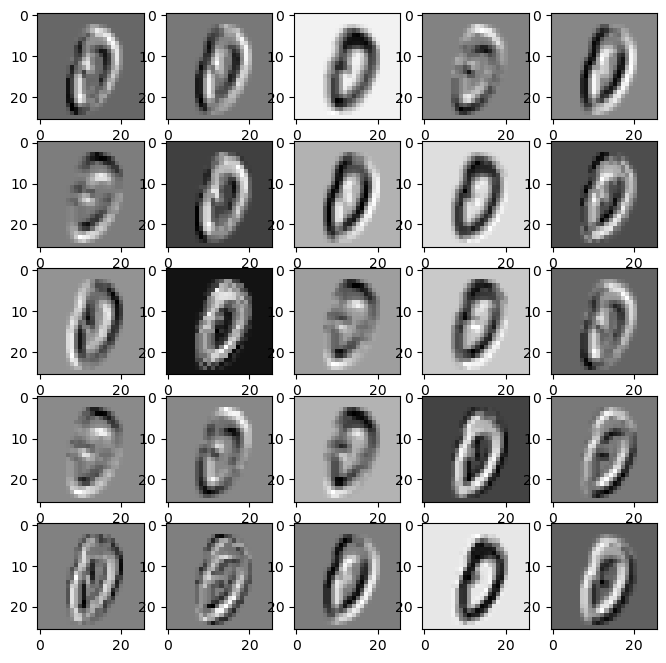

Feature maps of Activation layer 1


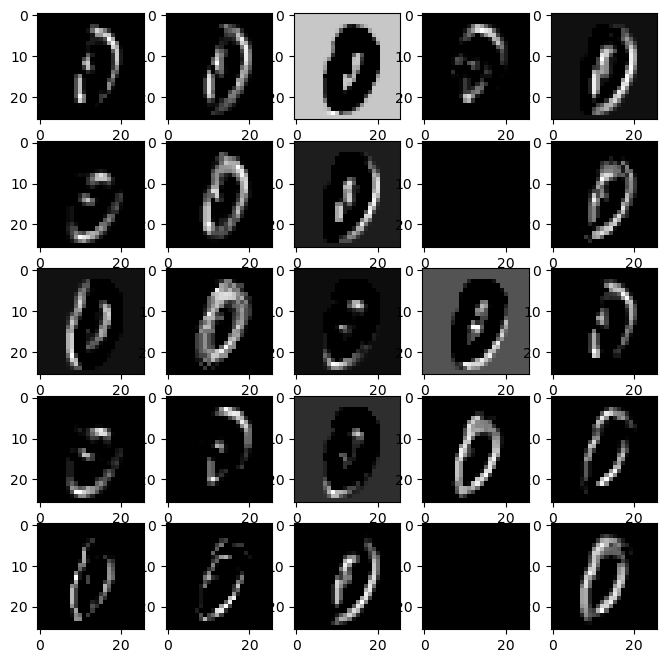

Feature maps of Pooling layer 1


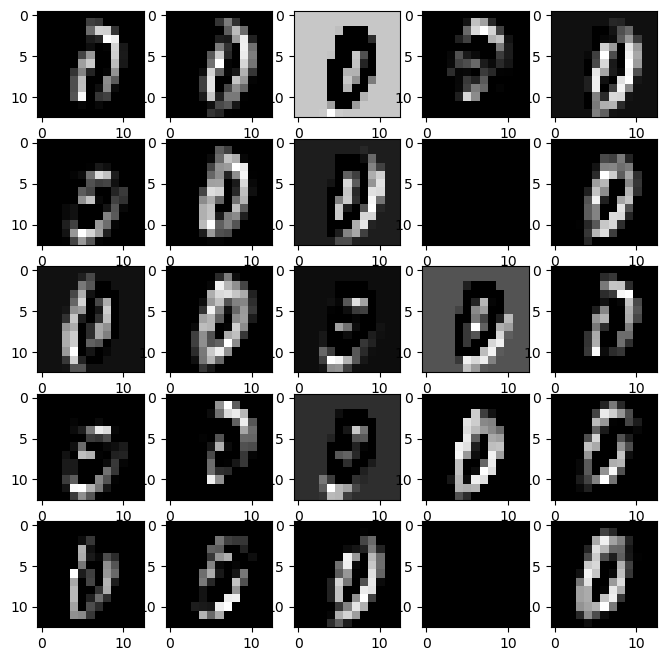

Feature maps of Convo layer 2


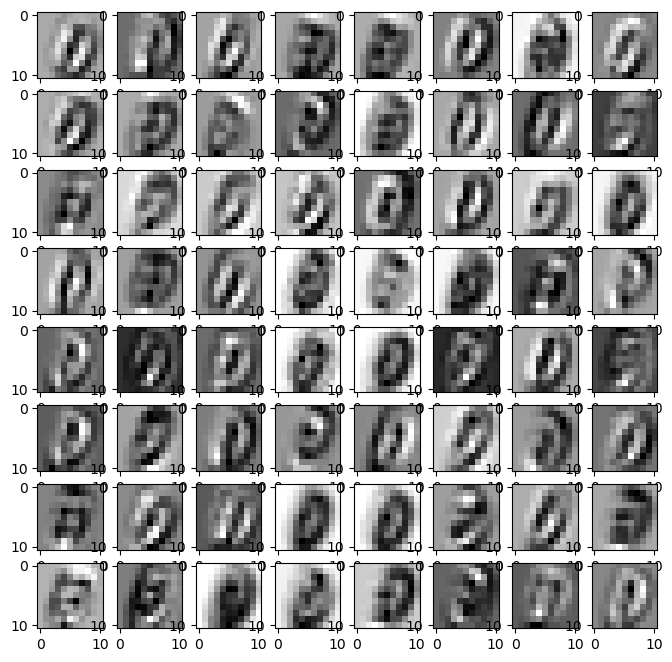

Feature maps of Activation layer 2


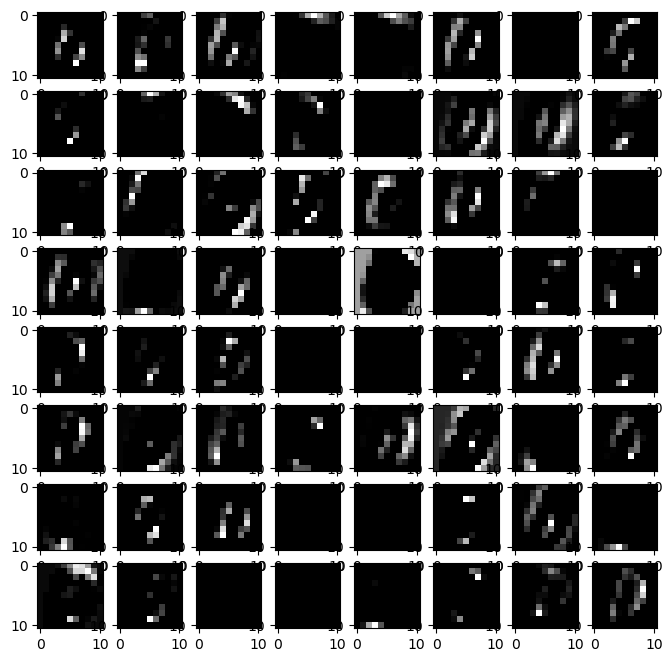

Feature maps of Pooling layer 2


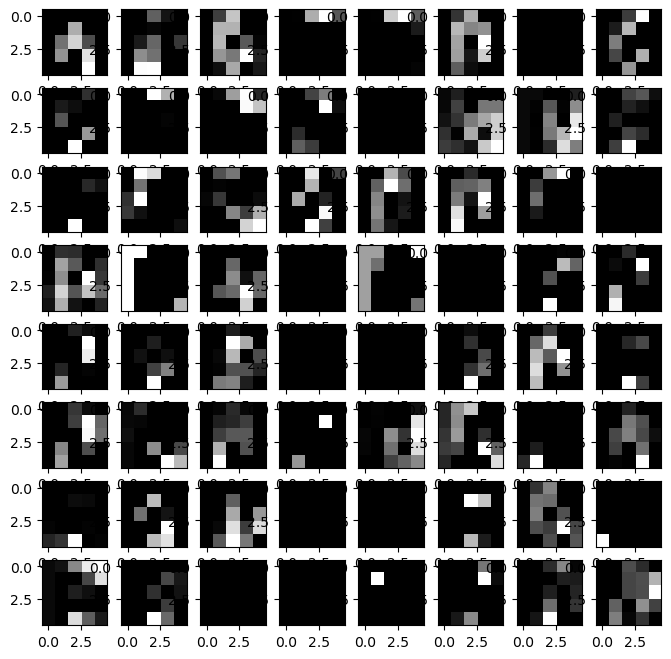

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


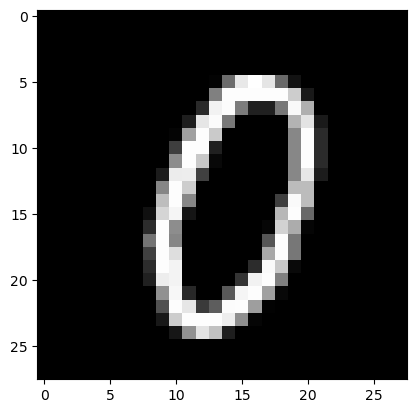

Feature maps of Convo layer 1


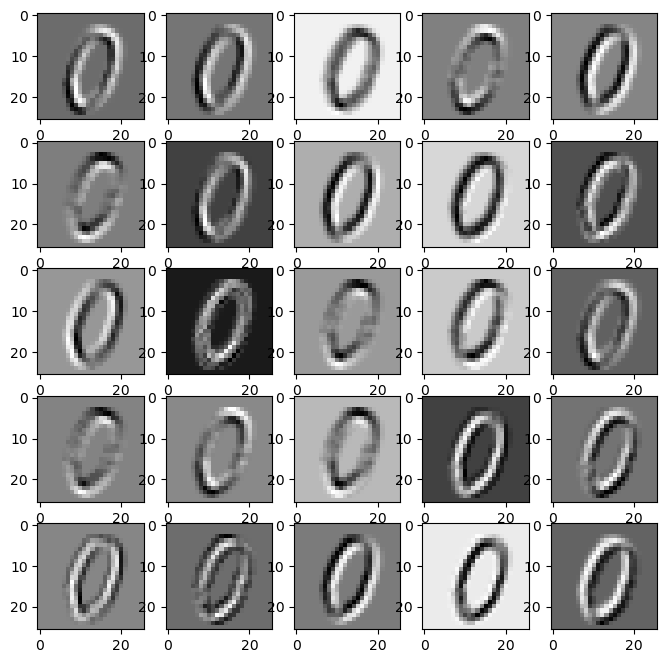

Feature maps of Activation layer 1


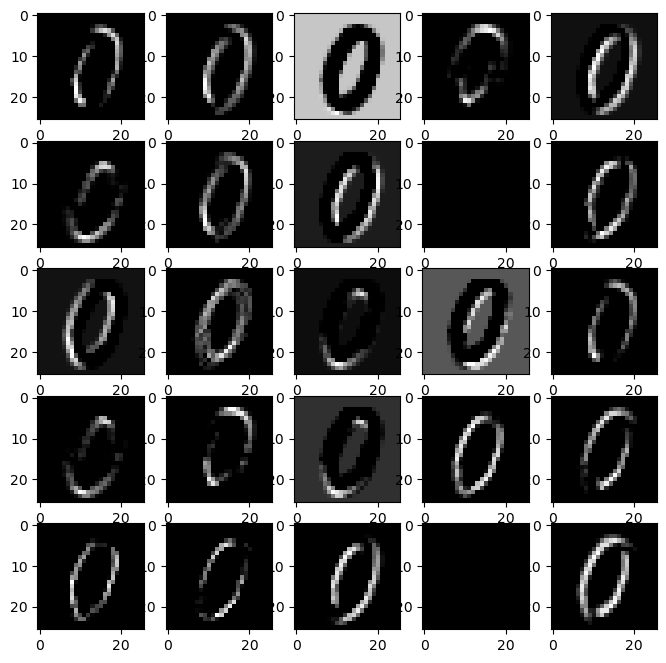

Feature maps of Pooling layer 1


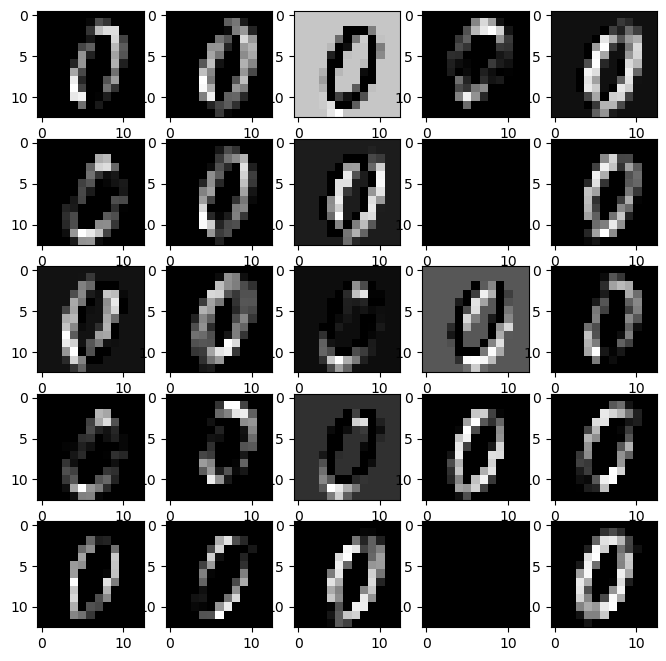

Feature maps of Convo layer 2


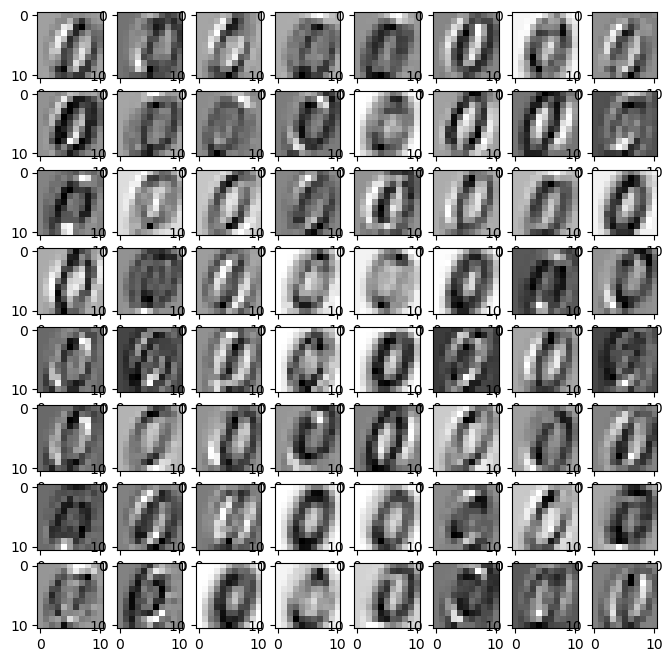

Feature maps of Activation layer 2


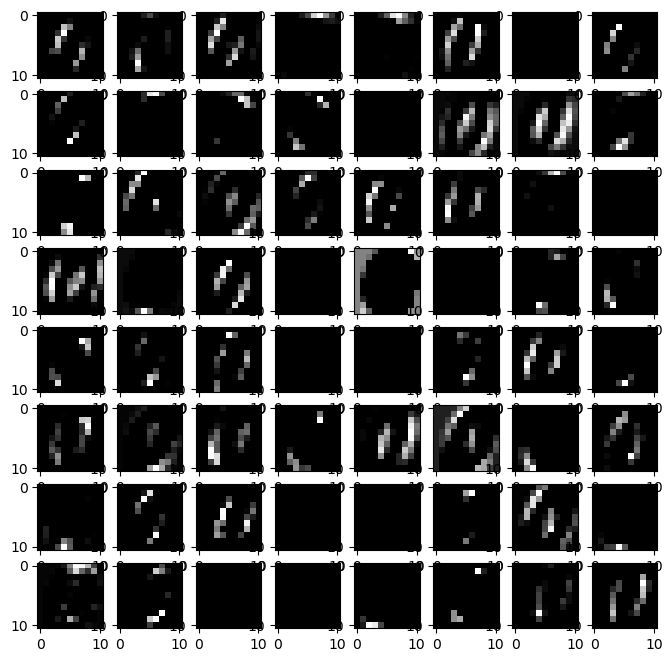

Feature maps of Pooling layer 2


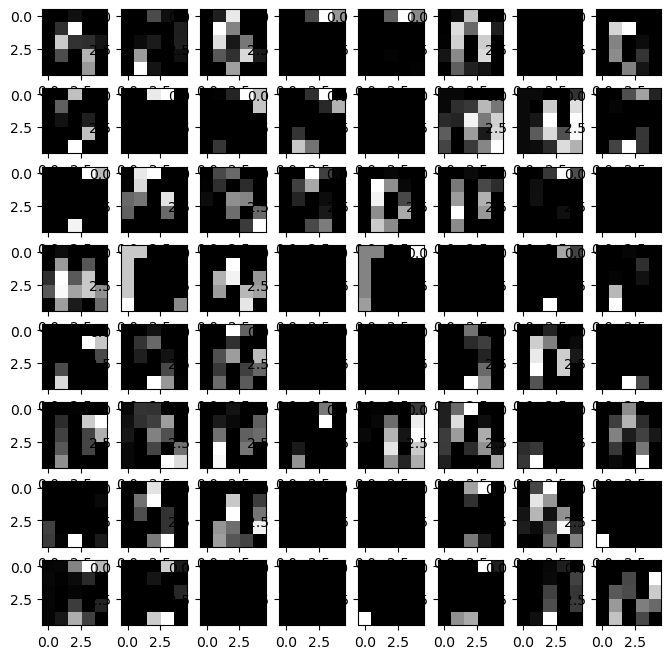

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


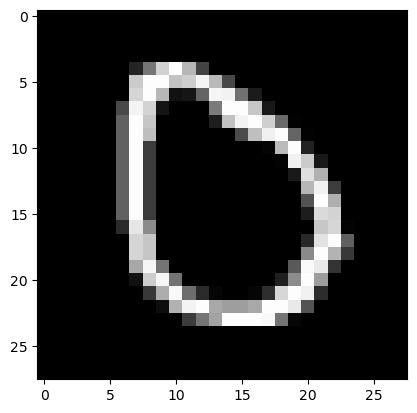

Feature maps of Convo layer 1


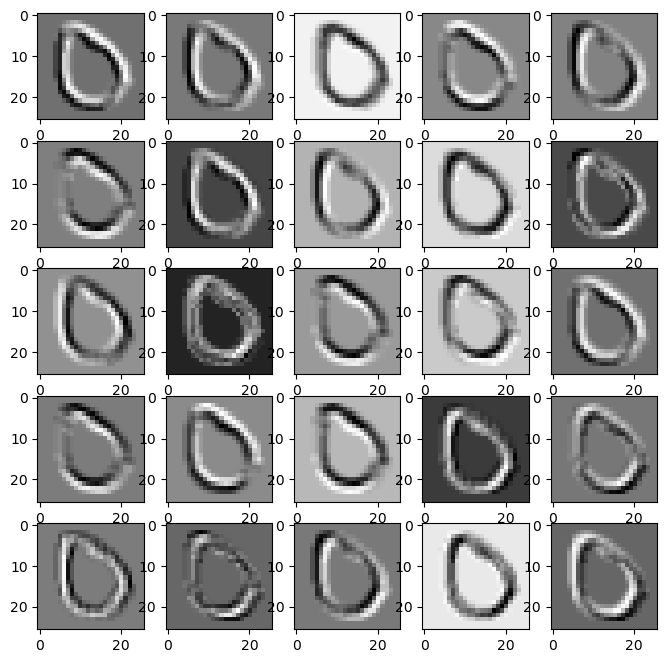

Feature maps of Activation layer 1


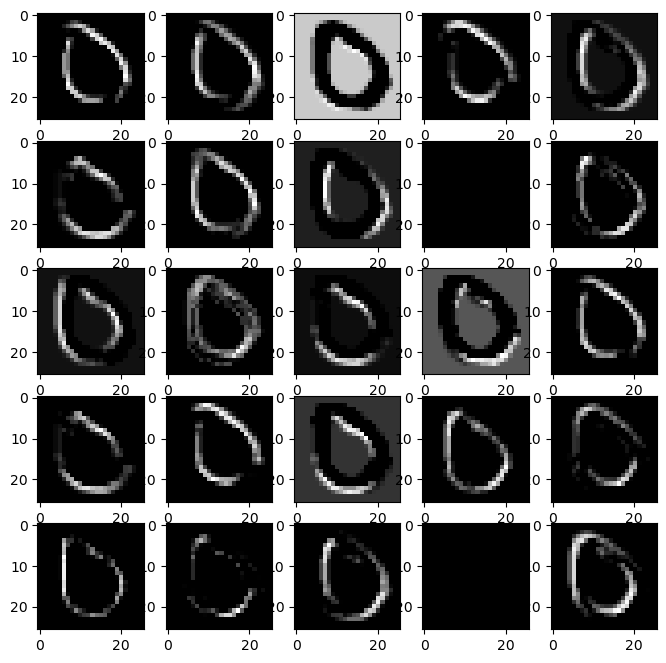

Feature maps of Pooling layer 1


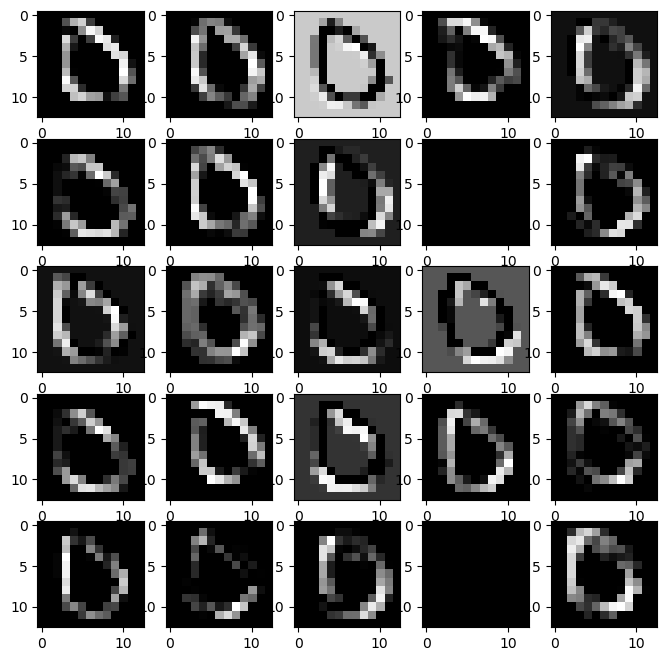

Feature maps of Convo layer 2


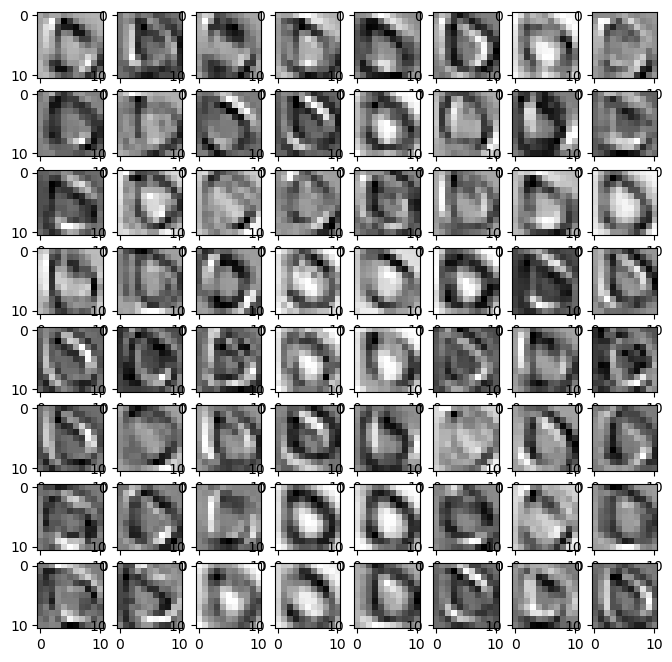

Feature maps of Activation layer 2


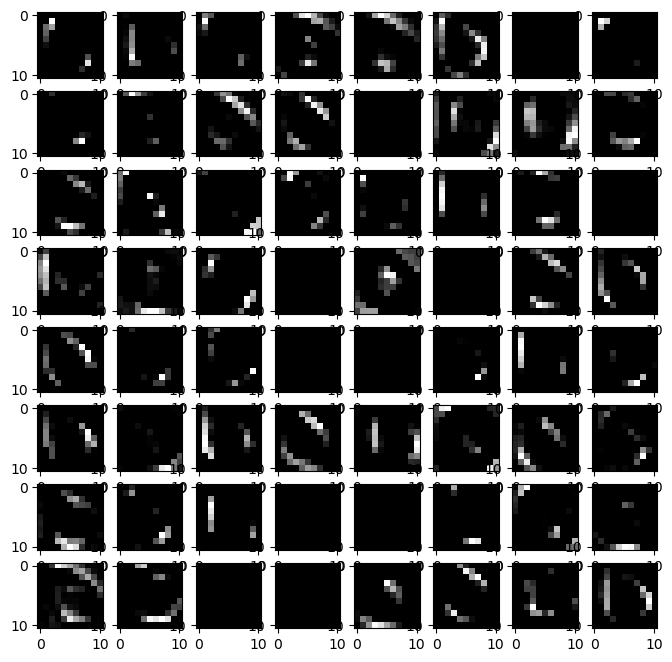

Feature maps of Pooling layer 2


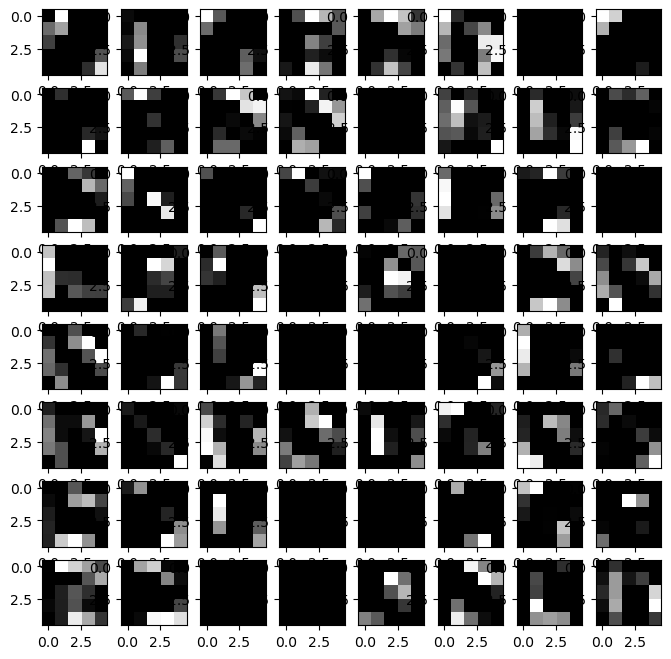

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


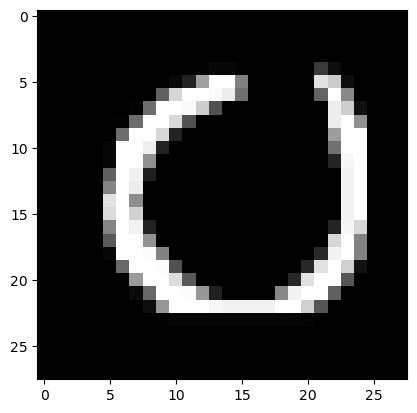

Feature maps of Convo layer 1


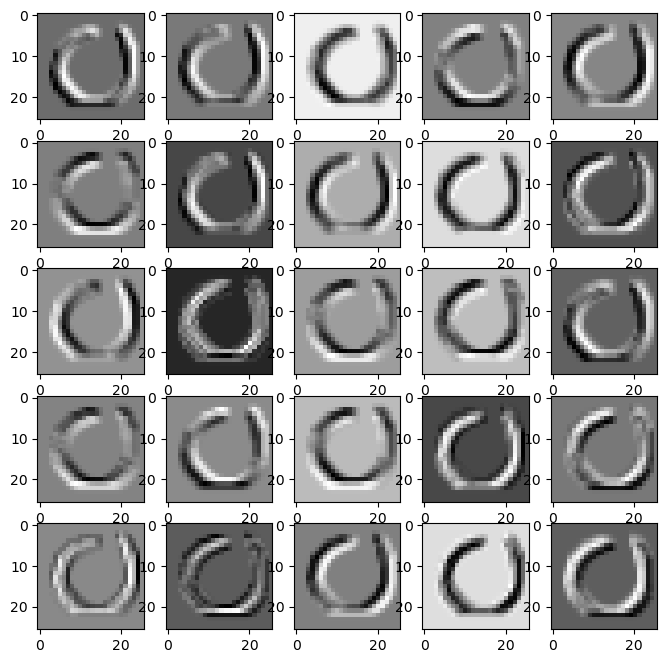

Feature maps of Activation layer 1


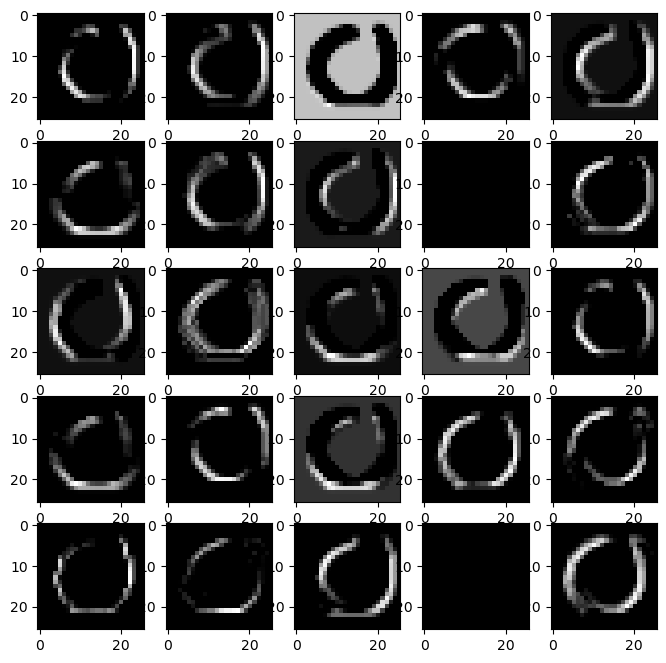

Feature maps of Pooling layer 1


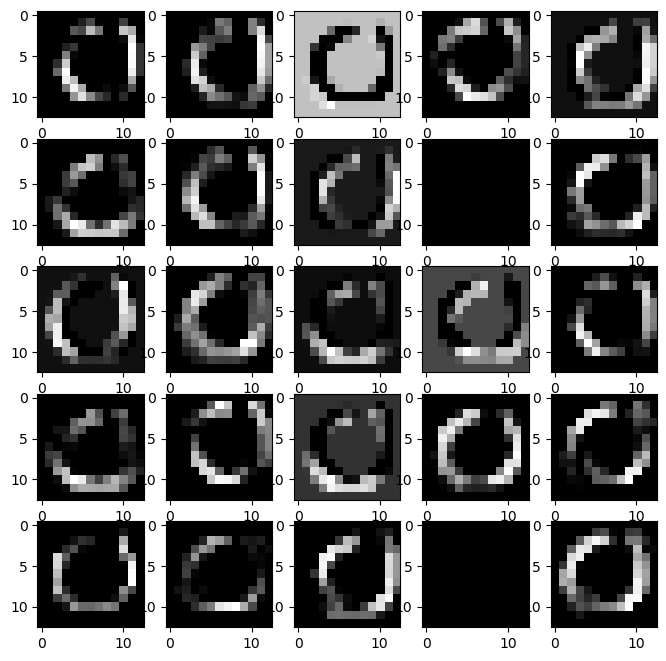

Feature maps of Convo layer 2


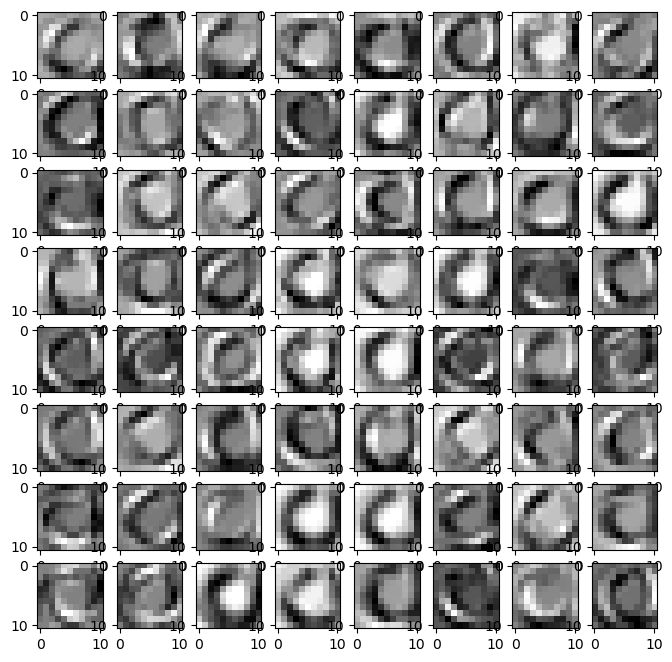

Feature maps of Activation layer 2


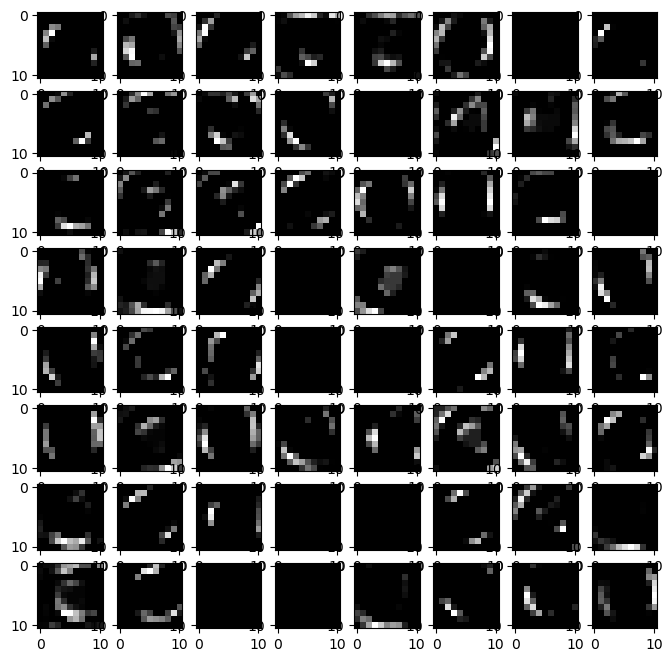

Feature maps of Pooling layer 2


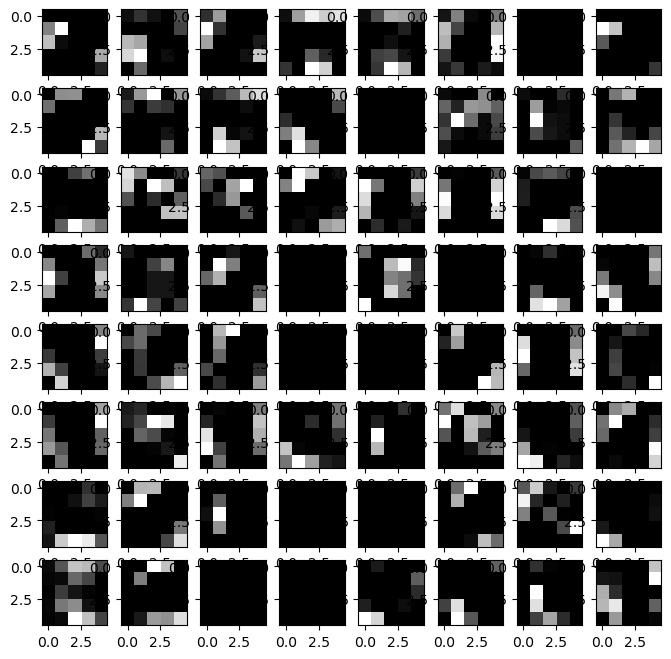

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


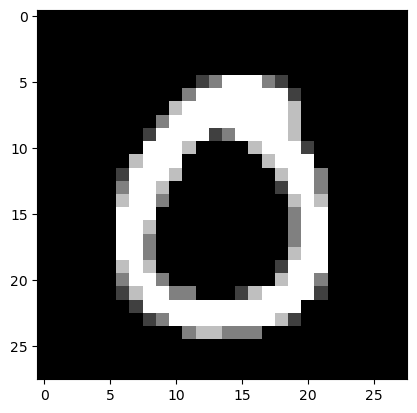

Feature maps of Convo layer 1


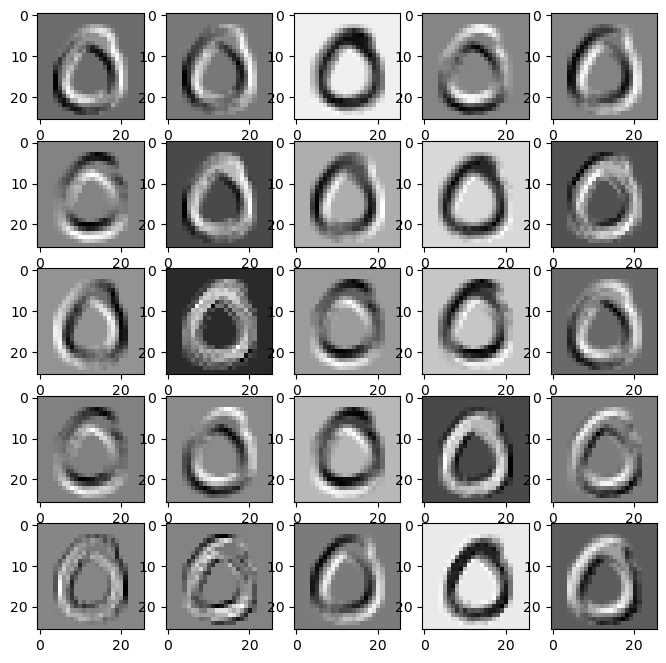

Feature maps of Activation layer 1


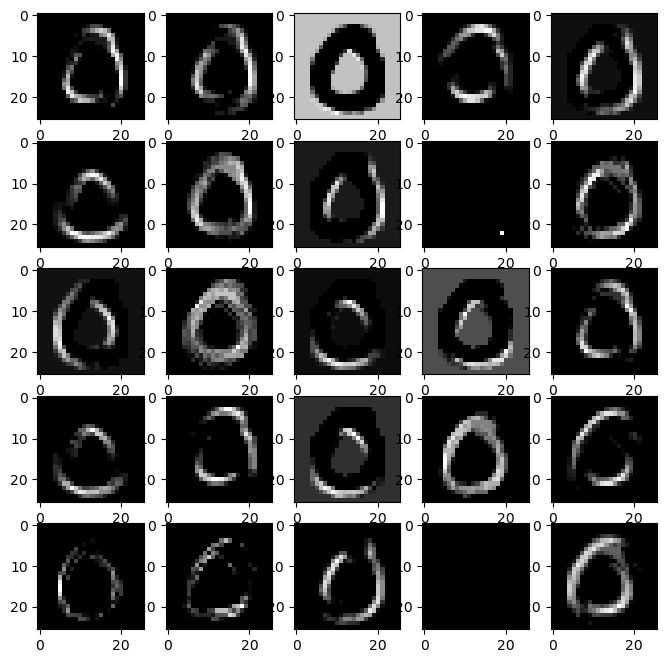

Feature maps of Pooling layer 1


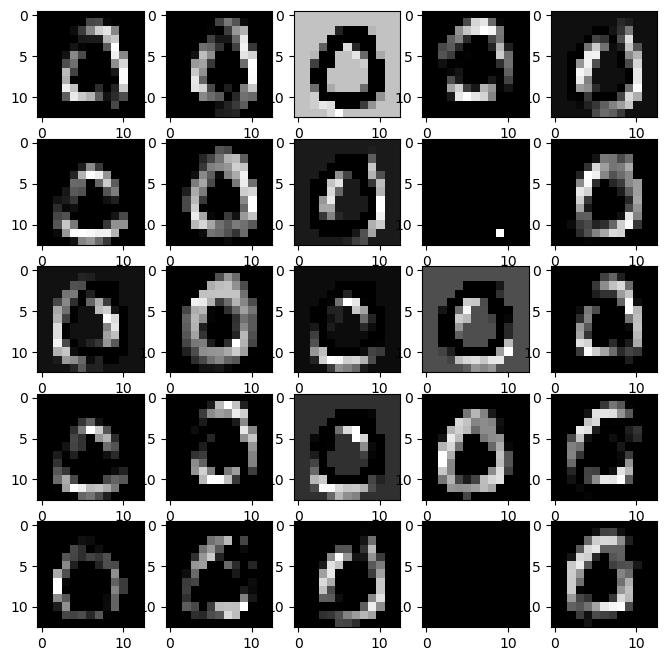

Feature maps of Convo layer 2


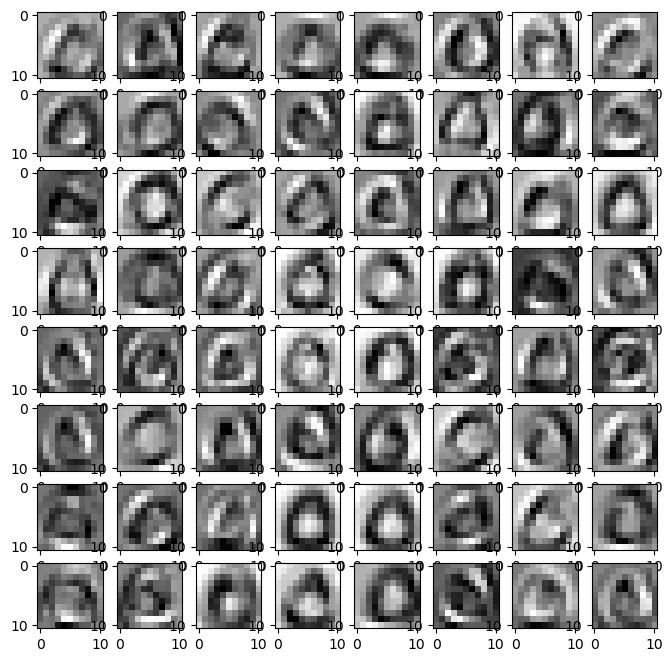

Feature maps of Activation layer 2


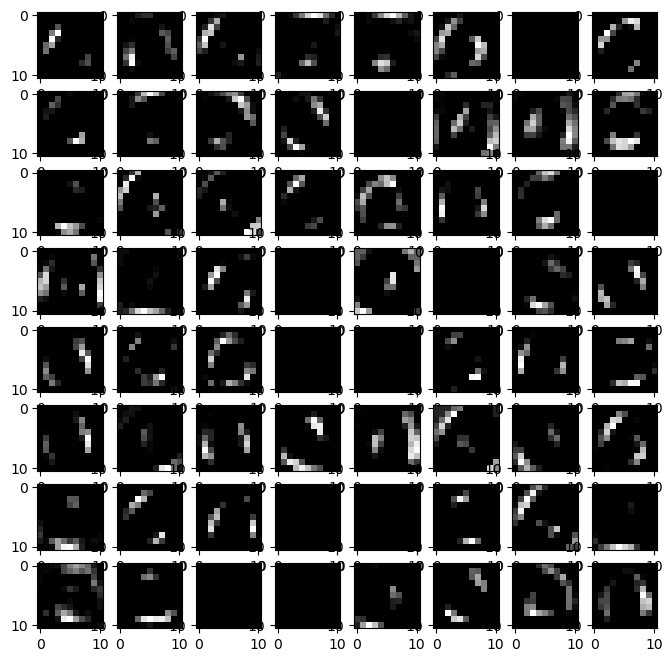

Feature maps of Pooling layer 2


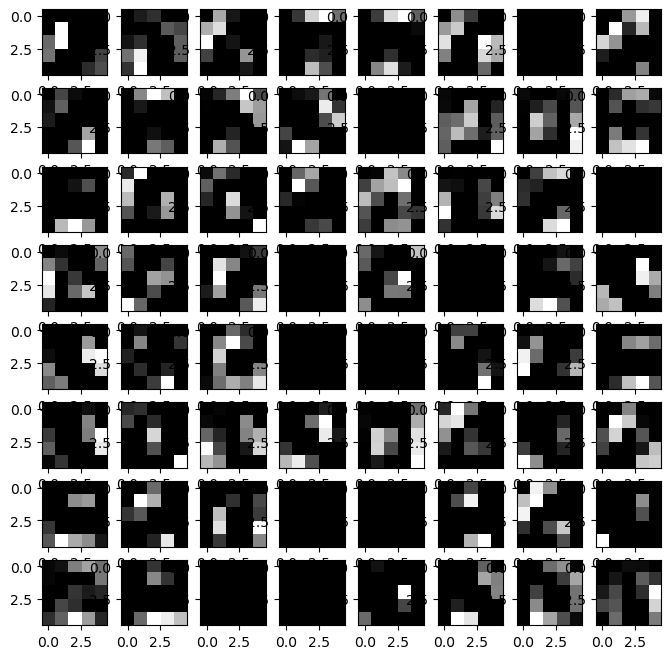

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


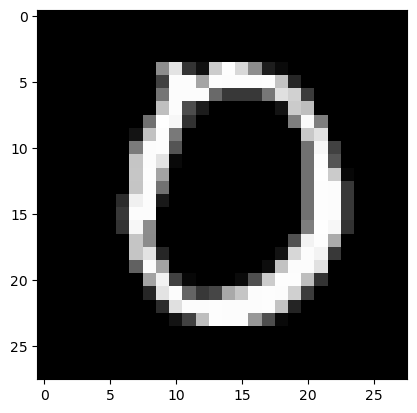

Feature maps of Convo layer 1


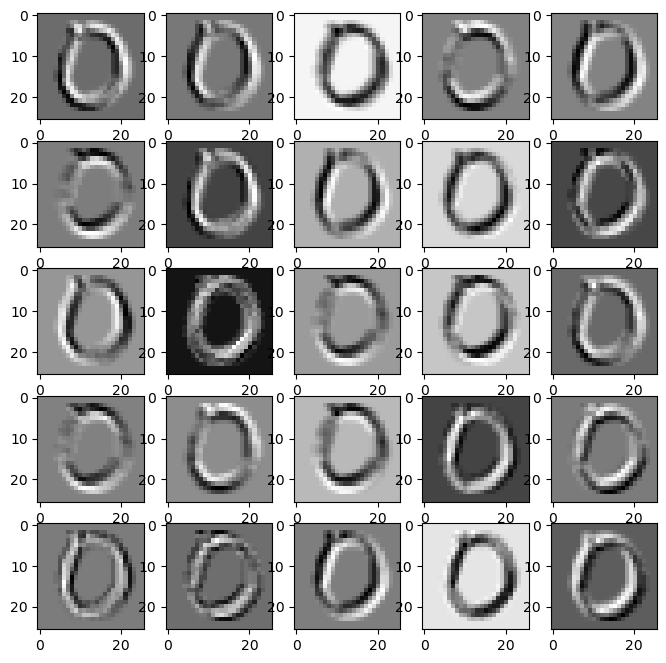

Feature maps of Activation layer 1


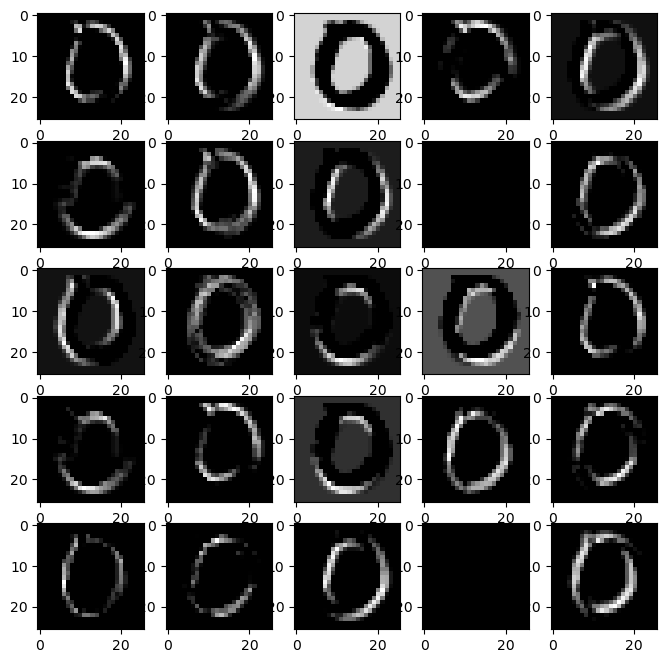

Feature maps of Pooling layer 1


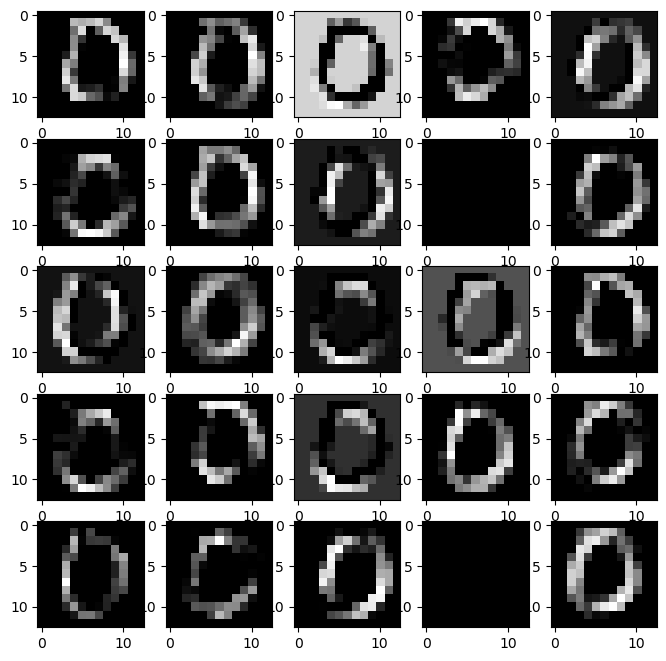

Feature maps of Convo layer 2


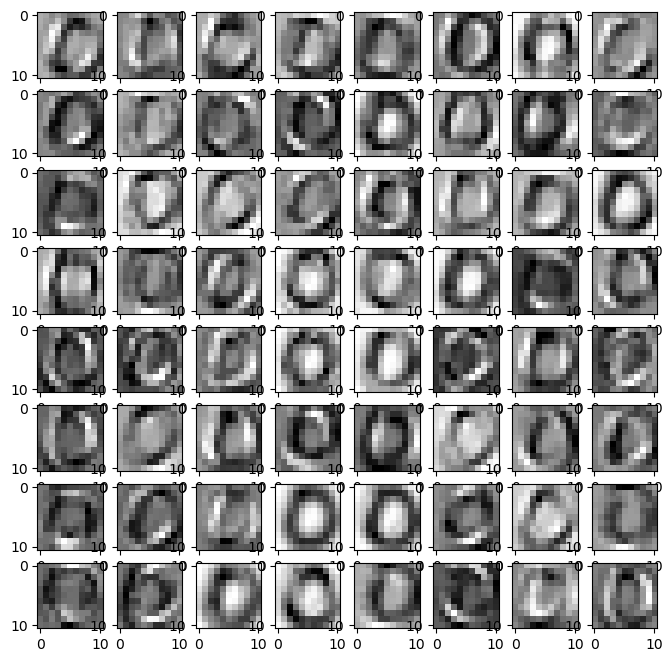

Feature maps of Activation layer 2


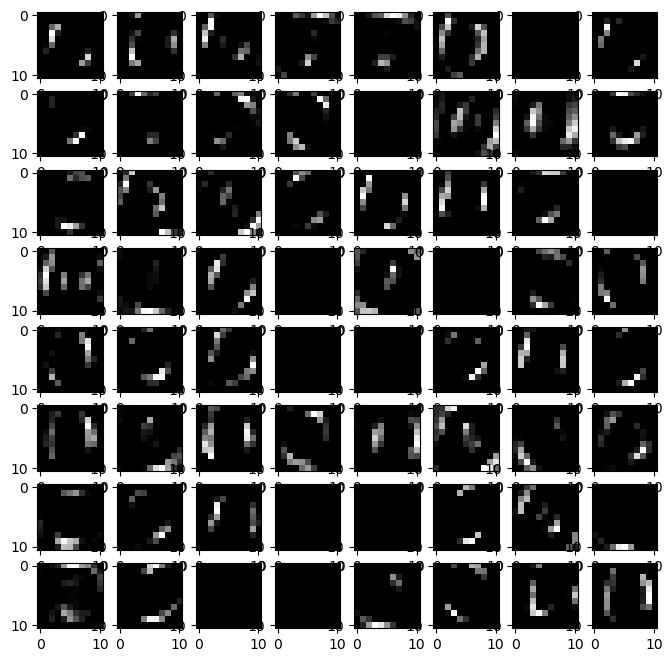

Feature maps of Pooling layer 2


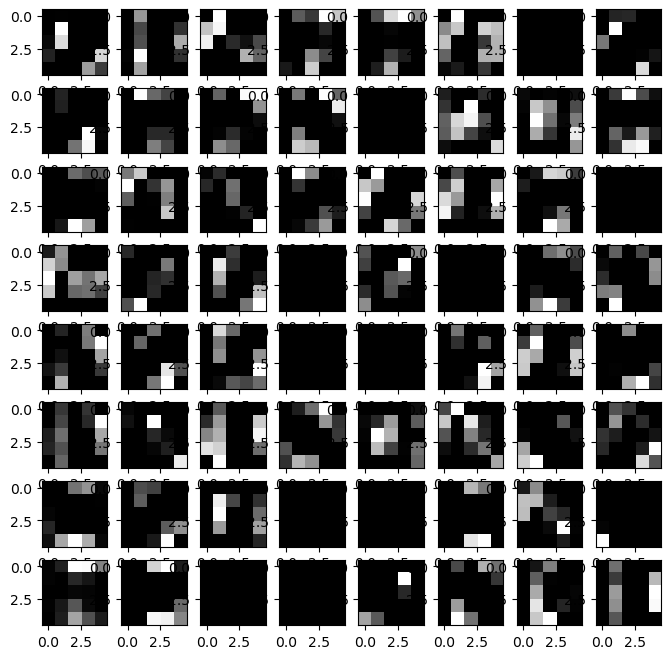

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


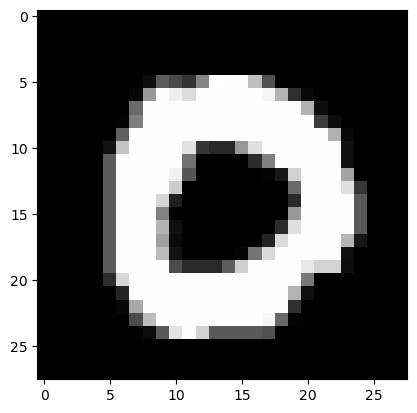

Feature maps of Convo layer 1


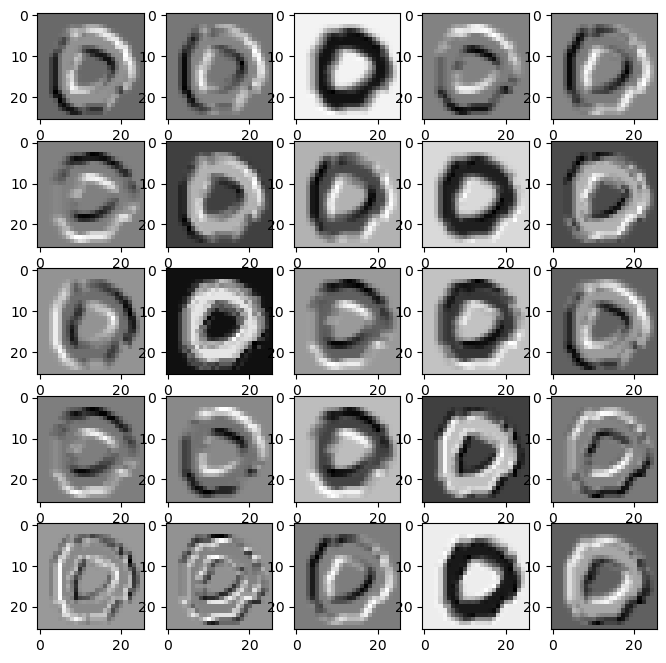

Feature maps of Activation layer 1


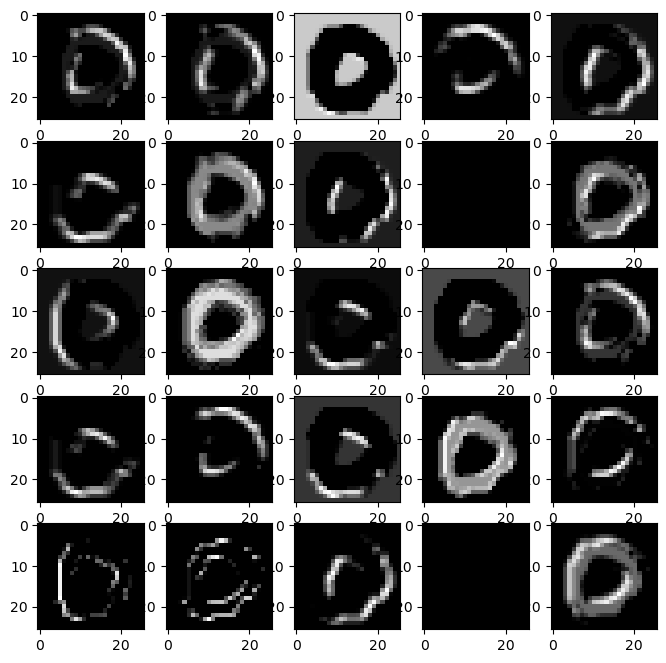

Feature maps of Pooling layer 1


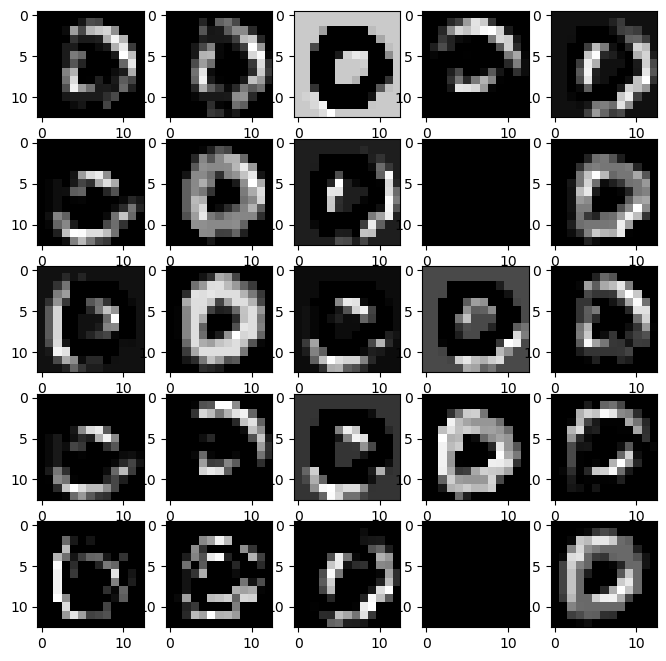

Feature maps of Convo layer 2


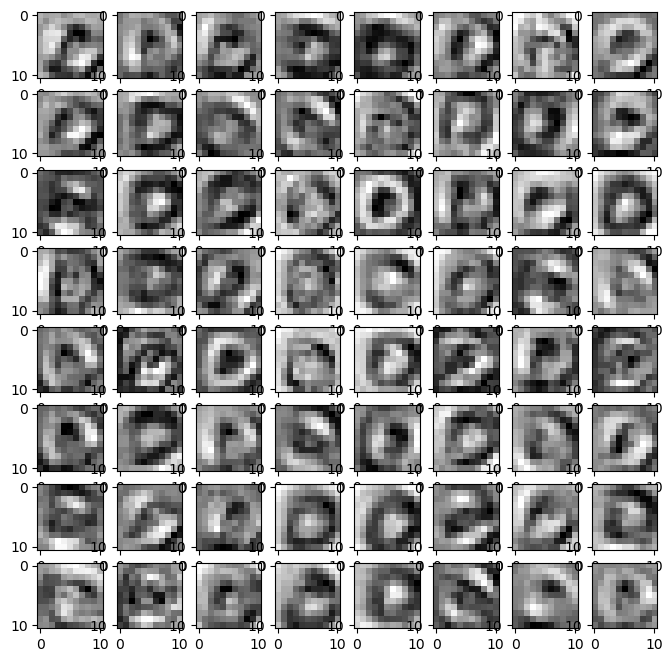

Feature maps of Activation layer 2


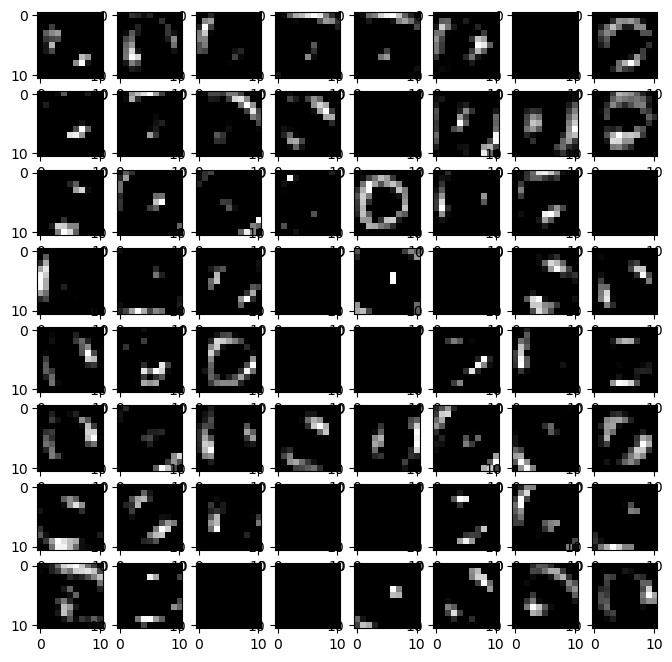

Feature maps of Pooling layer 2


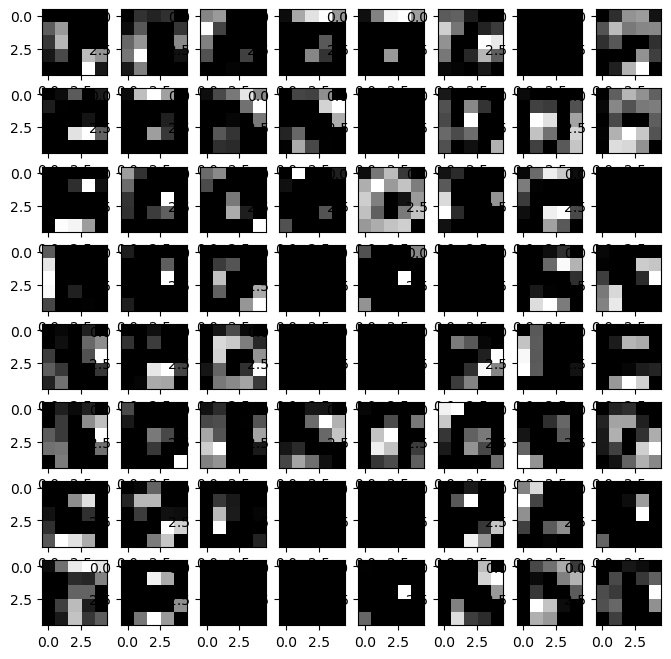

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
Original Image


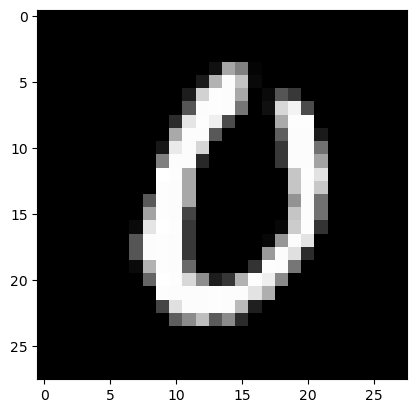

Feature maps of Convo layer 1


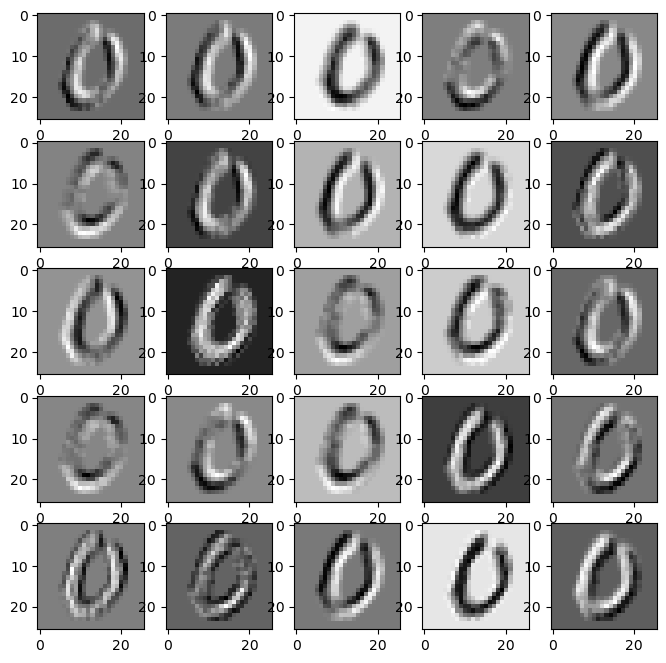

Feature maps of Activation layer 1


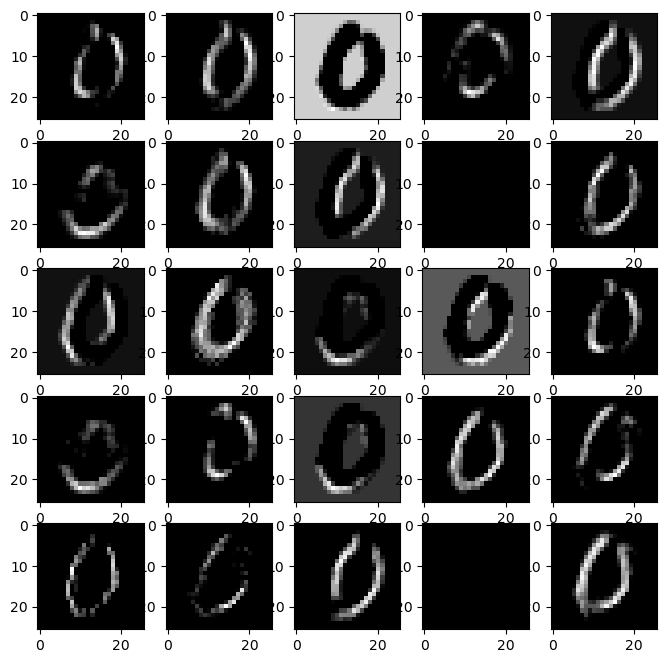

Feature maps of Pooling layer 1


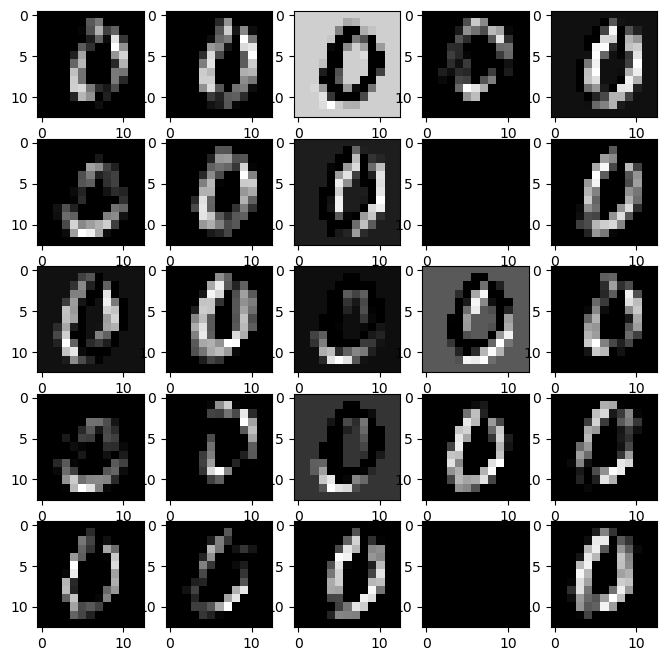

Feature maps of Convo layer 2


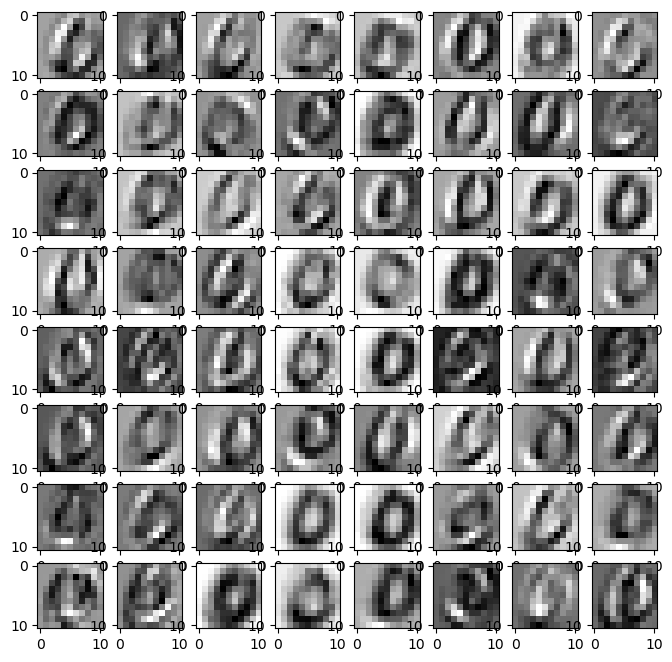

Feature maps of Activation layer 2


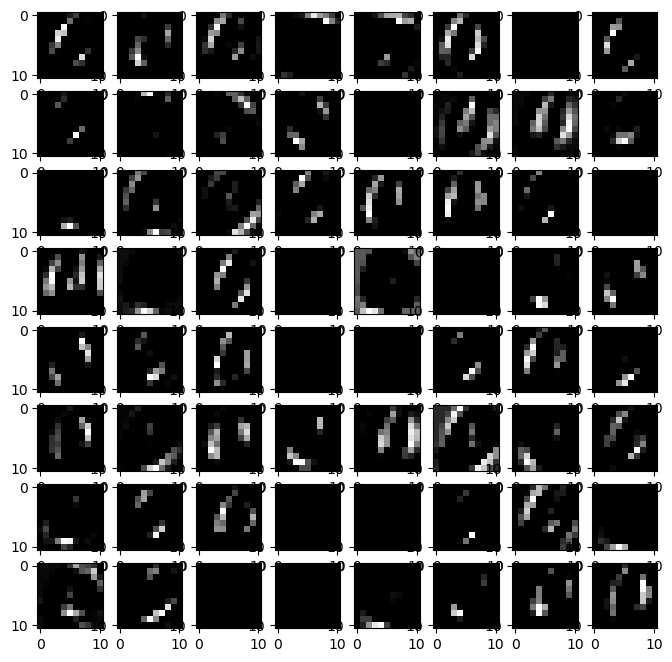

Feature maps of Pooling layer 2


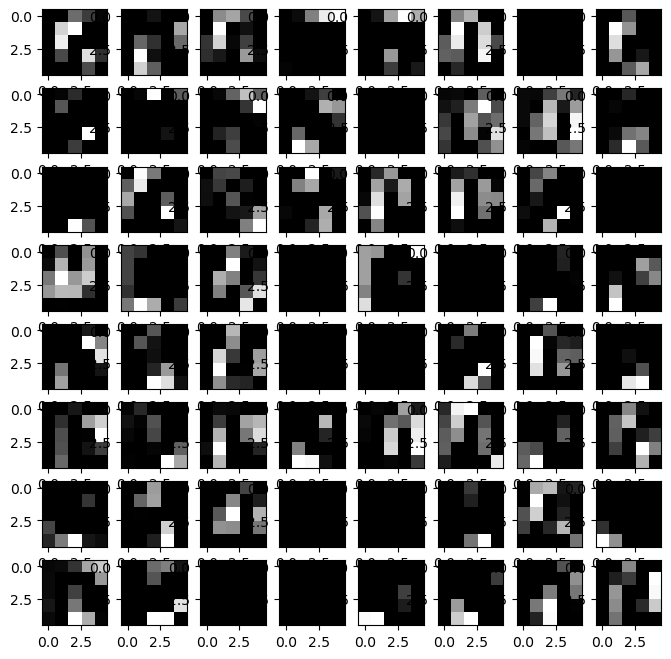

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


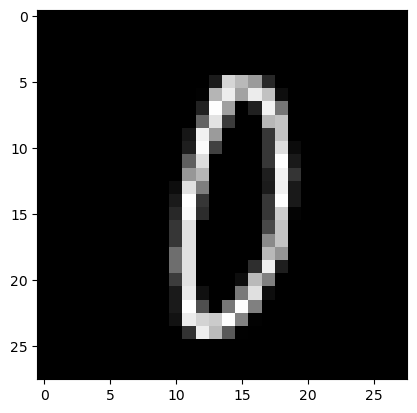

Feature maps of Convo layer 1


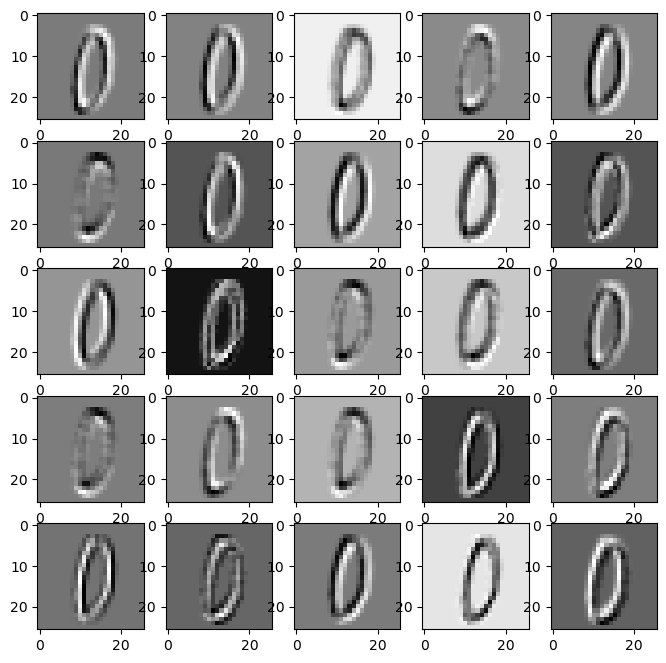

Feature maps of Activation layer 1


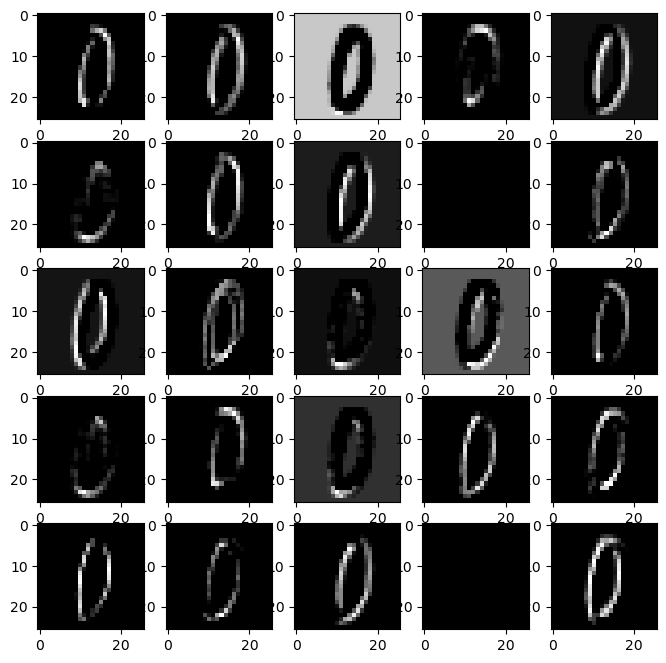

Feature maps of Pooling layer 1


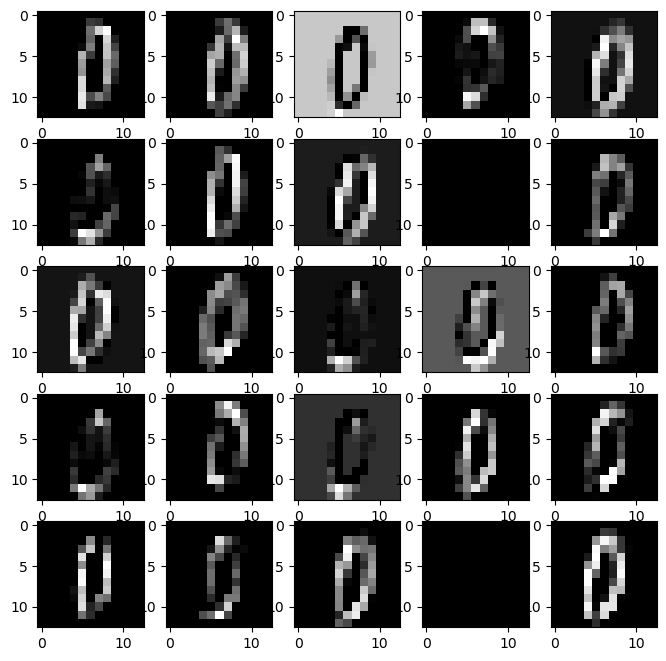

Feature maps of Convo layer 2


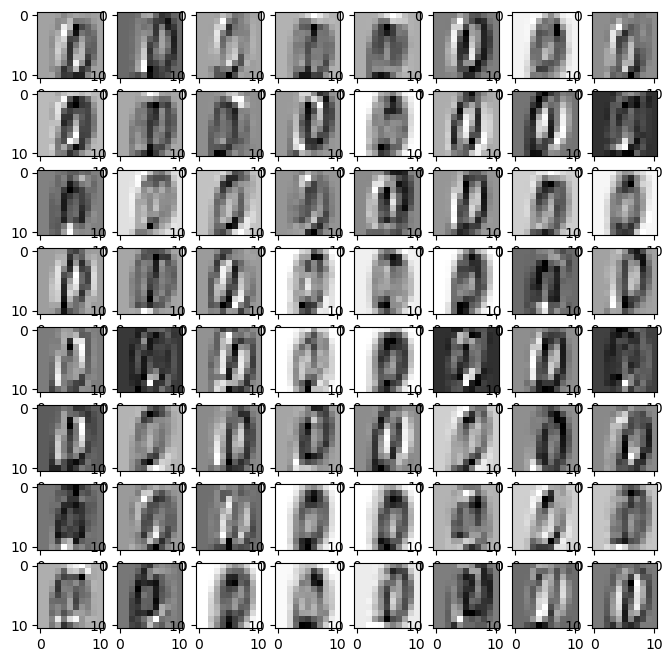

Feature maps of Activation layer 2


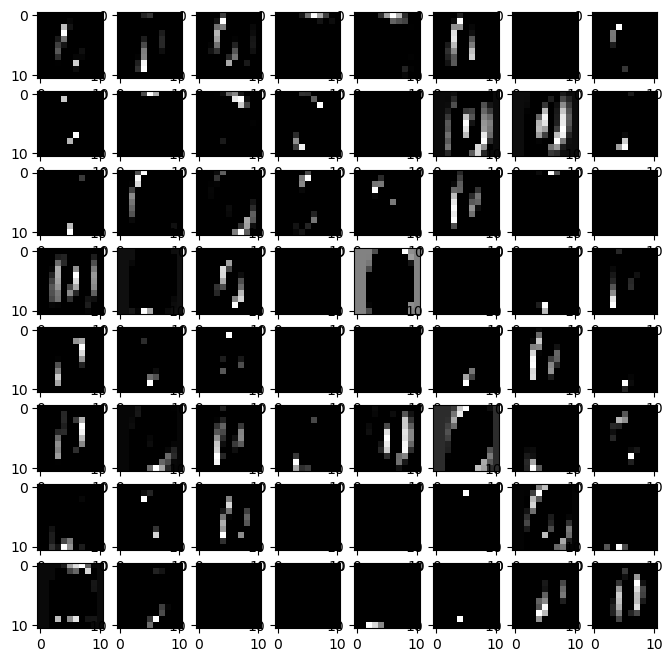

Feature maps of Pooling layer 2


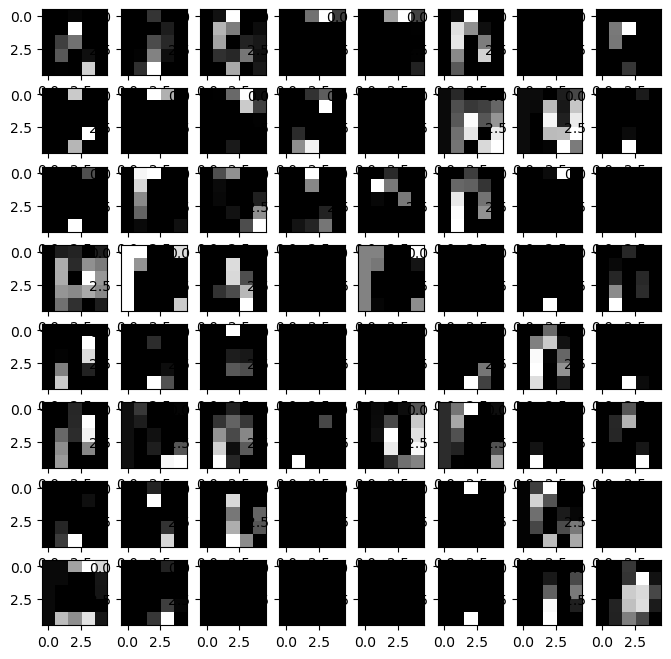

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


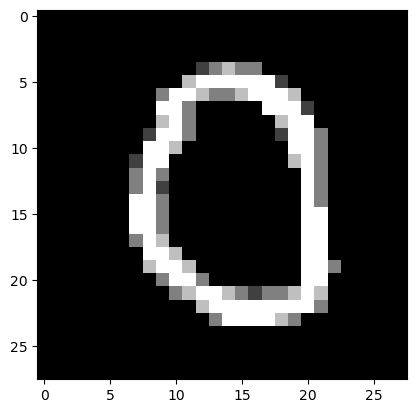

Feature maps of Convo layer 1


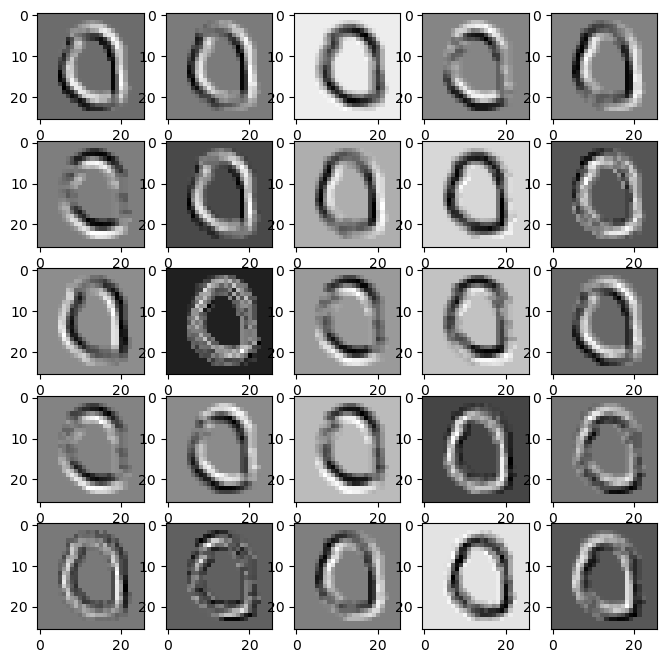

Feature maps of Activation layer 1


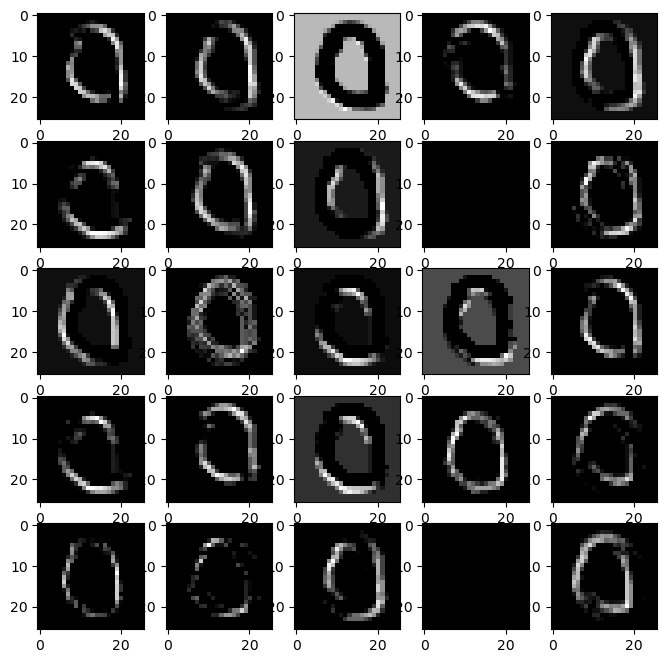

Feature maps of Pooling layer 1


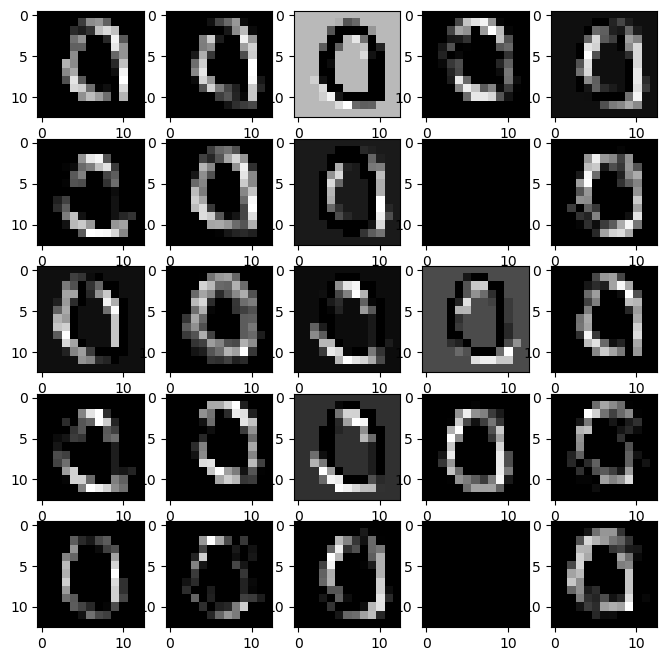

Feature maps of Convo layer 2


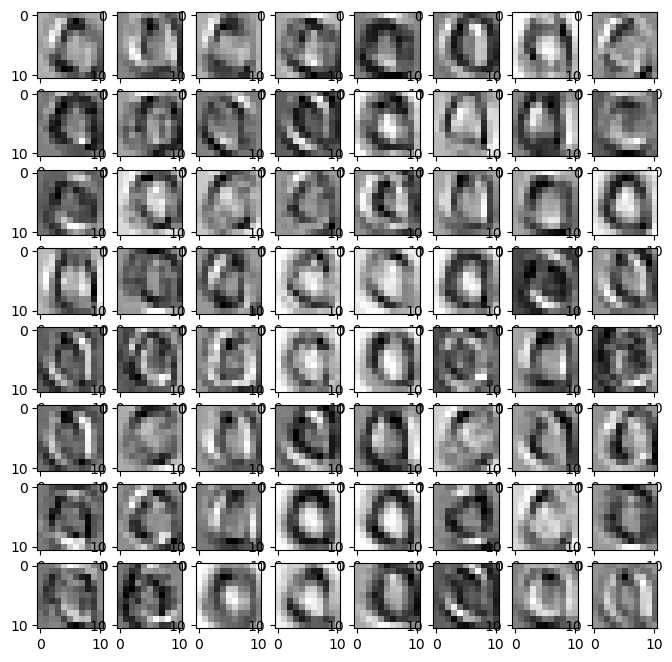

Feature maps of Activation layer 2


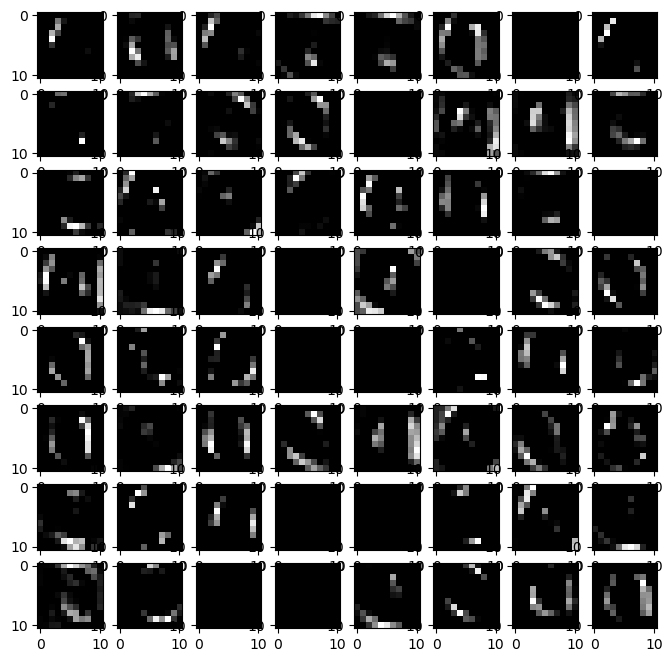

Feature maps of Pooling layer 2


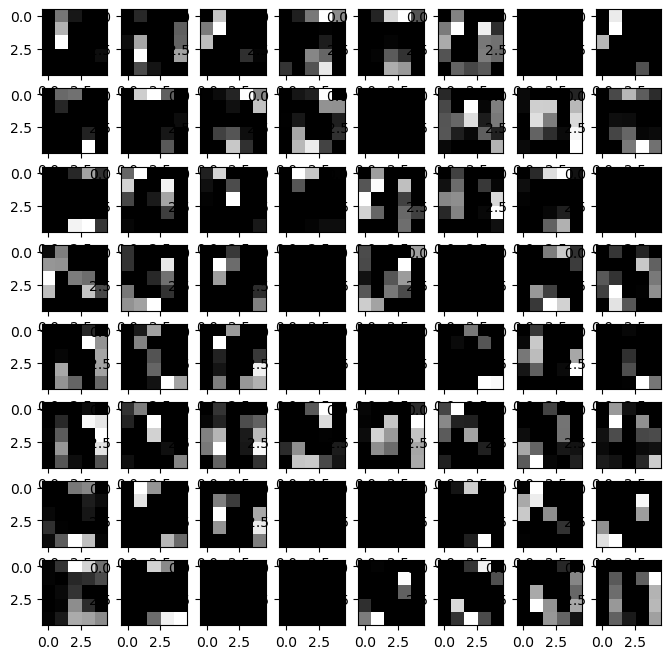

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


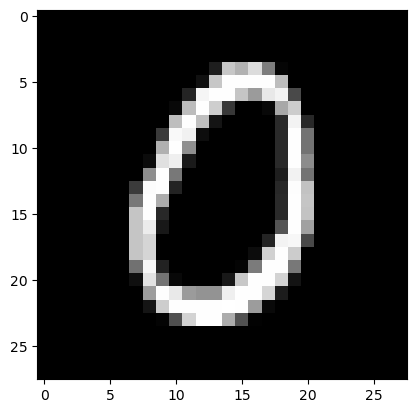

Feature maps of Convo layer 1


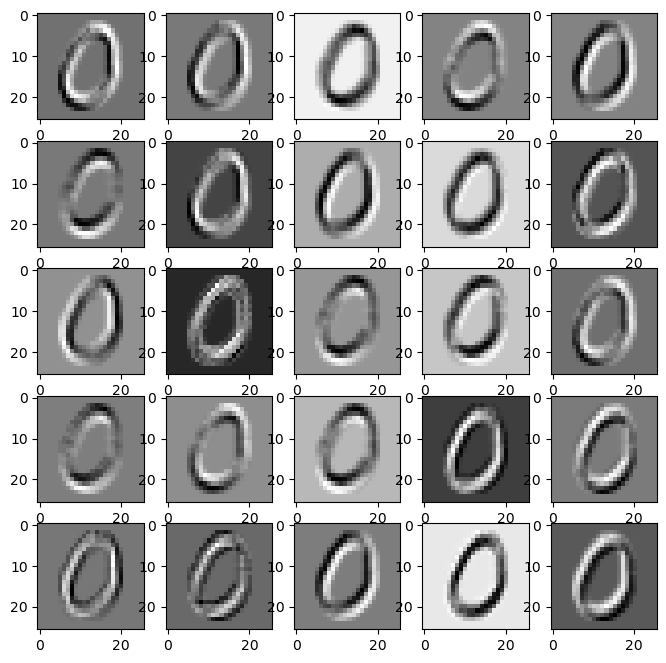

Feature maps of Activation layer 1


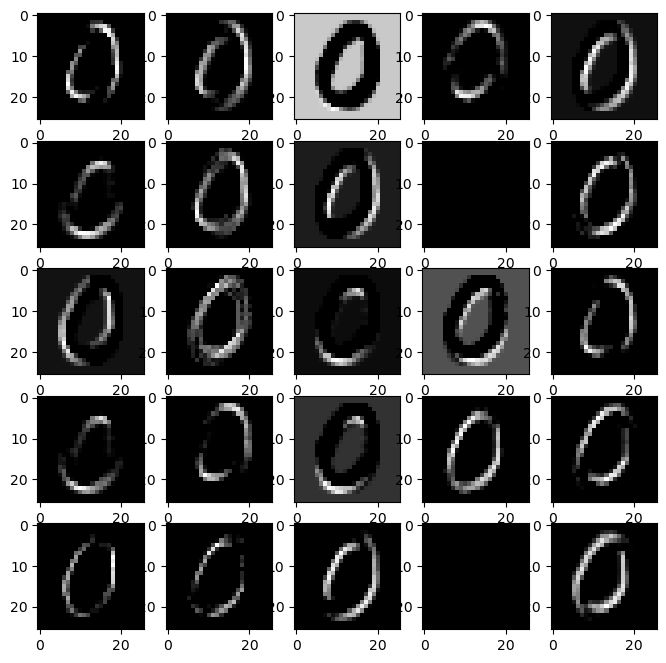

Feature maps of Pooling layer 1


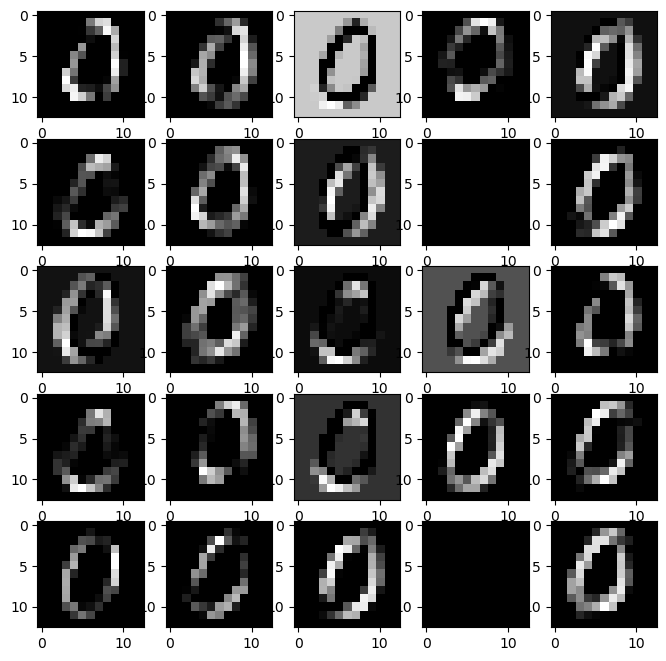

Feature maps of Convo layer 2


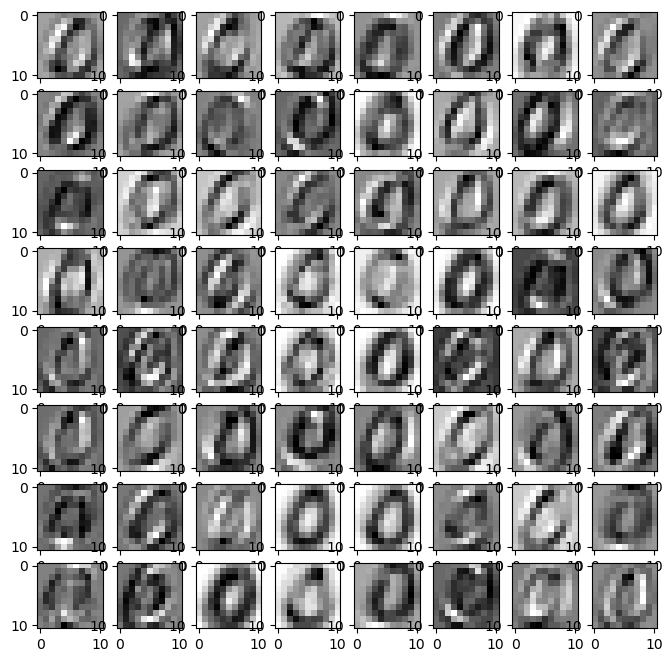

Feature maps of Activation layer 2


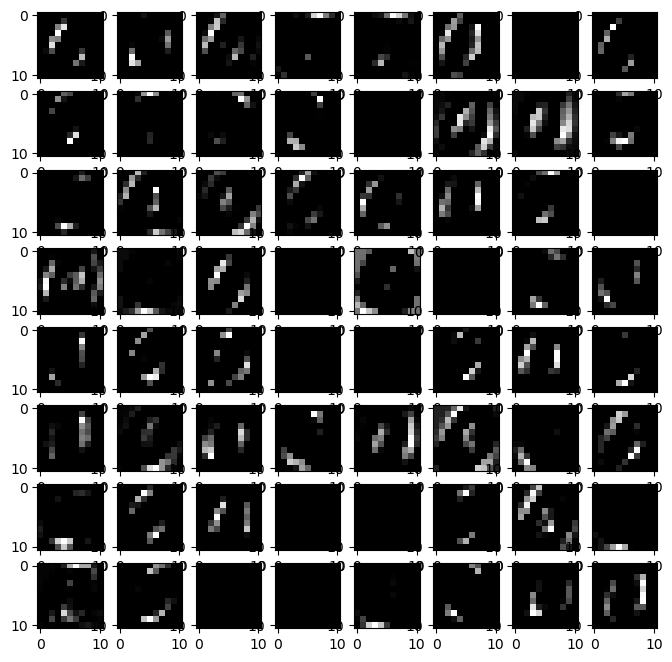

Feature maps of Pooling layer 2


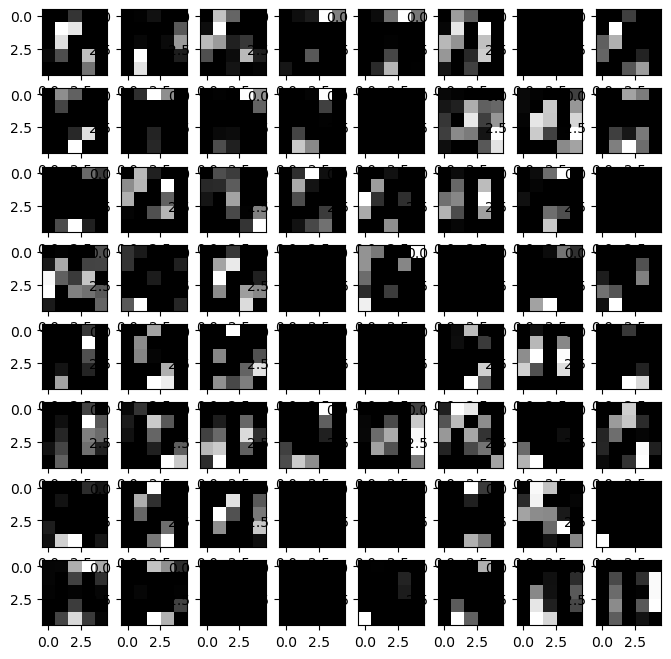

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


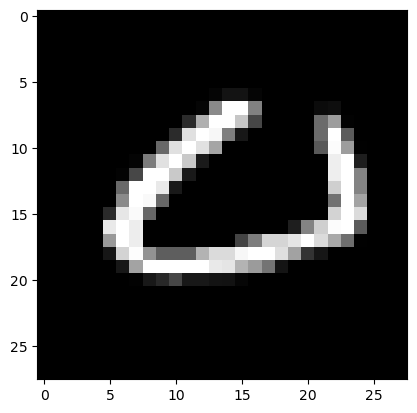

Feature maps of Convo layer 1


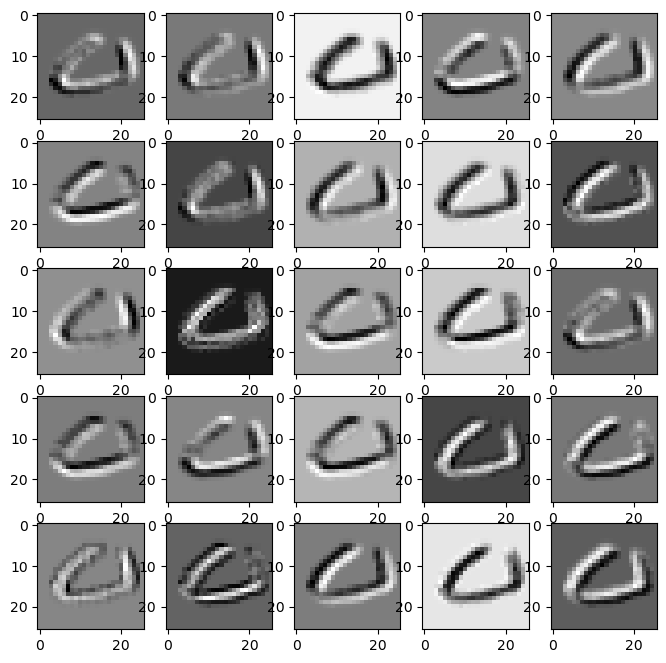

Feature maps of Activation layer 1


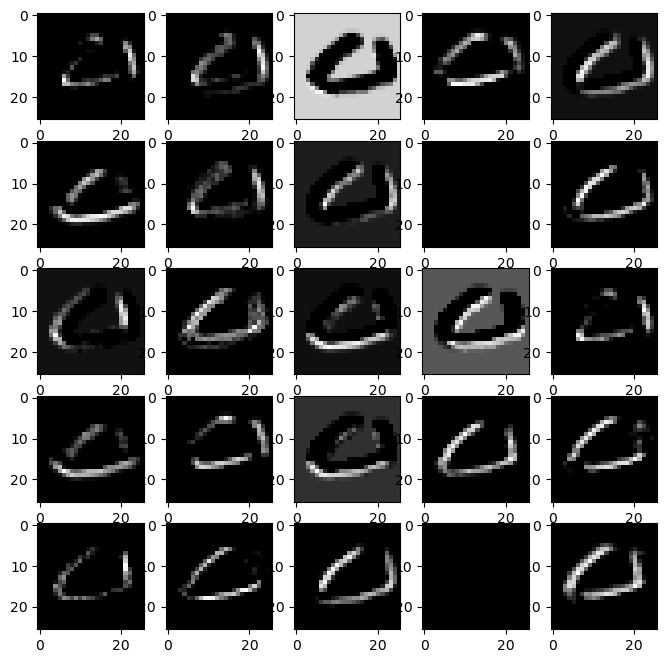

Feature maps of Pooling layer 1


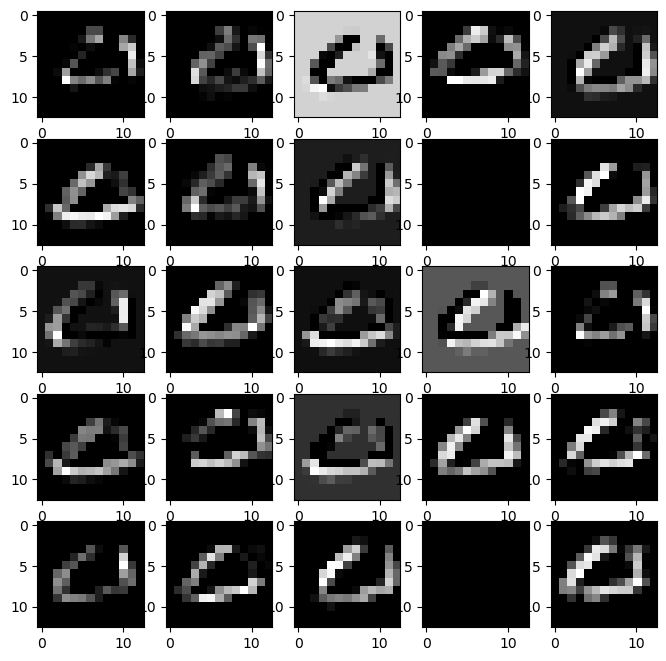

Feature maps of Convo layer 2


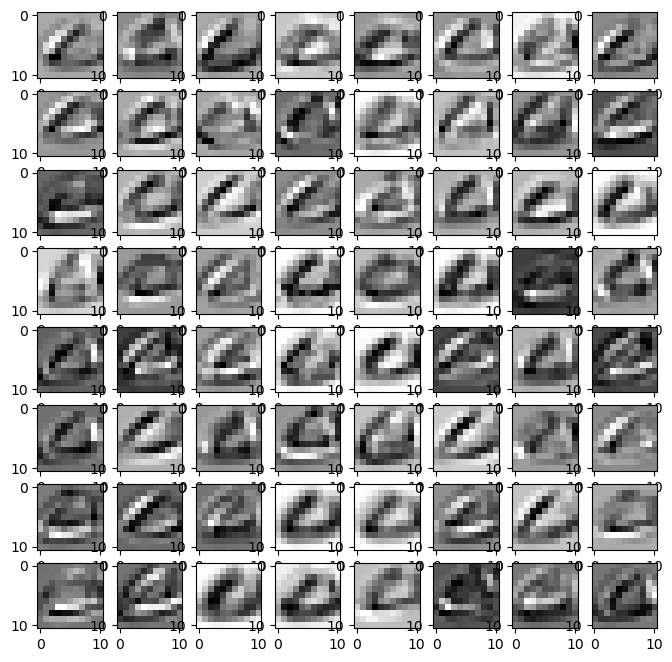

Feature maps of Activation layer 2


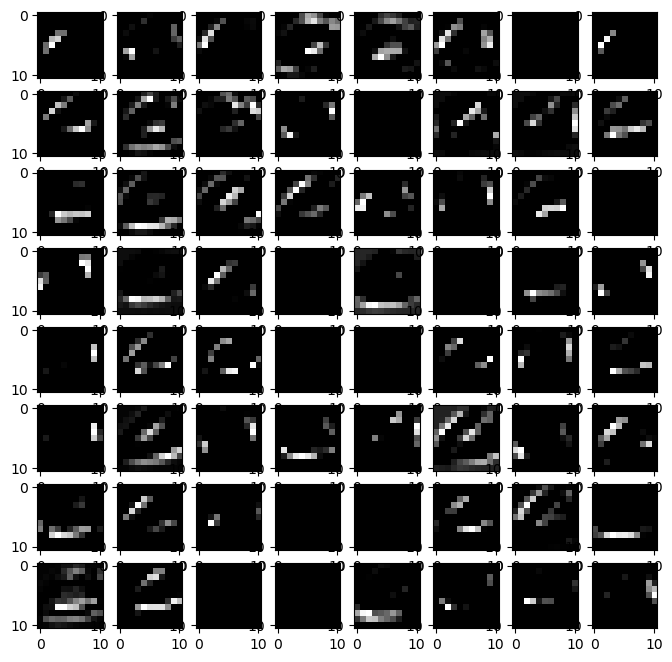

Feature maps of Pooling layer 2


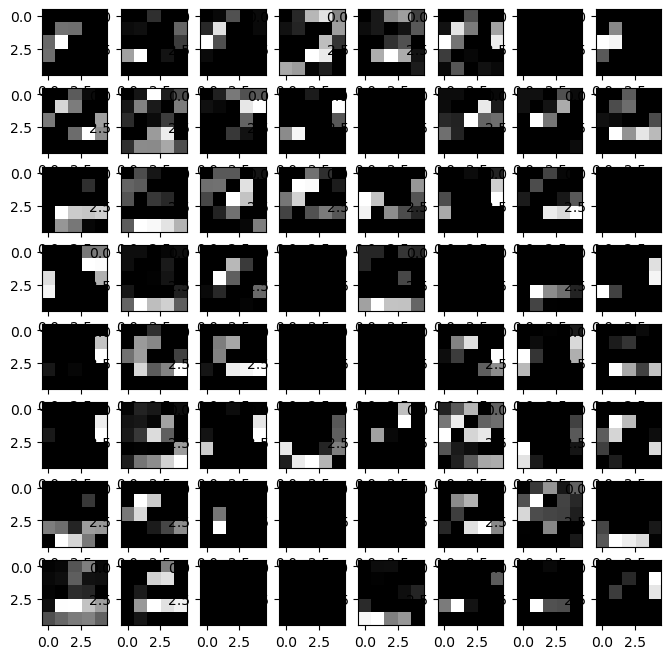

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


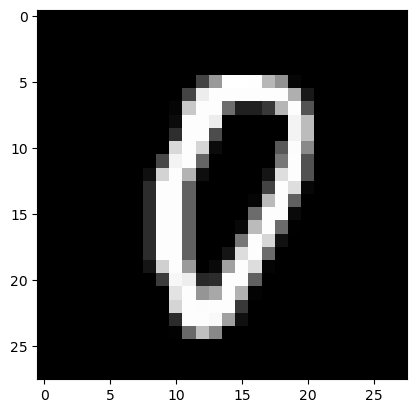

Feature maps of Convo layer 1


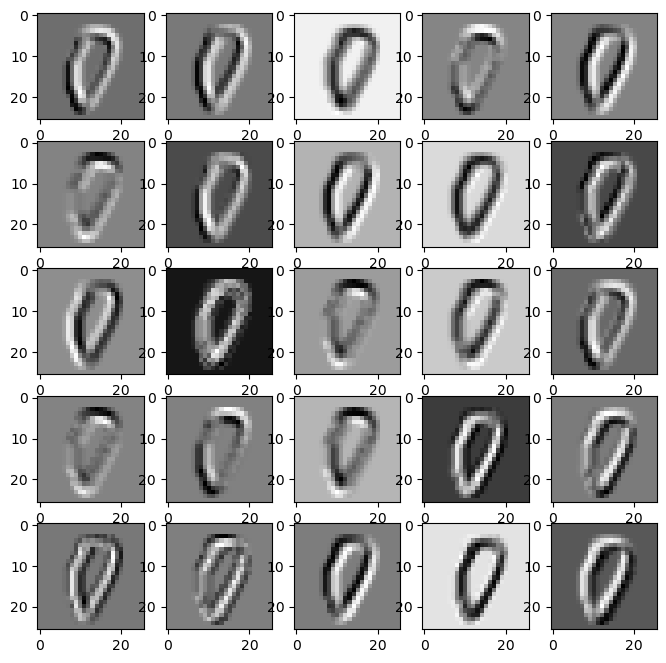

Feature maps of Activation layer 1


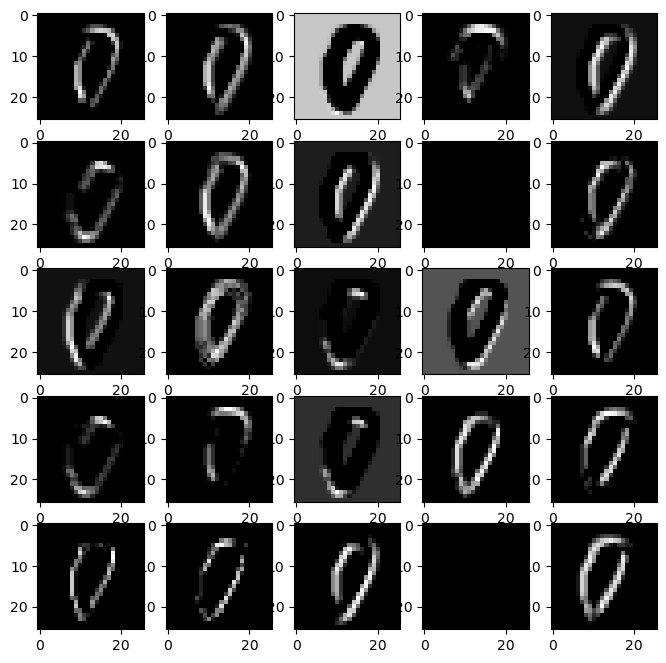

Feature maps of Pooling layer 1


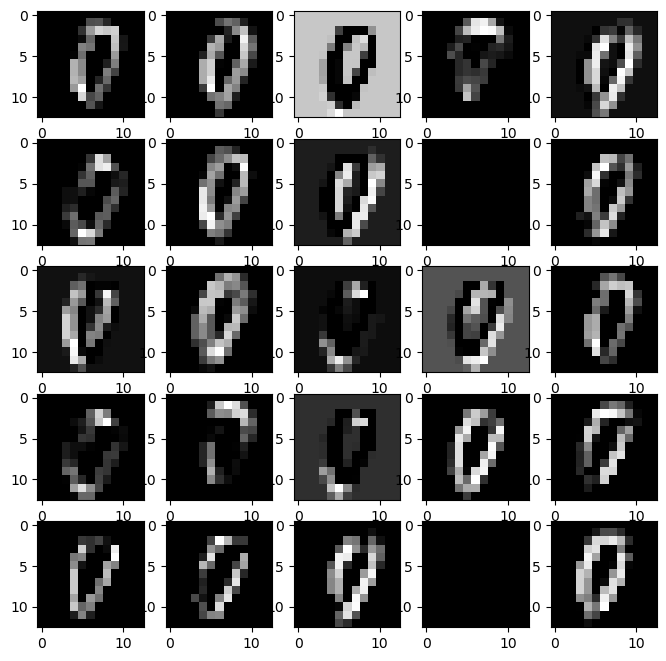

Feature maps of Convo layer 2


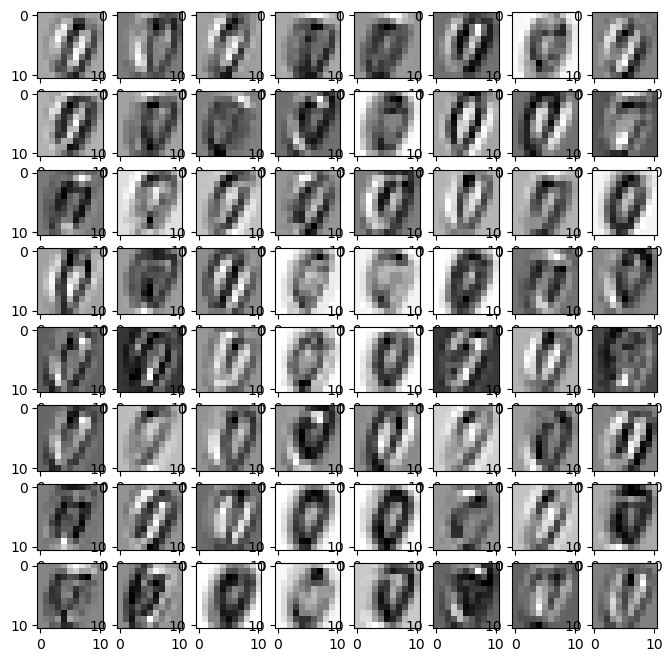

Feature maps of Activation layer 2


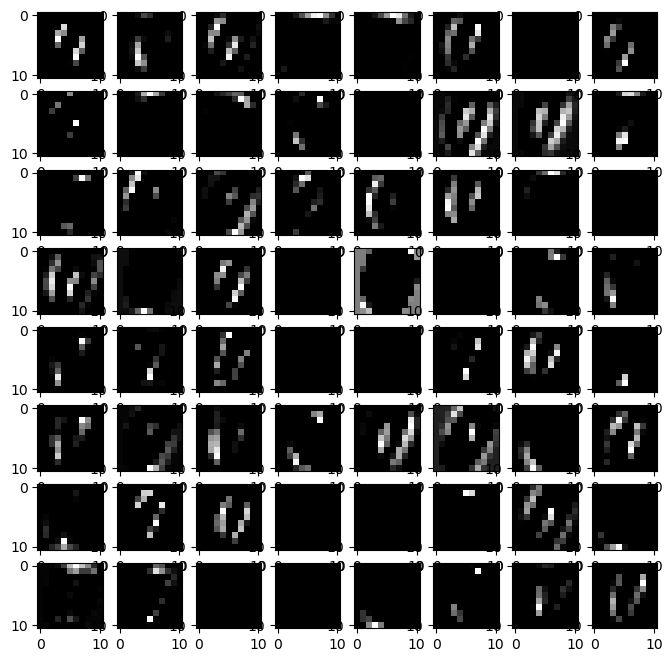

Feature maps of Pooling layer 2


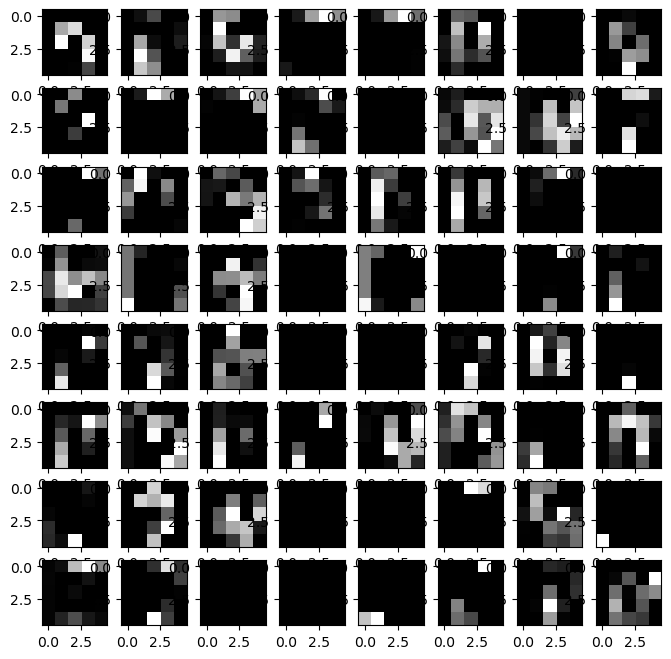

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


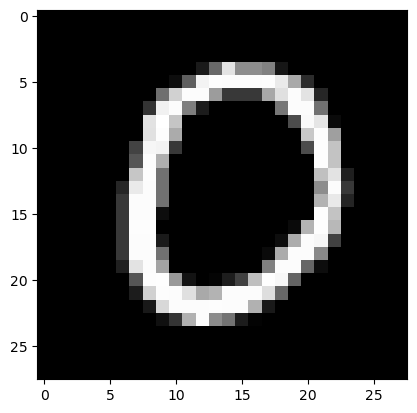

Feature maps of Convo layer 1


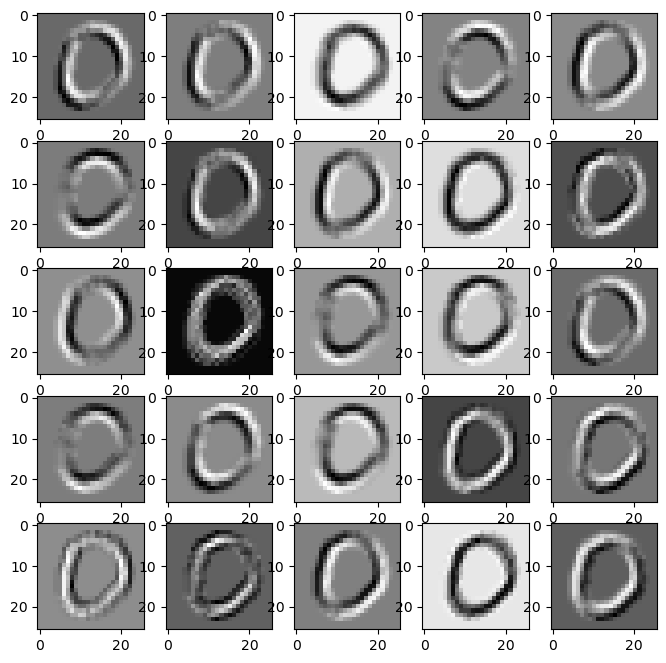

Feature maps of Activation layer 1


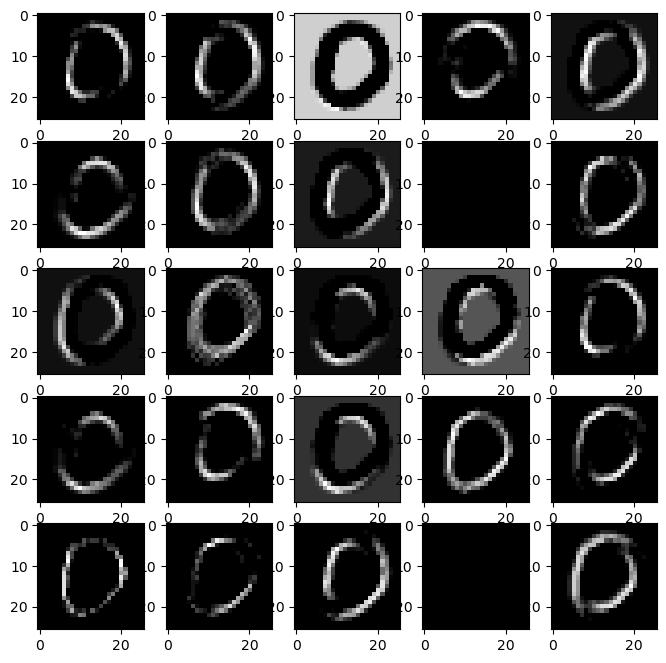

Feature maps of Pooling layer 1


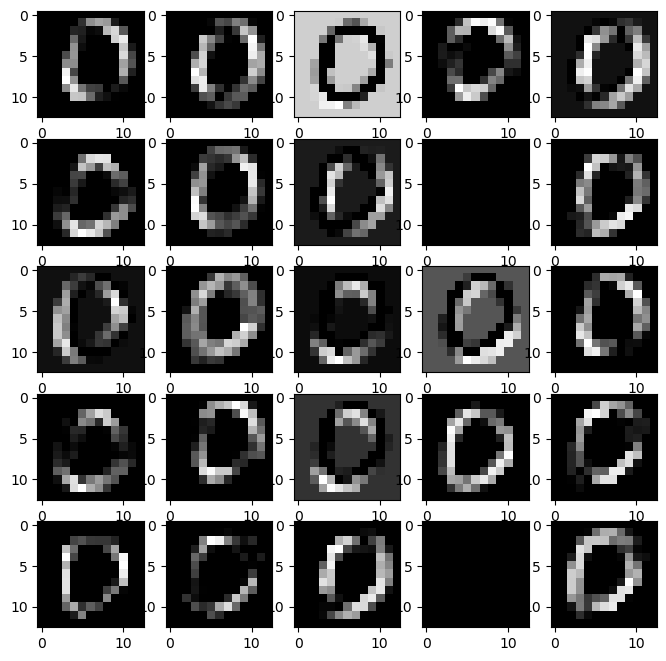

Feature maps of Convo layer 2


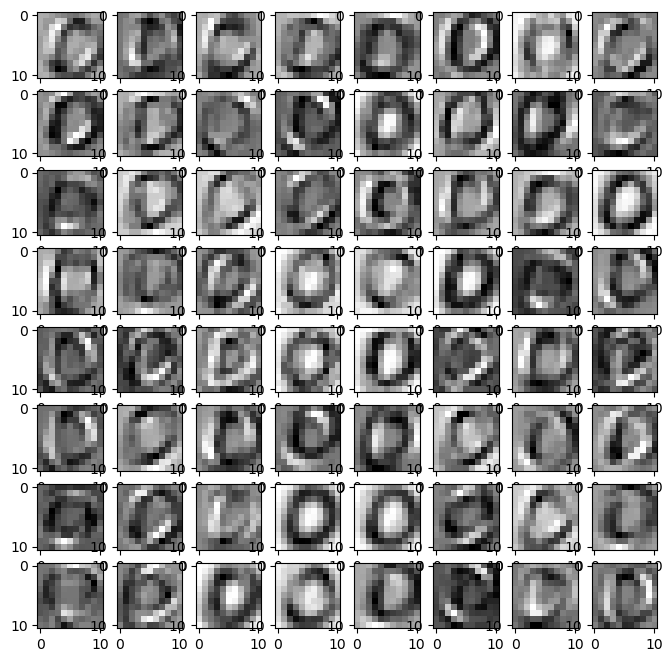

Feature maps of Activation layer 2


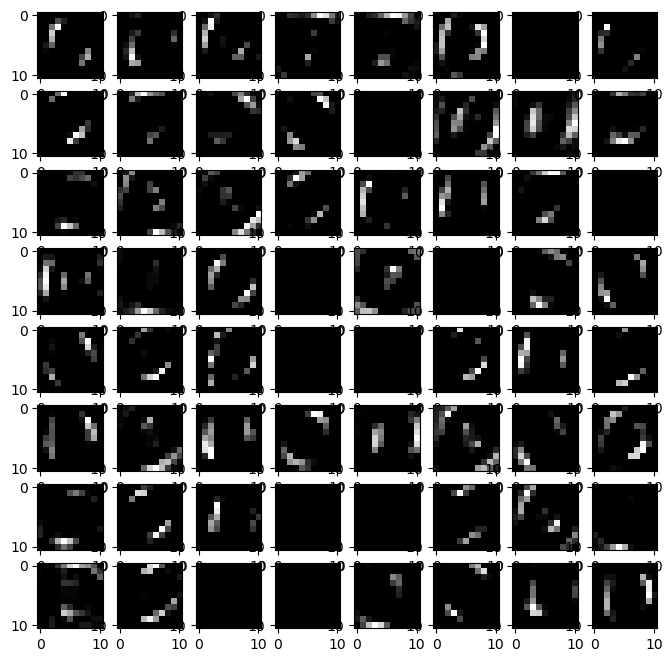

Feature maps of Pooling layer 2


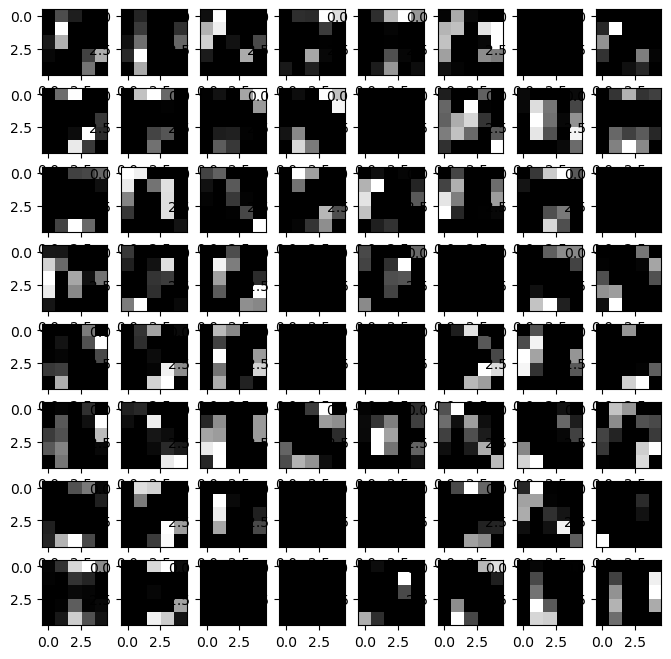

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


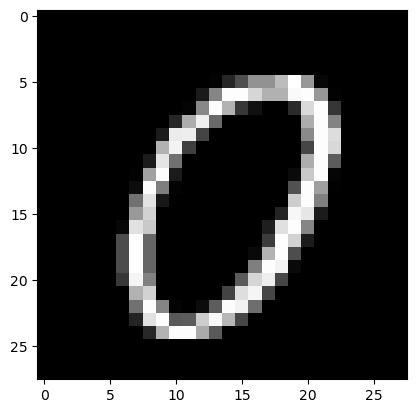

Feature maps of Convo layer 1


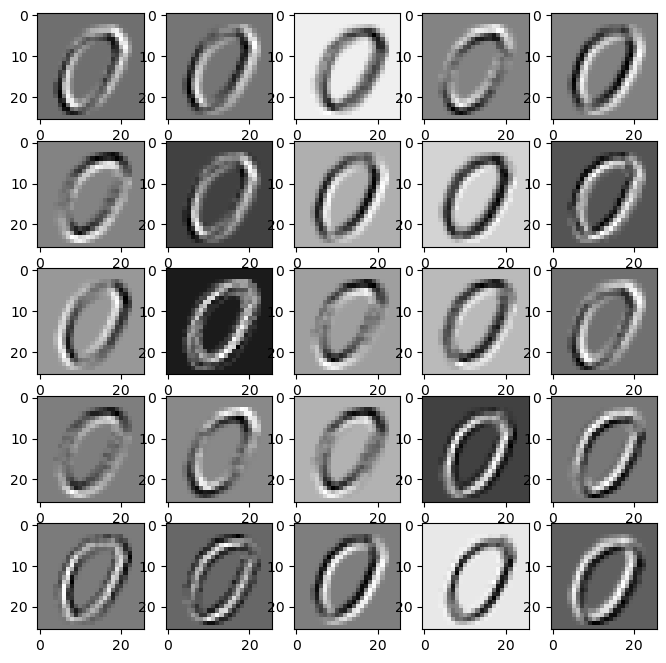

Feature maps of Activation layer 1


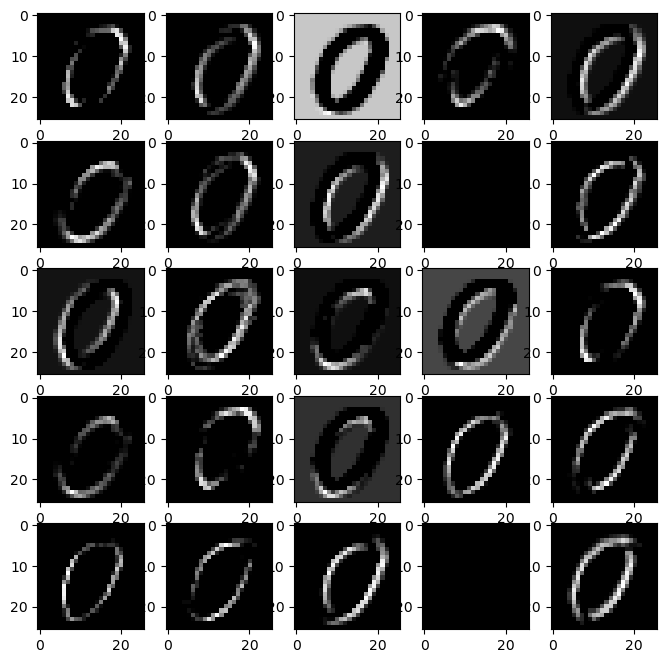

Feature maps of Pooling layer 1


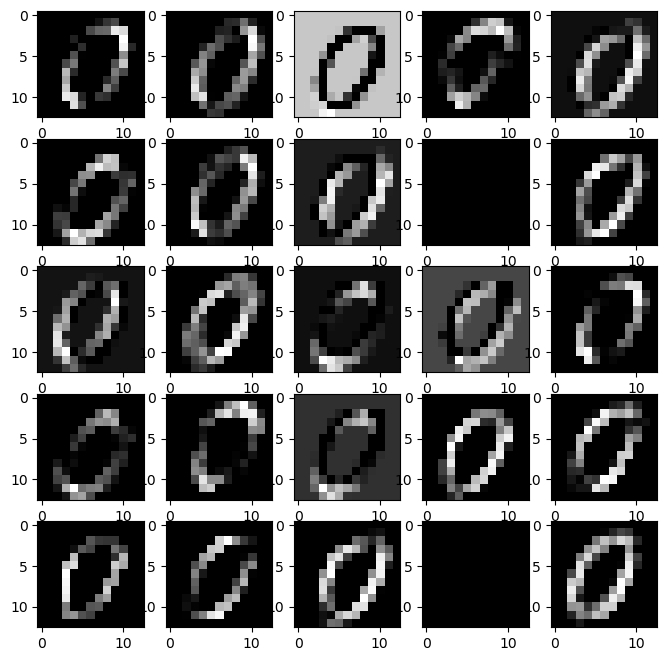

Feature maps of Convo layer 2


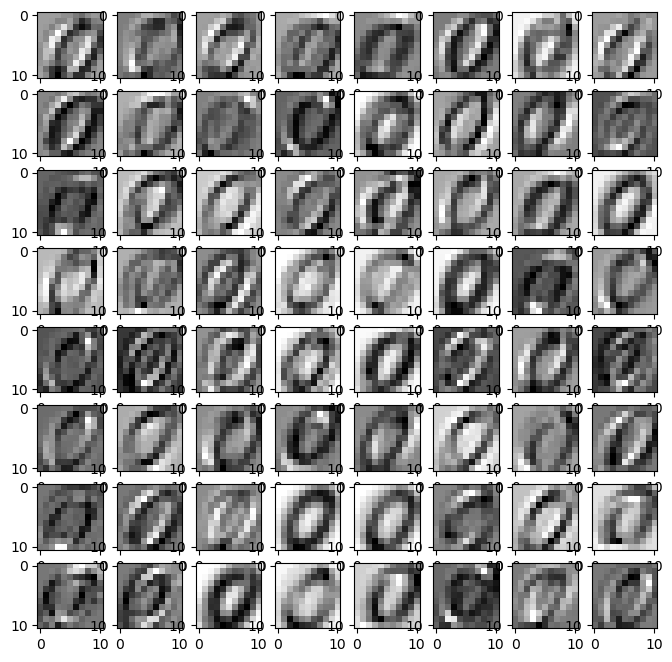

Feature maps of Activation layer 2


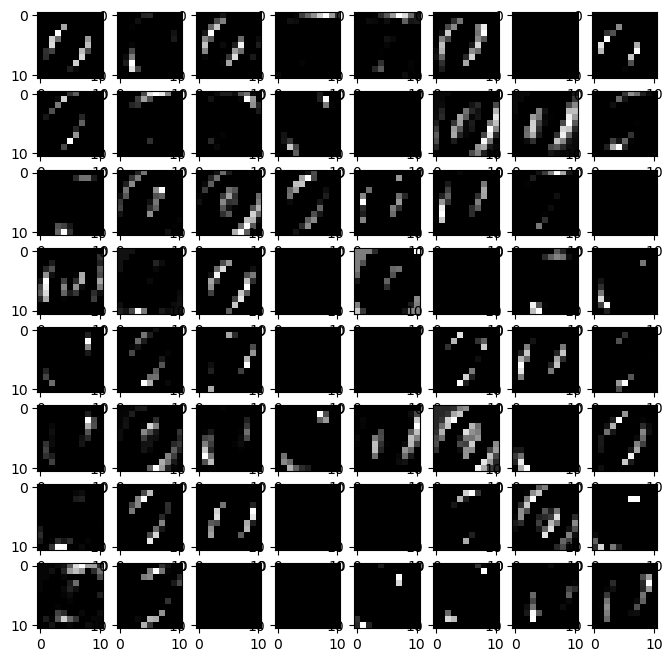

Feature maps of Pooling layer 2


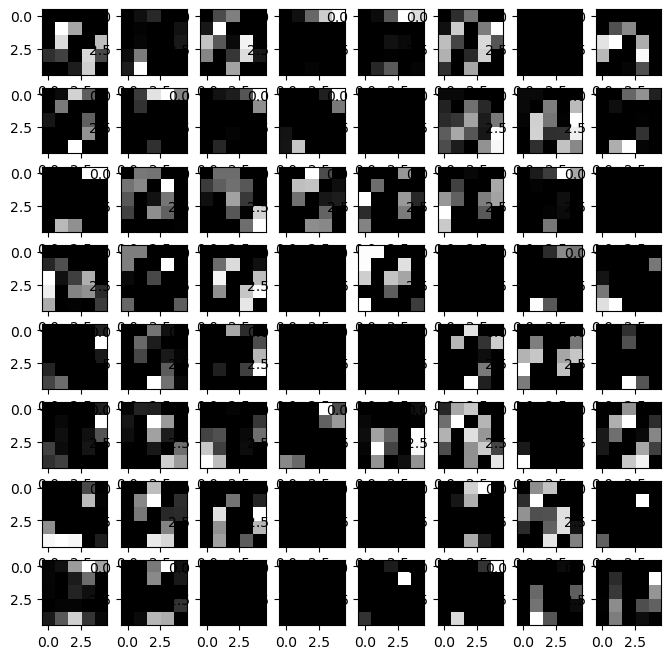

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
Original Image


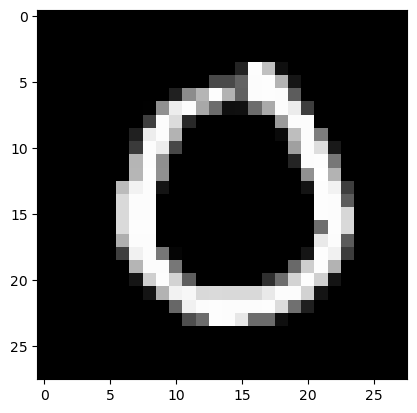

Feature maps of Convo layer 1


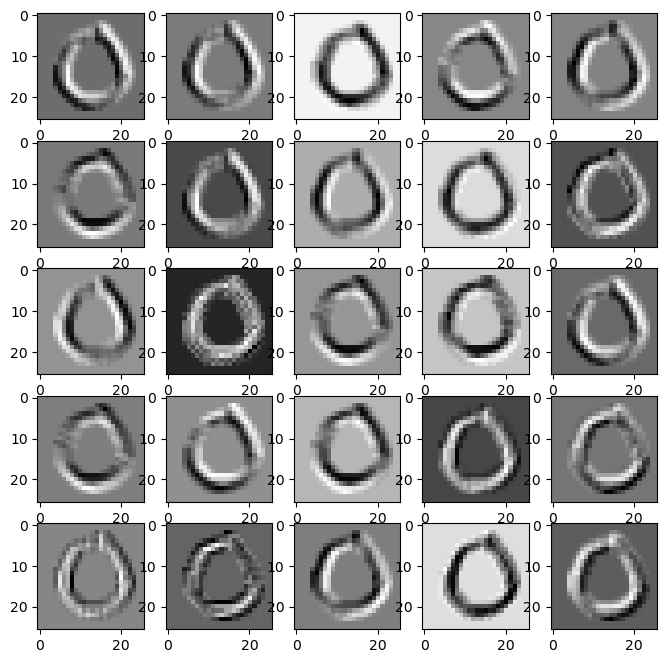

Feature maps of Activation layer 1


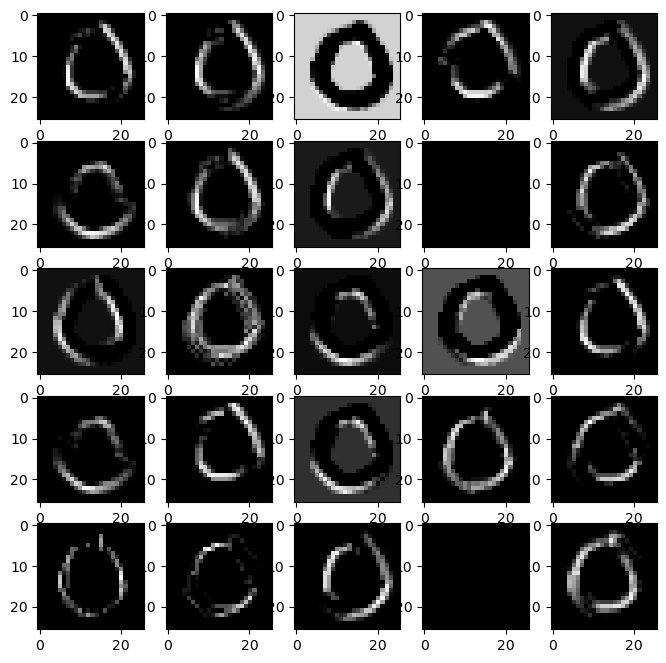

Feature maps of Pooling layer 1


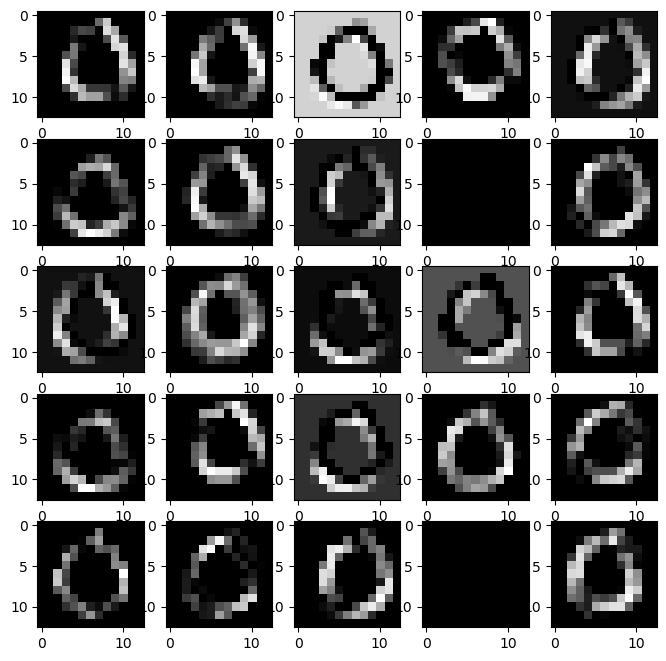

Feature maps of Convo layer 2


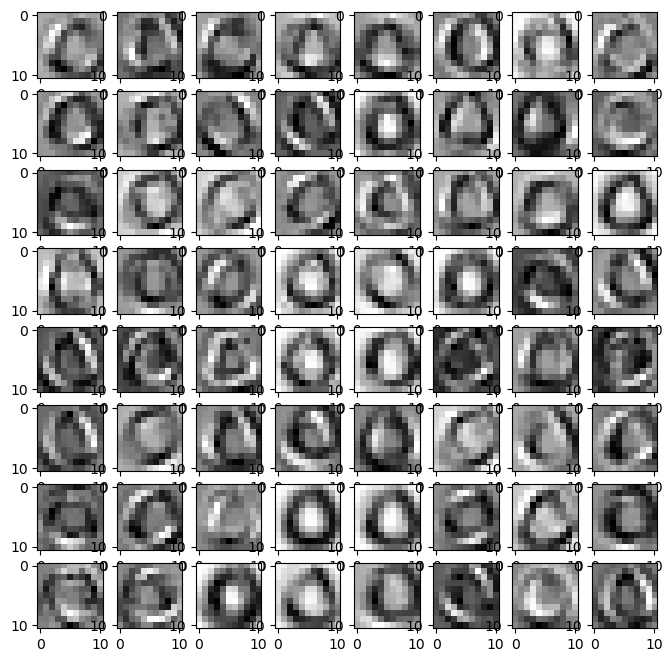

Feature maps of Activation layer 2


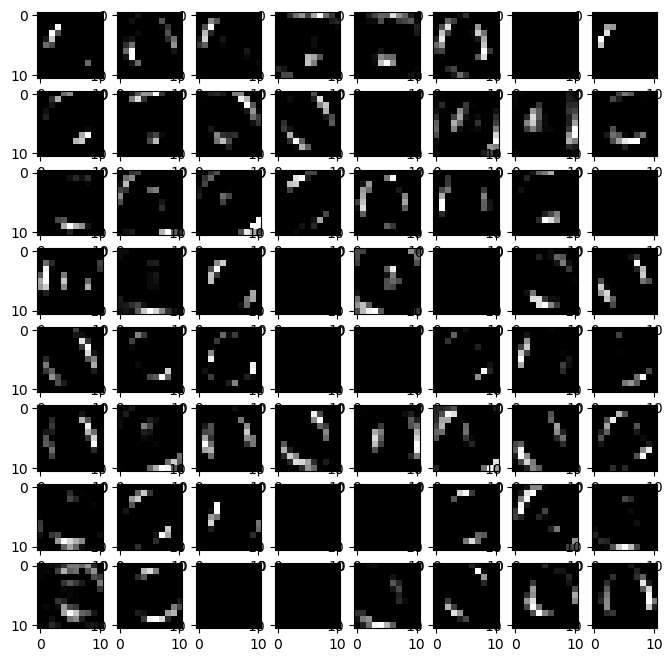

Feature maps of Pooling layer 2


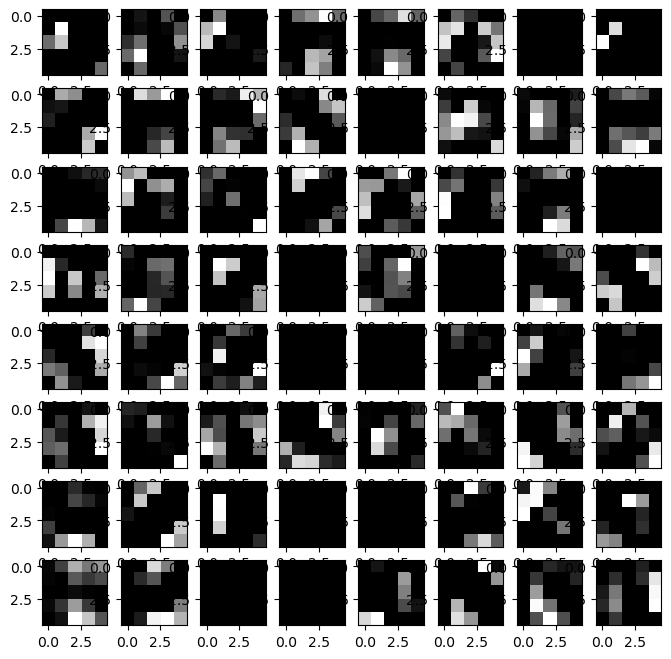

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


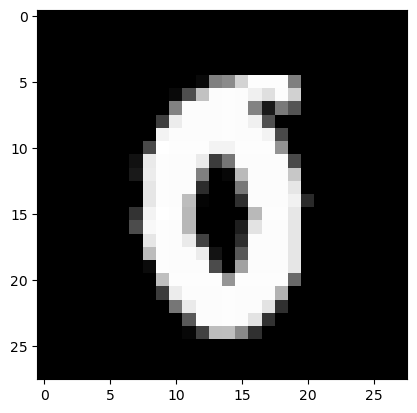

Feature maps of Convo layer 1


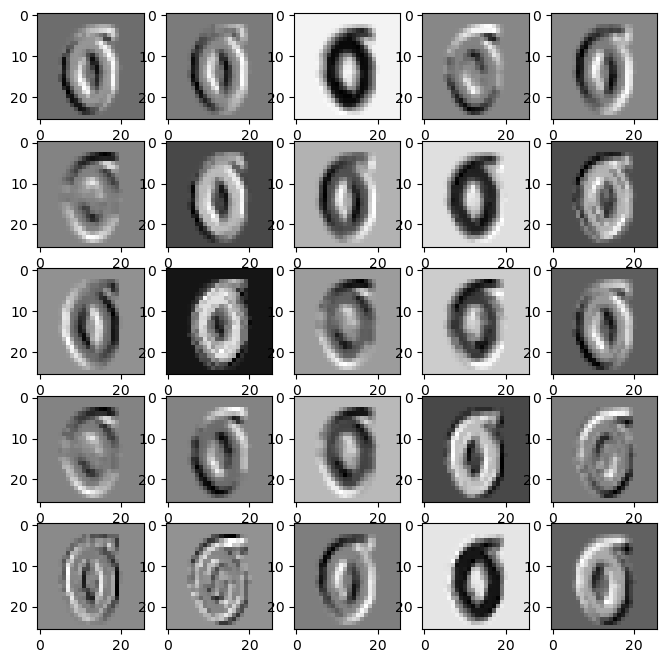

Feature maps of Activation layer 1


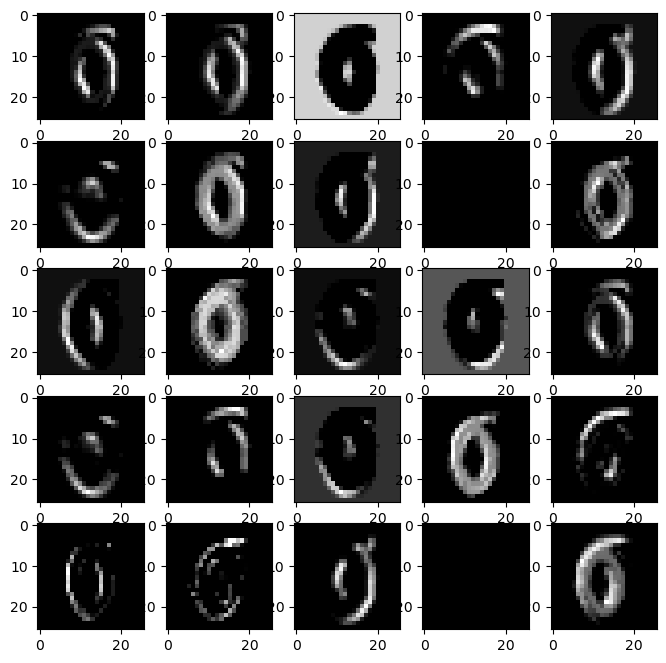

Feature maps of Pooling layer 1


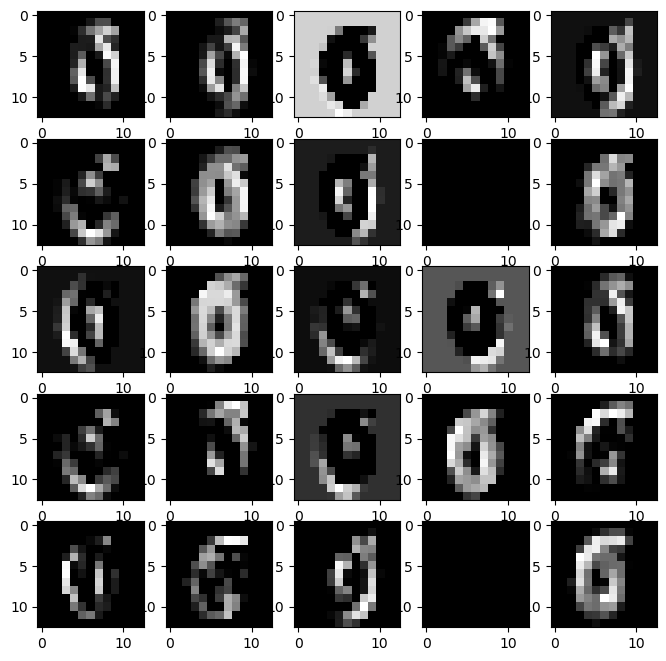

Feature maps of Convo layer 2


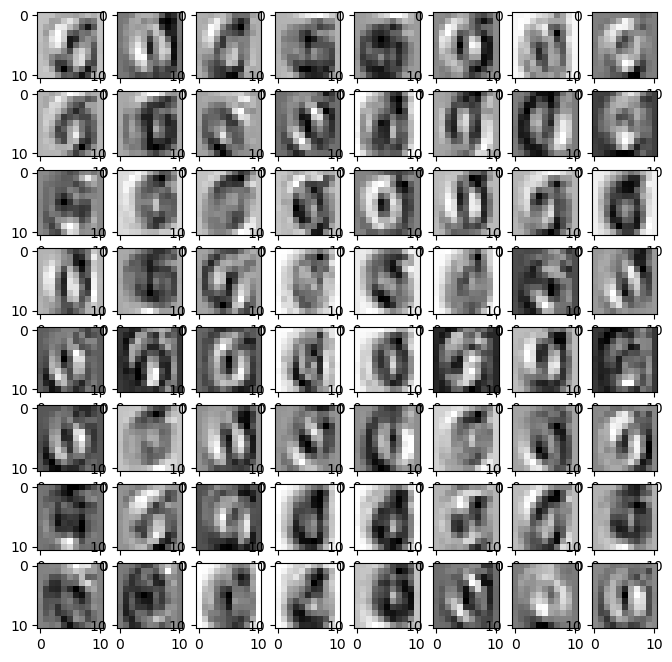

Feature maps of Activation layer 2


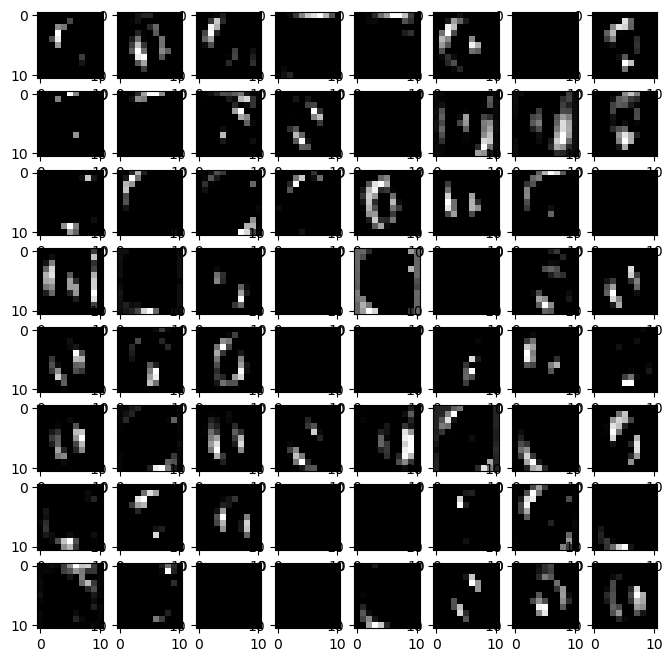

Feature maps of Pooling layer 2


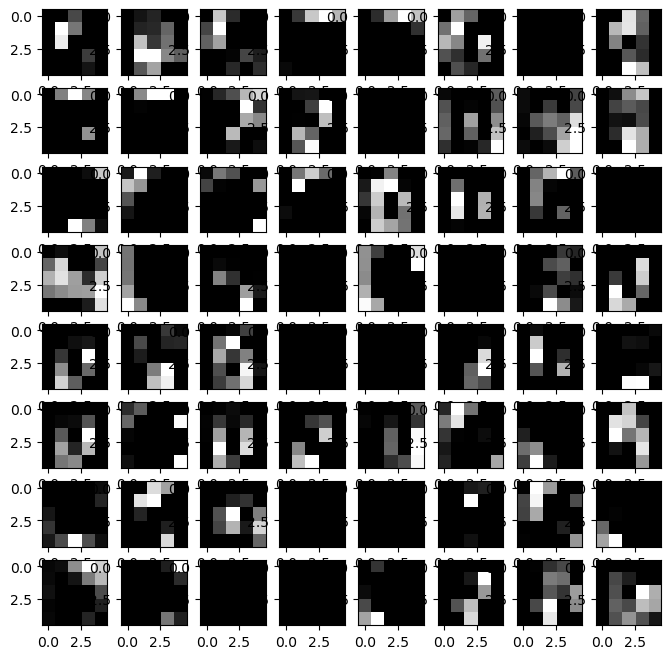

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


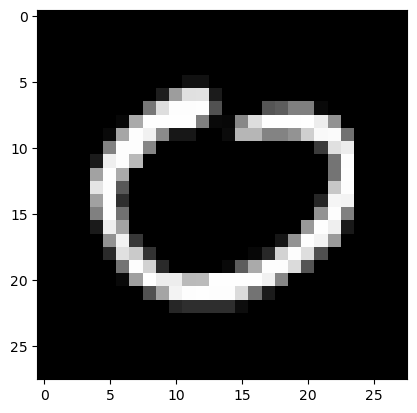

Feature maps of Convo layer 1


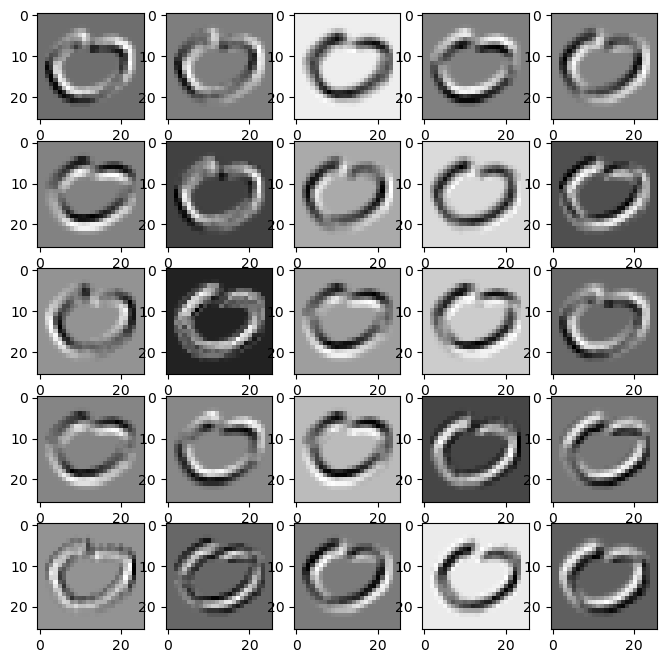

Feature maps of Activation layer 1


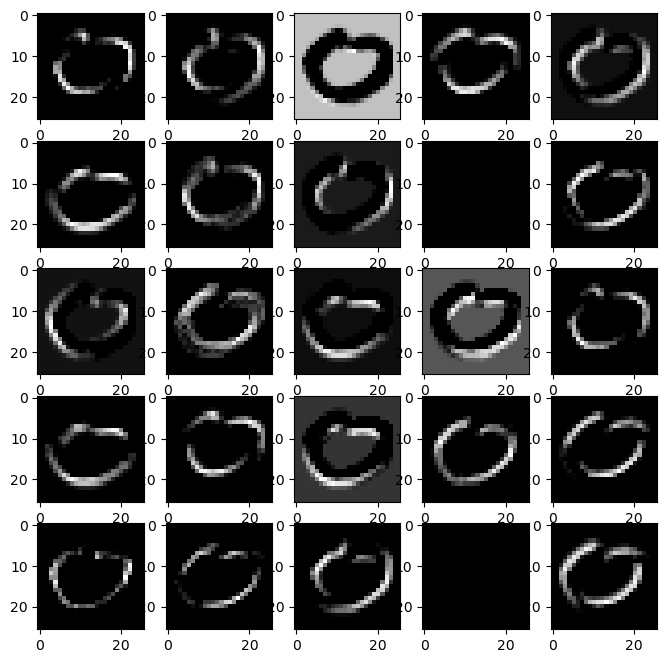

Feature maps of Pooling layer 1


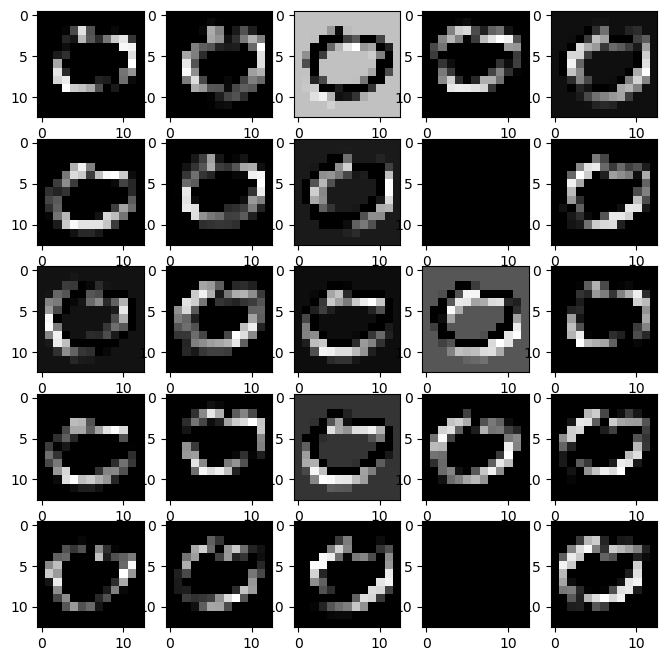

Feature maps of Convo layer 2


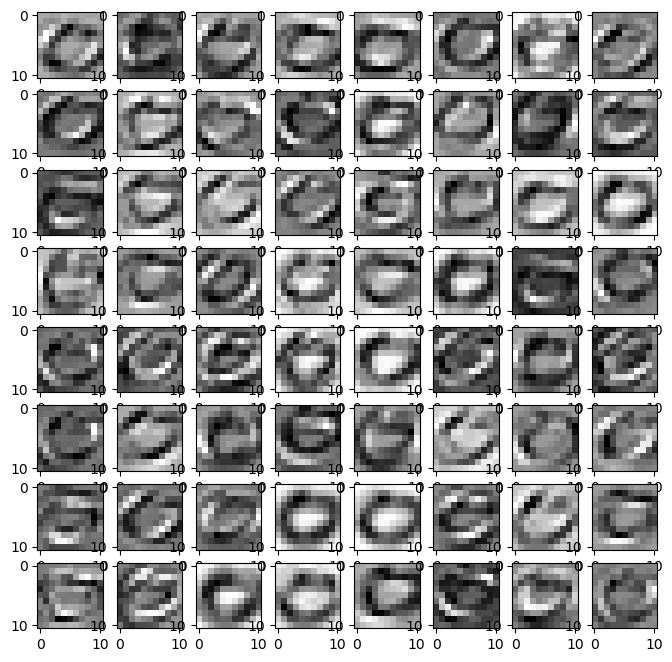

Feature maps of Activation layer 2


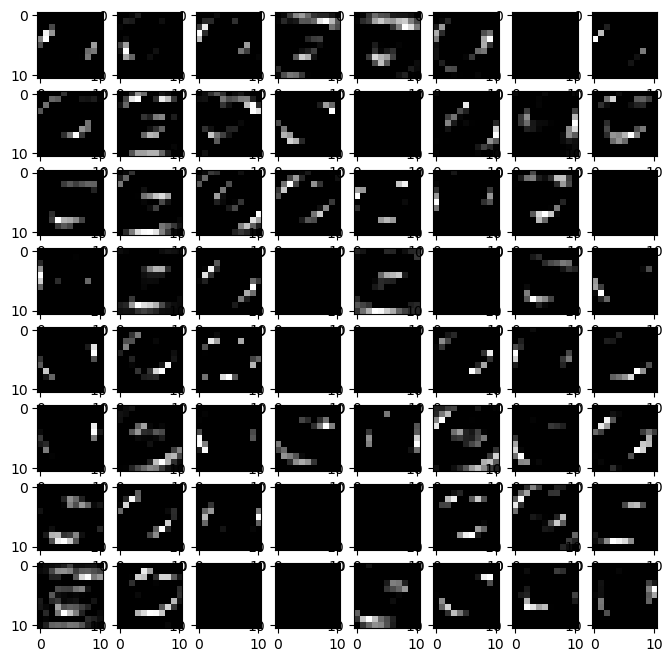

Feature maps of Pooling layer 2


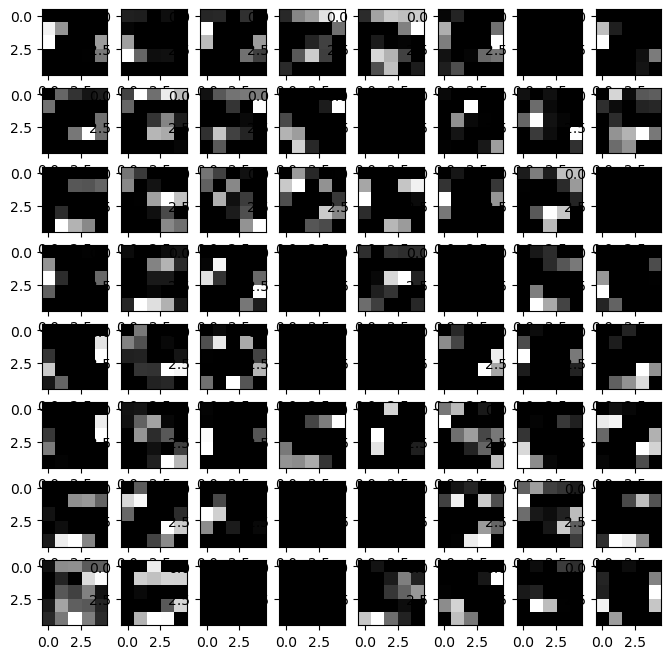

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


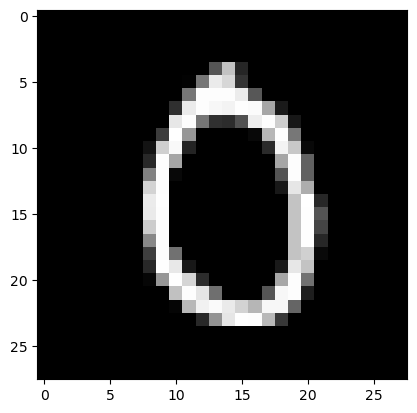

Feature maps of Convo layer 1


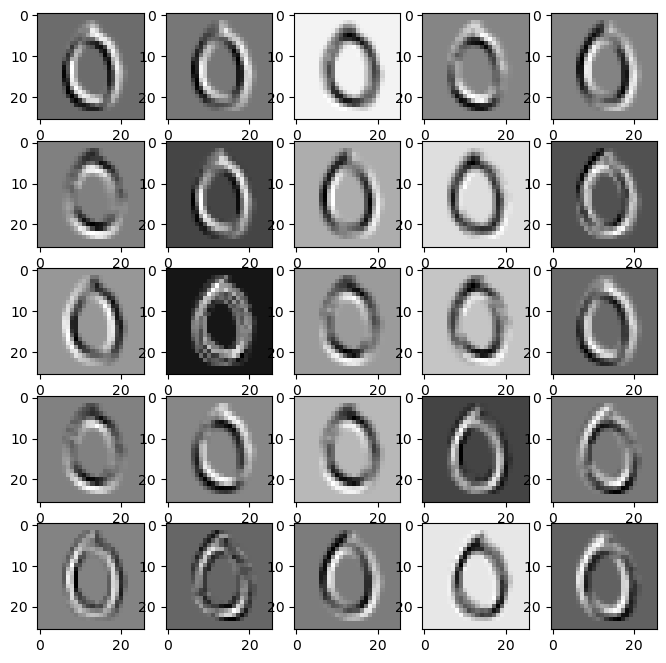

Feature maps of Activation layer 1


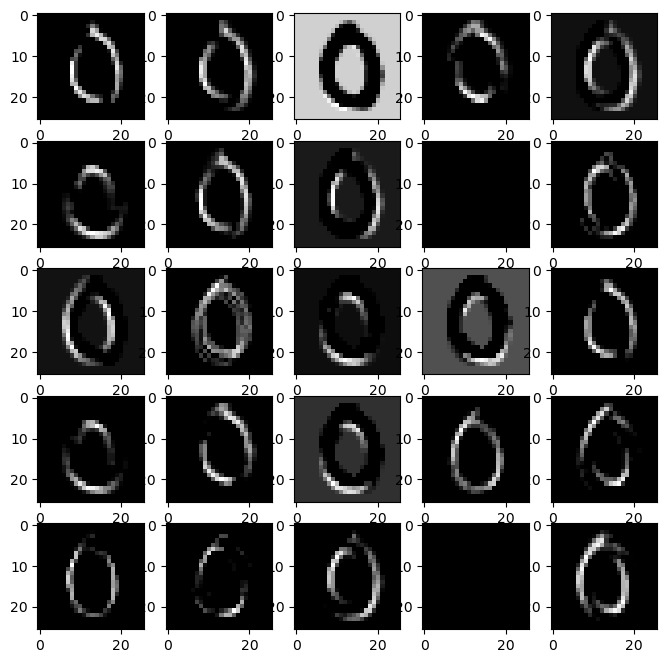

Feature maps of Pooling layer 1


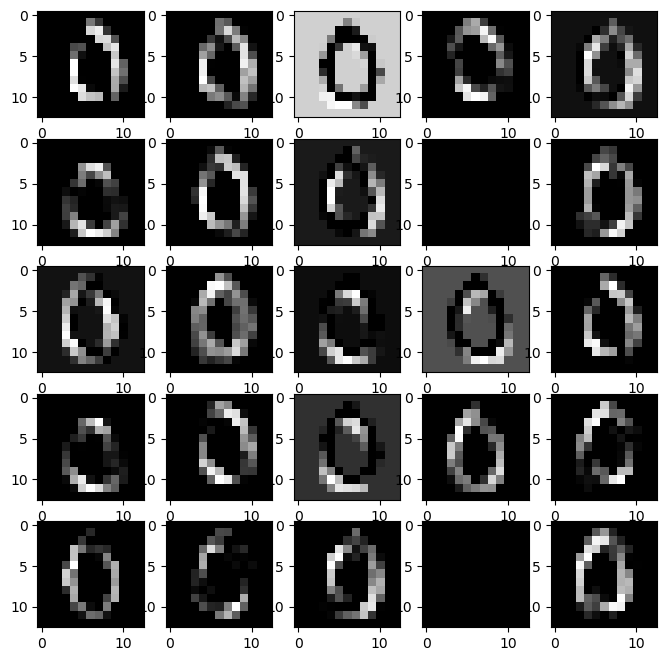

Feature maps of Convo layer 2


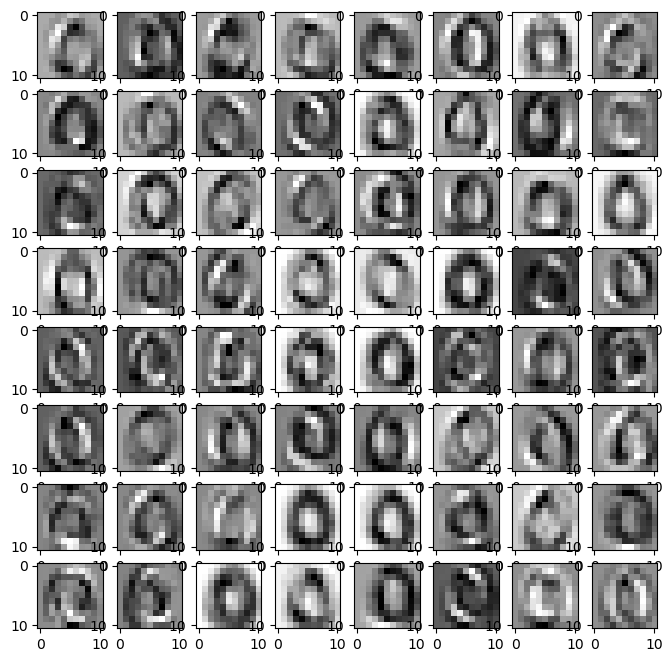

Feature maps of Activation layer 2


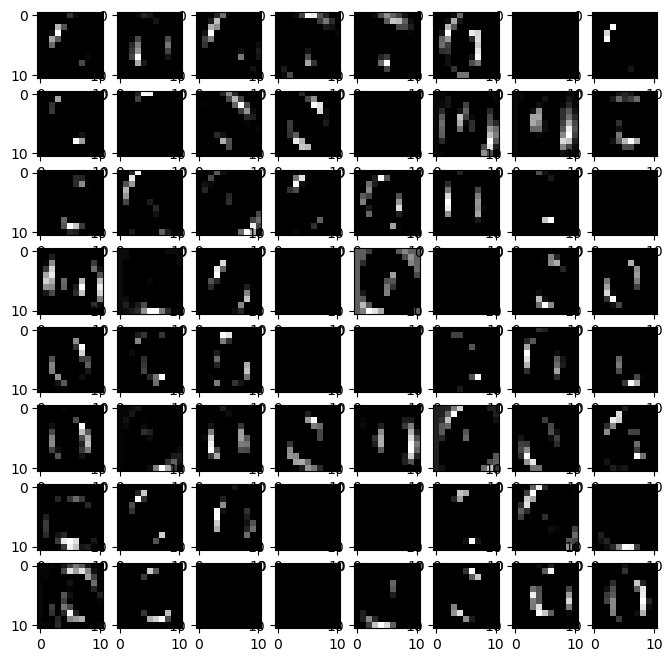

Feature maps of Pooling layer 2


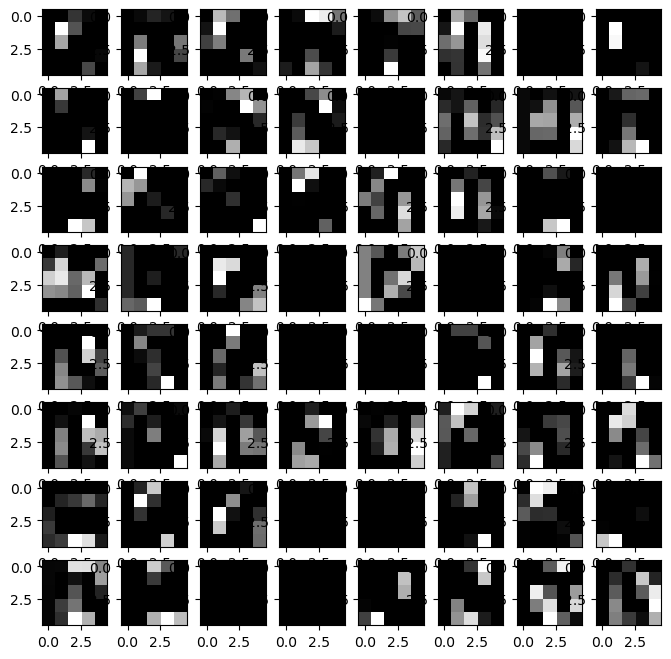

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


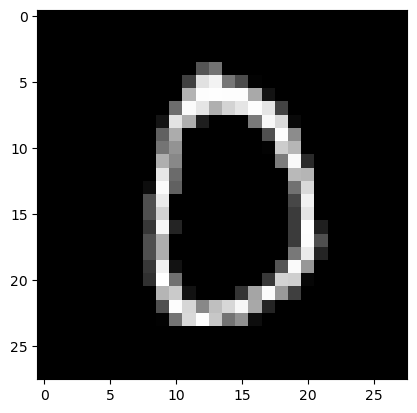

Feature maps of Convo layer 1


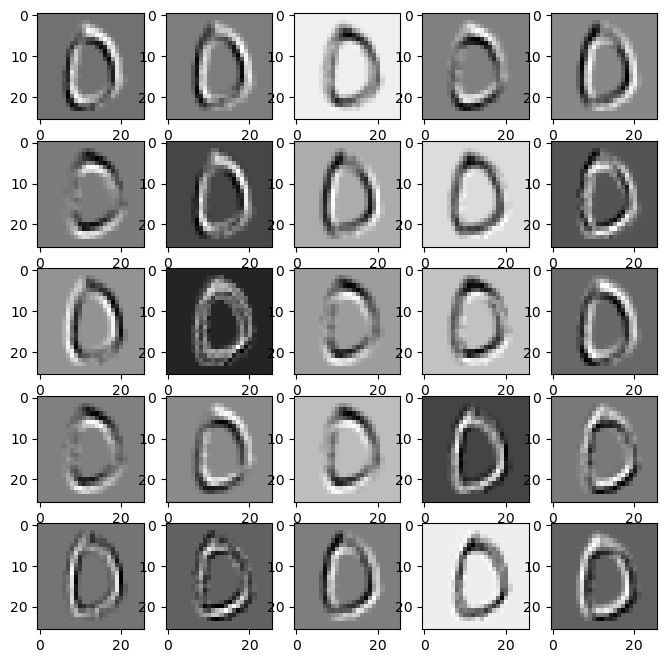

Feature maps of Activation layer 1


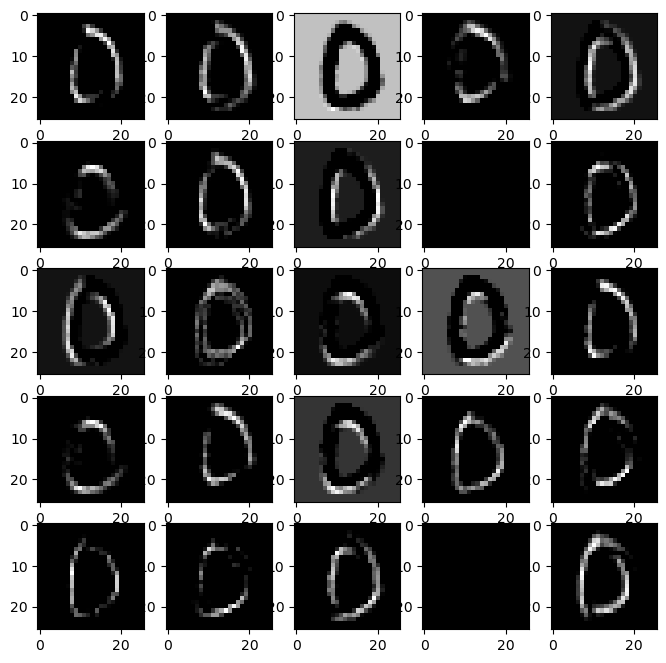

Feature maps of Pooling layer 1


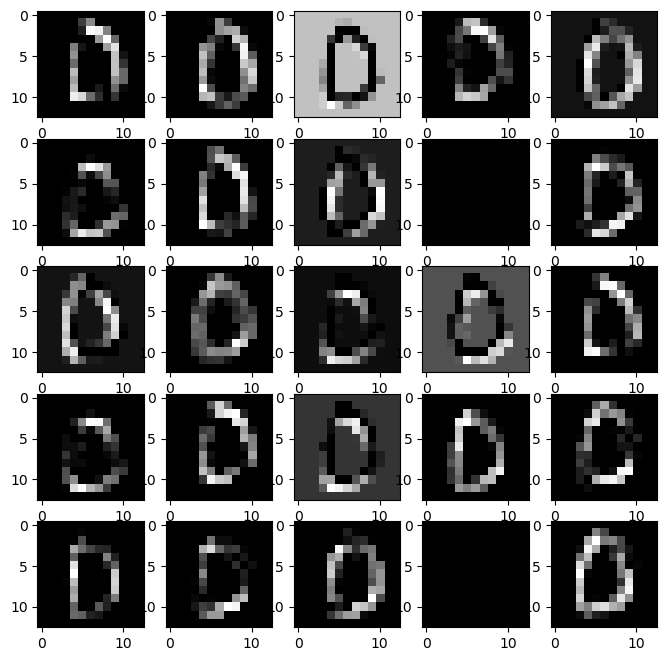

Feature maps of Convo layer 2


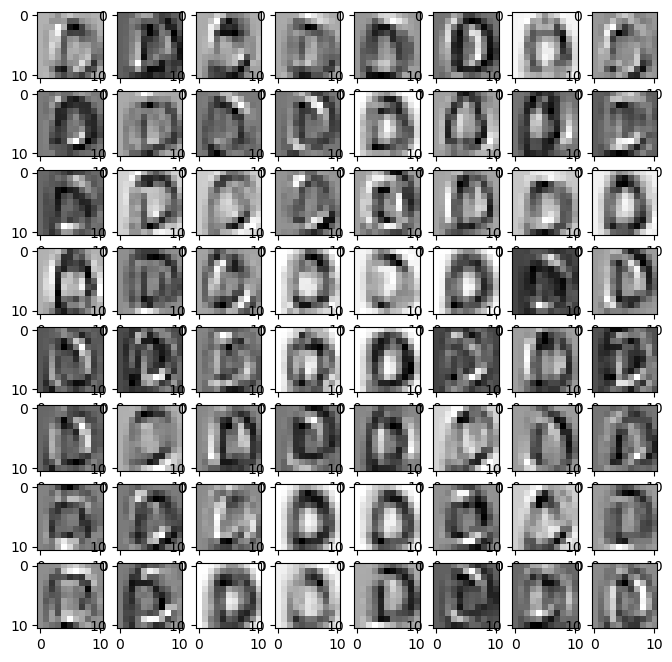

Feature maps of Activation layer 2


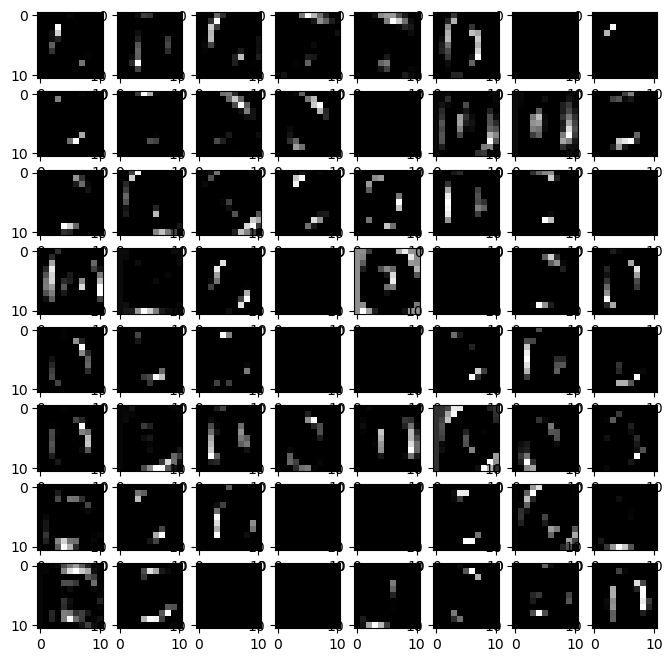

Feature maps of Pooling layer 2


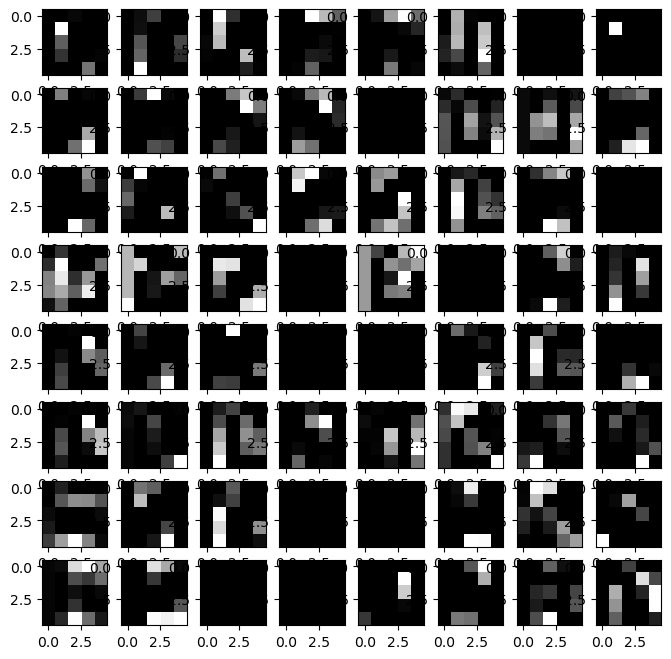

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


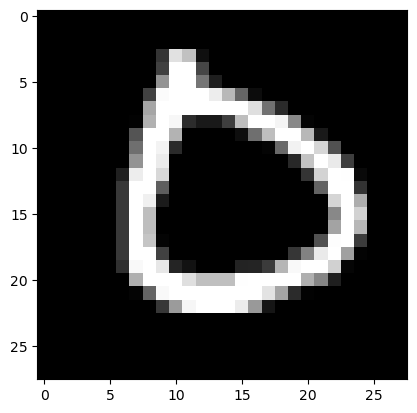

Feature maps of Convo layer 1


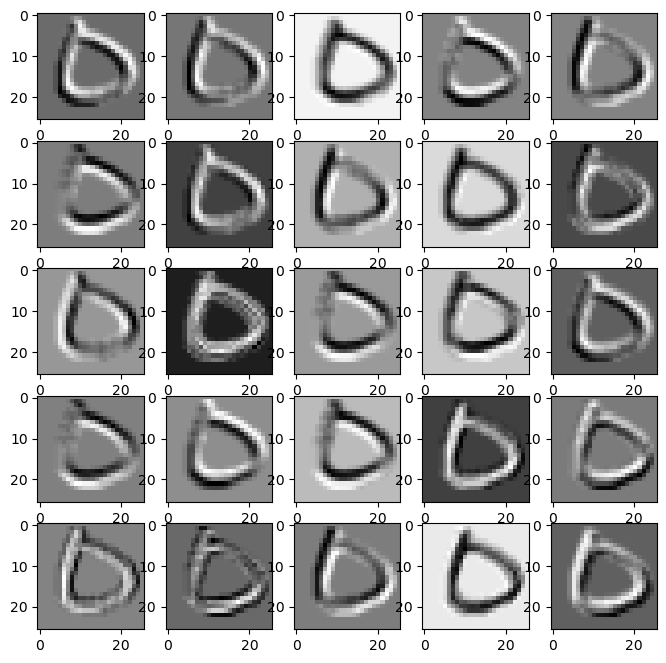

Feature maps of Activation layer 1


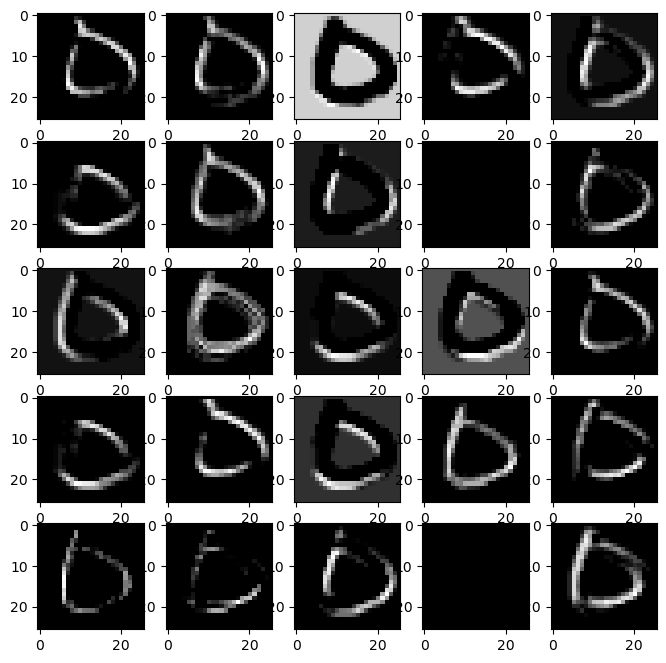

Feature maps of Pooling layer 1


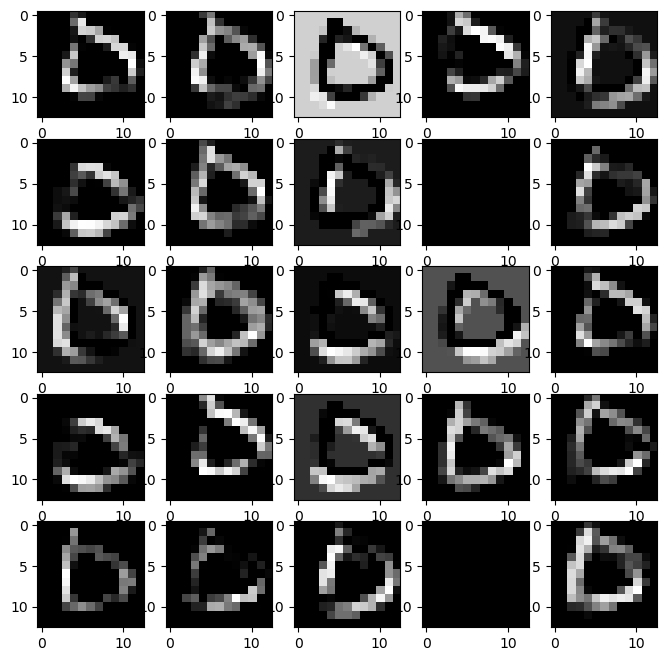

Feature maps of Convo layer 2


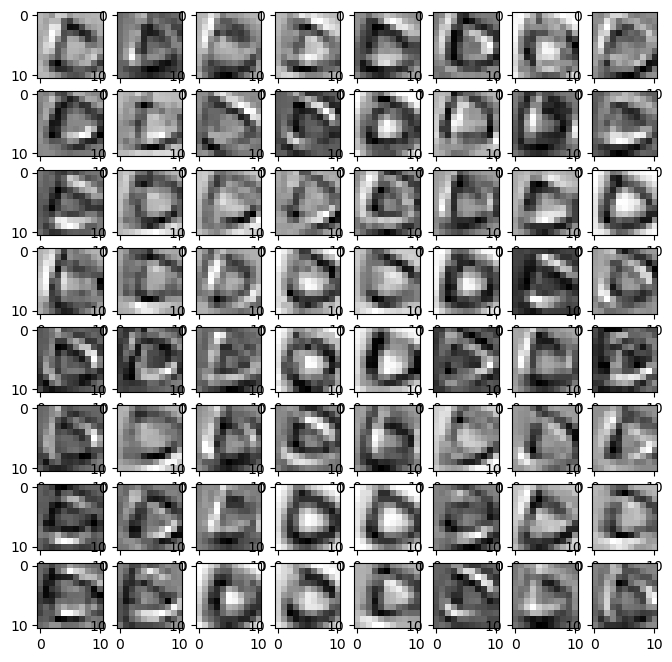

Feature maps of Activation layer 2


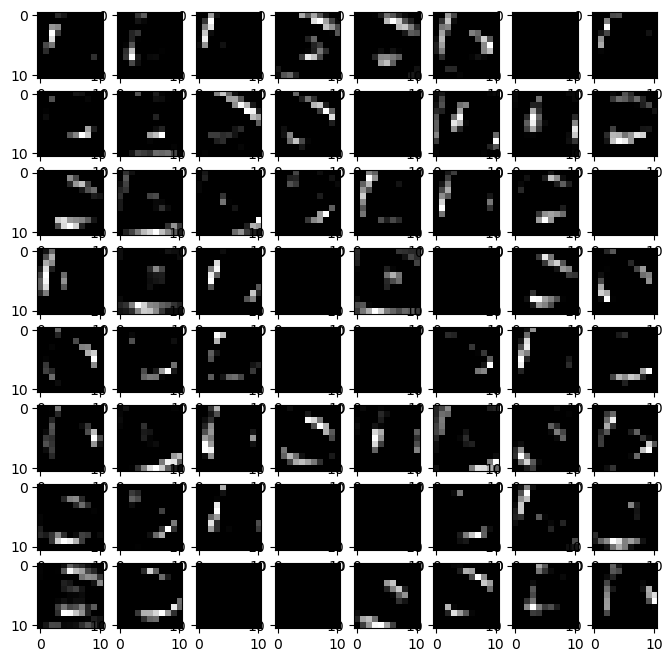

Feature maps of Pooling layer 2


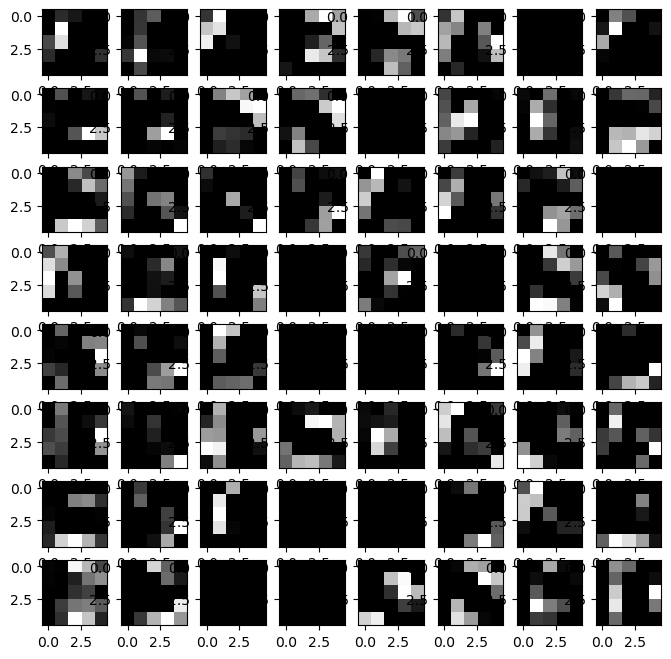

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


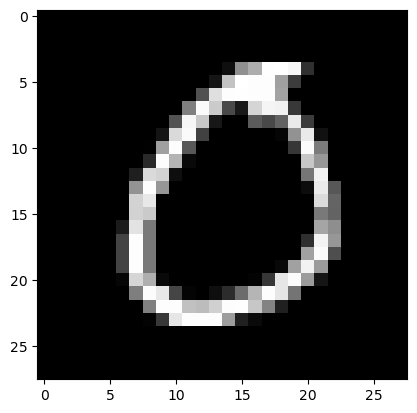

Feature maps of Convo layer 1


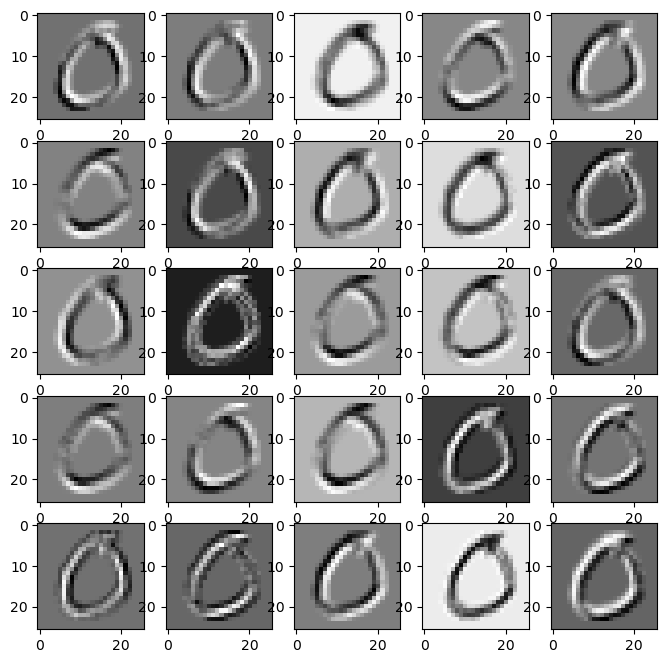

Feature maps of Activation layer 1


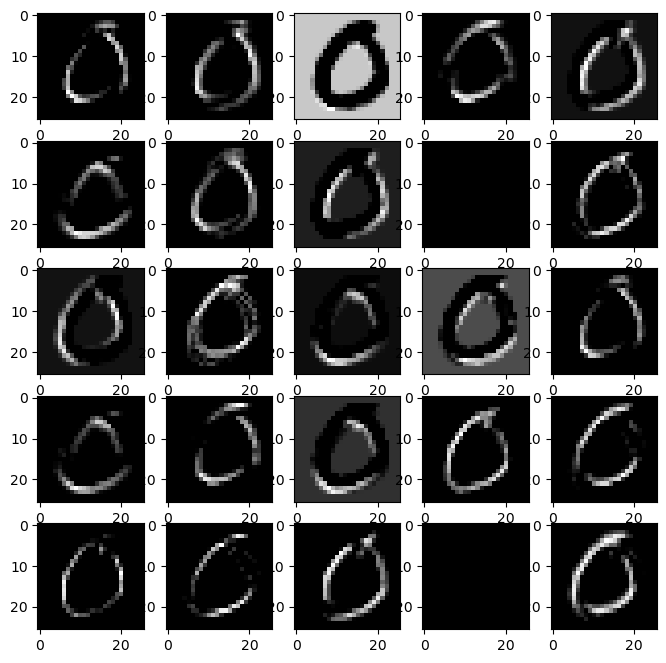

Feature maps of Pooling layer 1


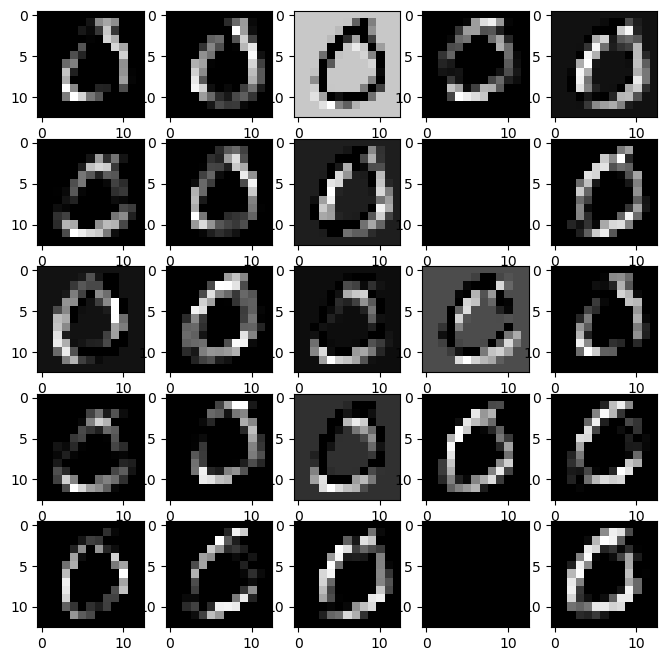

Feature maps of Convo layer 2


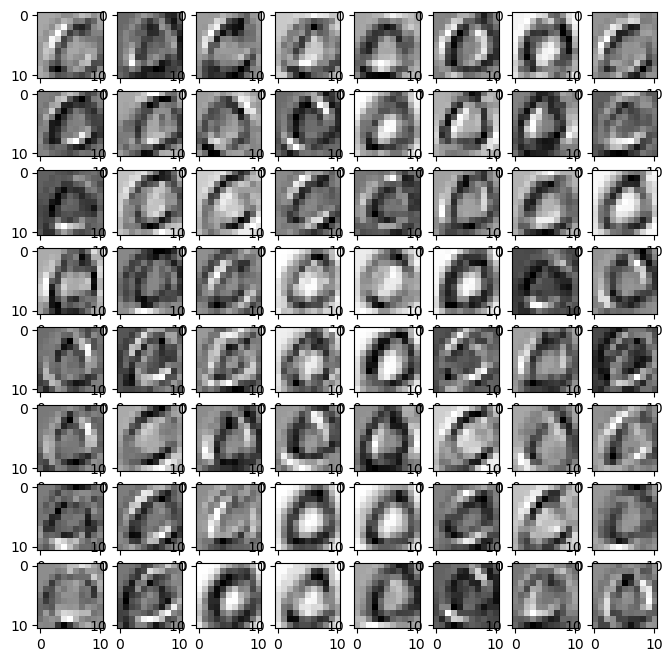

Feature maps of Activation layer 2


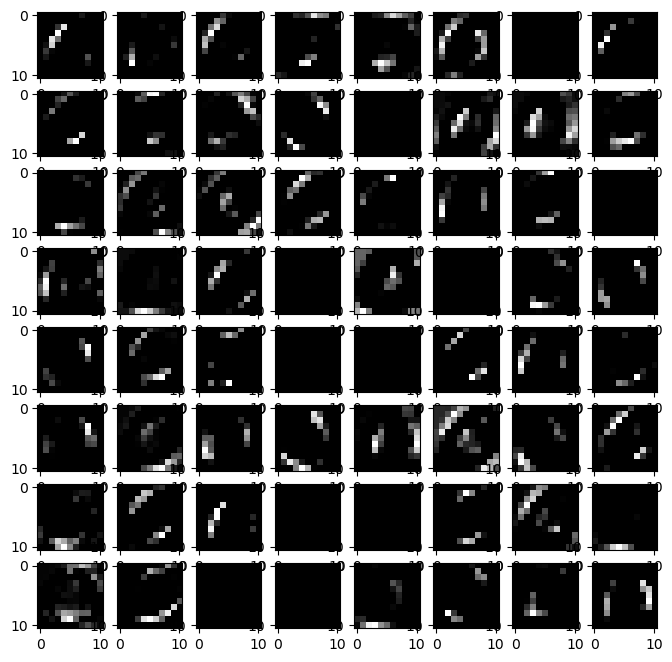

Feature maps of Pooling layer 2


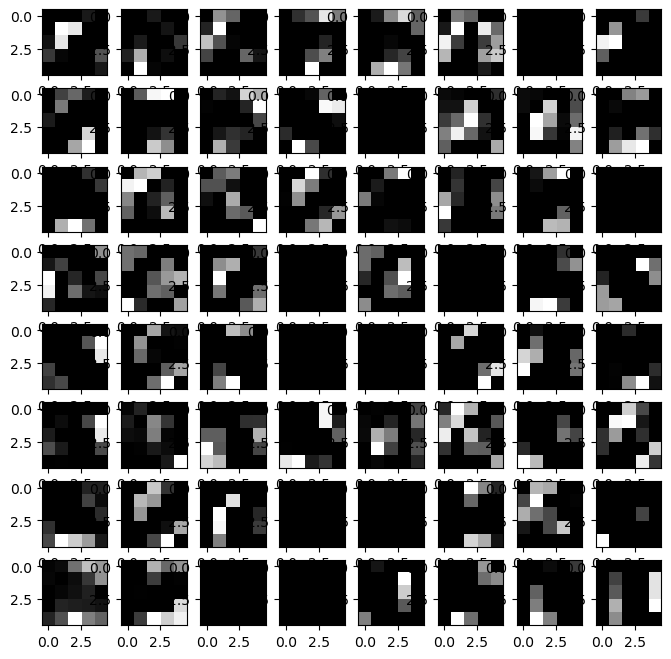

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


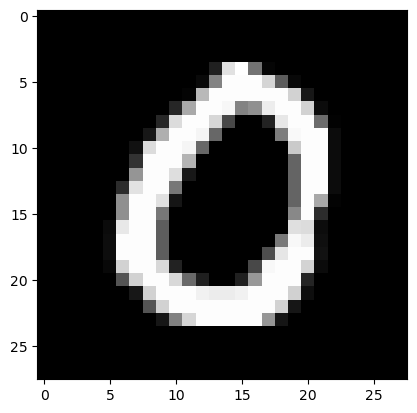

Feature maps of Convo layer 1


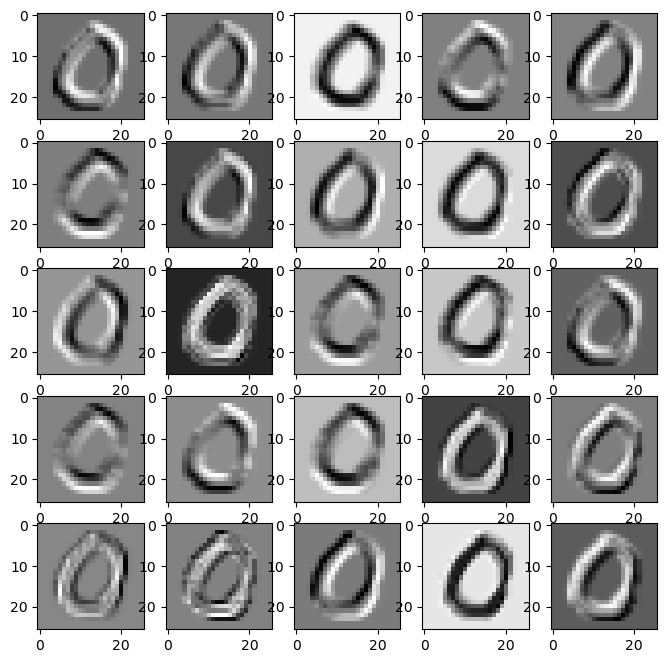

Feature maps of Activation layer 1


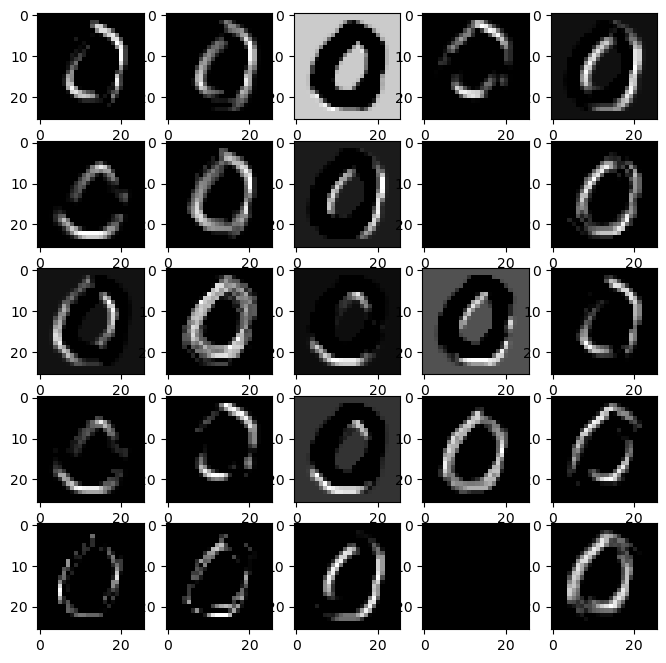

Feature maps of Pooling layer 1


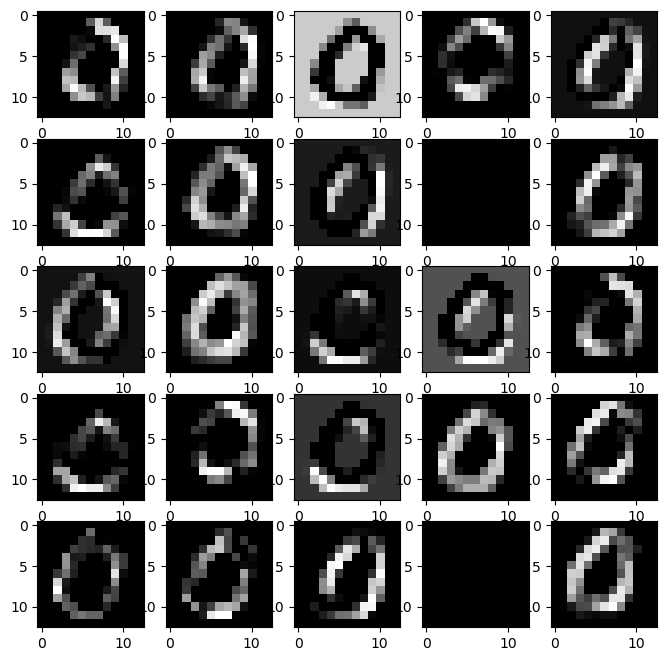

Feature maps of Convo layer 2


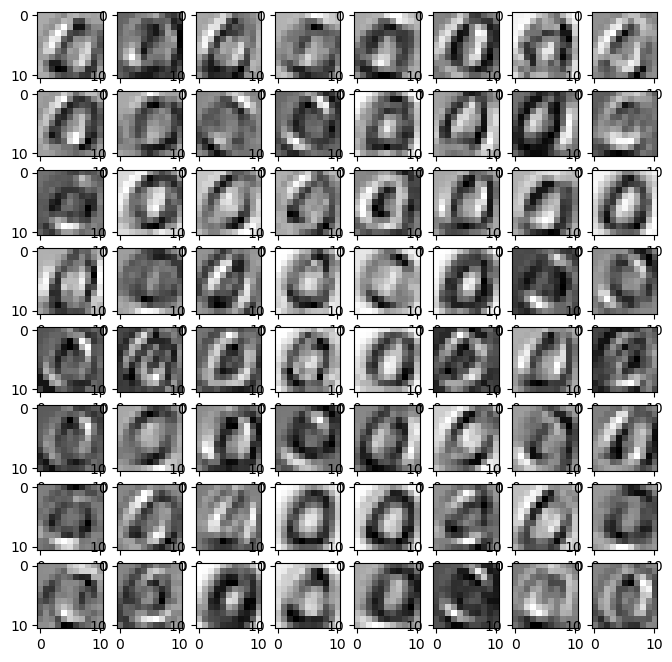

Feature maps of Activation layer 2


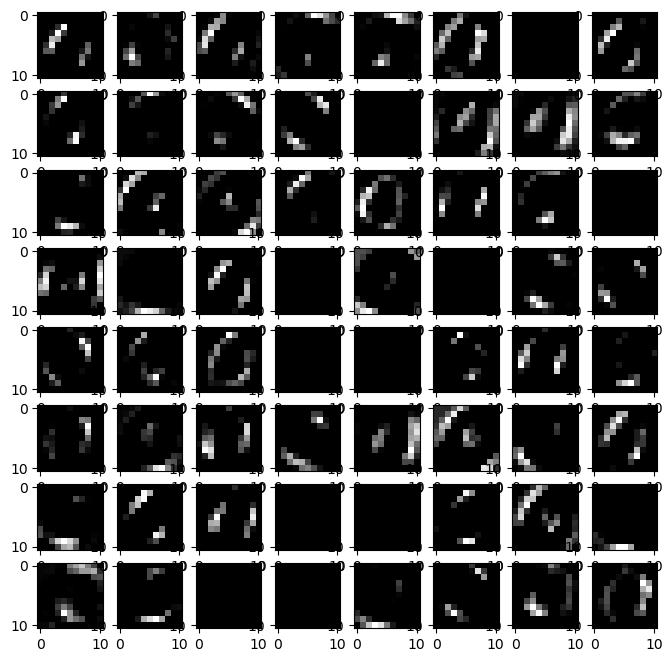

Feature maps of Pooling layer 2


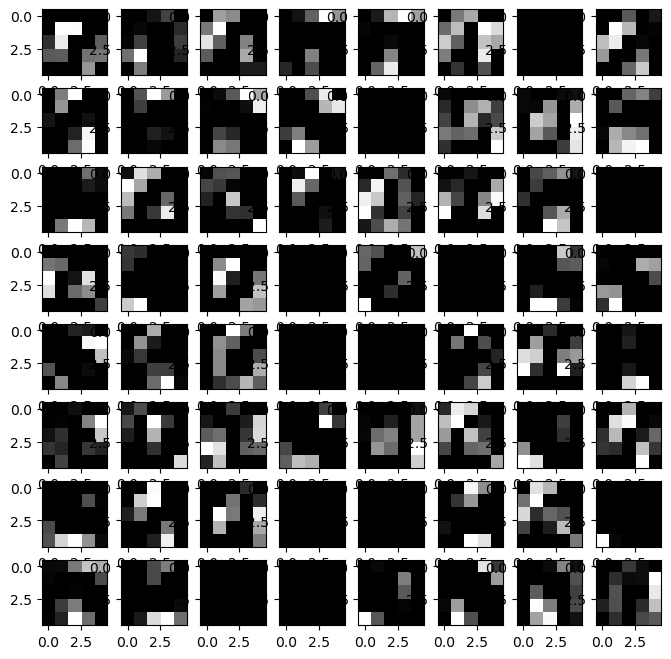

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


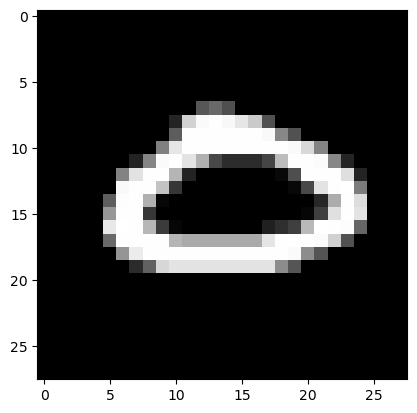

Feature maps of Convo layer 1


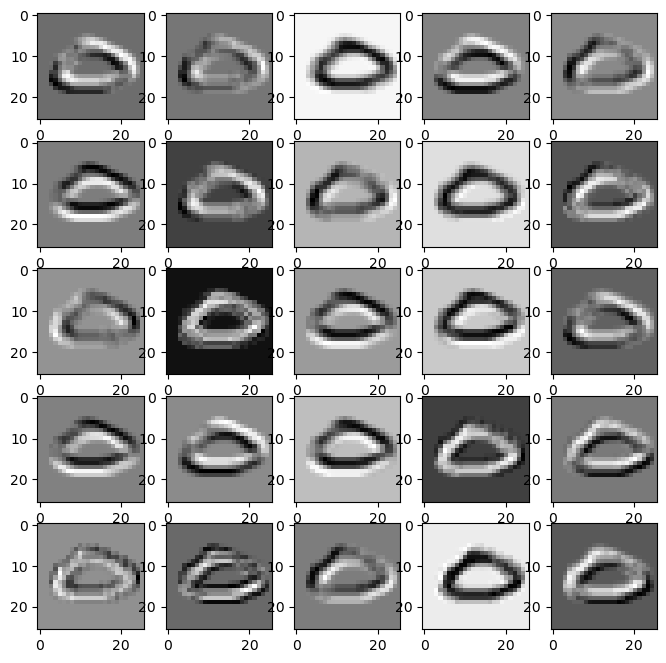

Feature maps of Activation layer 1


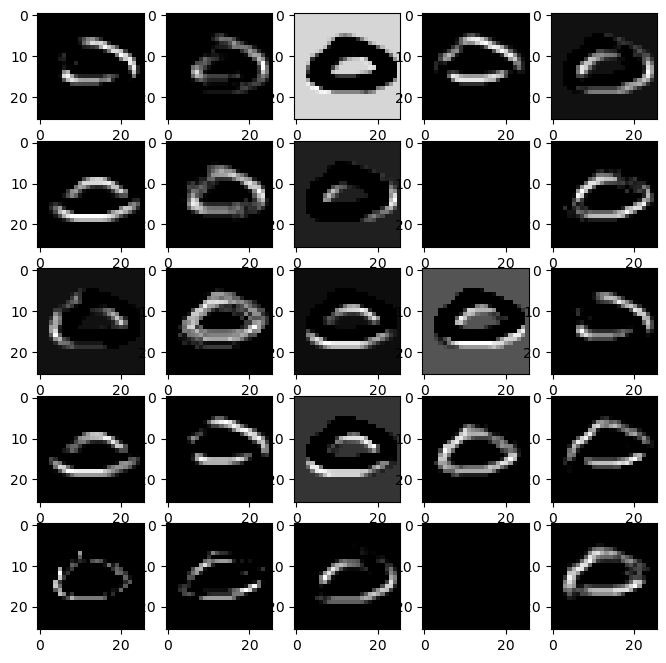

Feature maps of Pooling layer 1


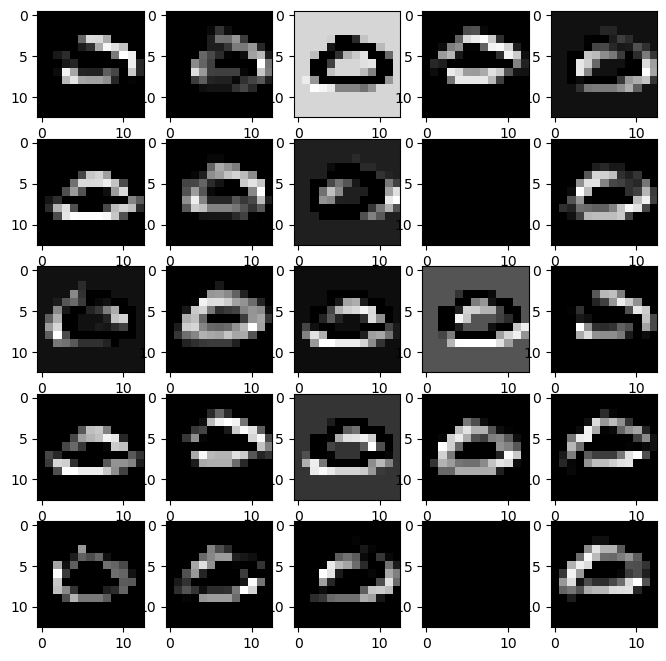

Feature maps of Convo layer 2


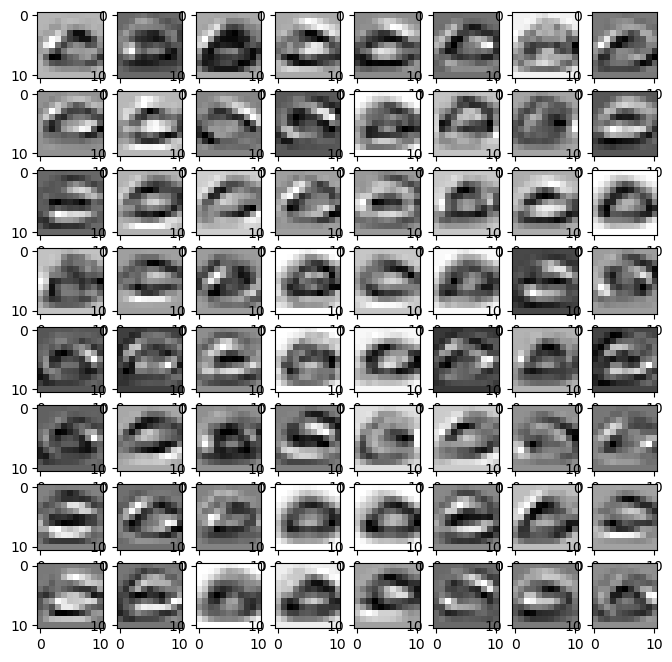

Feature maps of Activation layer 2


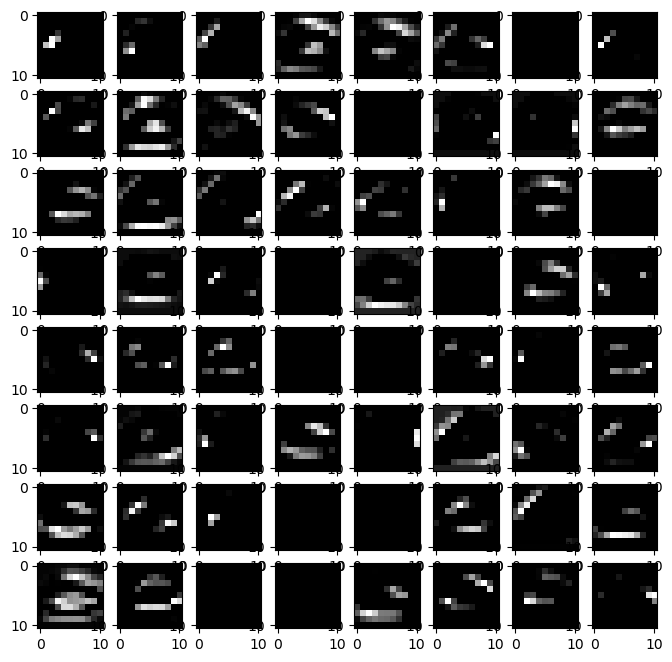

Feature maps of Pooling layer 2


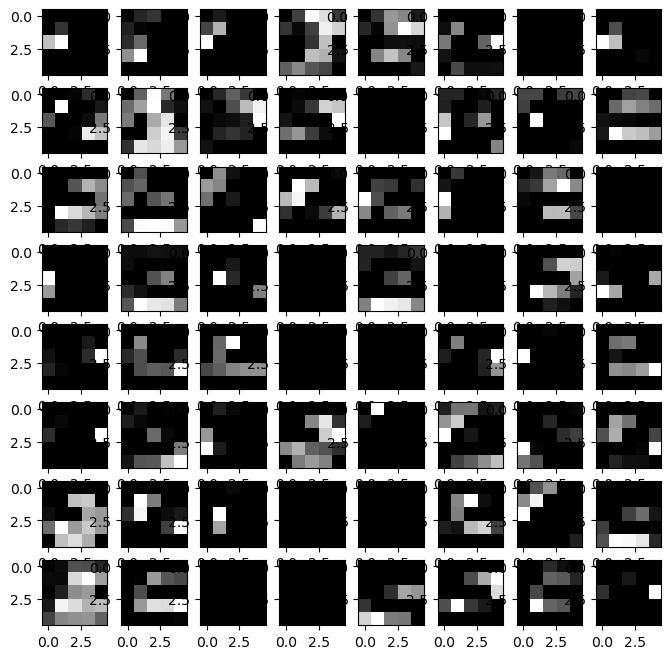

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


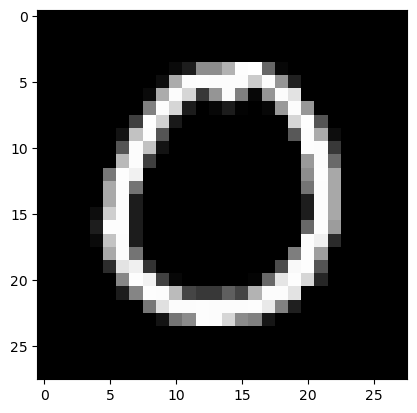

Feature maps of Convo layer 1


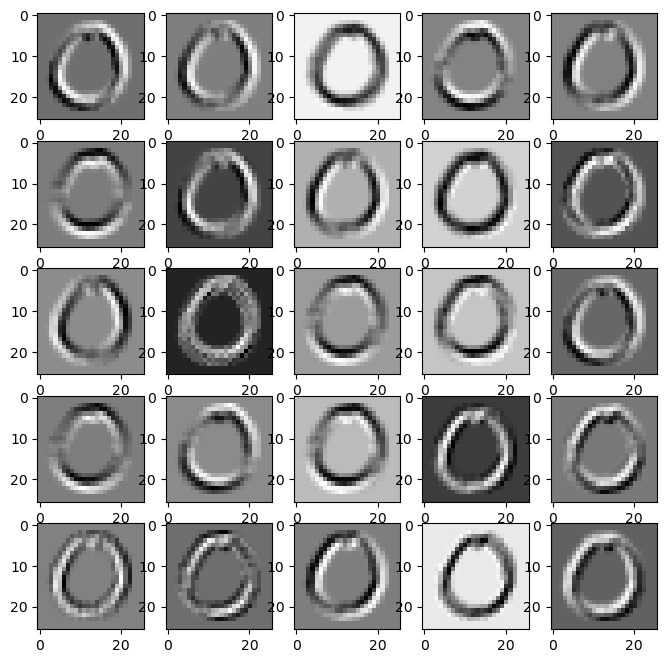

Feature maps of Activation layer 1


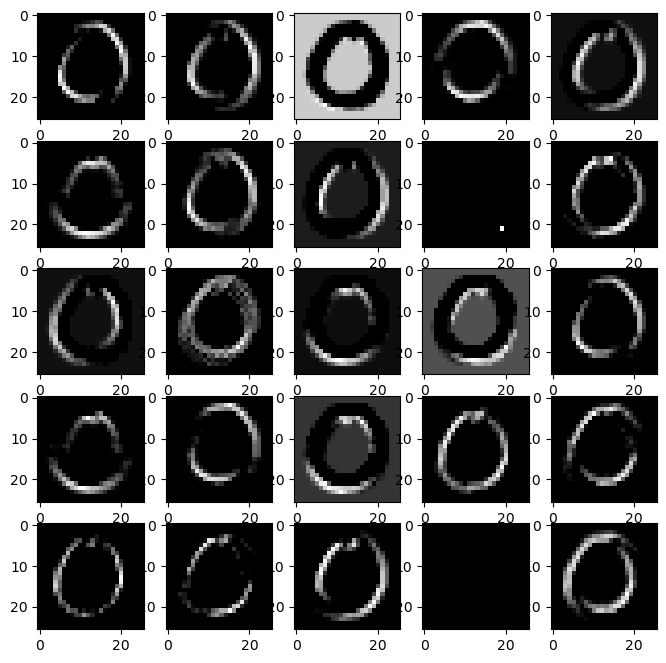

Feature maps of Pooling layer 1


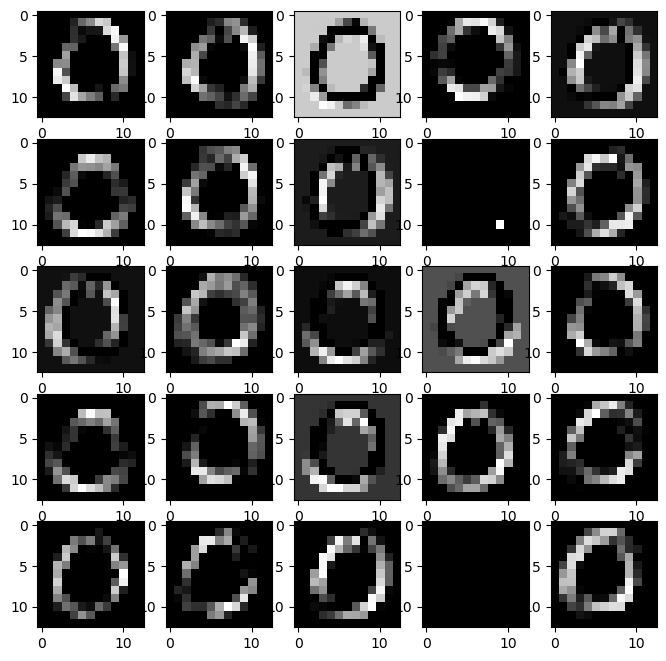

Feature maps of Convo layer 2


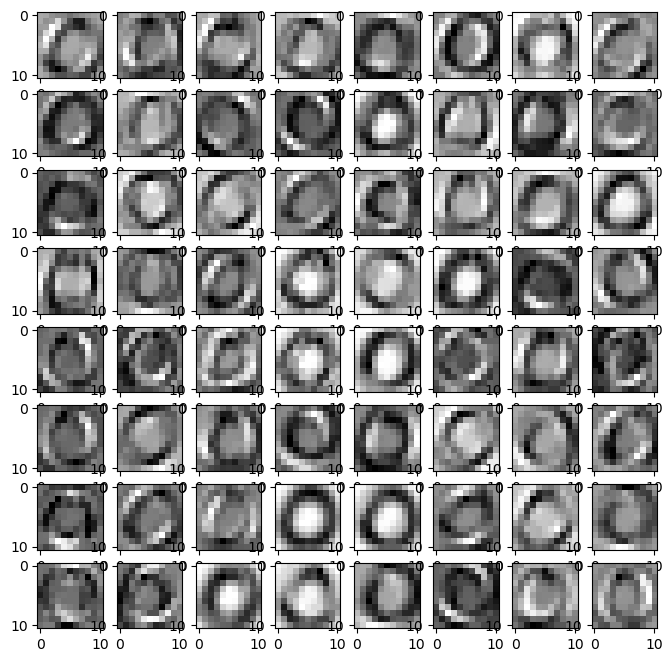

Feature maps of Activation layer 2


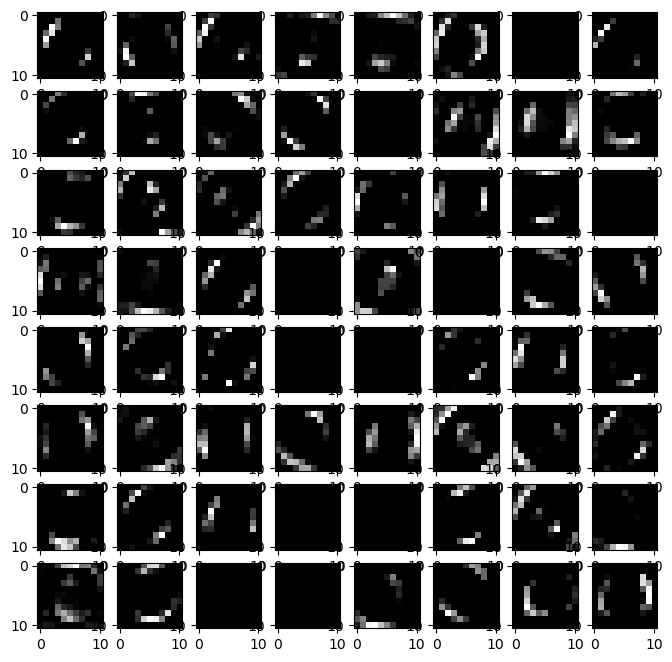

Feature maps of Pooling layer 2


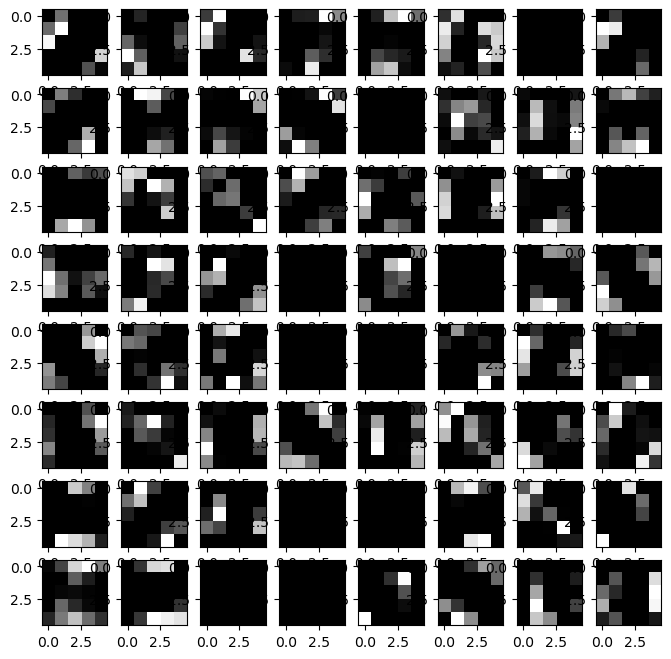

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


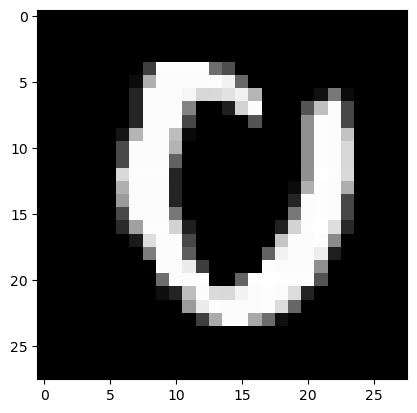

Feature maps of Convo layer 1


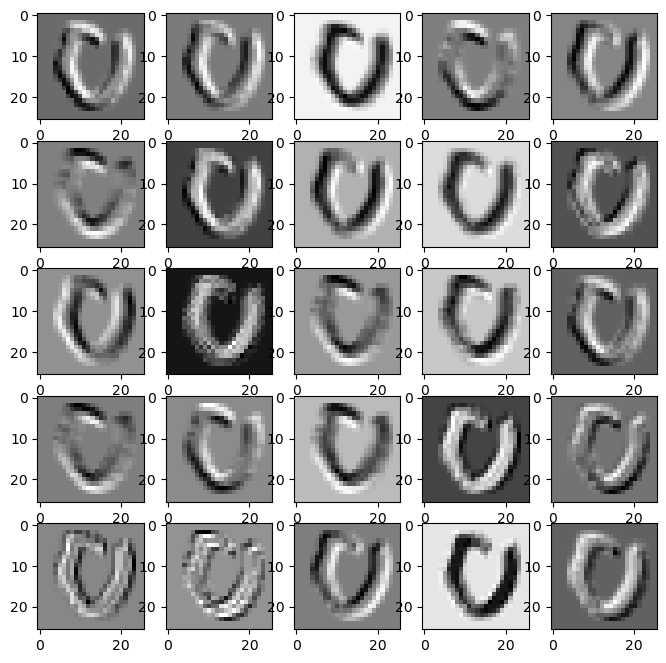

Feature maps of Activation layer 1


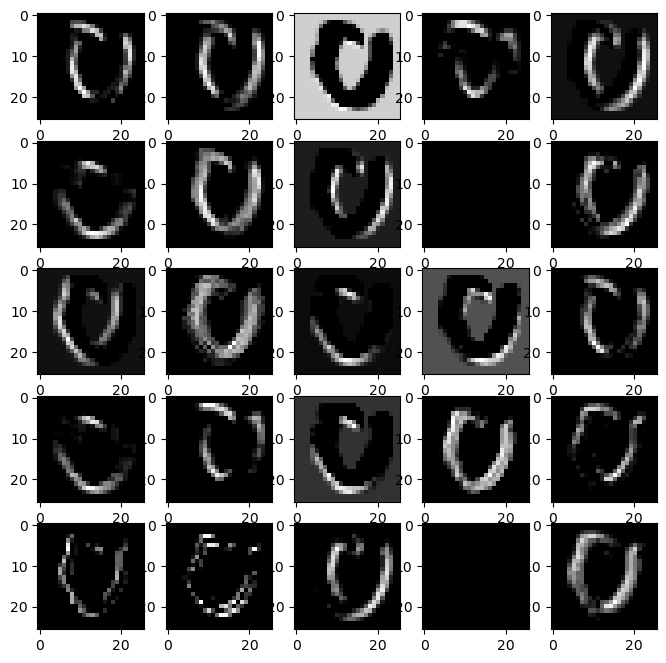

Feature maps of Pooling layer 1


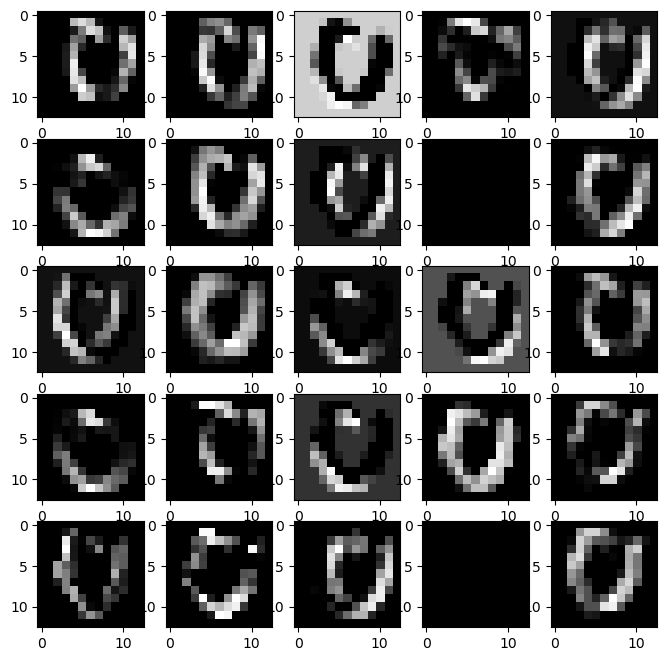

Feature maps of Convo layer 2


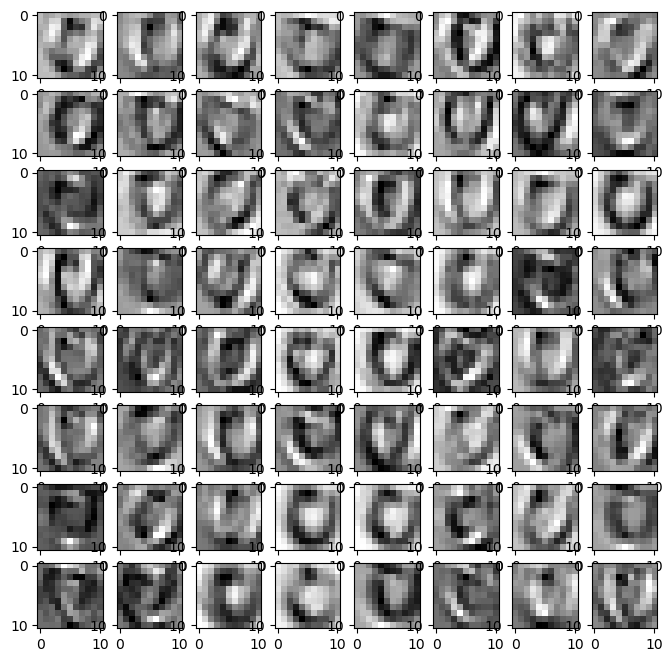

Feature maps of Activation layer 2


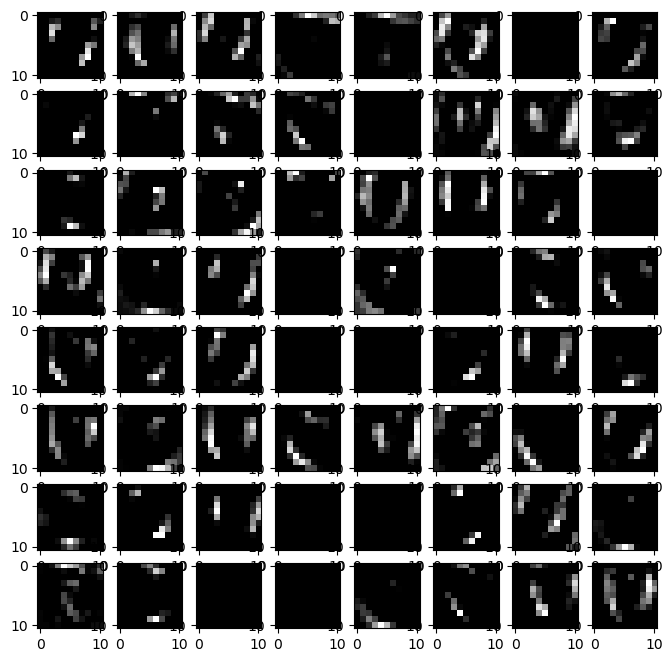

Feature maps of Pooling layer 2


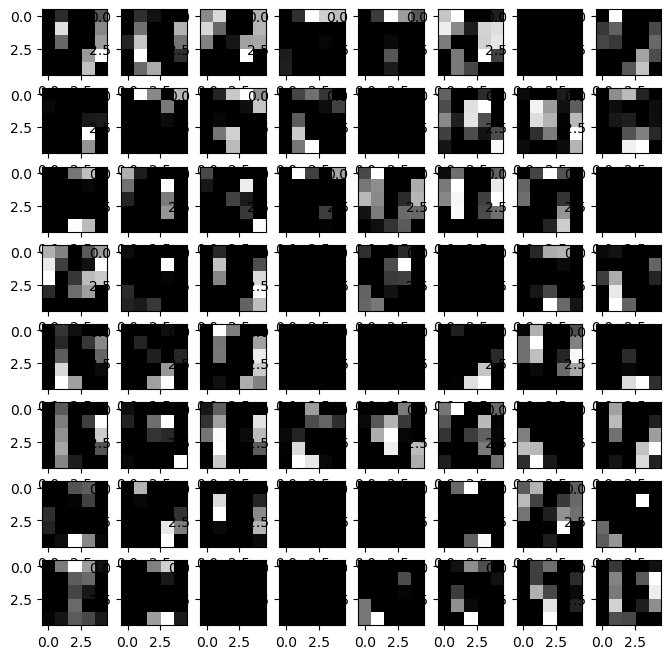

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


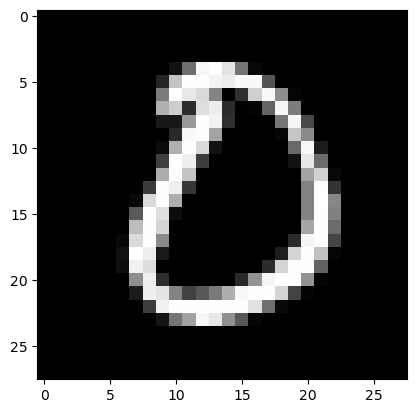

Feature maps of Convo layer 1


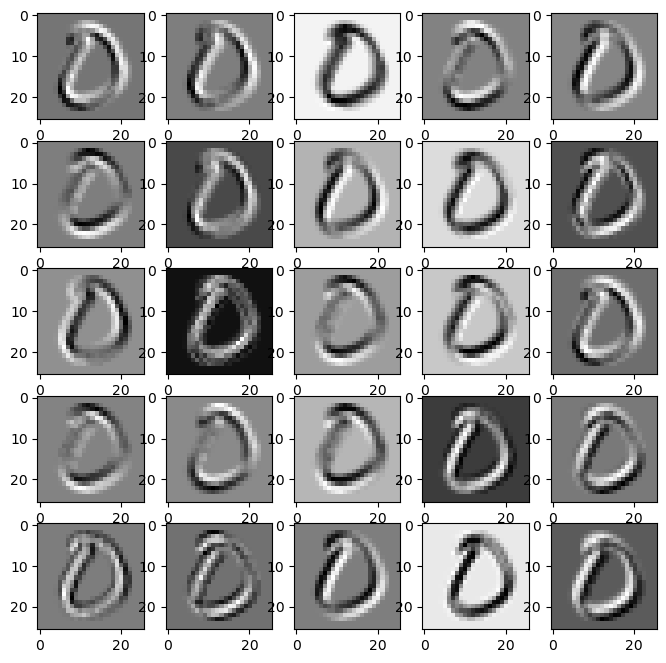

Feature maps of Activation layer 1


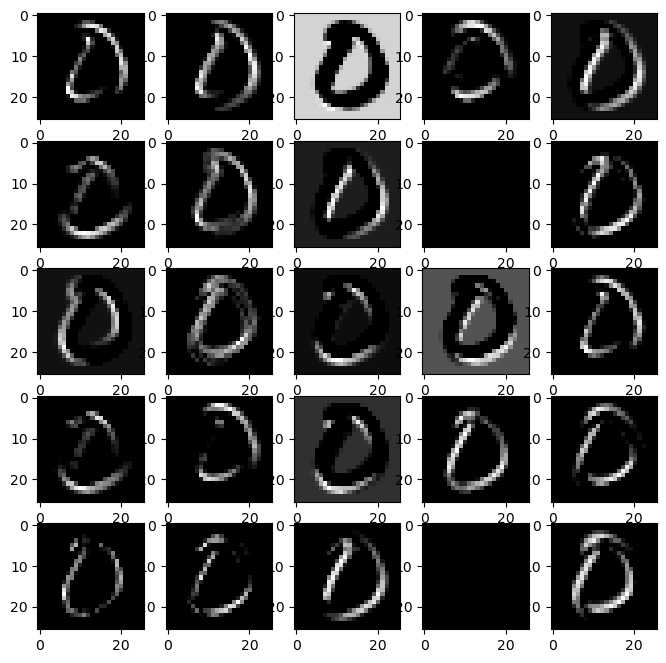

Feature maps of Pooling layer 1


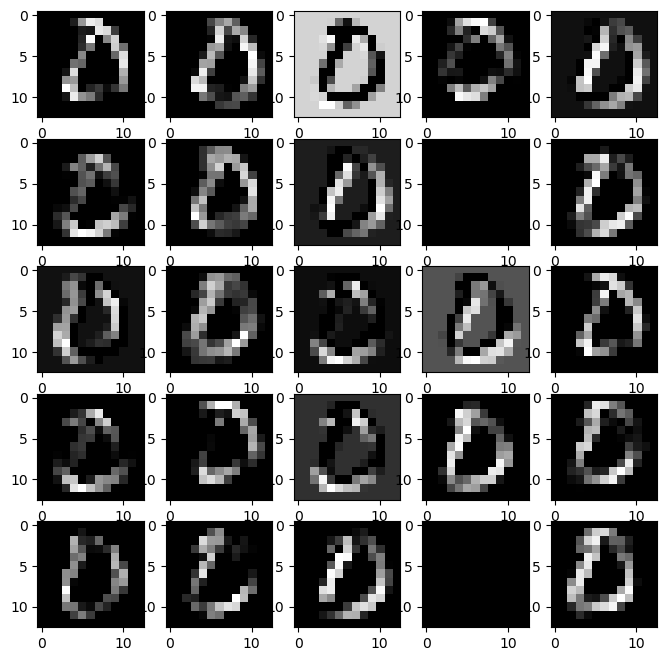

Feature maps of Convo layer 2


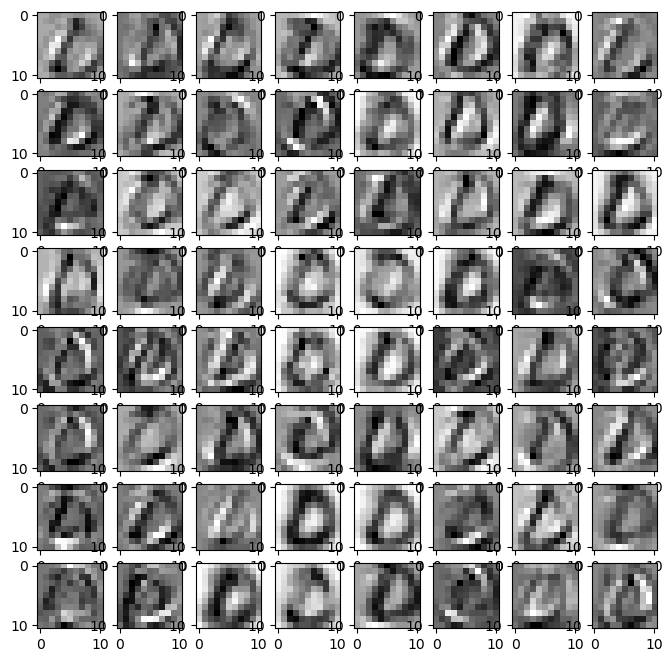

Feature maps of Activation layer 2


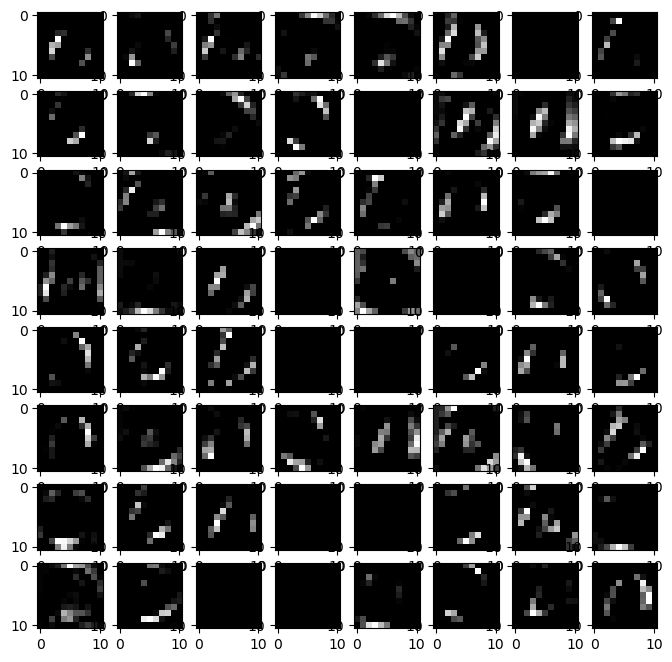

Feature maps of Pooling layer 2


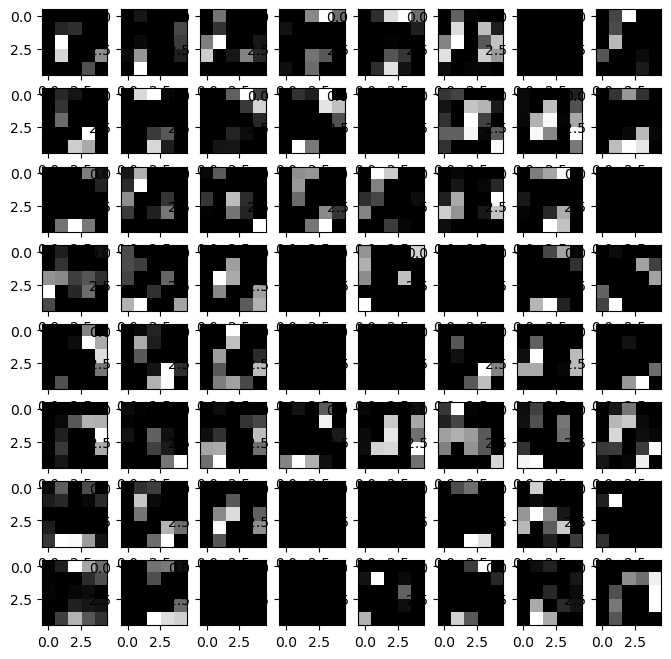

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


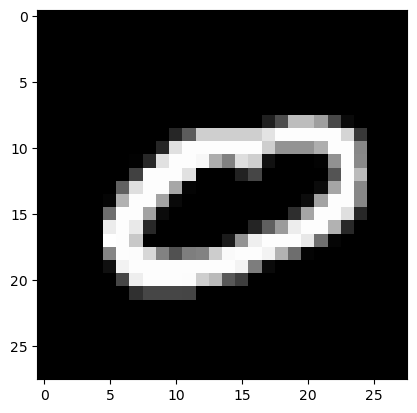

Feature maps of Convo layer 1


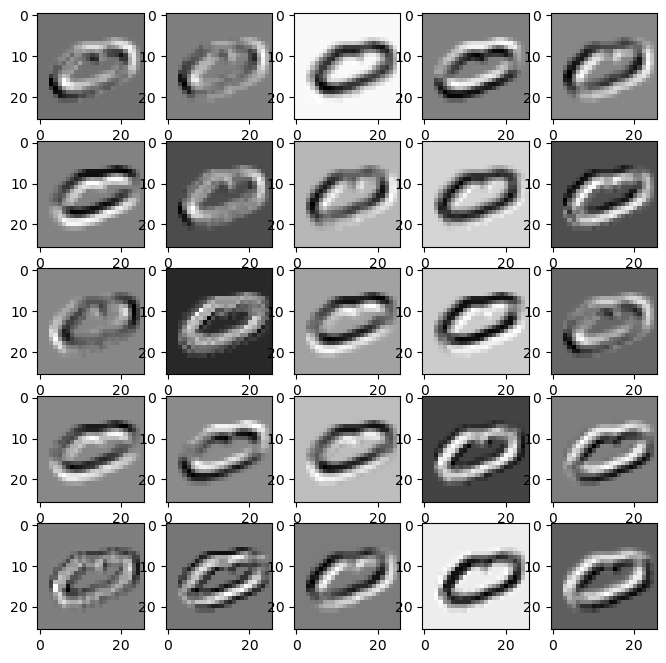

Feature maps of Activation layer 1


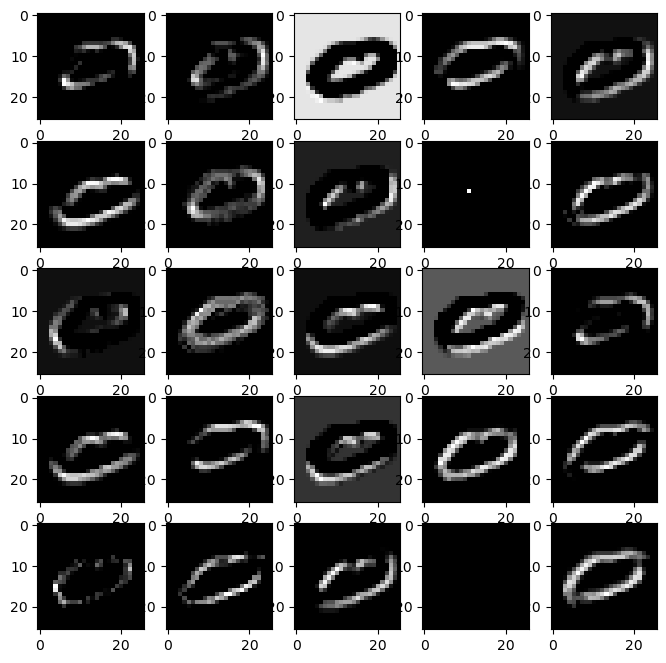

Feature maps of Pooling layer 1


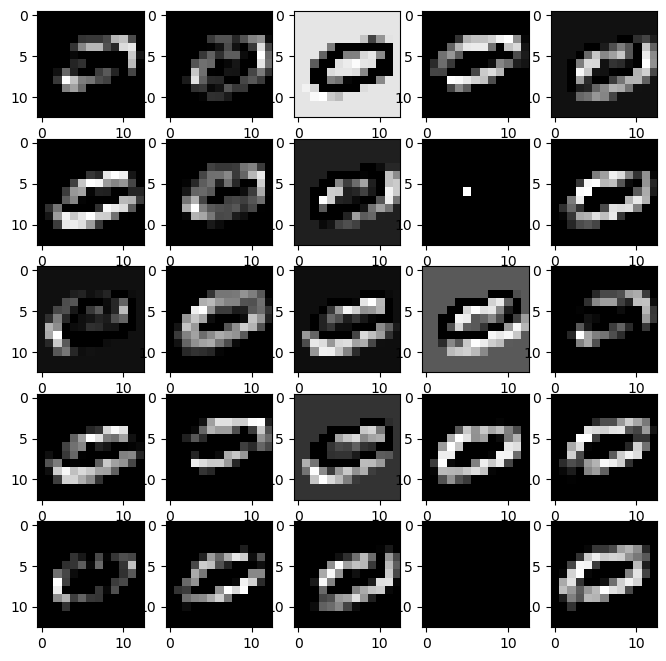

Feature maps of Convo layer 2


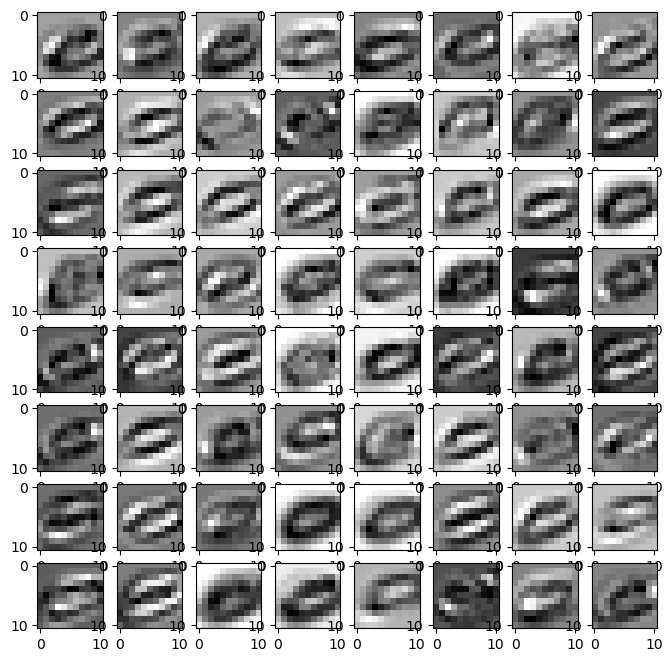

Feature maps of Activation layer 2


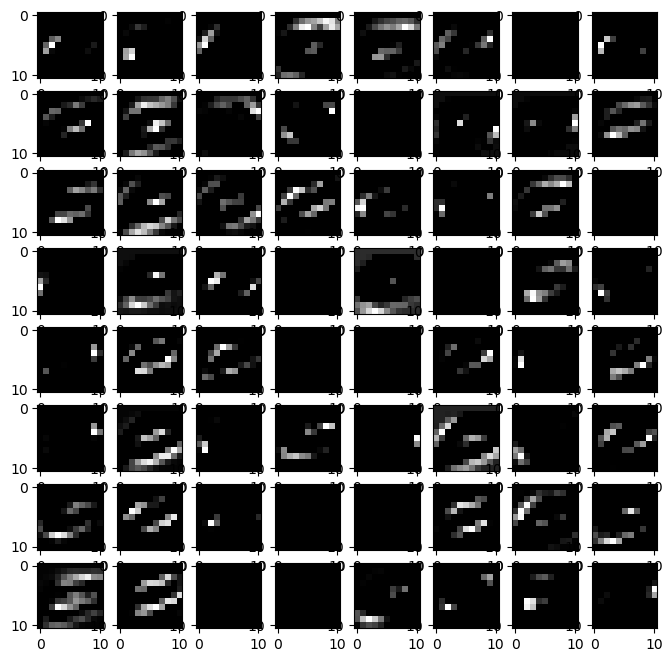

Feature maps of Pooling layer 2


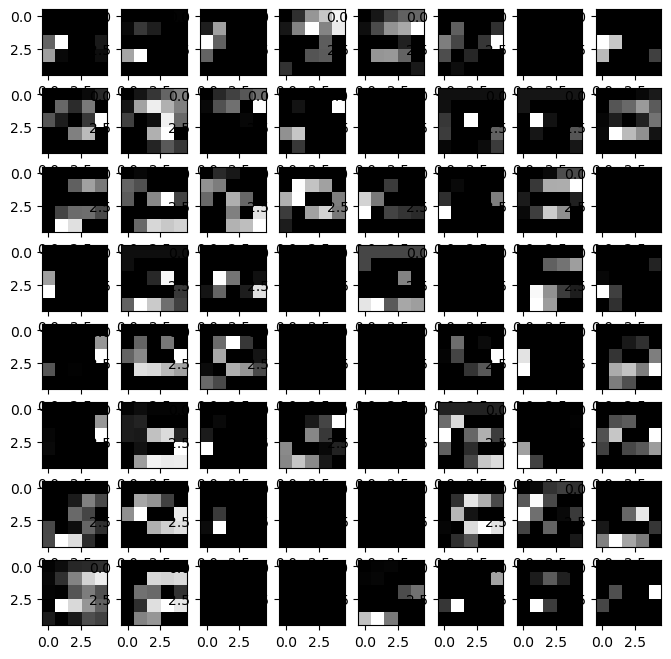

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


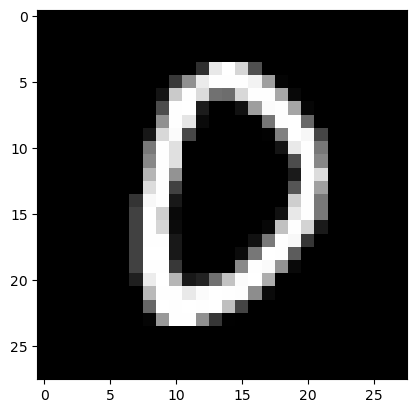

Feature maps of Convo layer 1


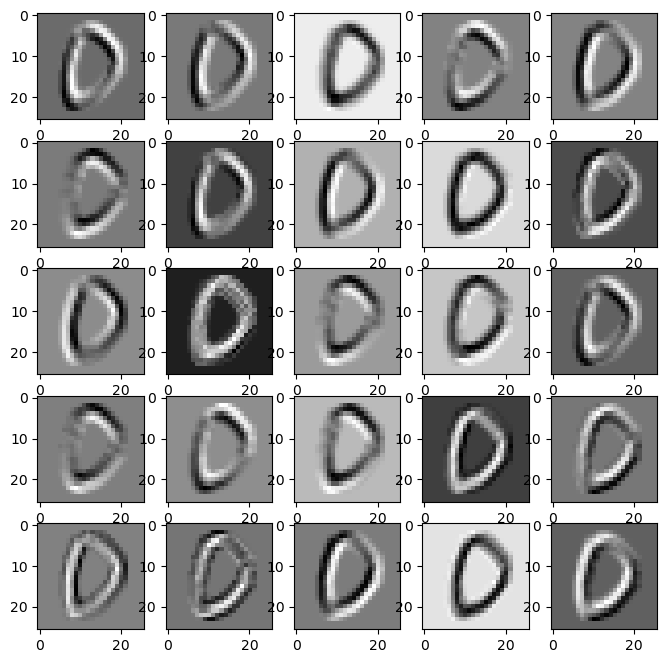

Feature maps of Activation layer 1


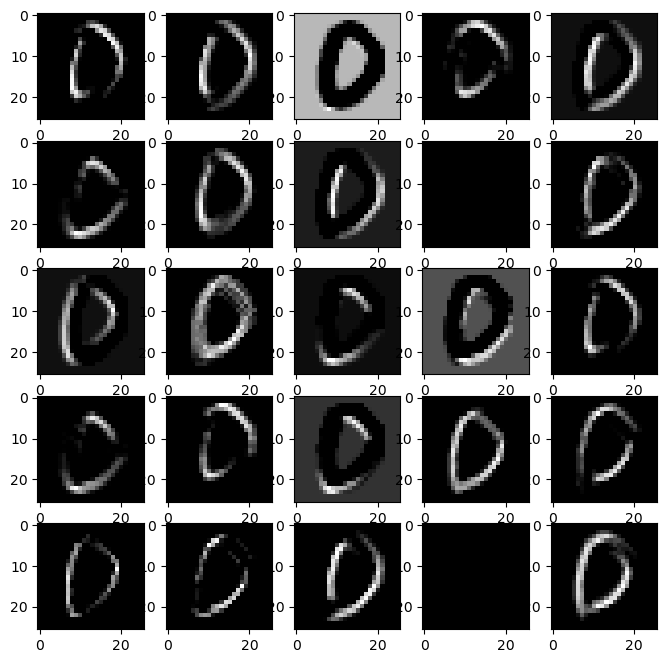

Feature maps of Pooling layer 1


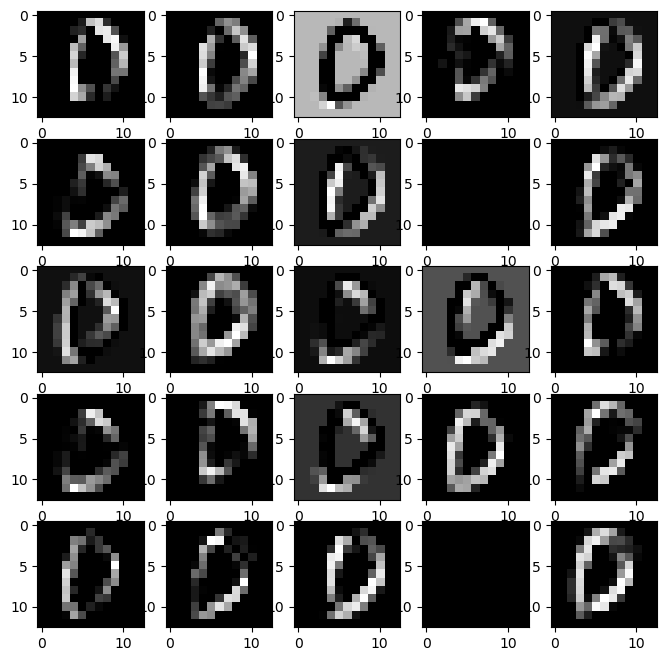

Feature maps of Convo layer 2


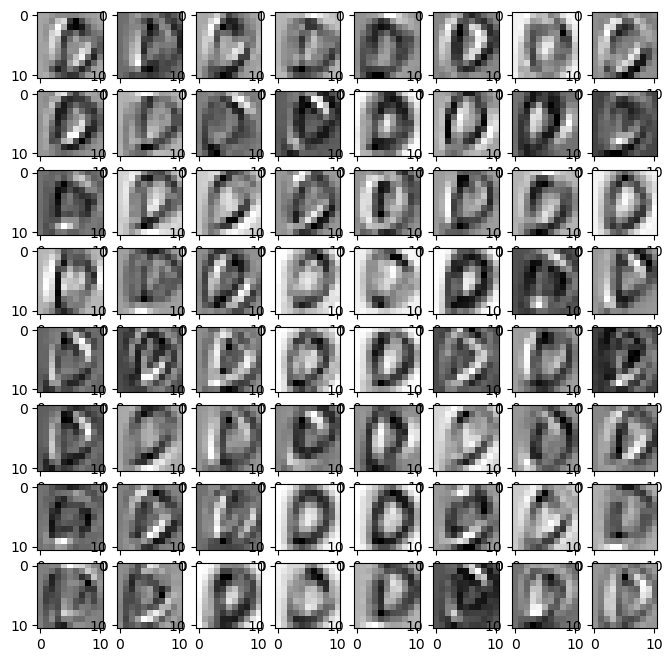

Feature maps of Activation layer 2


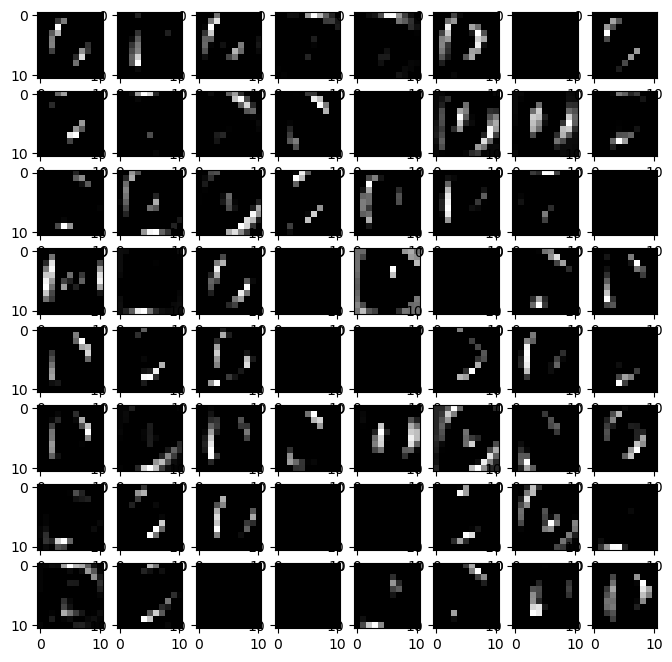

Feature maps of Pooling layer 2


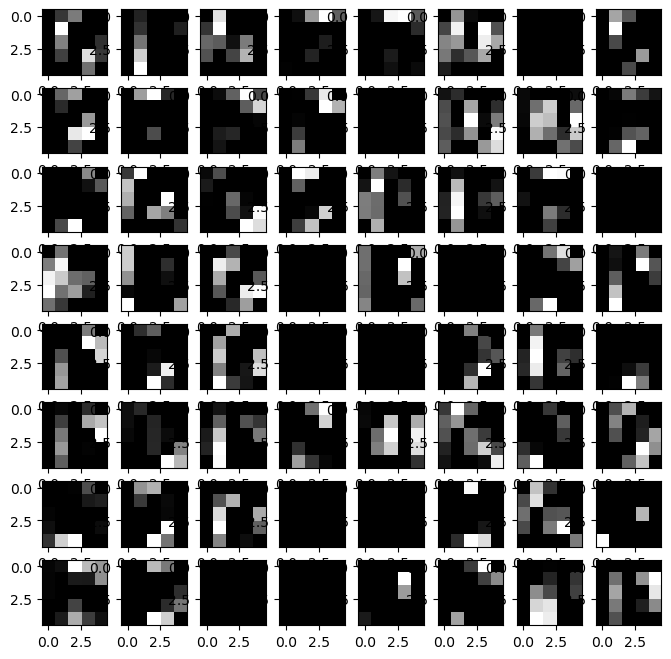

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


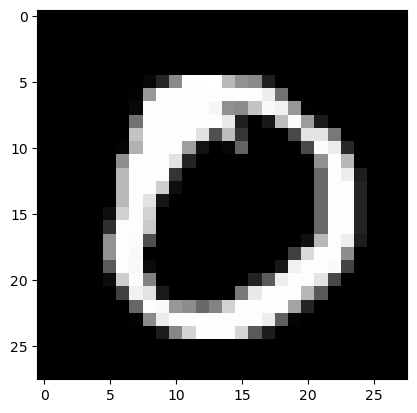

Feature maps of Convo layer 1


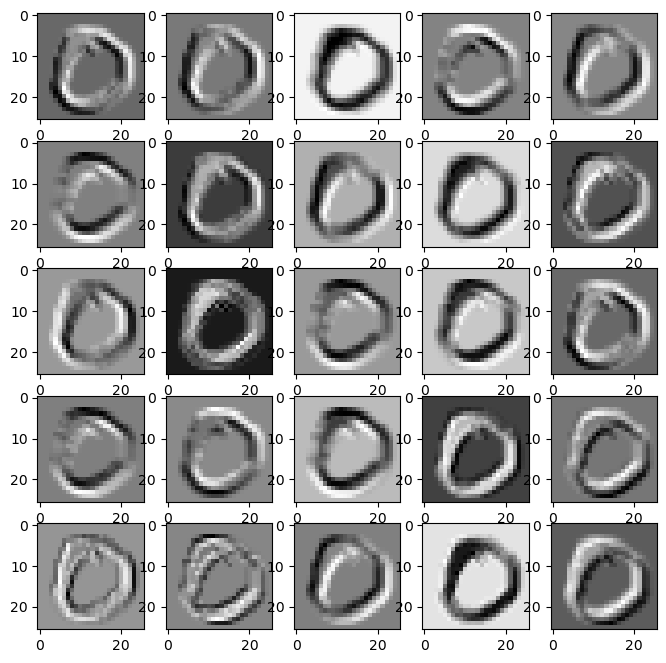

Feature maps of Activation layer 1


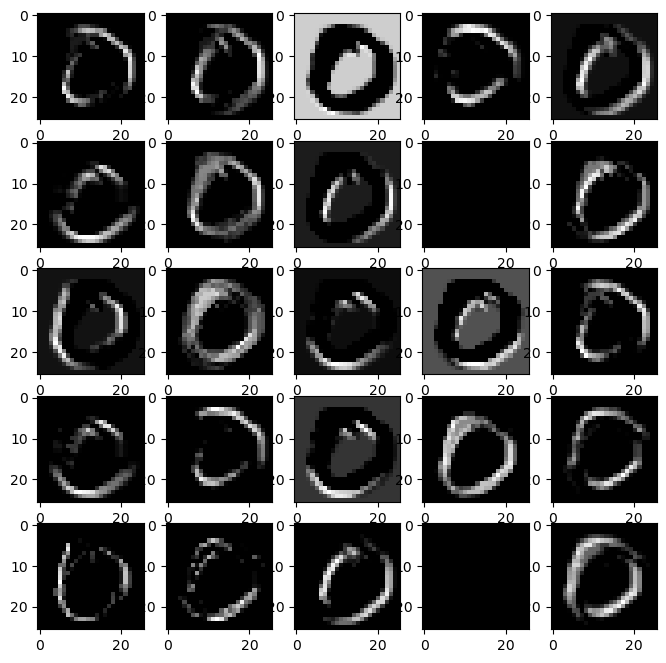

Feature maps of Pooling layer 1


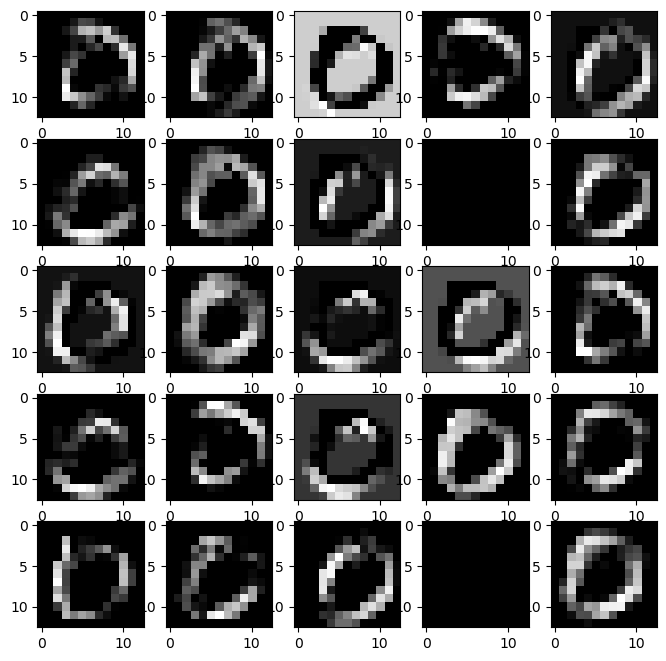

Feature maps of Convo layer 2


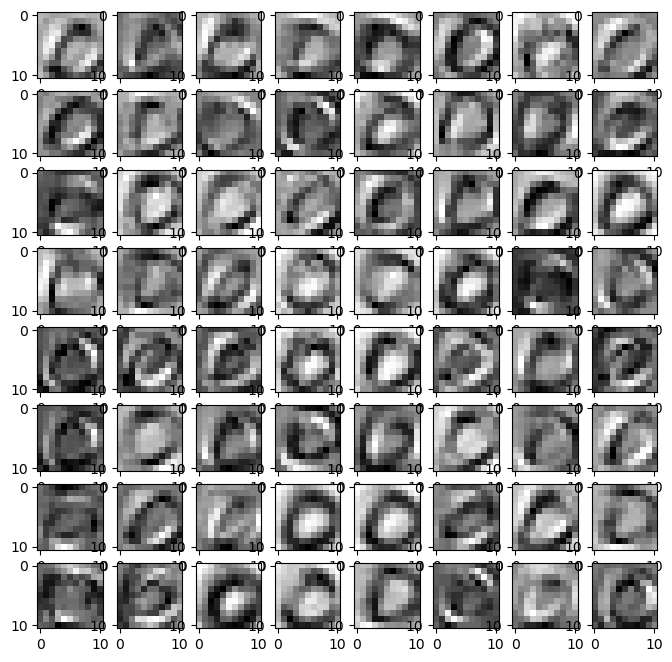

Feature maps of Activation layer 2


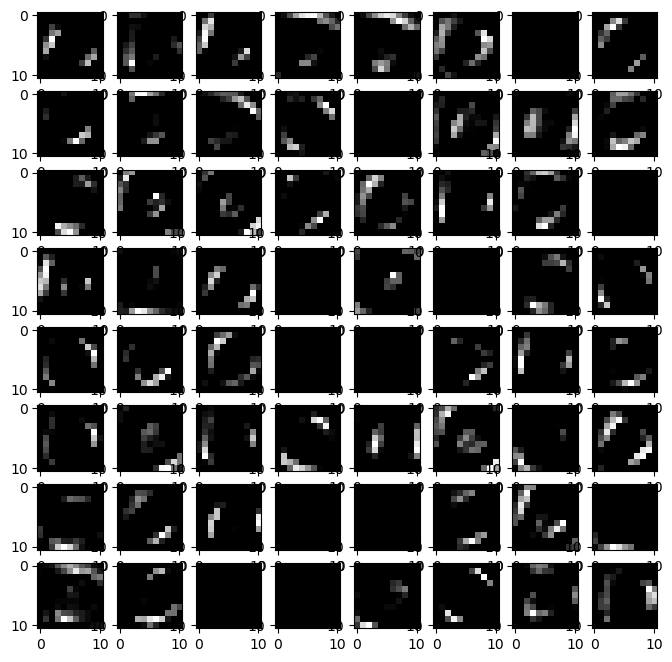

Feature maps of Pooling layer 2


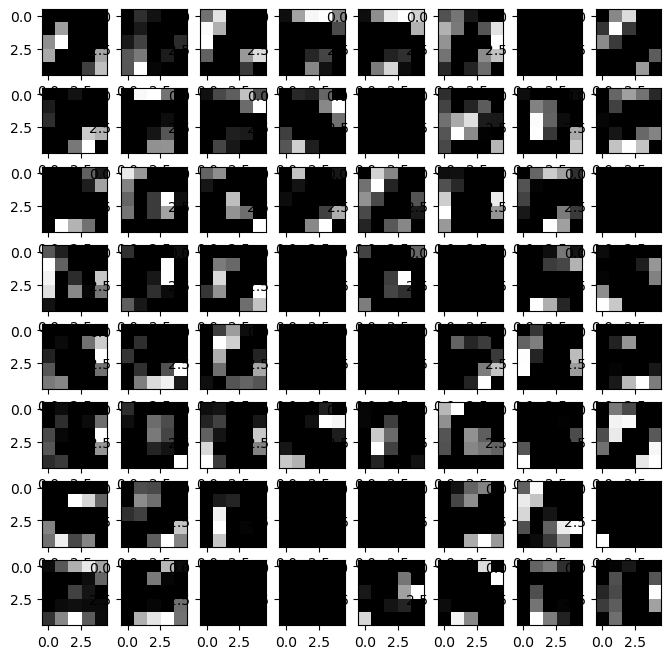

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


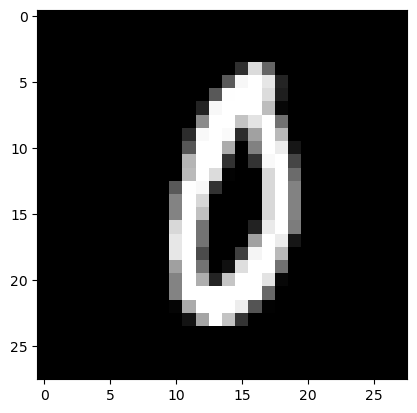

Feature maps of Convo layer 1


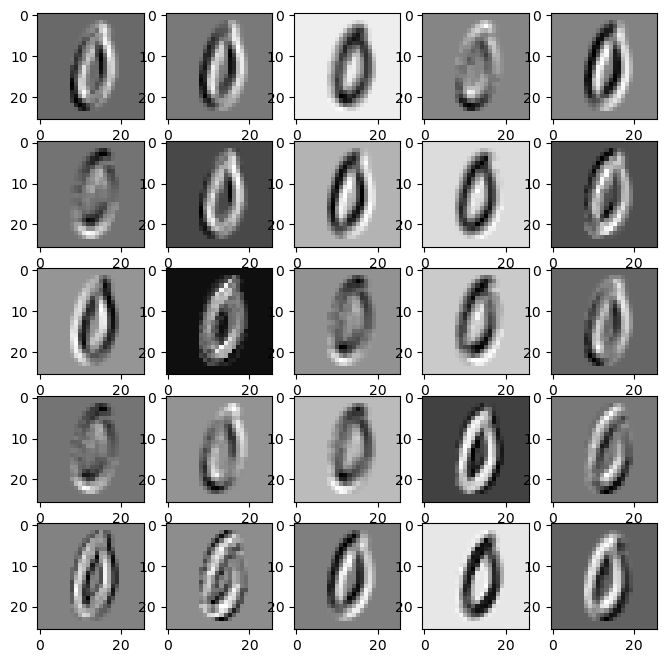

Feature maps of Activation layer 1


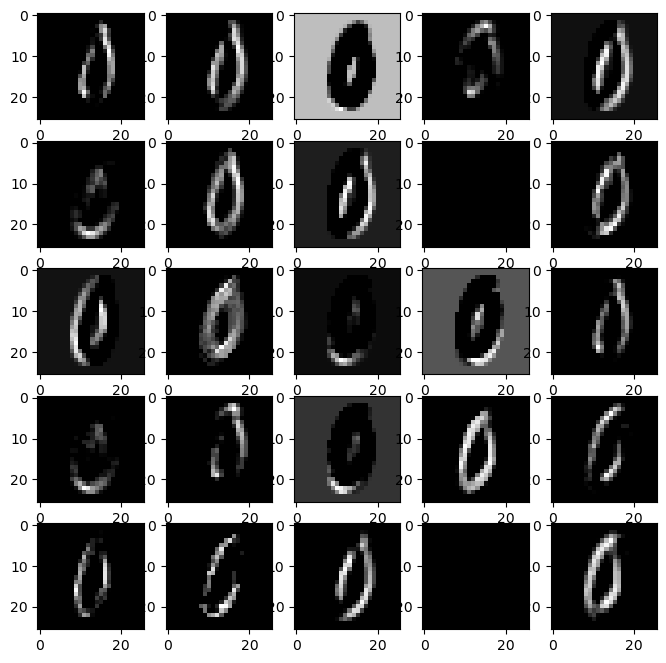

Feature maps of Pooling layer 1


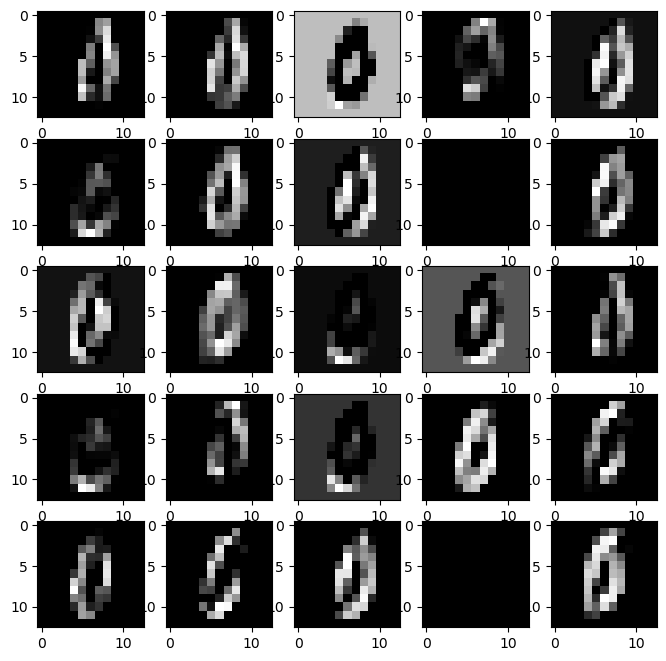

Feature maps of Convo layer 2


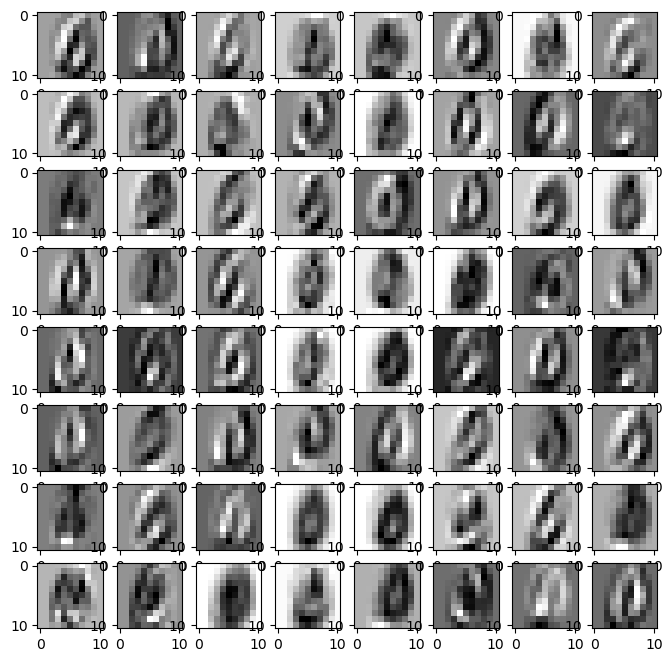

Feature maps of Activation layer 2


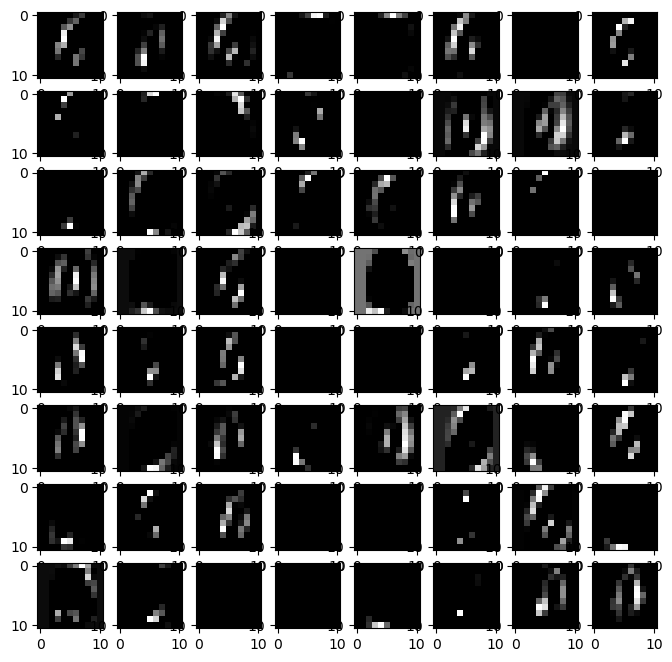

Feature maps of Pooling layer 2


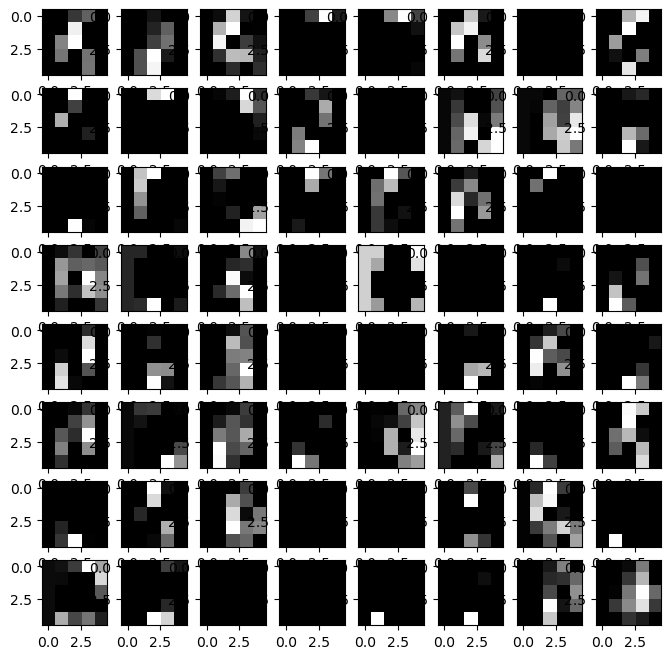

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Orig

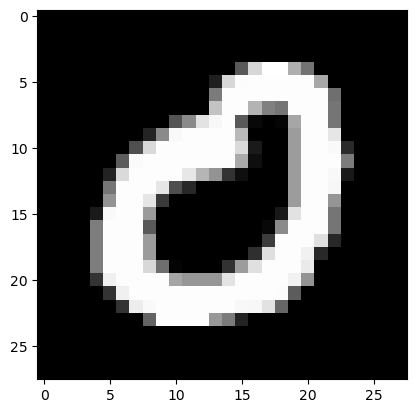

Feature maps of Convo layer 1


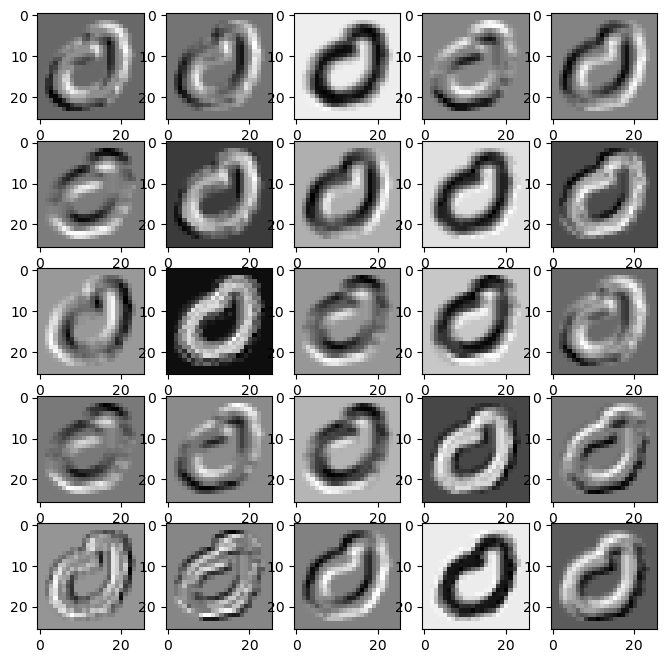

Feature maps of Activation layer 1


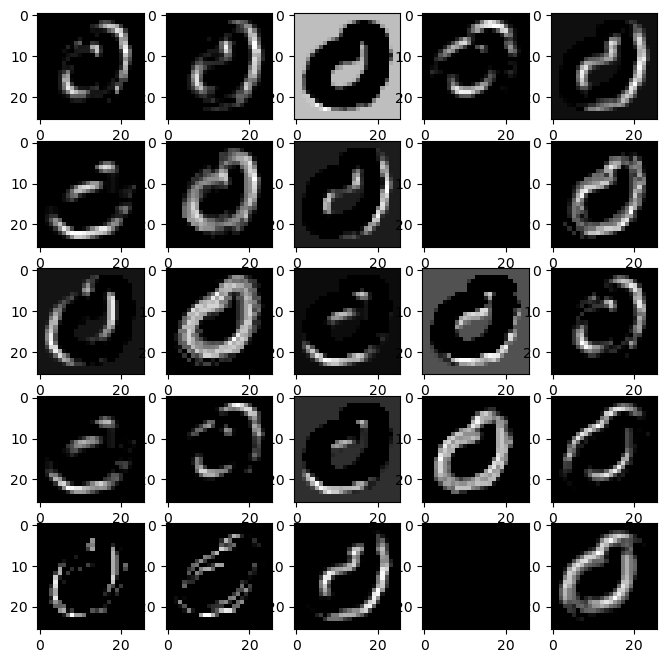

Feature maps of Pooling layer 1


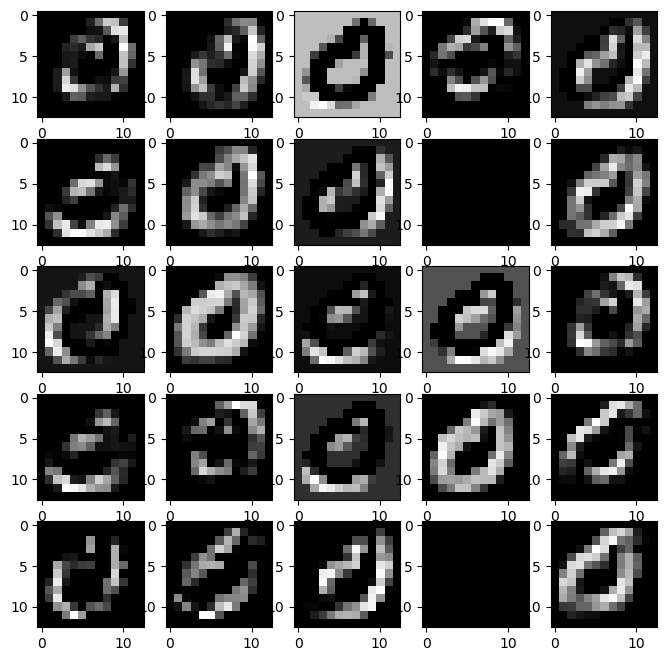

Feature maps of Convo layer 2


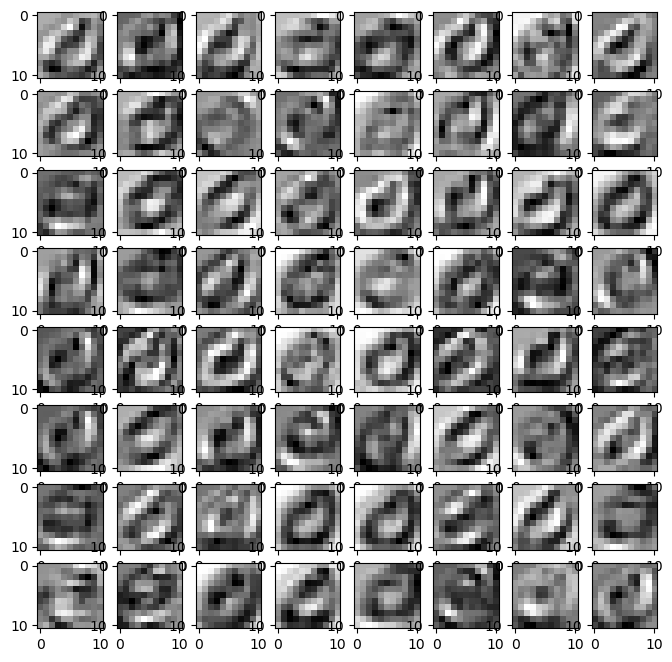

Feature maps of Activation layer 2


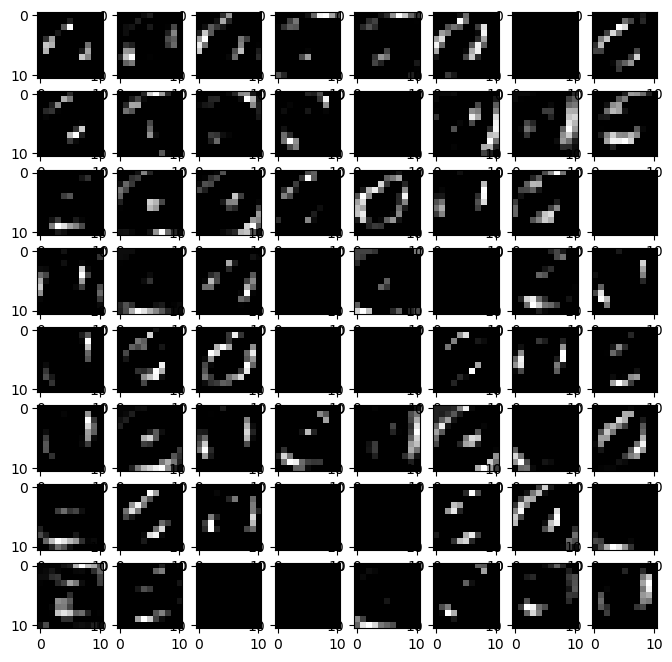

Feature maps of Pooling layer 2


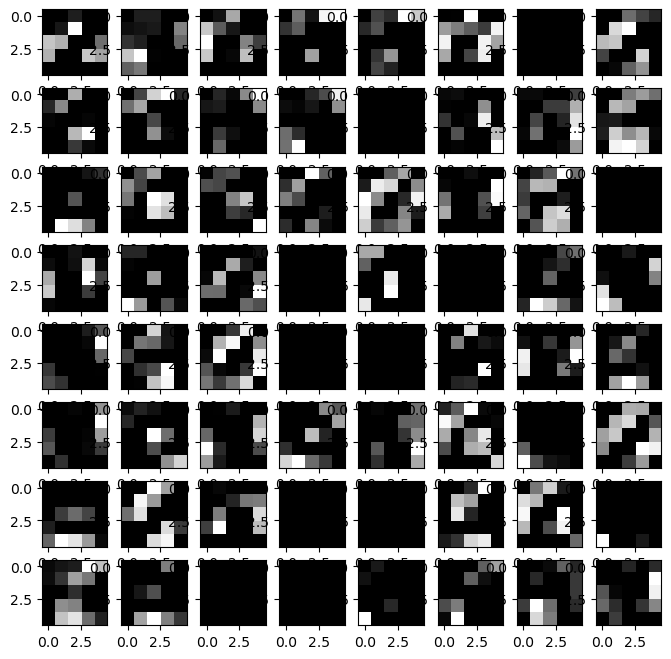

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


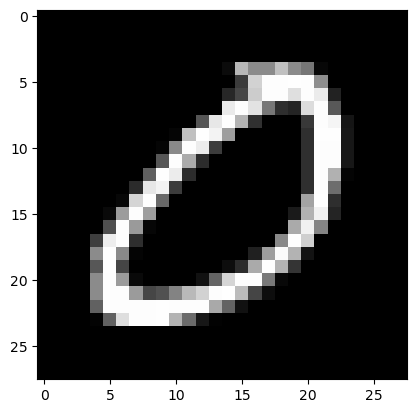

Feature maps of Convo layer 1


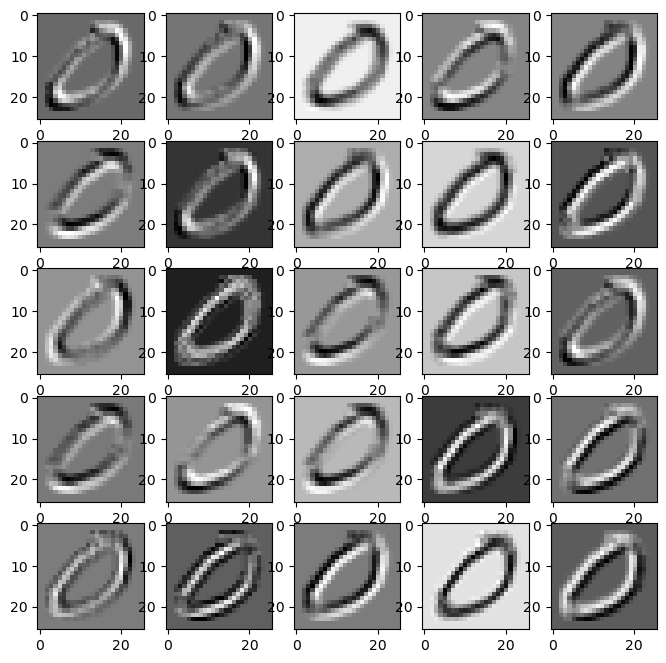

Feature maps of Activation layer 1


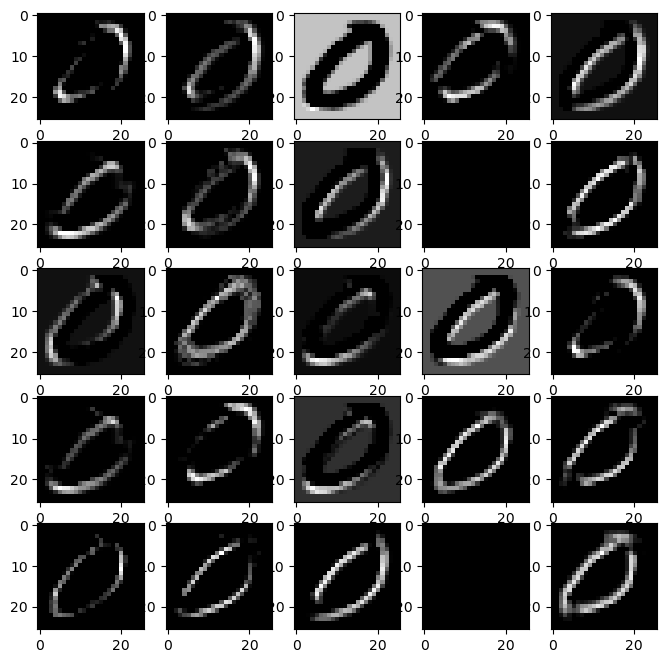

Feature maps of Pooling layer 1


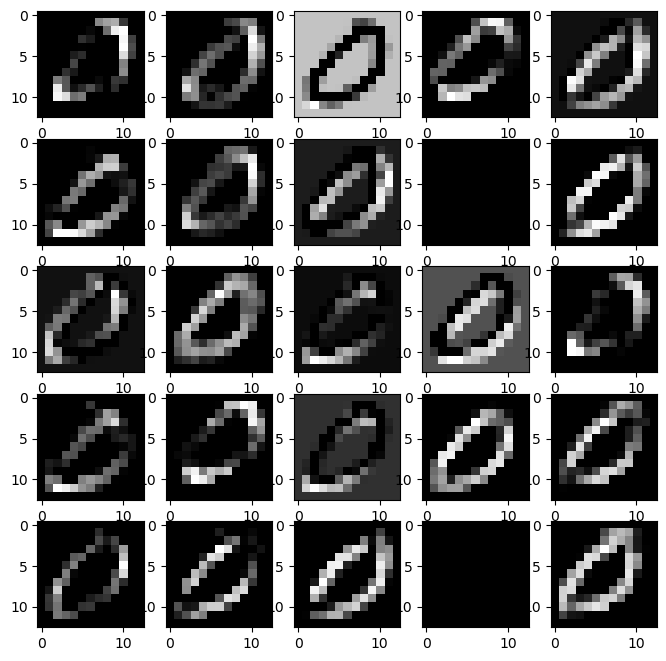

Feature maps of Convo layer 2


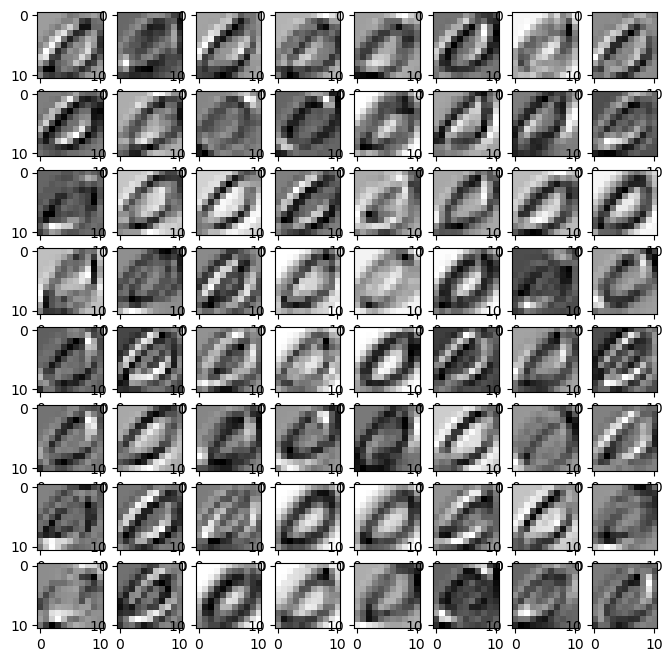

Feature maps of Activation layer 2


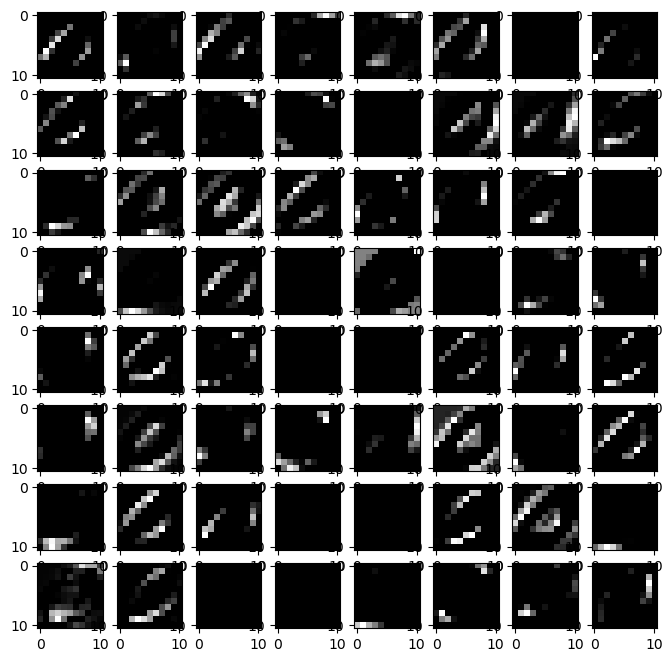

Feature maps of Pooling layer 2


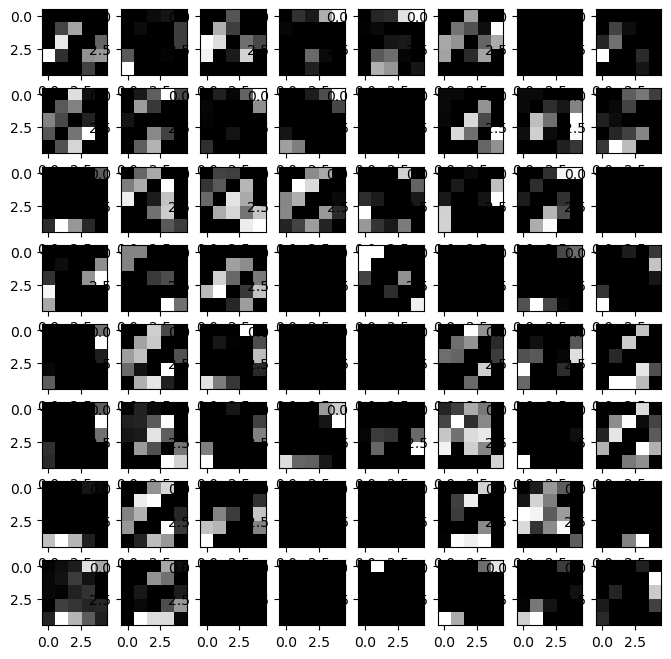

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


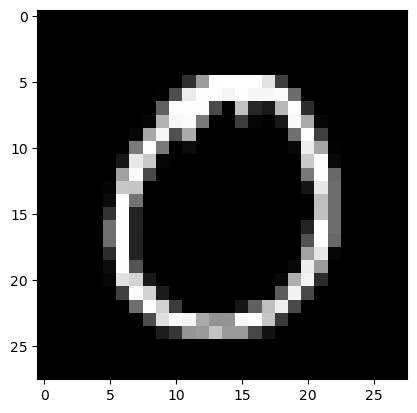

Feature maps of Convo layer 1


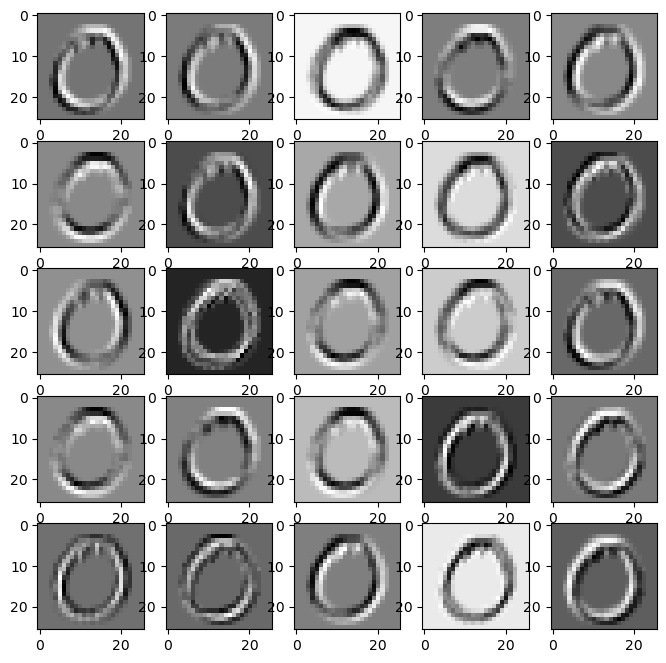

Feature maps of Activation layer 1


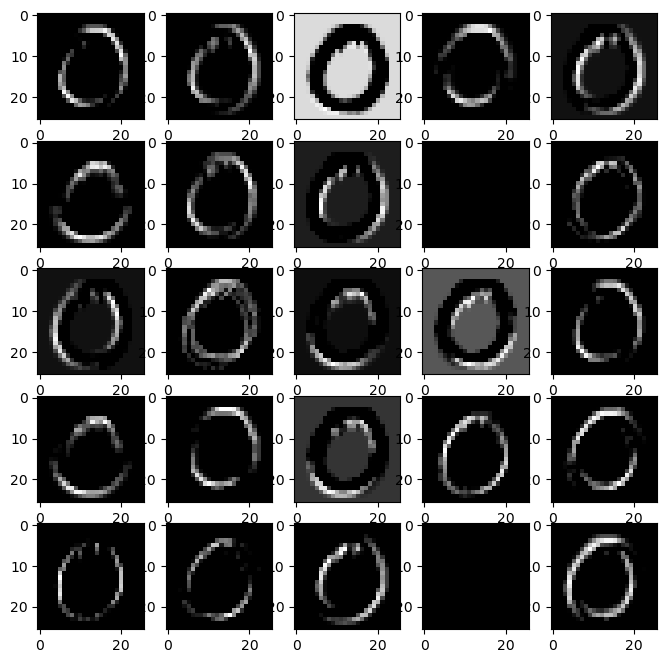

Feature maps of Pooling layer 1


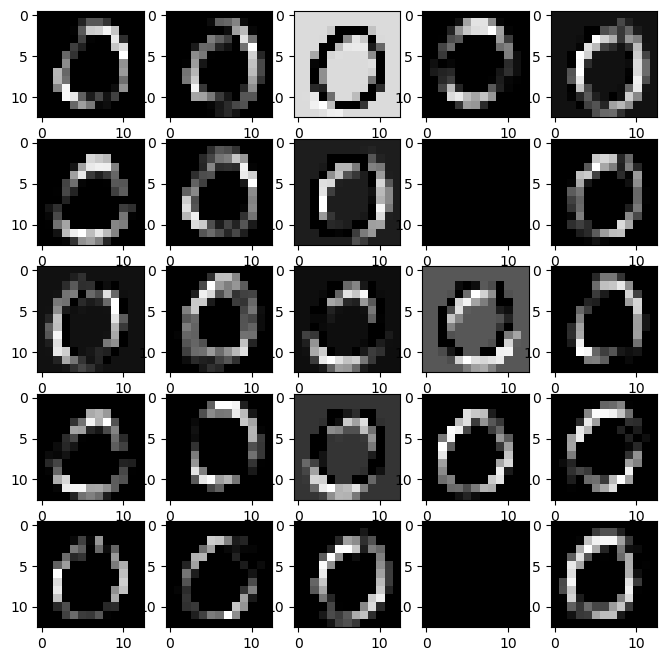

Feature maps of Convo layer 2


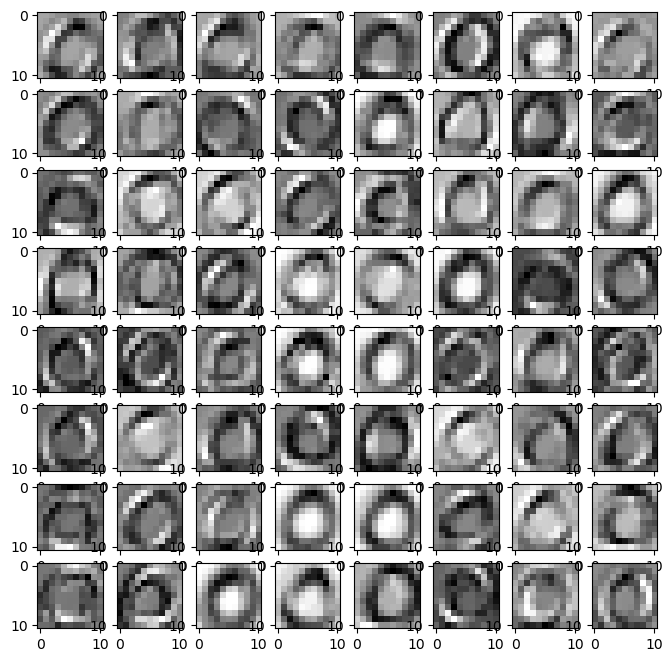

Feature maps of Activation layer 2


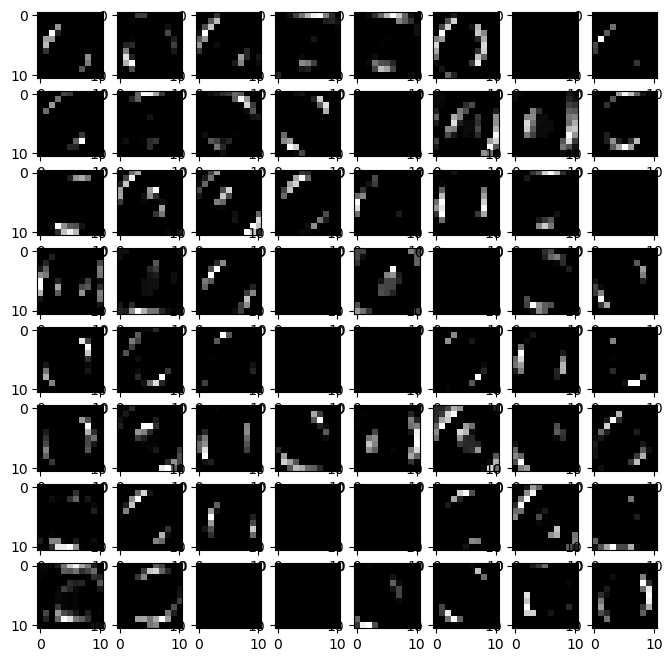

Feature maps of Pooling layer 2


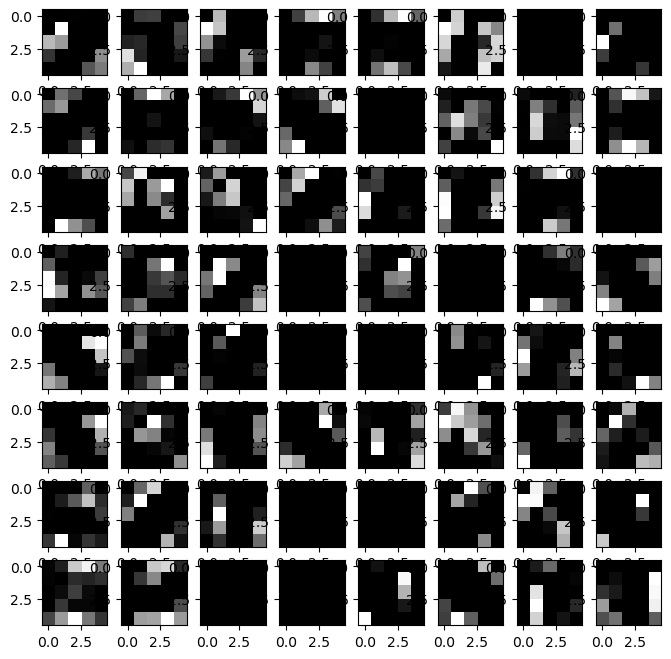

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


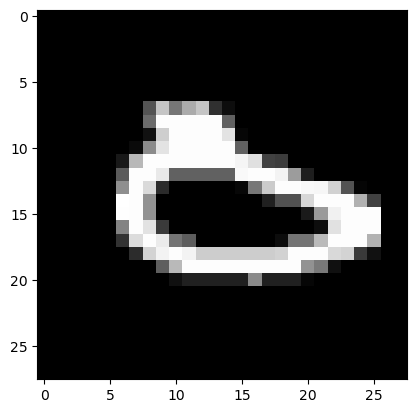

Feature maps of Convo layer 1


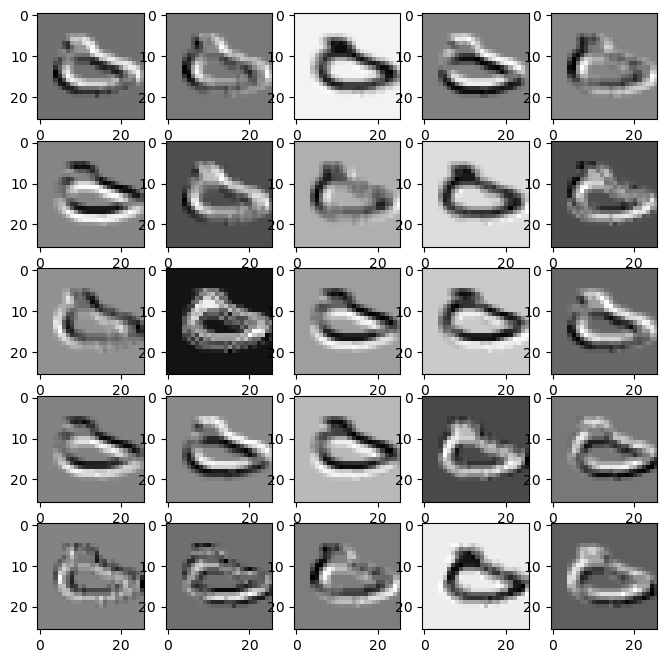

Feature maps of Activation layer 1


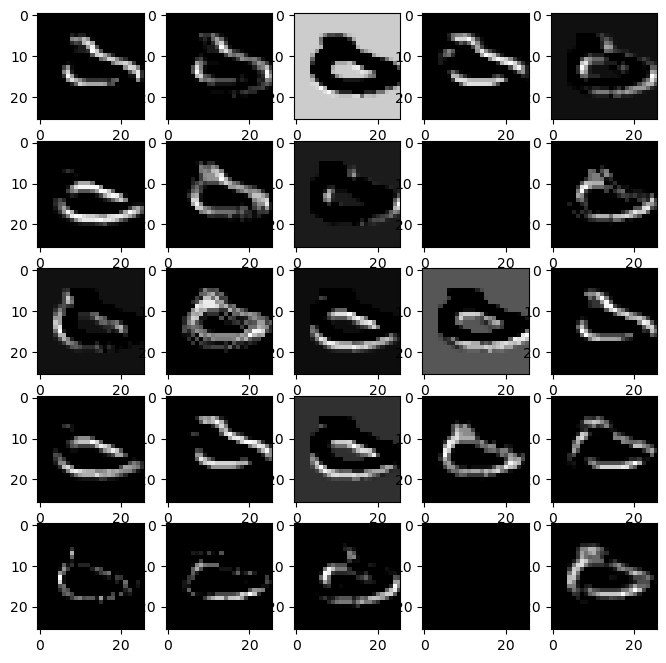

Feature maps of Pooling layer 1


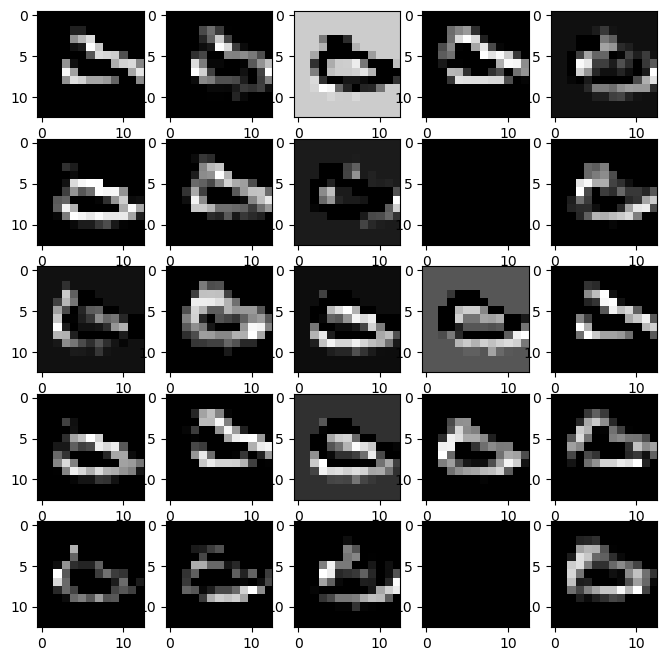

Feature maps of Convo layer 2


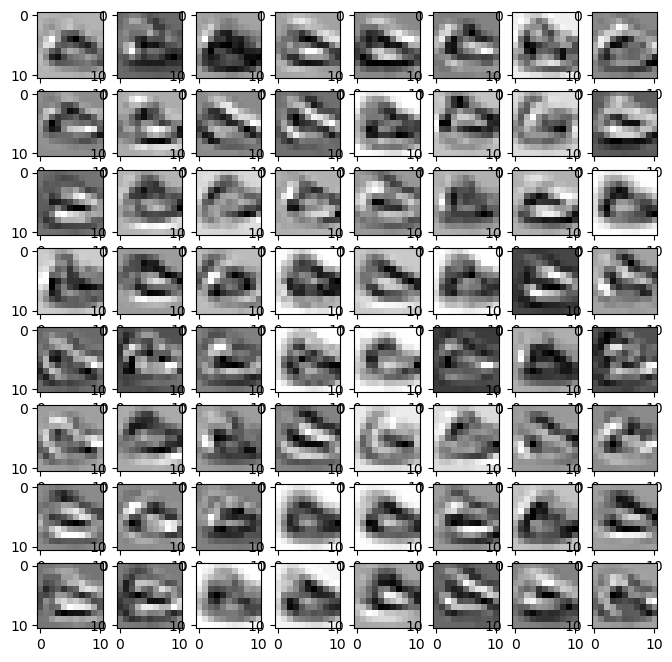

Feature maps of Activation layer 2


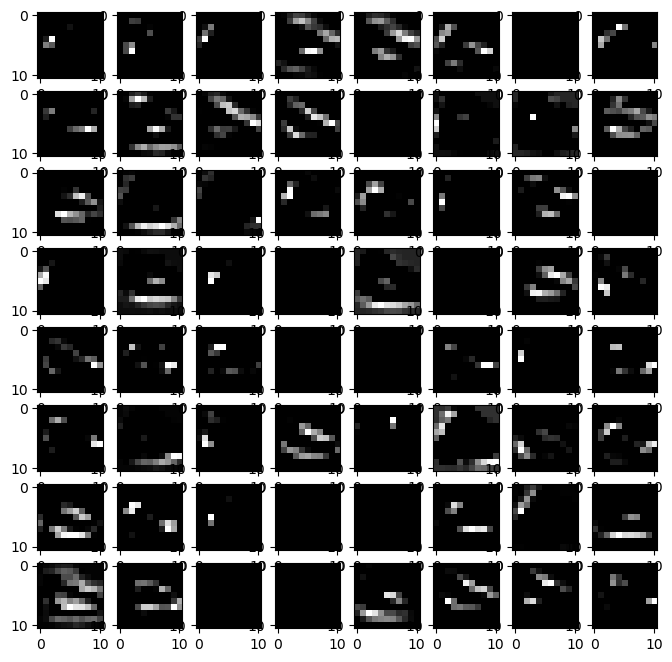

Feature maps of Pooling layer 2


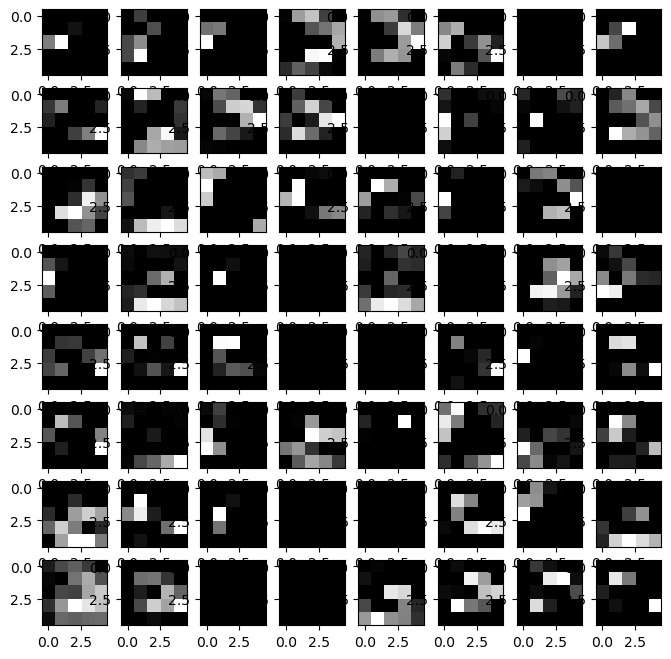

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


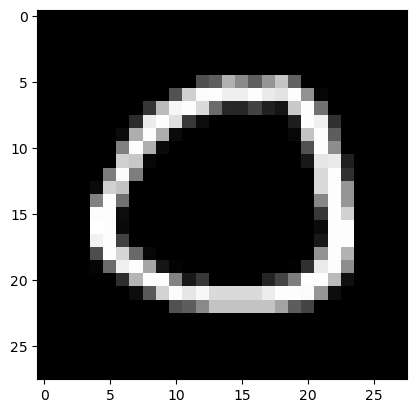

Feature maps of Convo layer 1


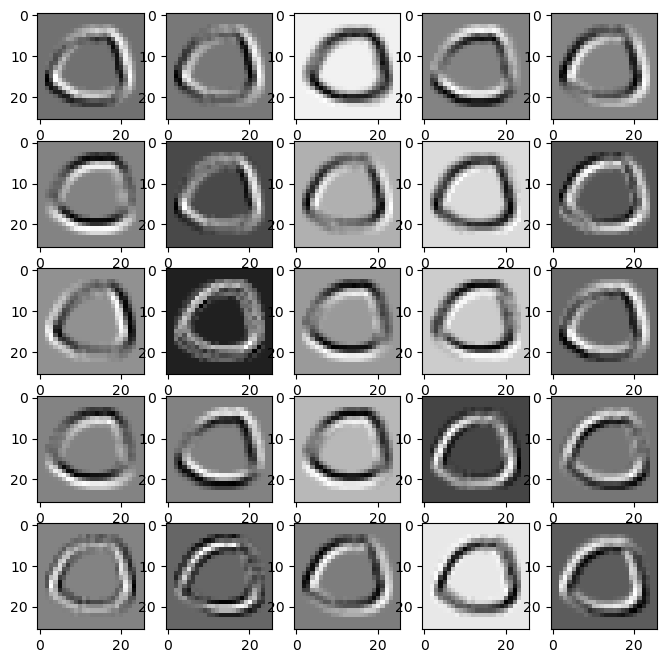

Feature maps of Activation layer 1


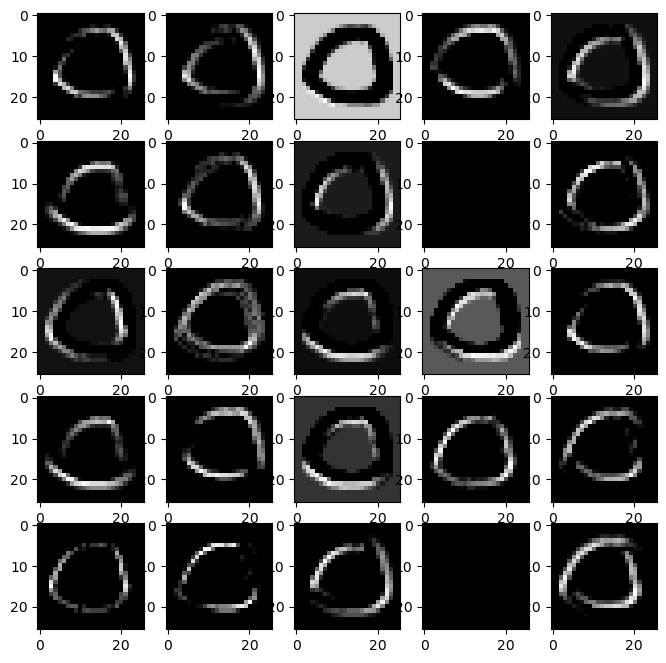

Feature maps of Pooling layer 1


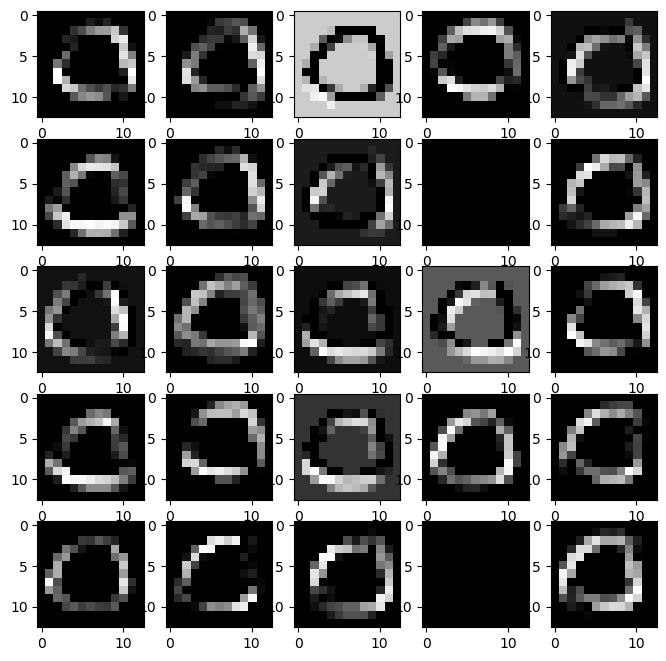

Feature maps of Convo layer 2


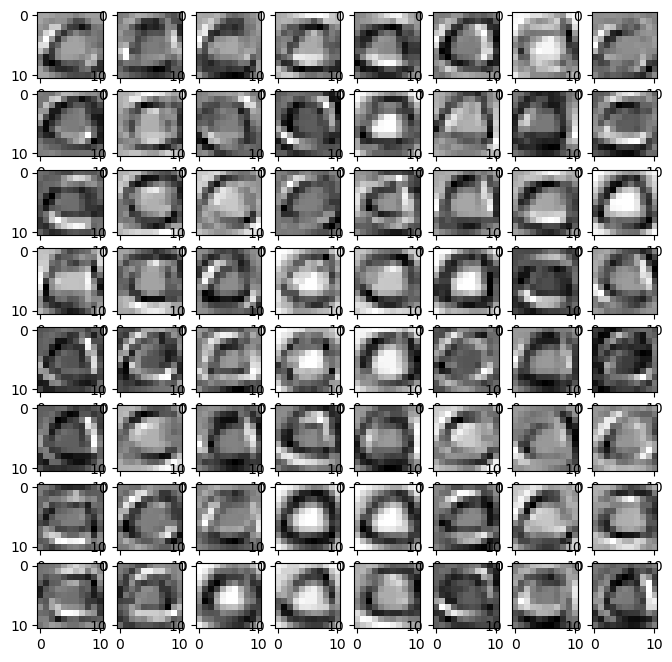

Feature maps of Activation layer 2


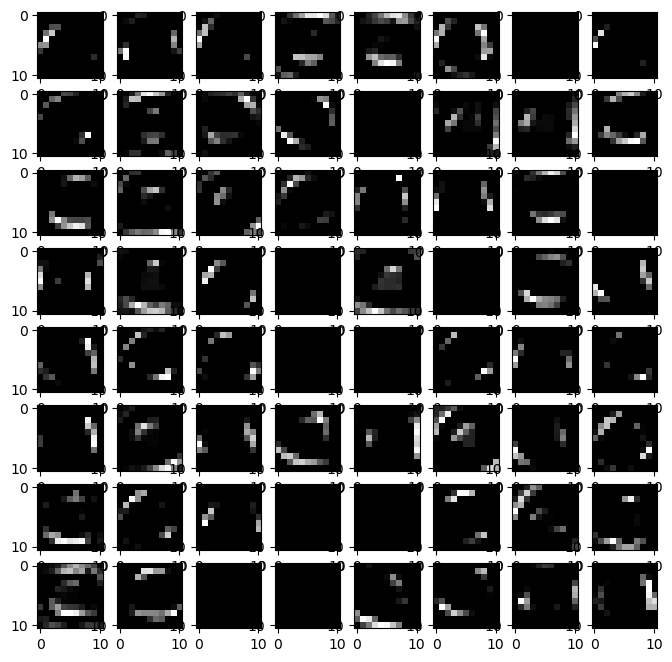

Feature maps of Pooling layer 2


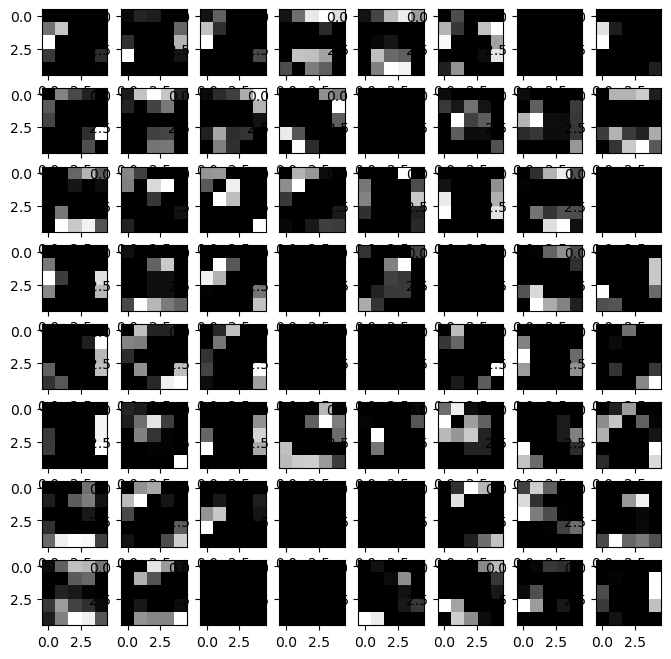

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


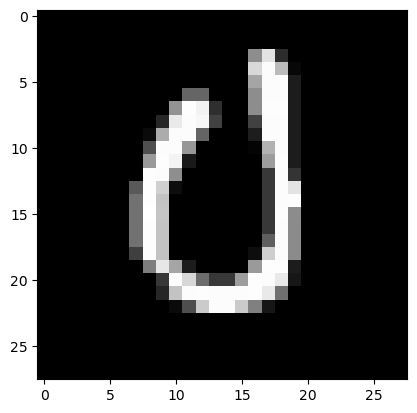

Feature maps of Convo layer 1


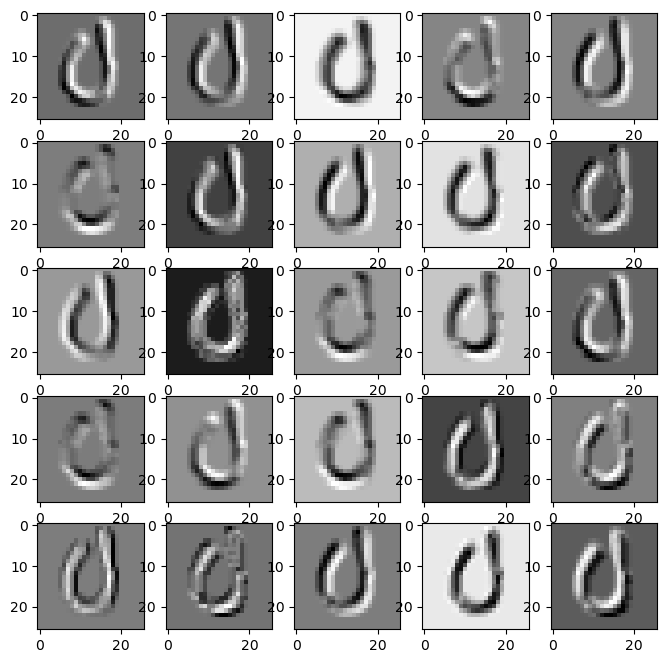

Feature maps of Activation layer 1


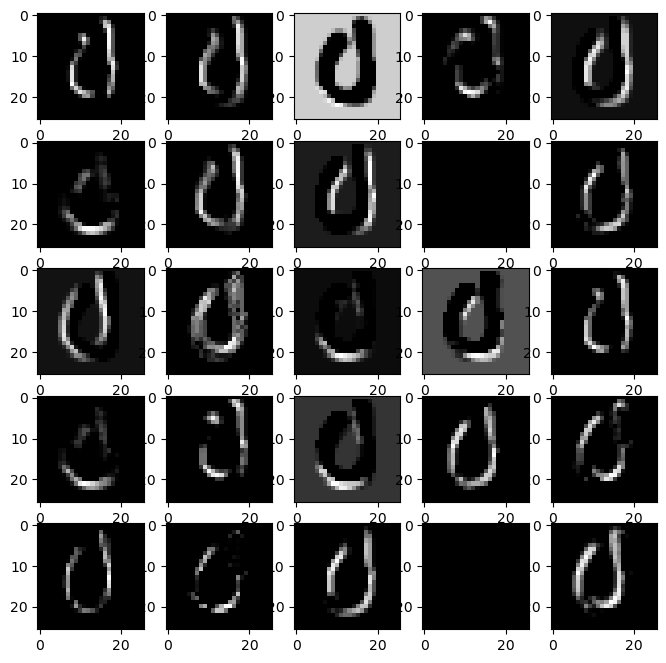

Feature maps of Pooling layer 1


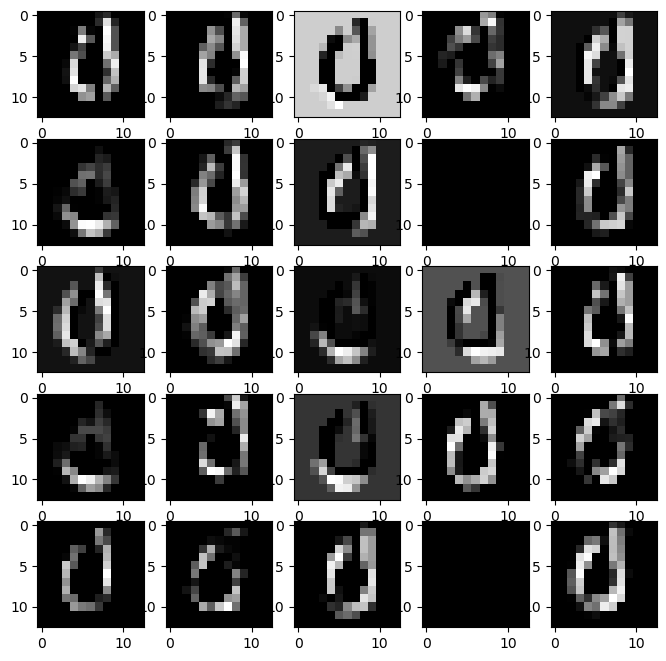

Feature maps of Convo layer 2


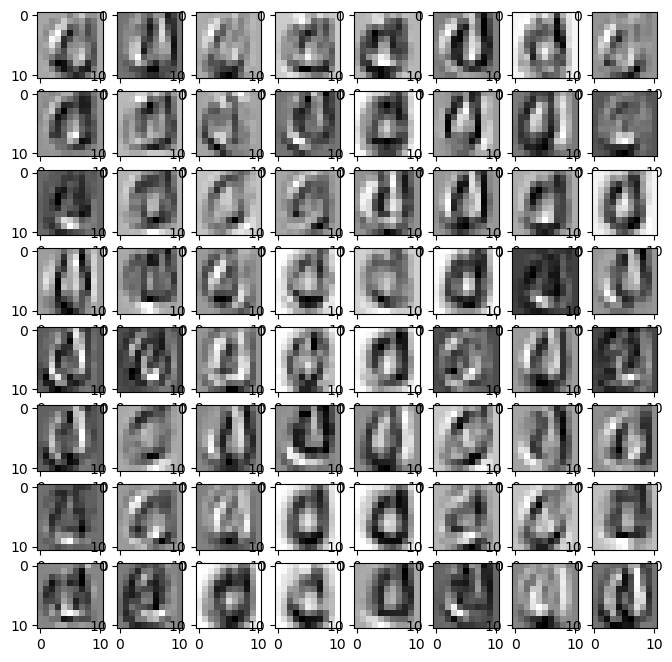

Feature maps of Activation layer 2


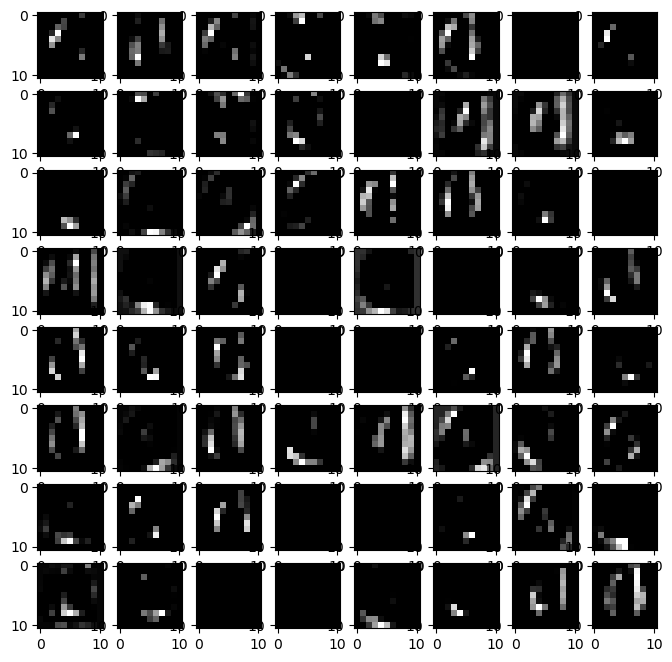

Feature maps of Pooling layer 2


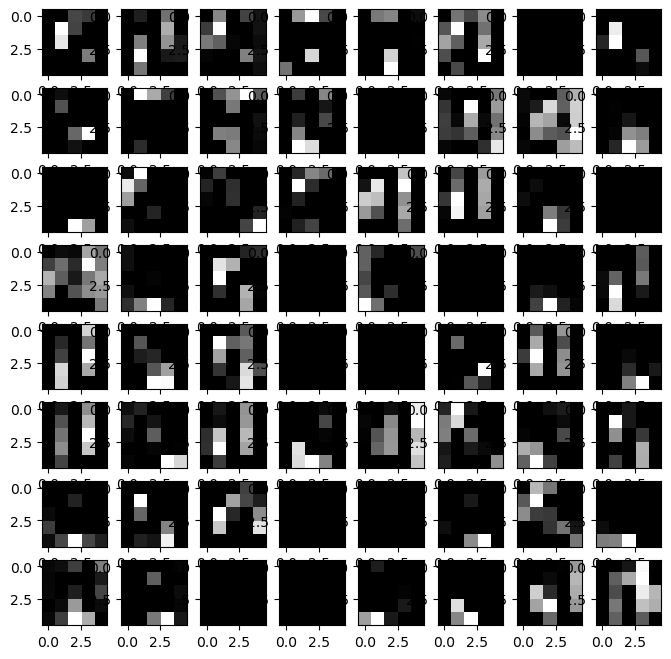

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


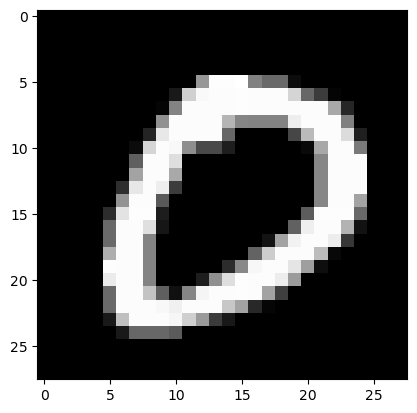

Feature maps of Convo layer 1


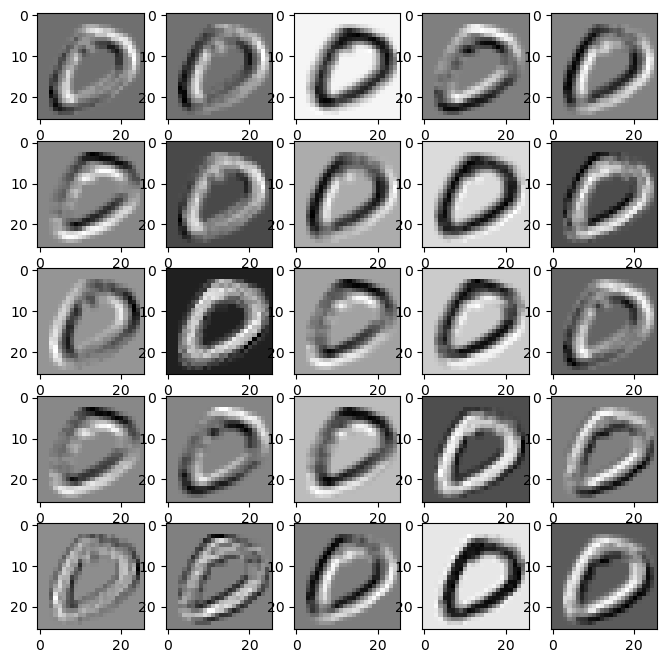

Feature maps of Activation layer 1


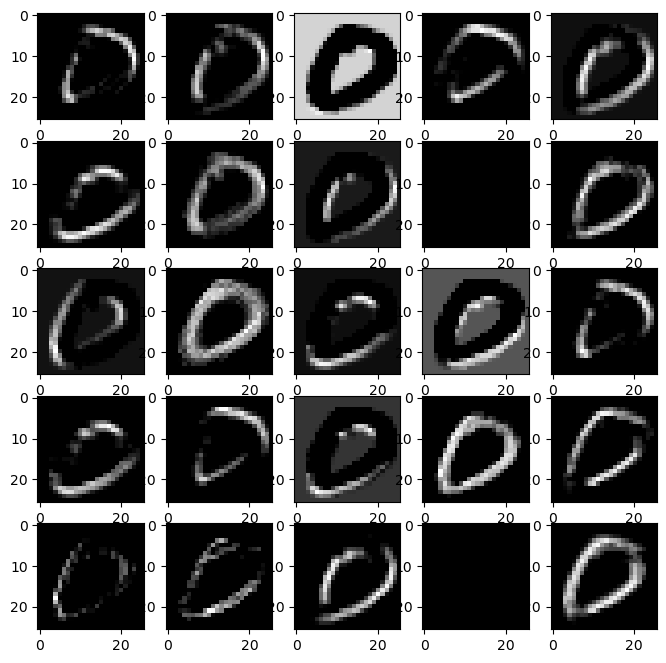

Feature maps of Pooling layer 1


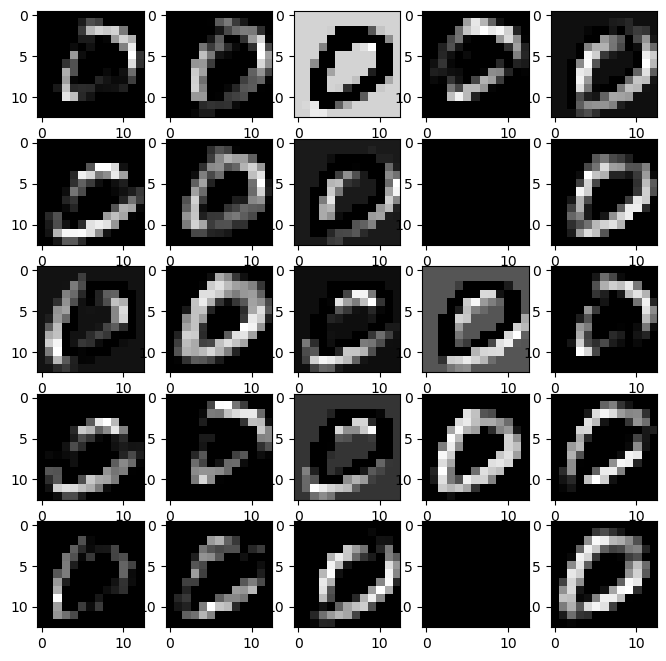

Feature maps of Convo layer 2


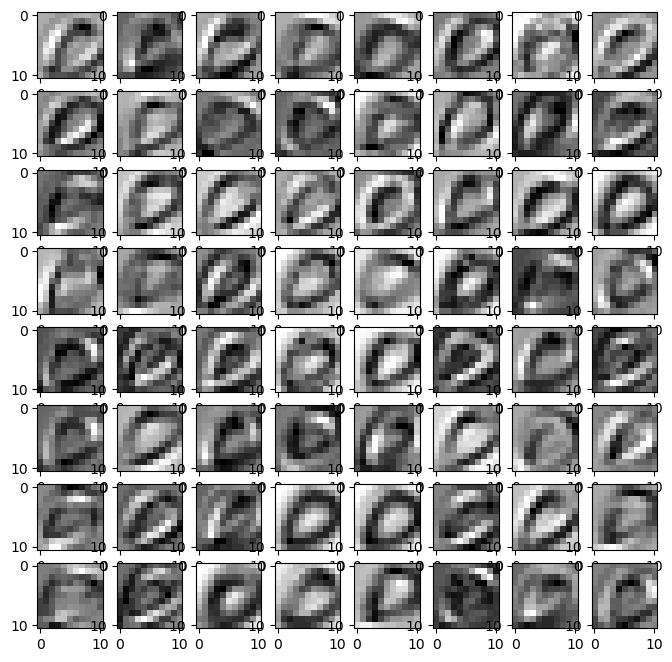

Feature maps of Activation layer 2


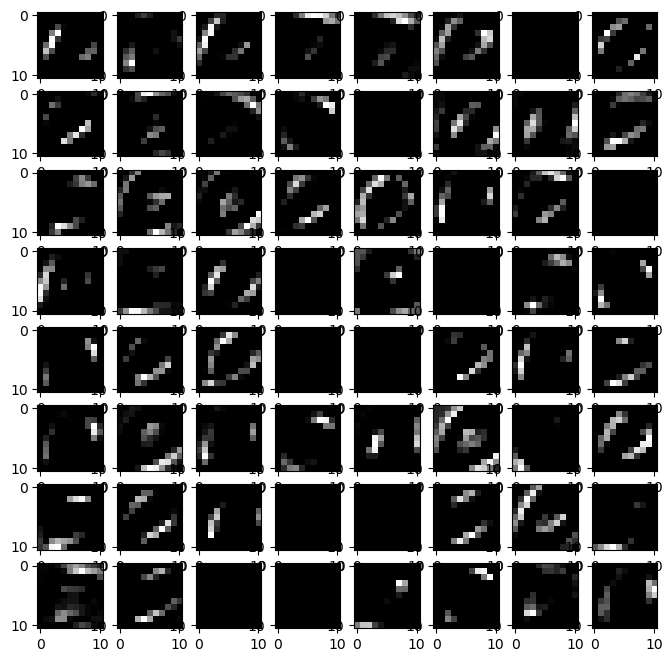

Feature maps of Pooling layer 2


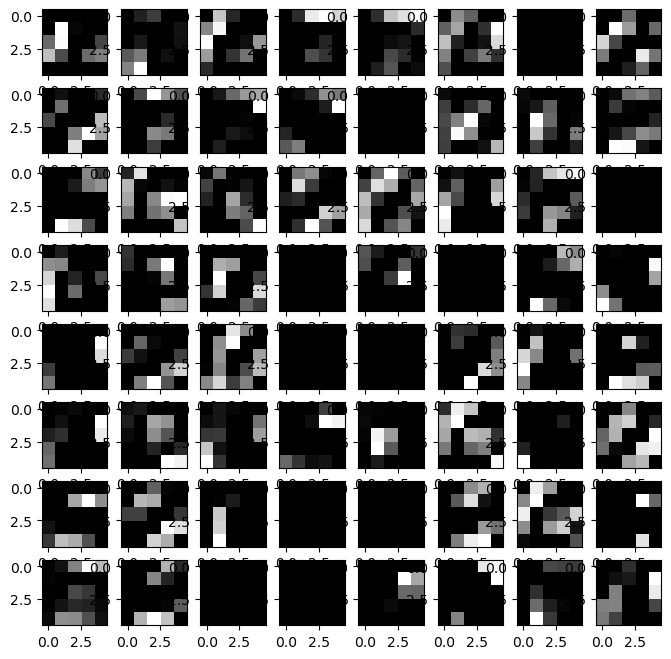

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


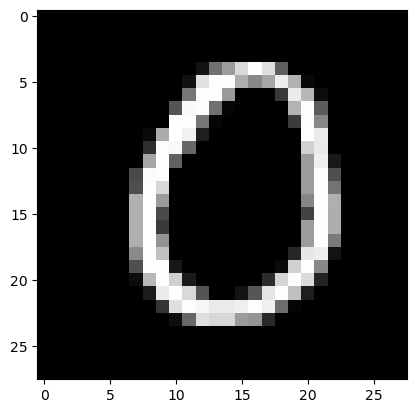

Feature maps of Convo layer 1


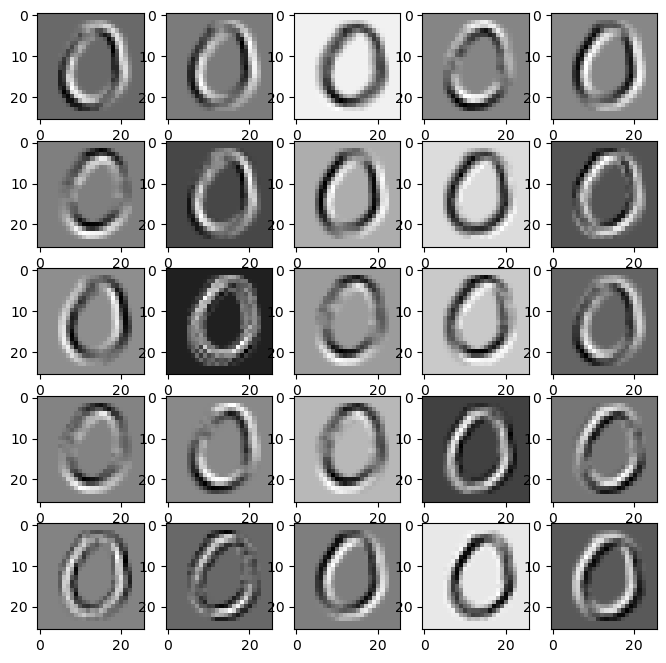

Feature maps of Activation layer 1


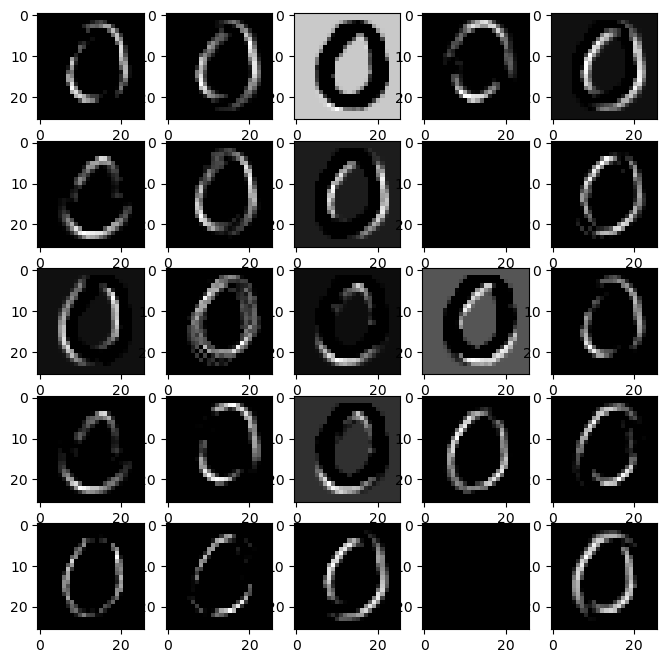

Feature maps of Pooling layer 1


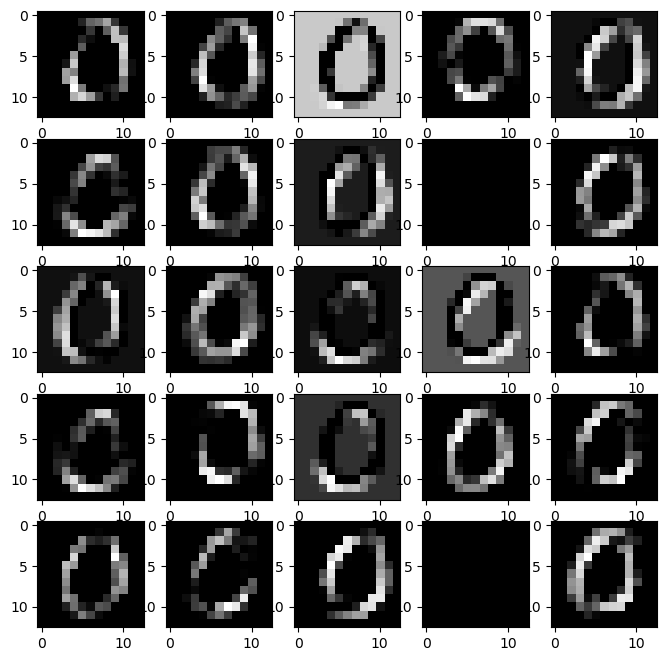

Feature maps of Convo layer 2


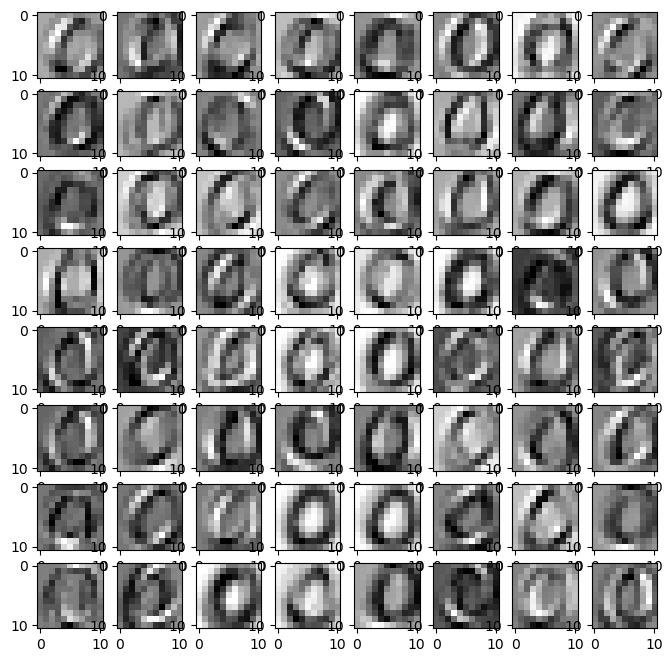

Feature maps of Activation layer 2


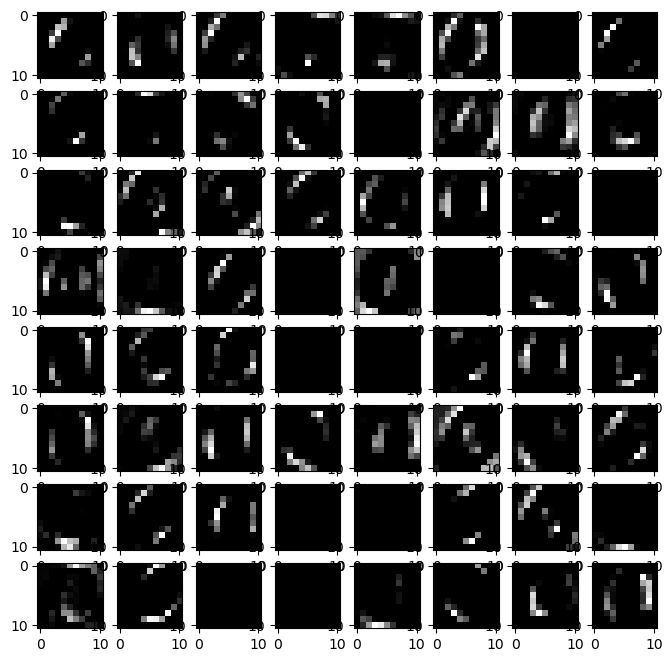

Feature maps of Pooling layer 2


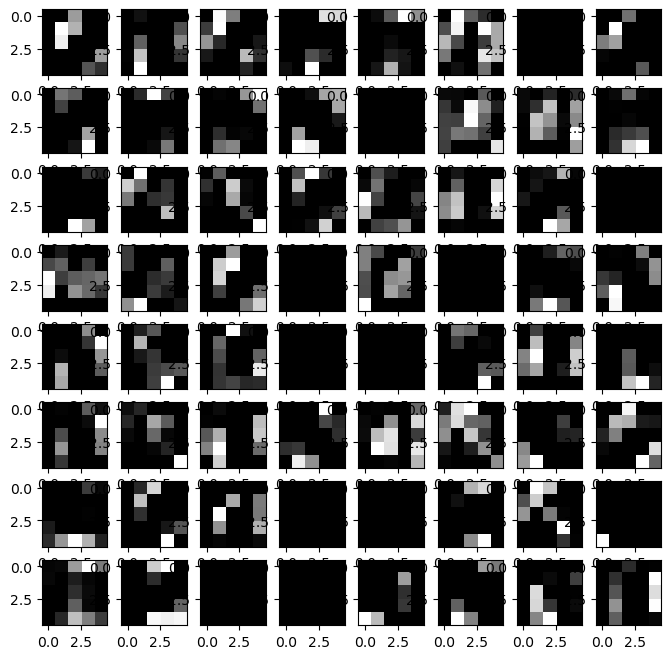

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


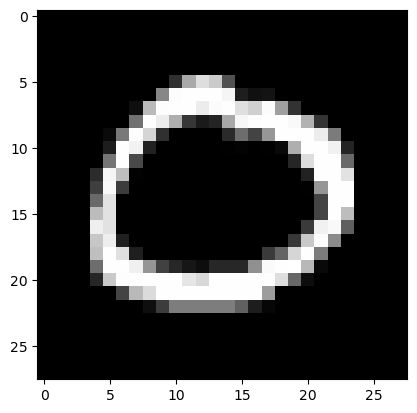

Feature maps of Convo layer 1


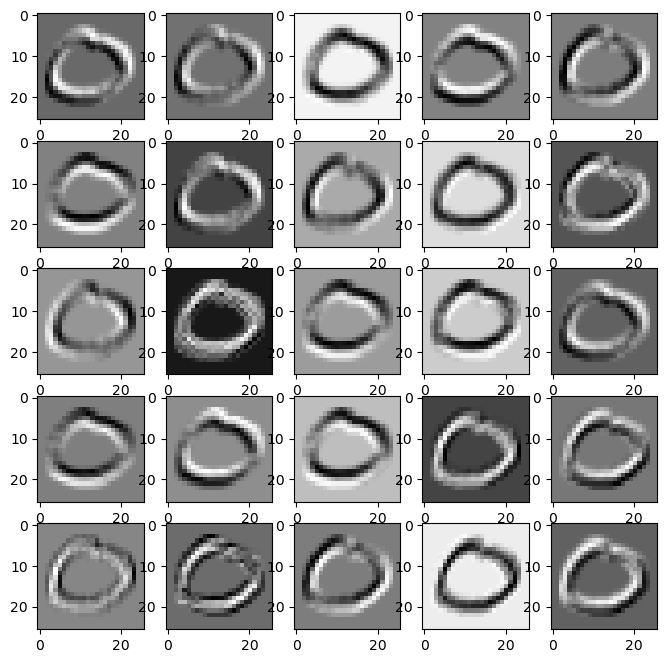

Feature maps of Activation layer 1


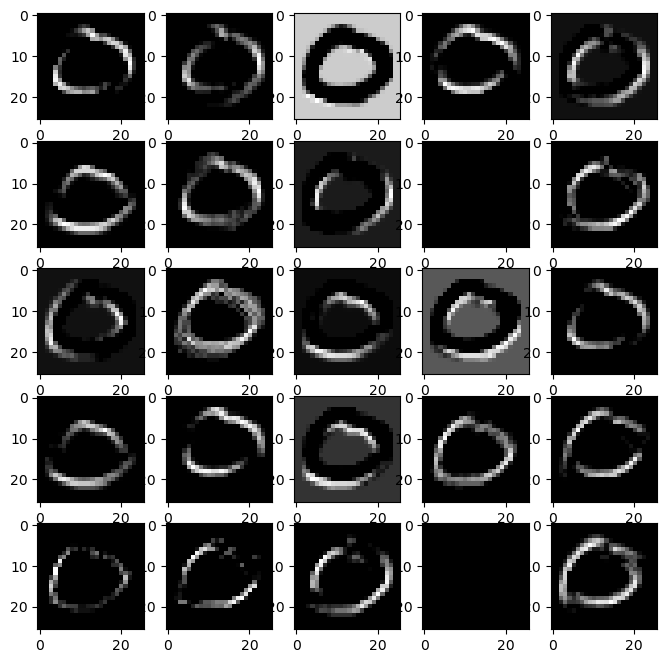

Feature maps of Pooling layer 1


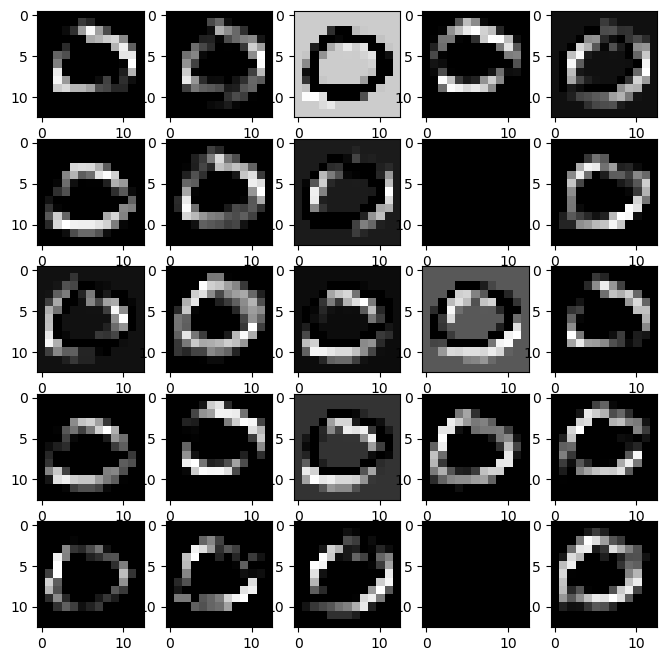

Feature maps of Convo layer 2


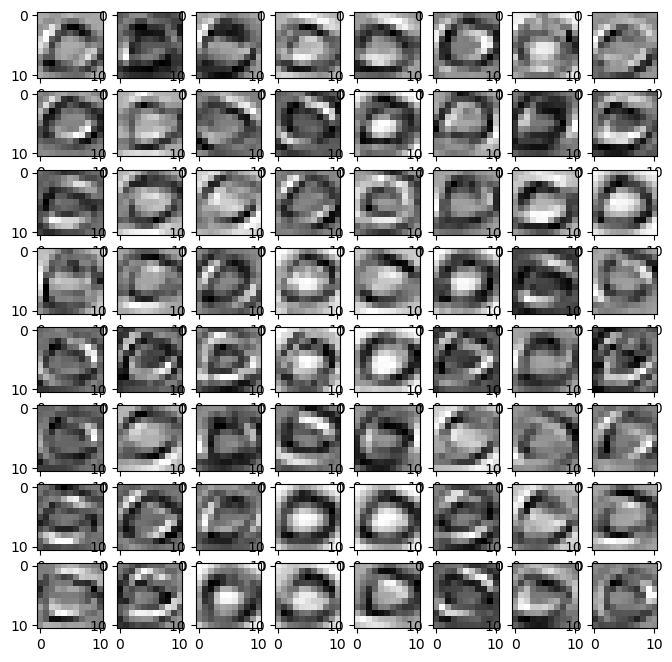

Feature maps of Activation layer 2


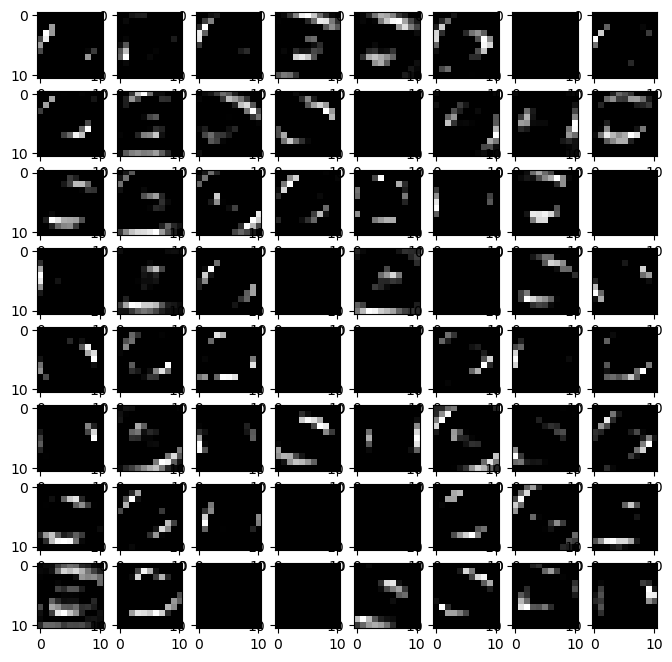

Feature maps of Pooling layer 2


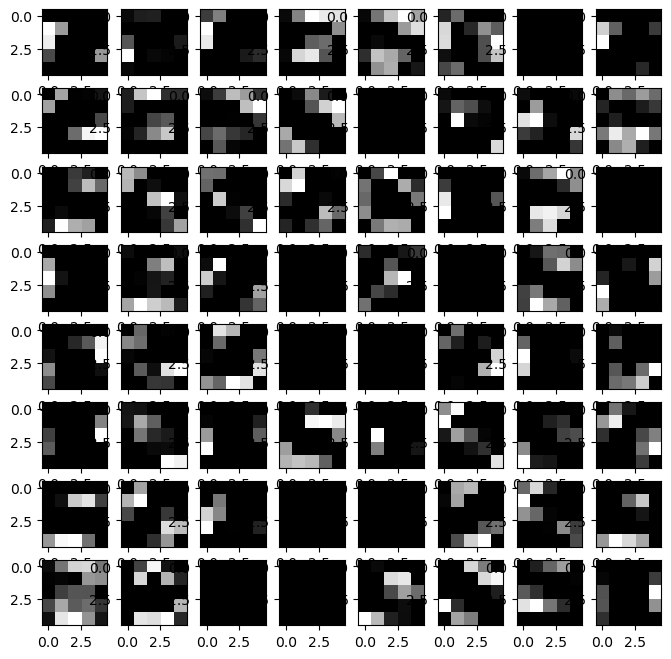

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


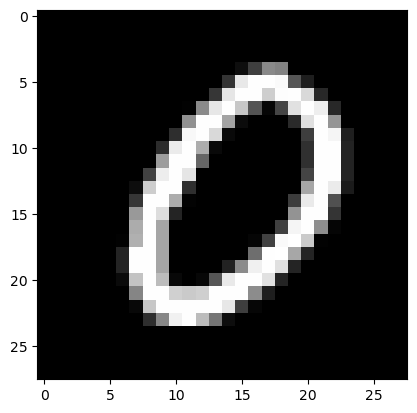

Feature maps of Convo layer 1


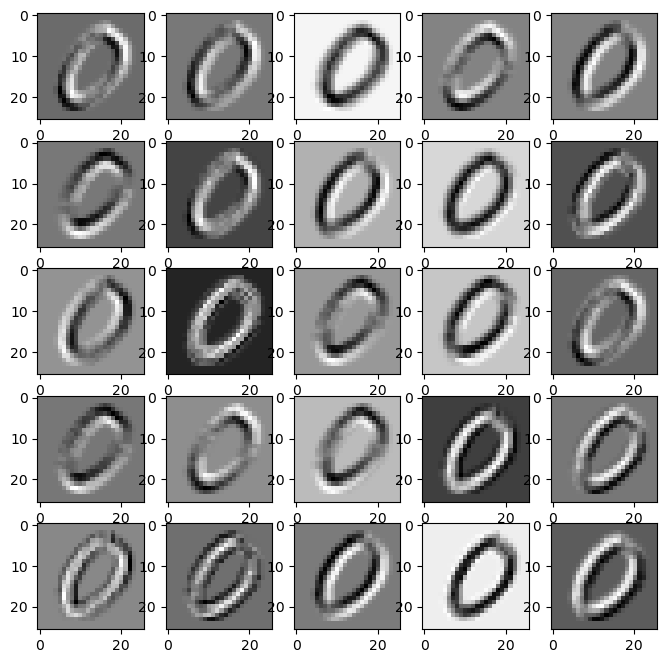

Feature maps of Activation layer 1


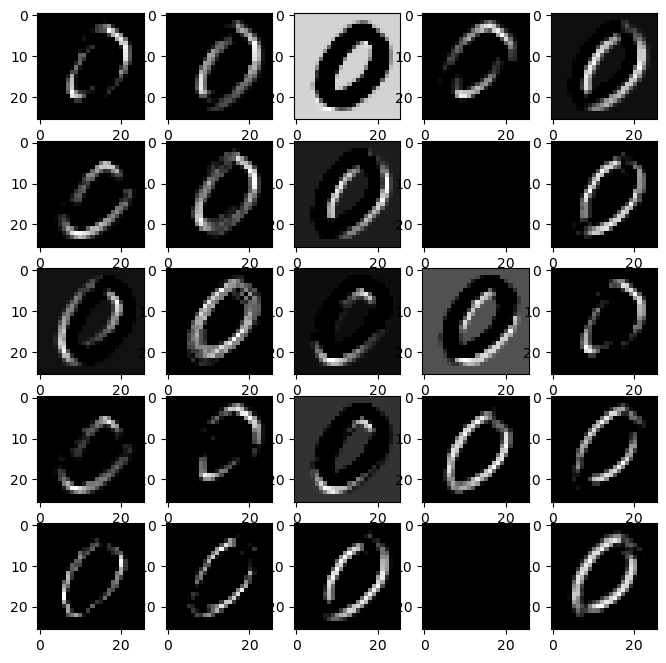

Feature maps of Pooling layer 1


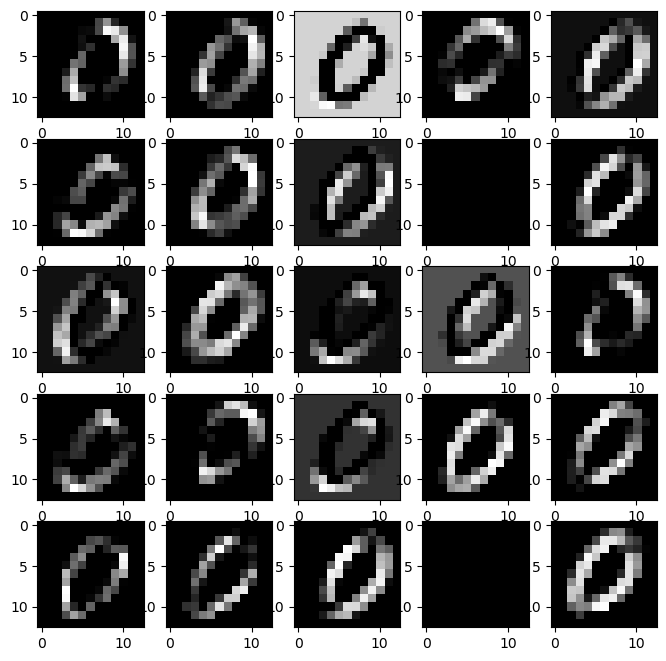

Feature maps of Convo layer 2


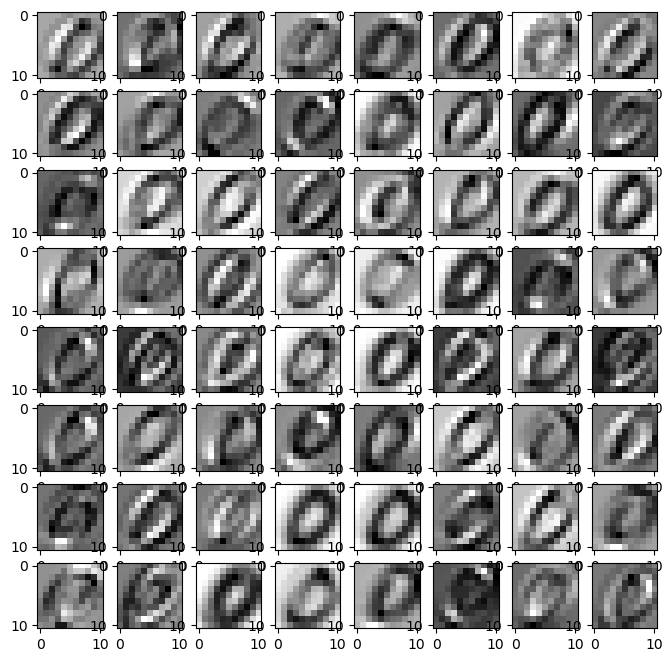

Feature maps of Activation layer 2


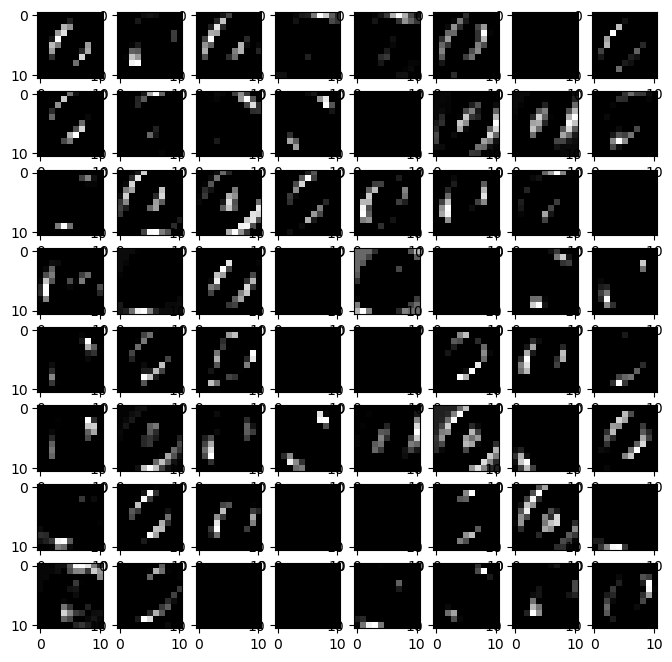

Feature maps of Pooling layer 2


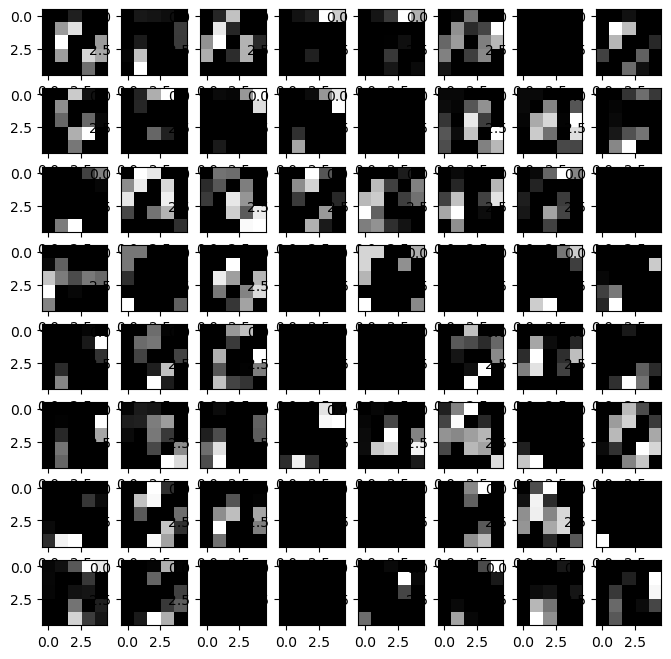

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


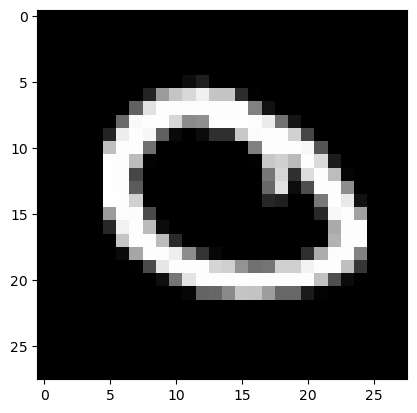

Feature maps of Convo layer 1


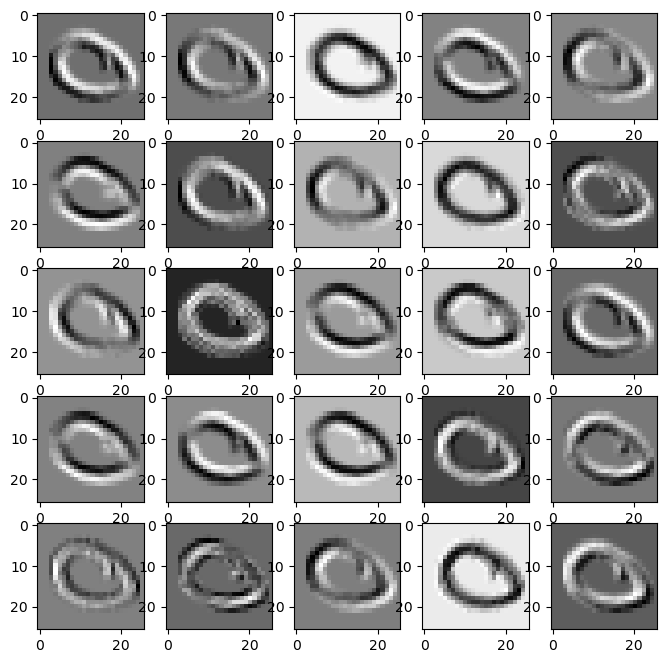

Feature maps of Activation layer 1


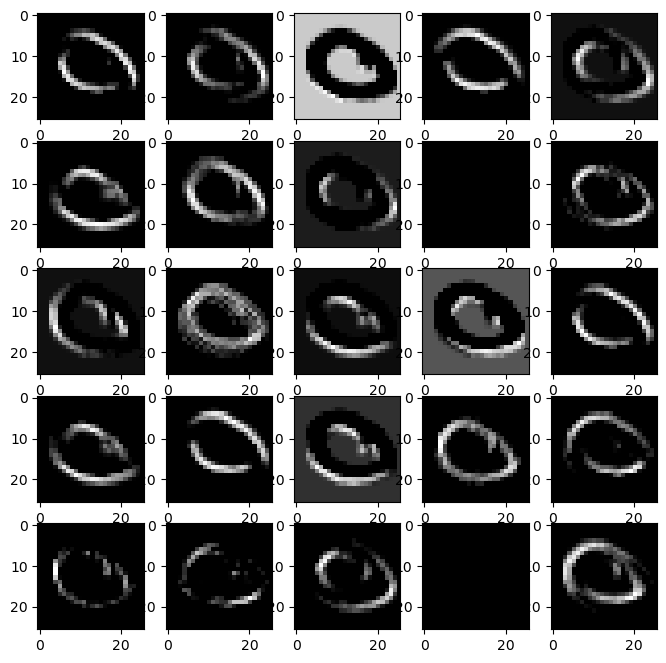

Feature maps of Pooling layer 1


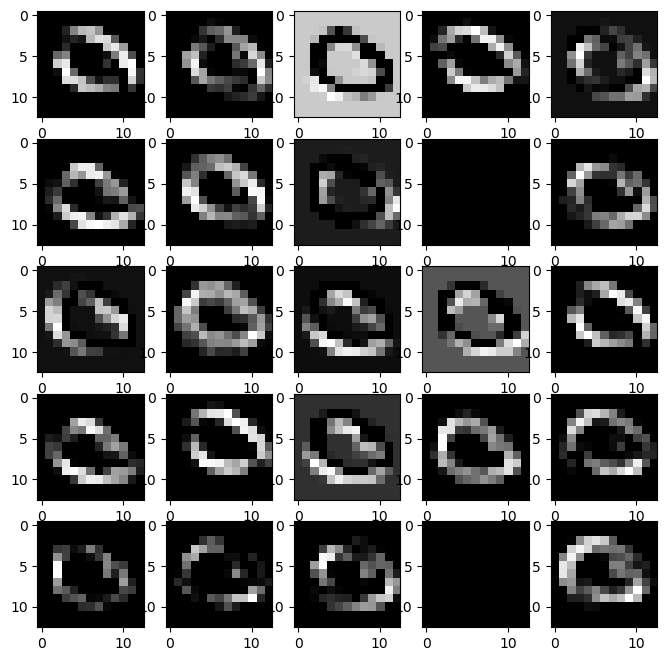

Feature maps of Convo layer 2


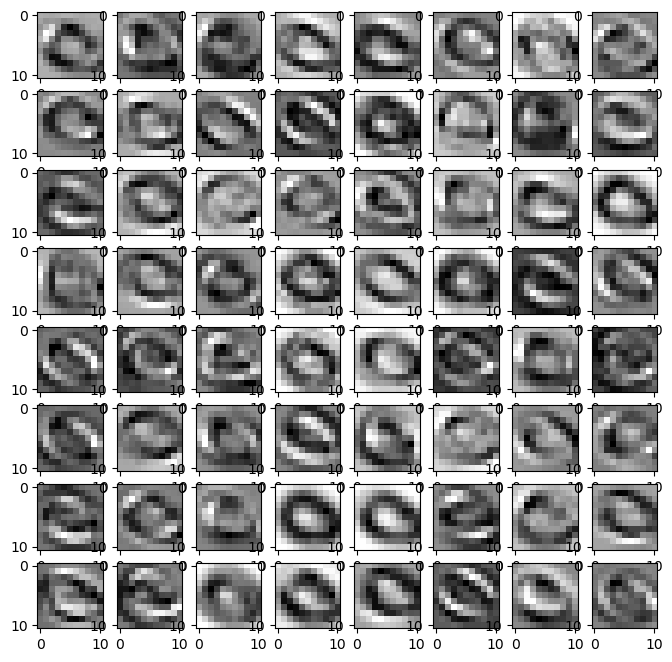

Feature maps of Activation layer 2


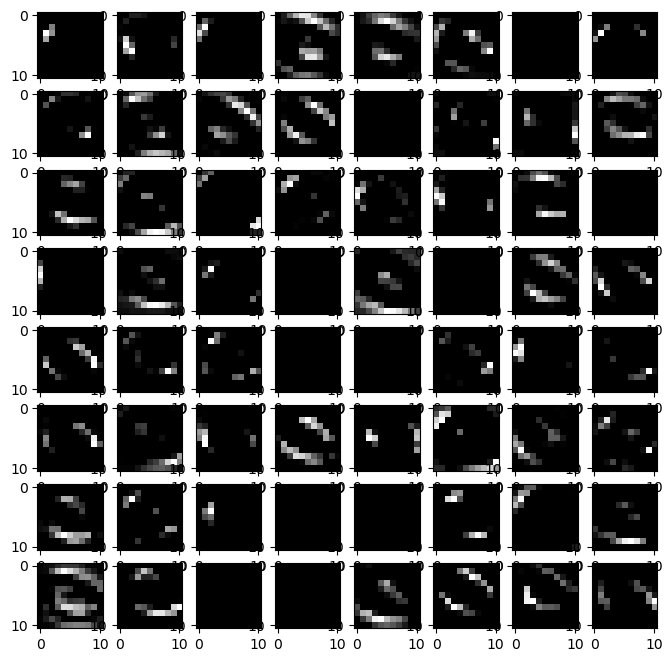

Feature maps of Pooling layer 2


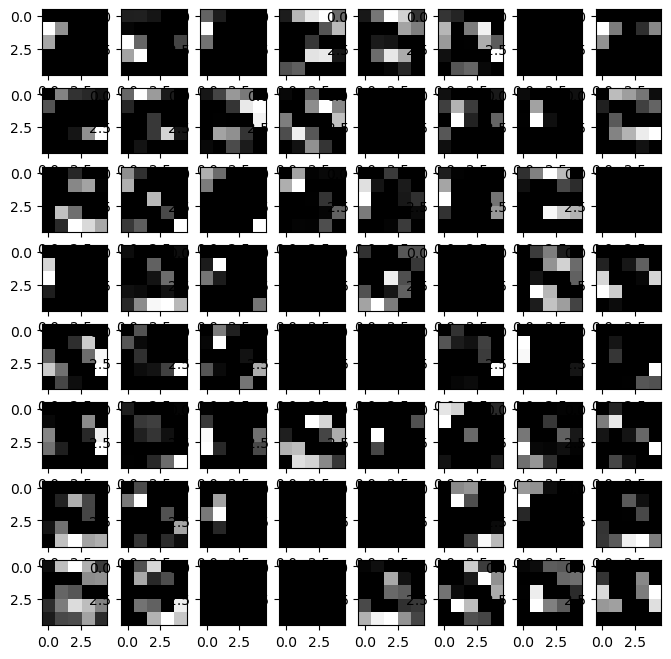

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


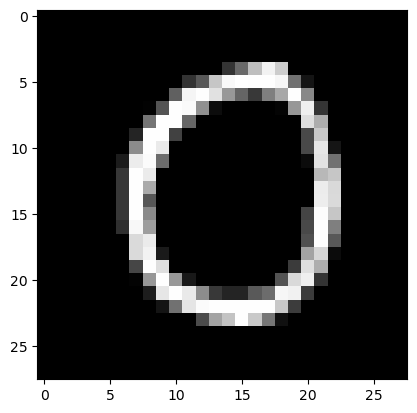

Feature maps of Convo layer 1


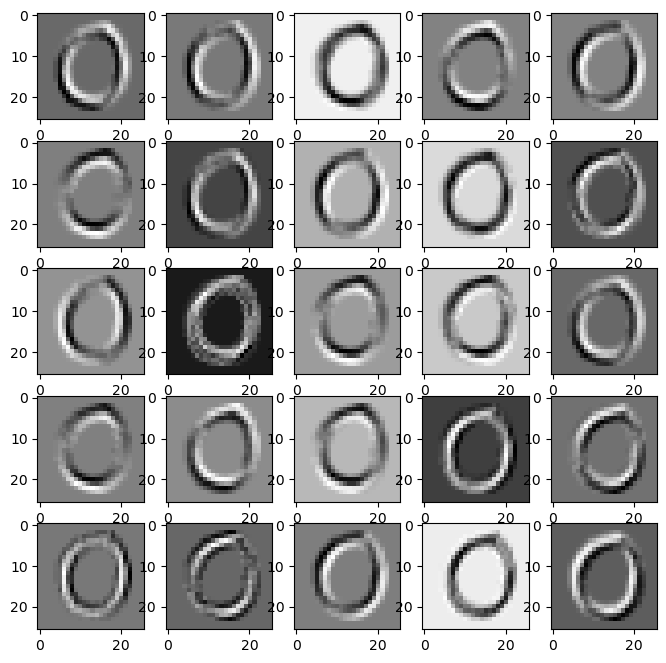

Feature maps of Activation layer 1


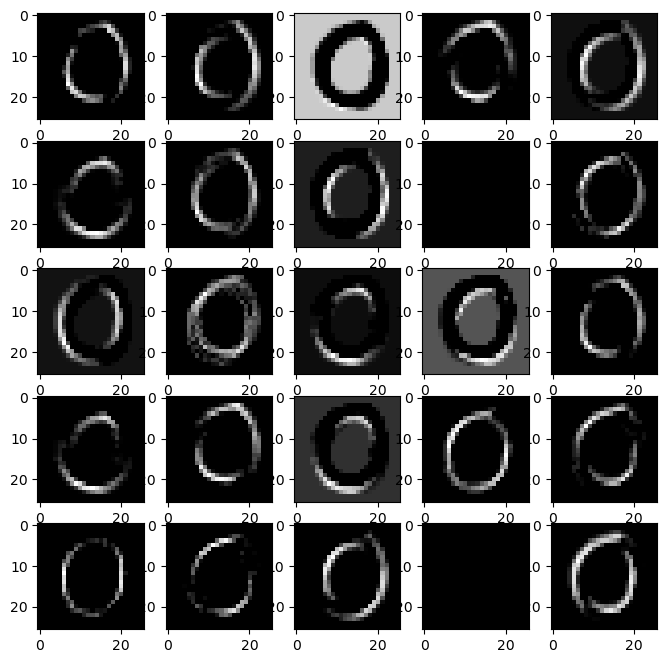

Feature maps of Pooling layer 1


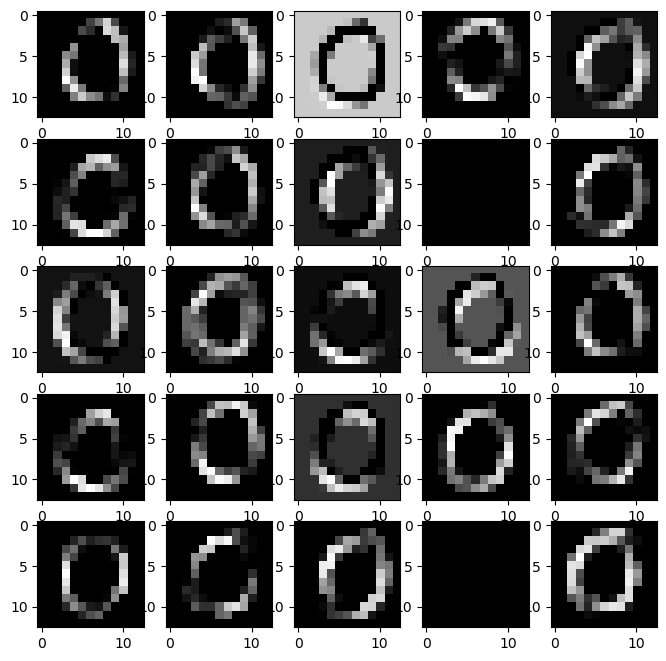

Feature maps of Convo layer 2


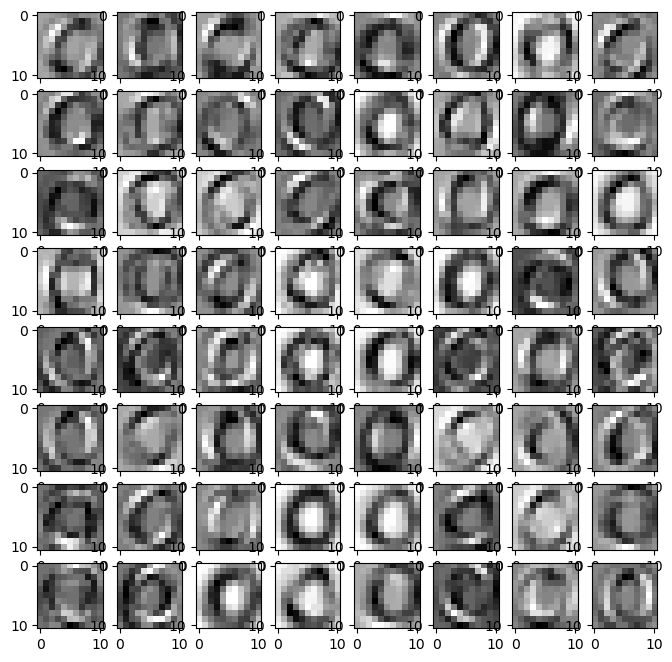

Feature maps of Activation layer 2


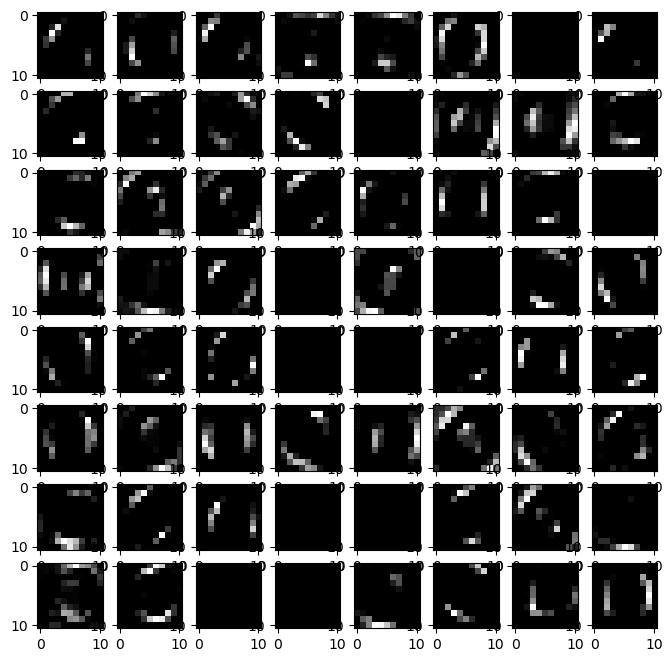

Feature maps of Pooling layer 2


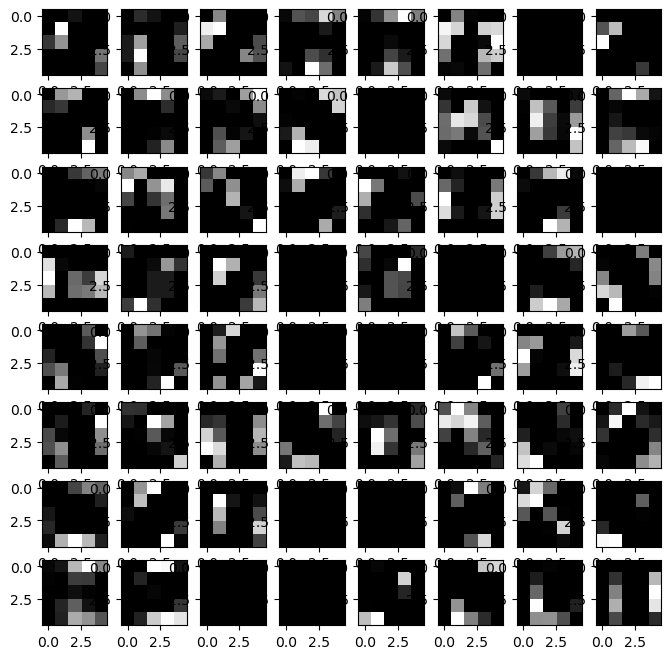

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


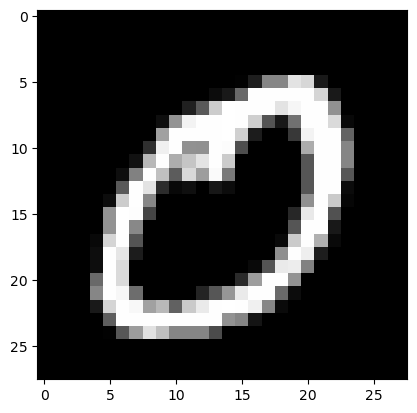

Feature maps of Convo layer 1


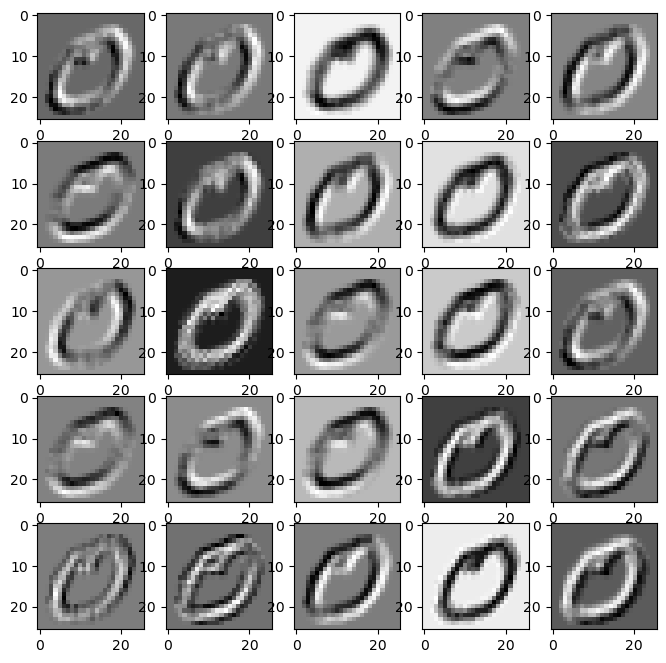

Feature maps of Activation layer 1


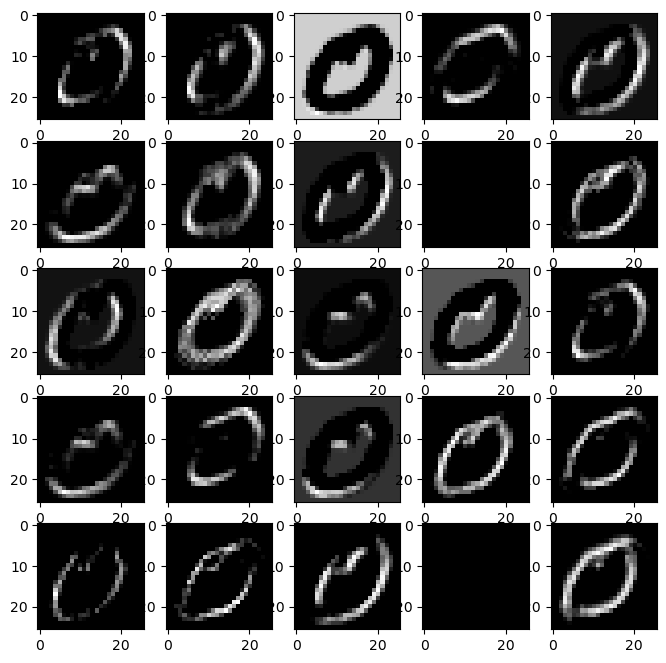

Feature maps of Pooling layer 1


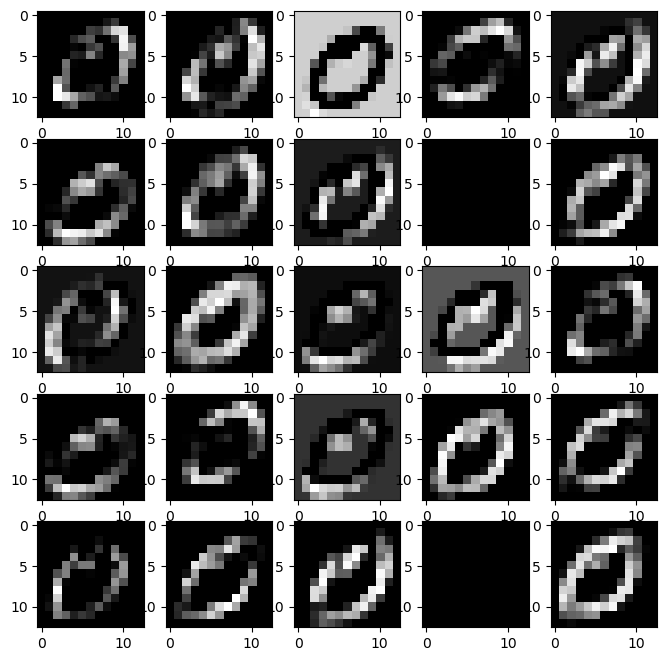

Feature maps of Convo layer 2


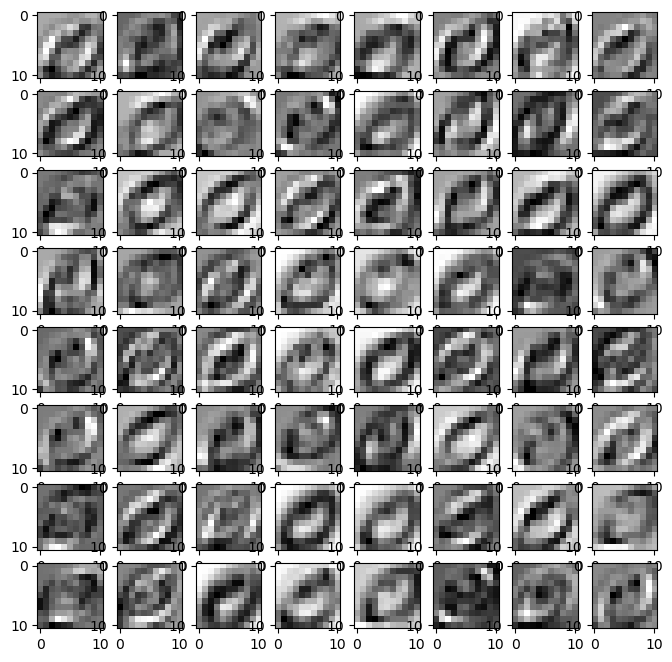

Feature maps of Activation layer 2


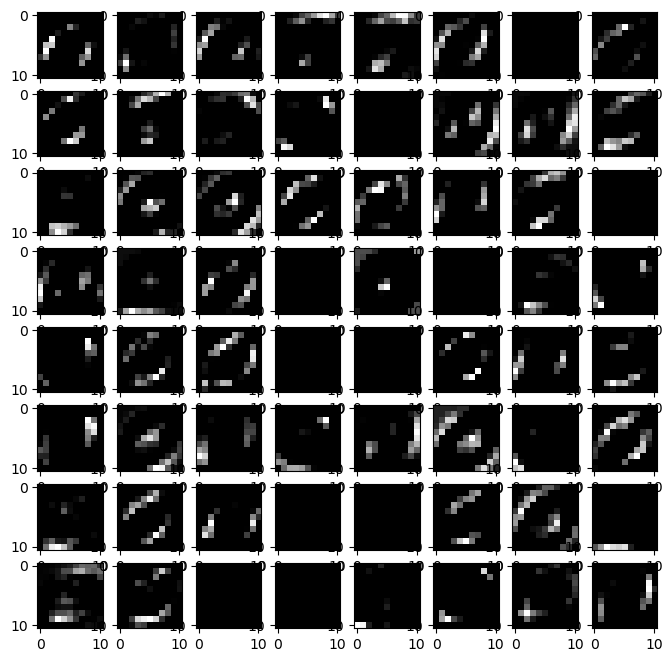

Feature maps of Pooling layer 2


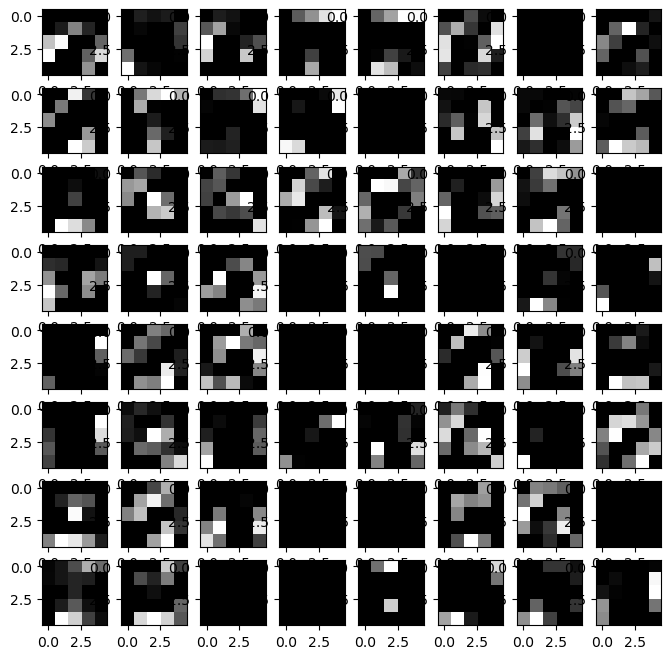

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


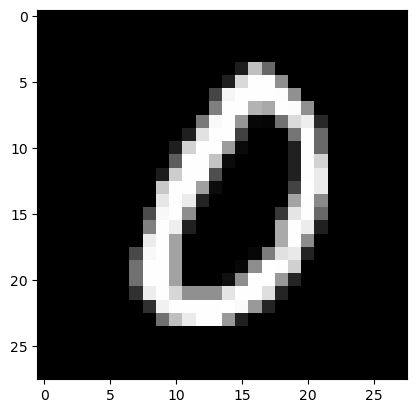

Feature maps of Convo layer 1


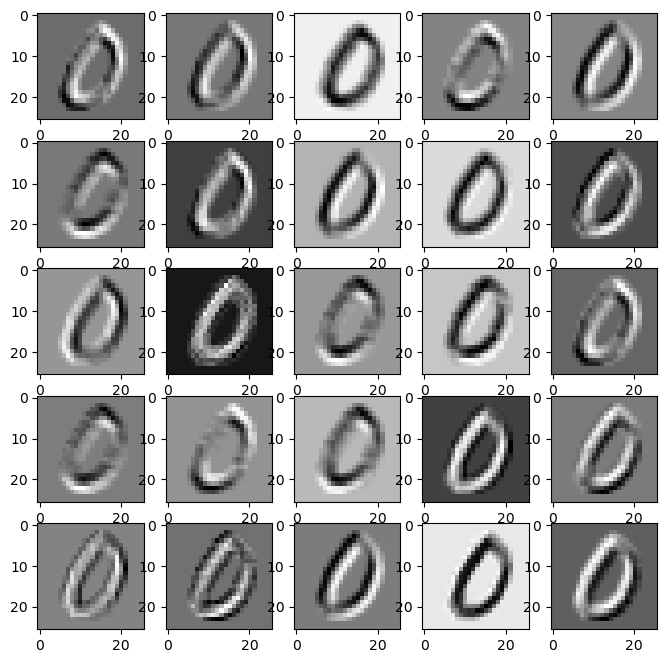

Feature maps of Activation layer 1


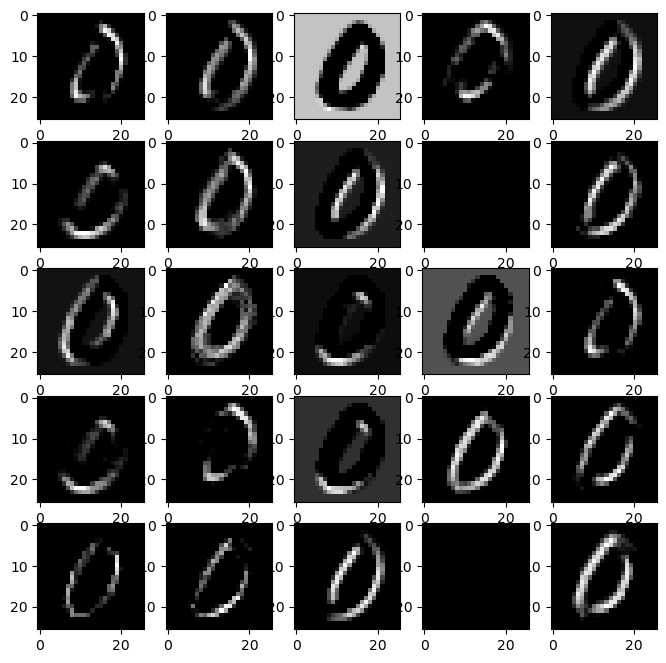

Feature maps of Pooling layer 1


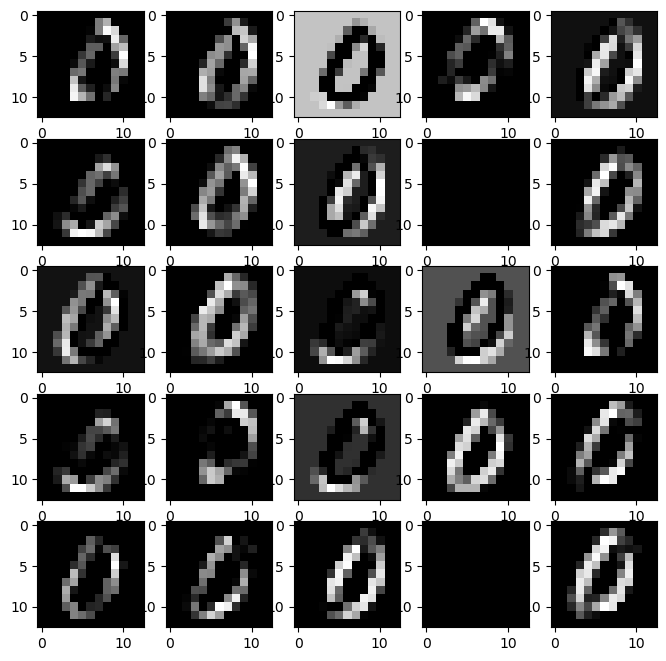

Feature maps of Convo layer 2


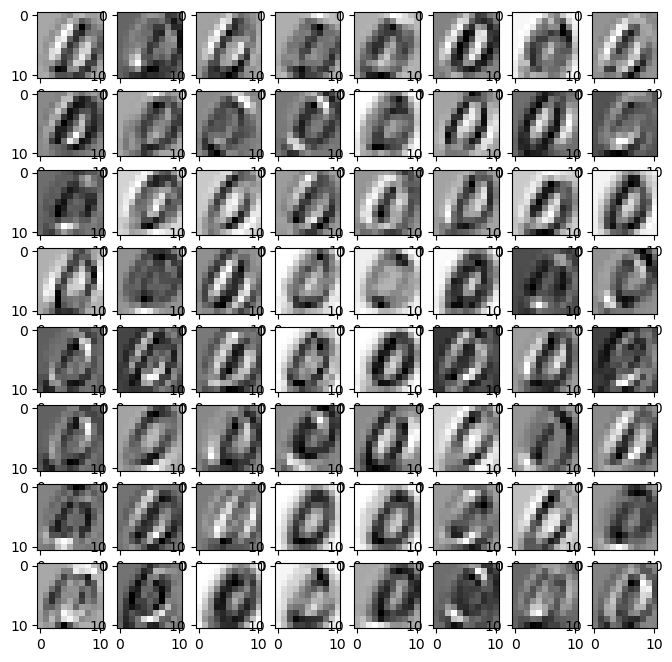

Feature maps of Activation layer 2


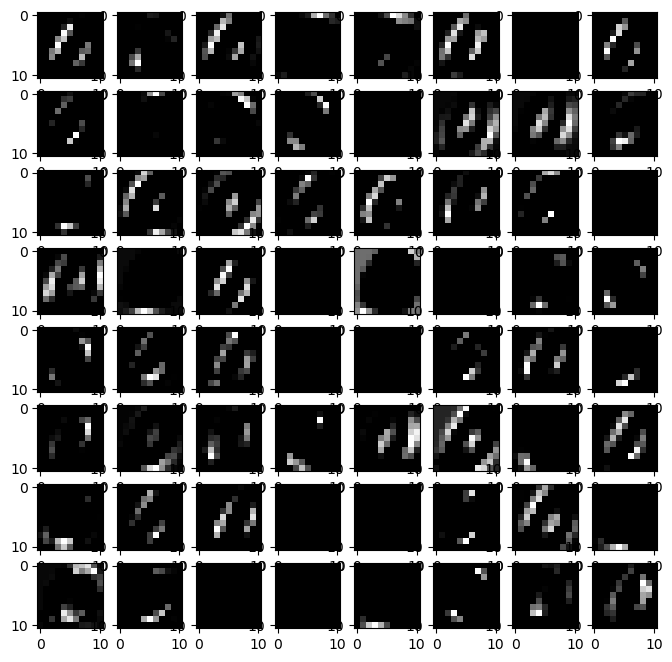

Feature maps of Pooling layer 2


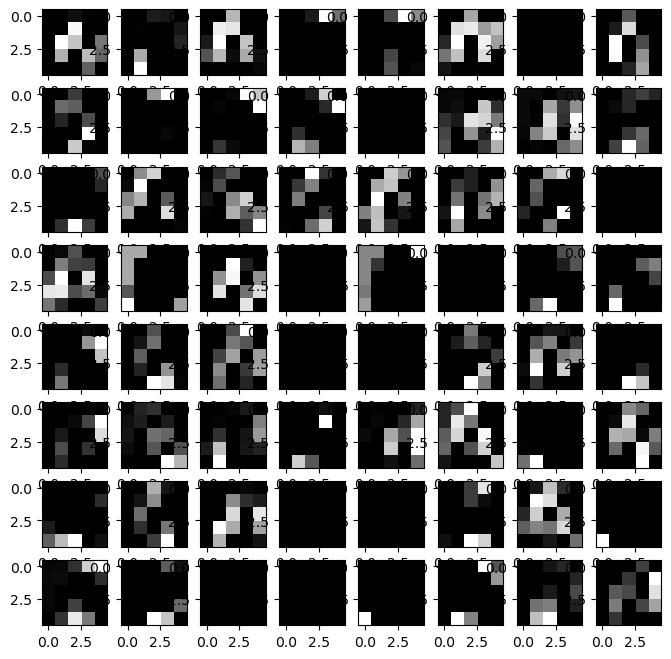

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


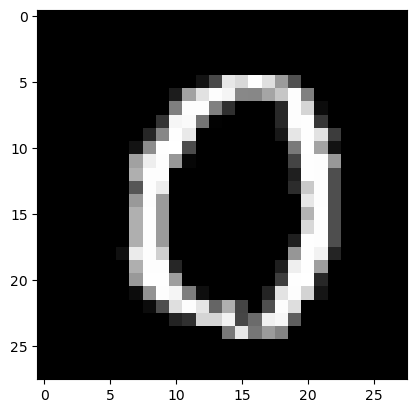

Feature maps of Convo layer 1


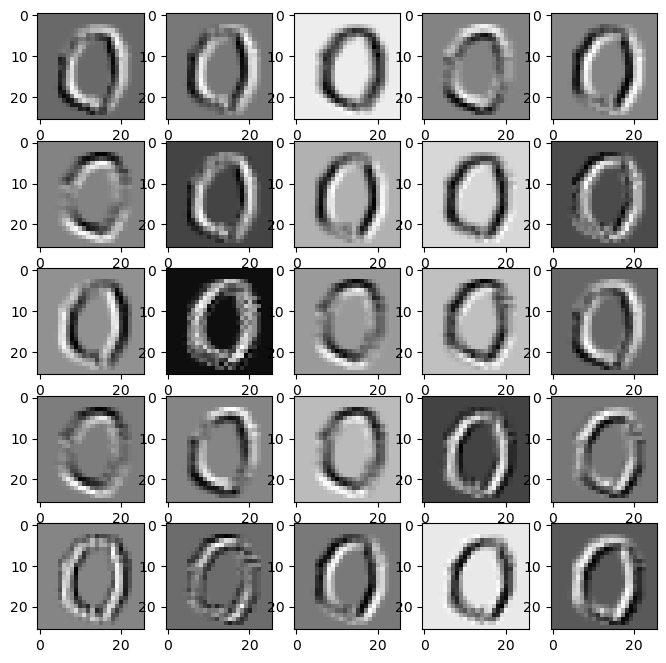

Feature maps of Activation layer 1


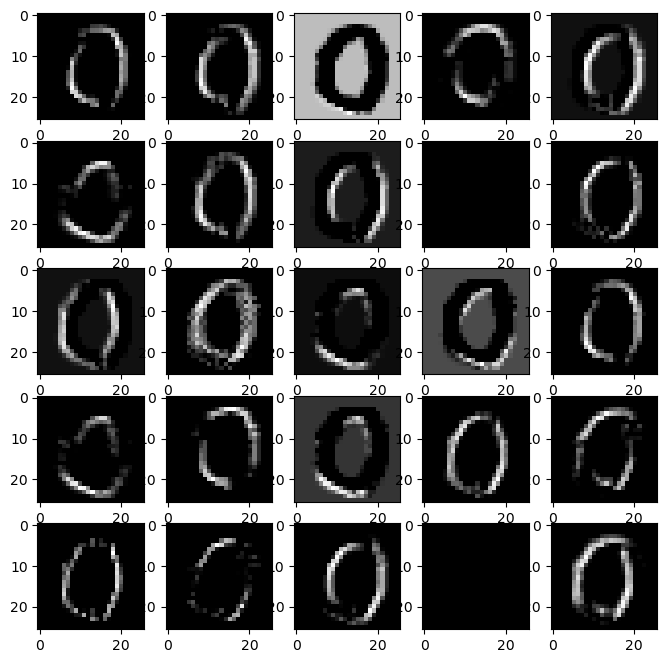

Feature maps of Pooling layer 1


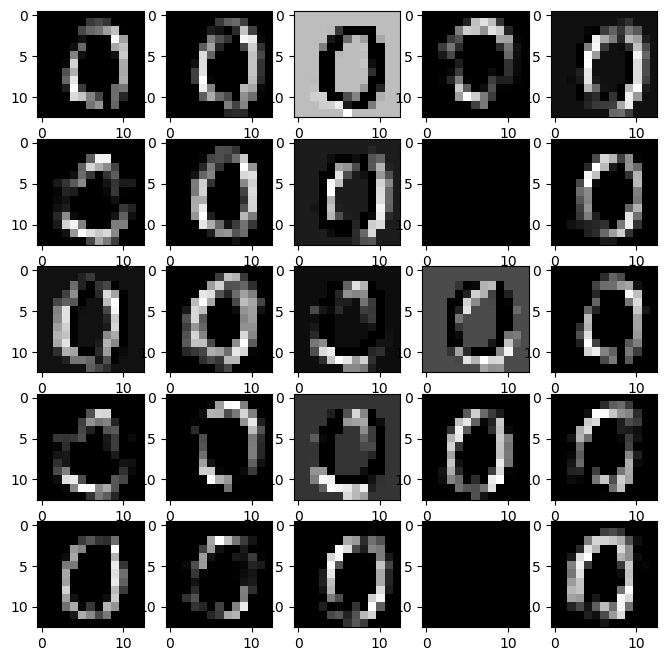

Feature maps of Convo layer 2


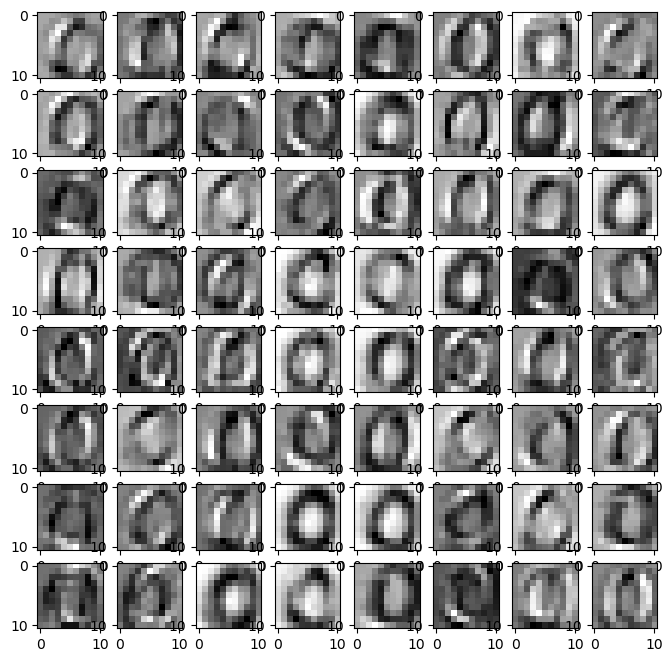

Feature maps of Activation layer 2


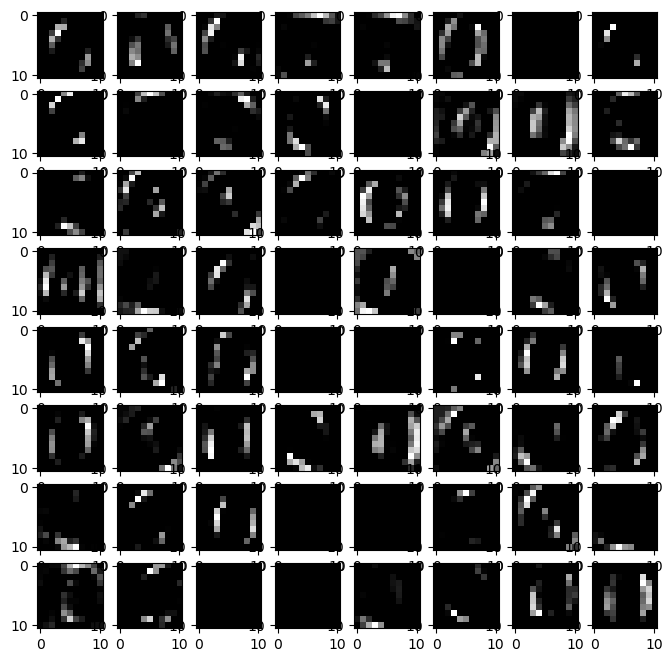

Feature maps of Pooling layer 2


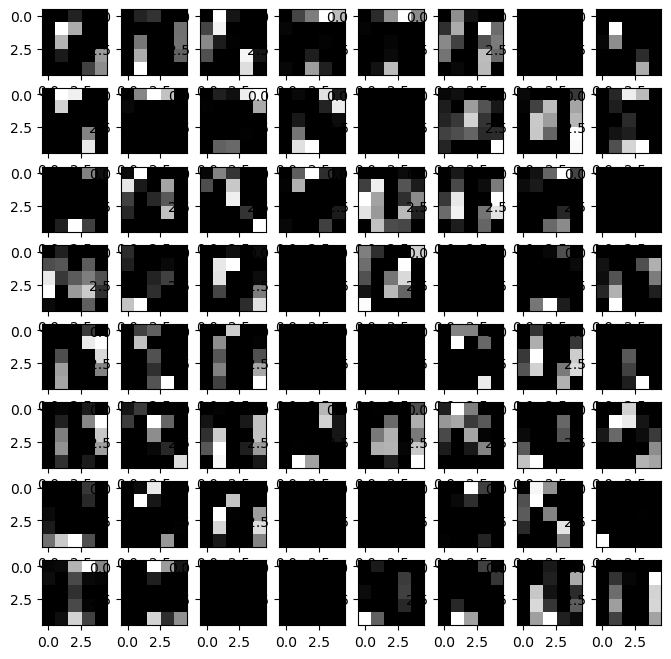

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


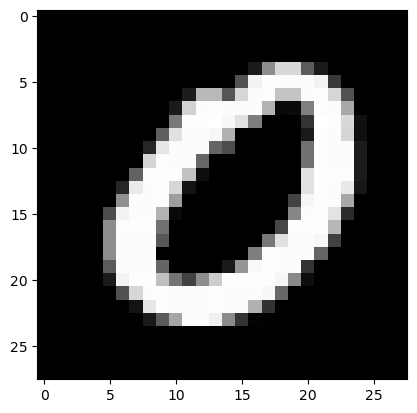

Feature maps of Convo layer 1


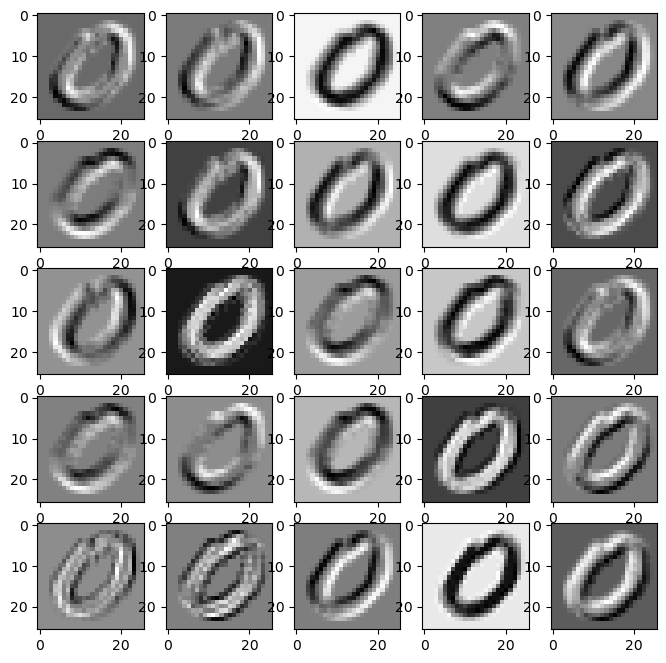

Feature maps of Activation layer 1


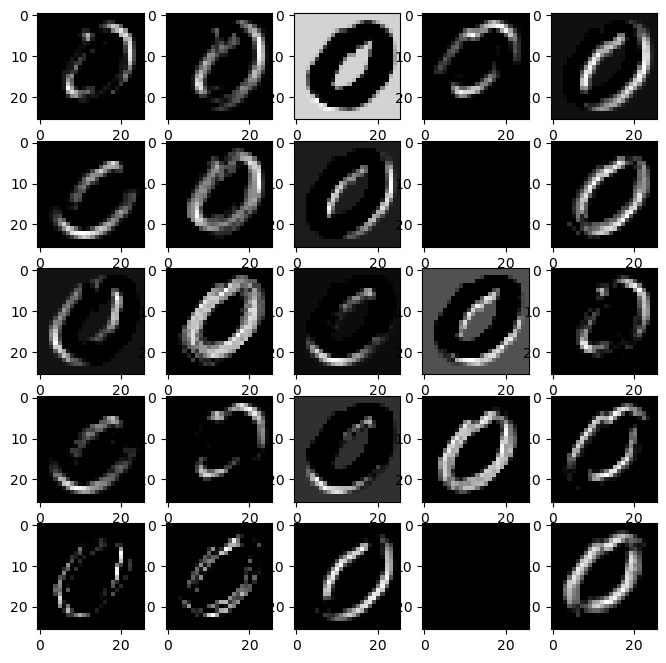

Feature maps of Pooling layer 1


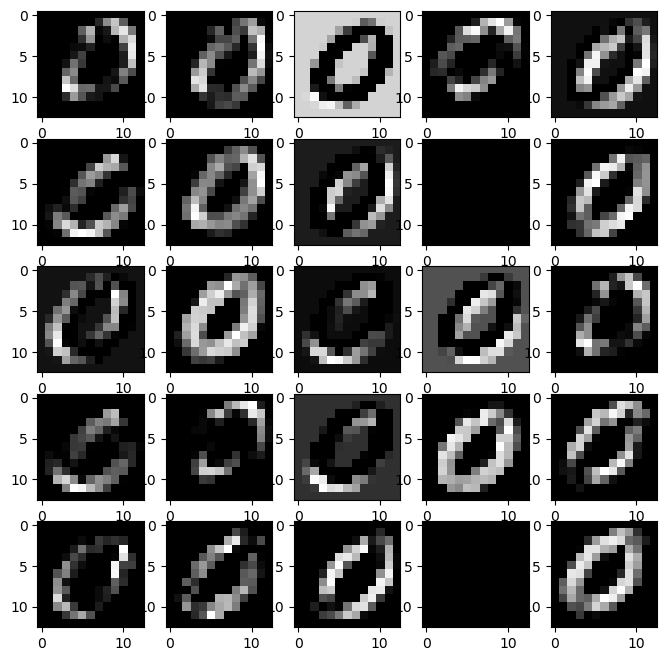

Feature maps of Convo layer 2


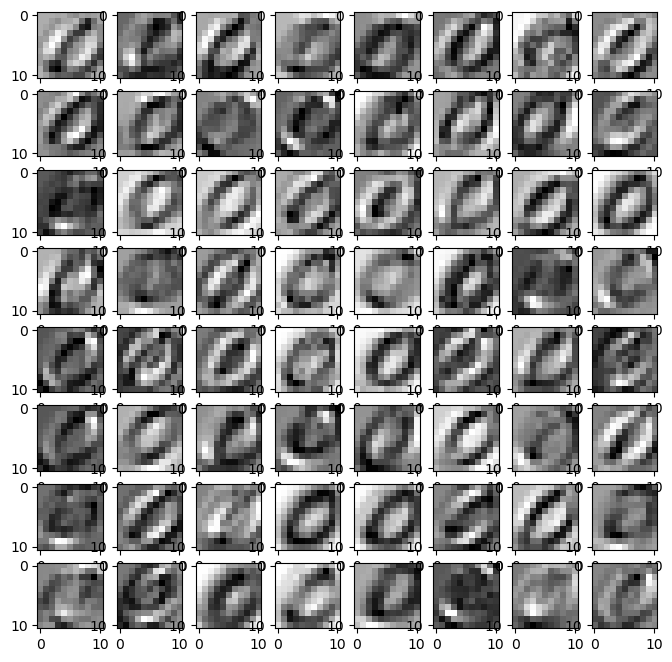

Feature maps of Activation layer 2


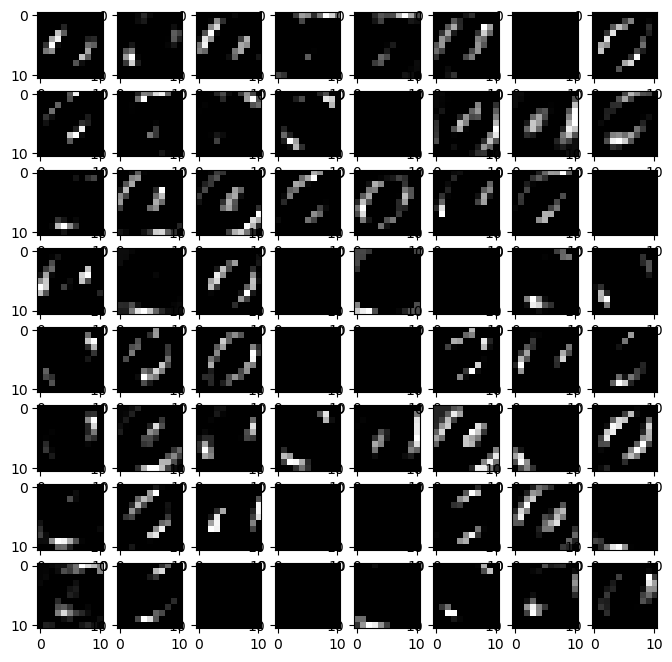

Feature maps of Pooling layer 2


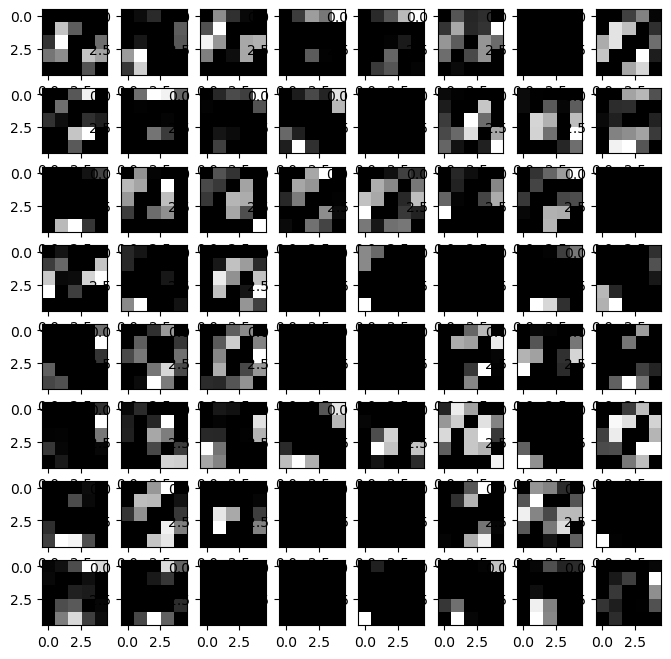

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


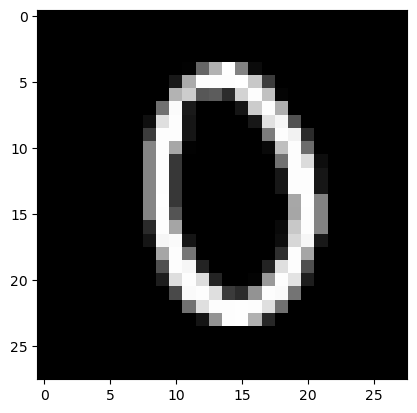

Feature maps of Convo layer 1


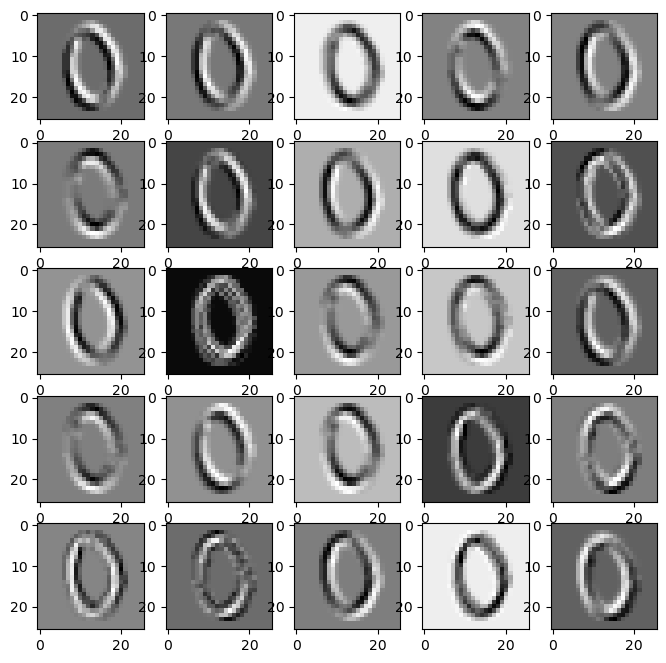

Feature maps of Activation layer 1


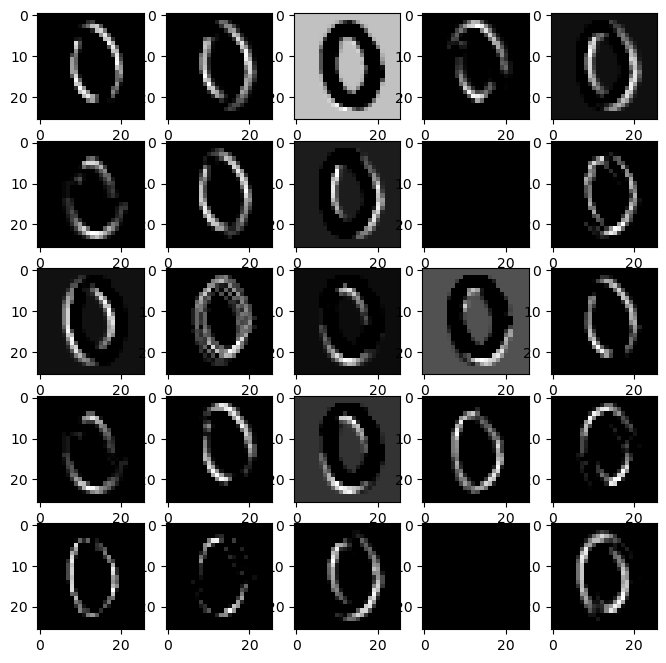

Feature maps of Pooling layer 1


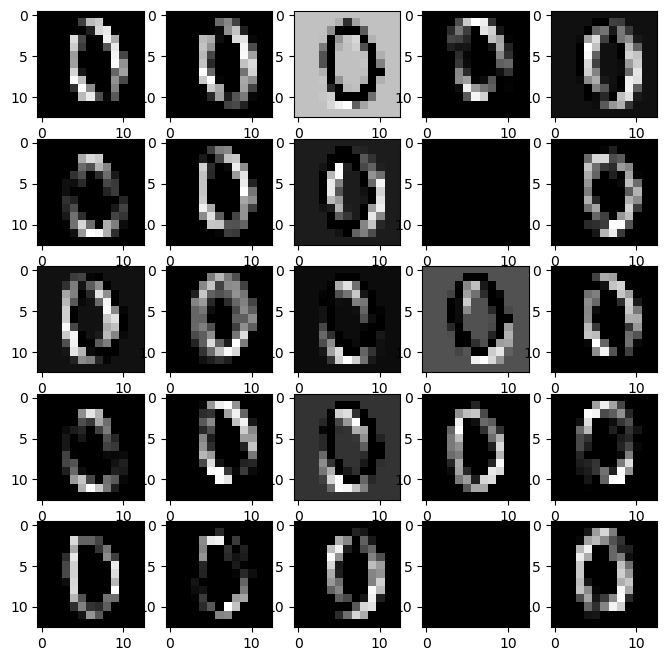

Feature maps of Convo layer 2


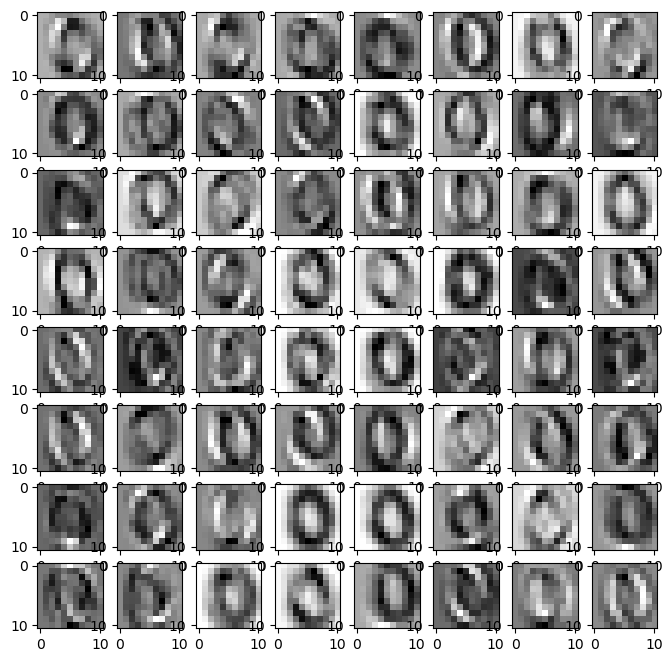

Feature maps of Activation layer 2


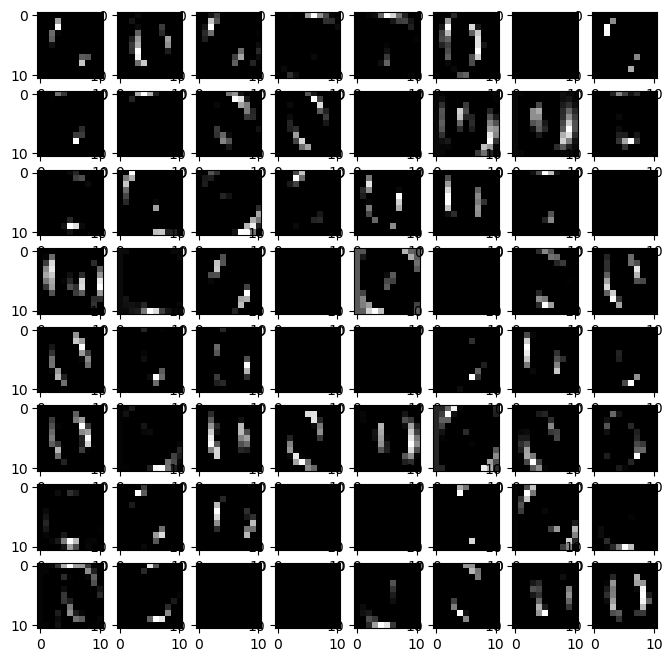

Feature maps of Pooling layer 2


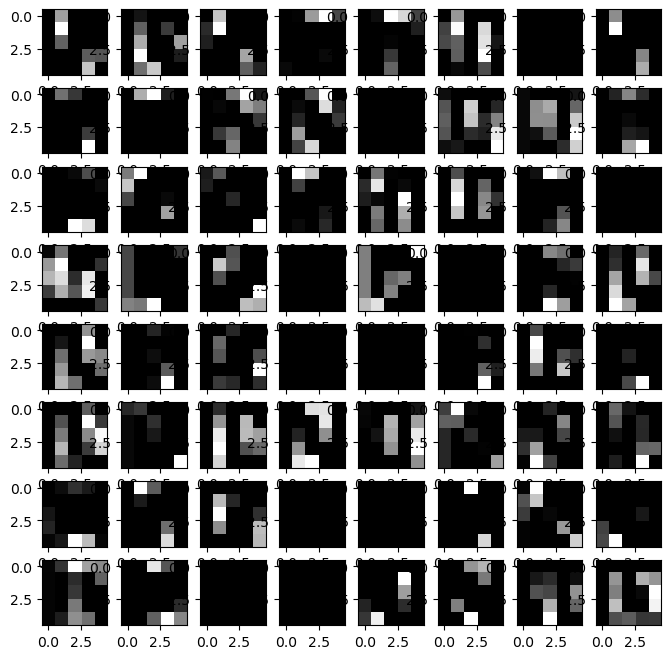

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


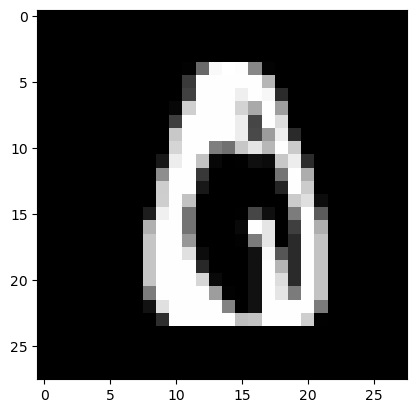

Feature maps of Convo layer 1


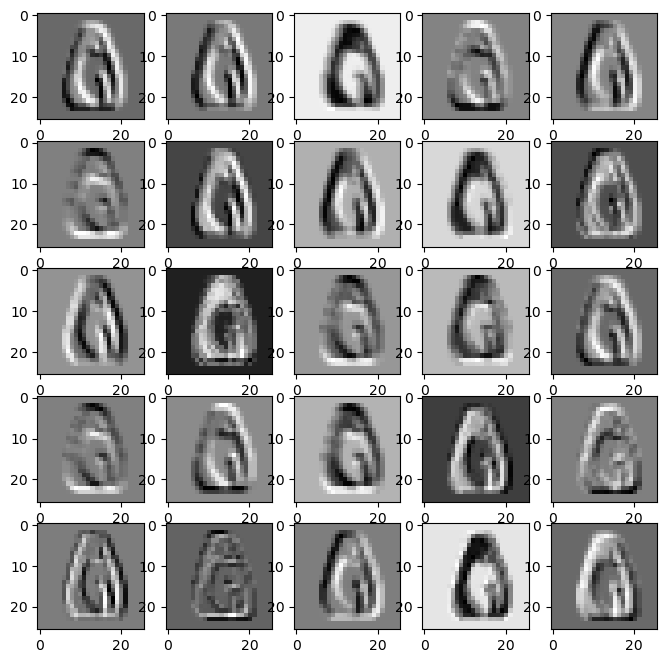

Feature maps of Activation layer 1


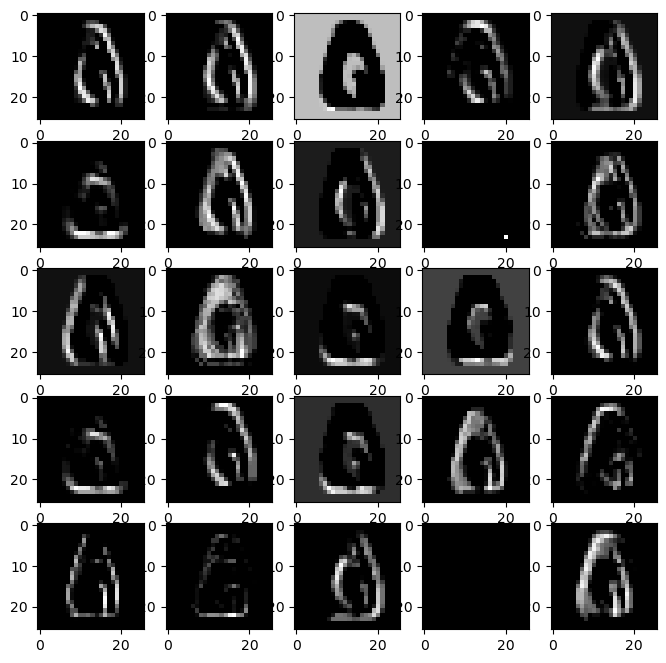

Feature maps of Pooling layer 1


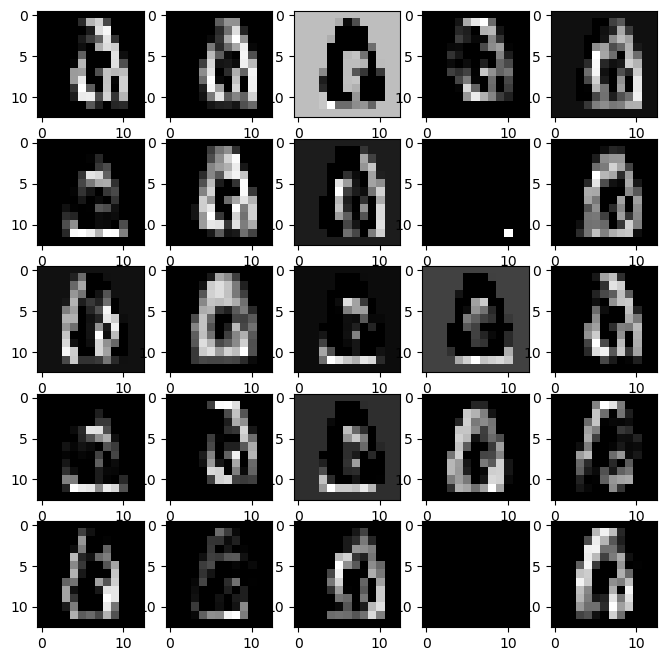

Feature maps of Convo layer 2


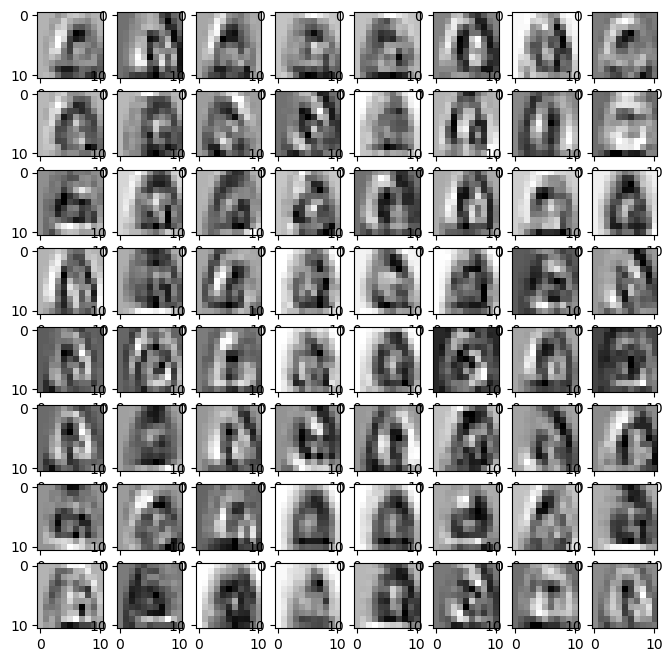

Feature maps of Activation layer 2


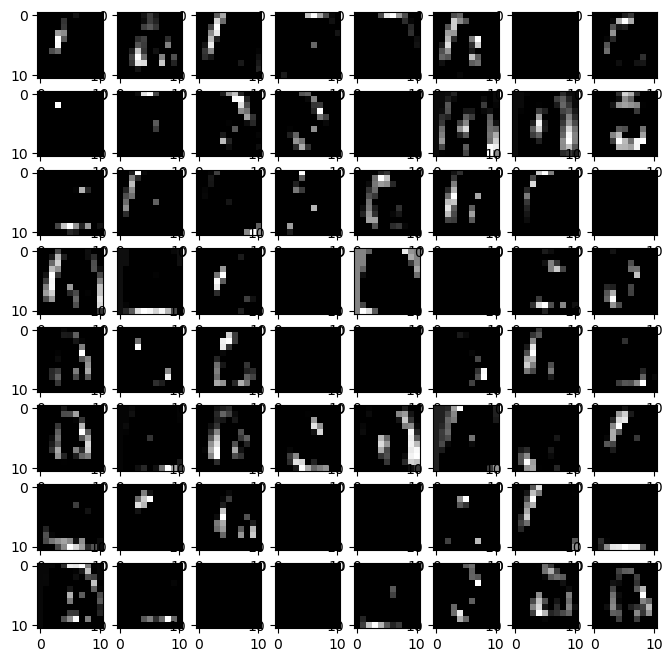

Feature maps of Pooling layer 2


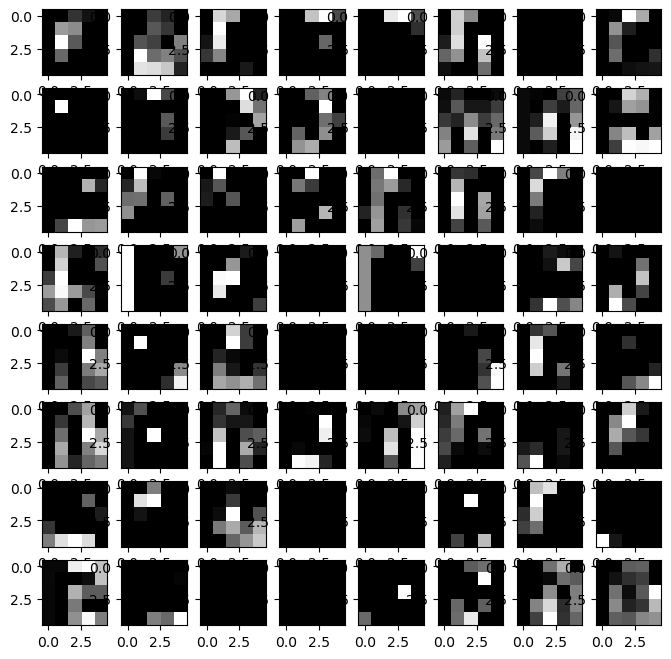

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
Original Image


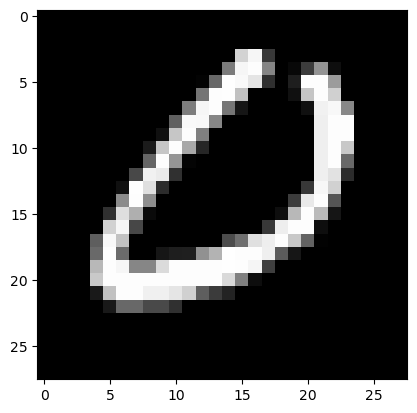

Feature maps of Convo layer 1


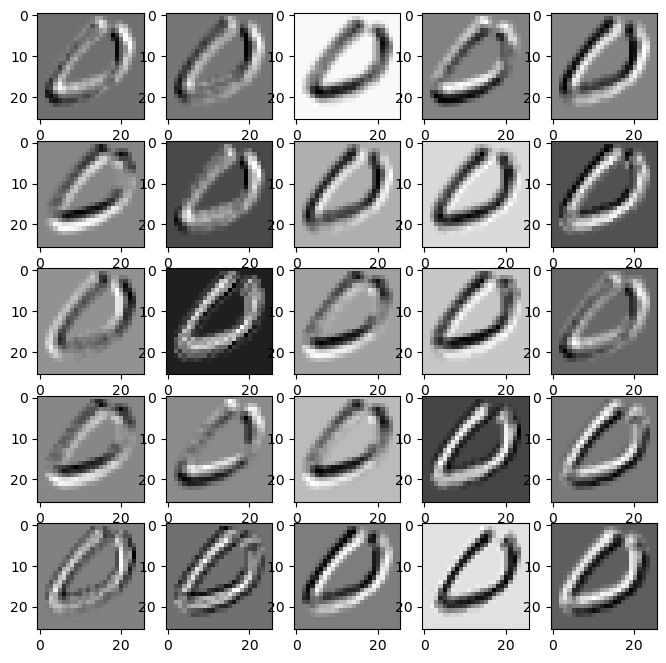

Feature maps of Activation layer 1


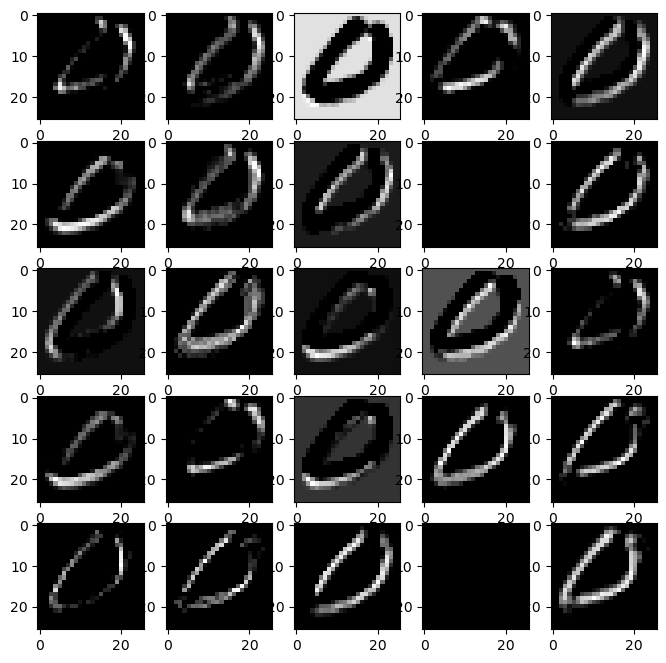

Feature maps of Pooling layer 1


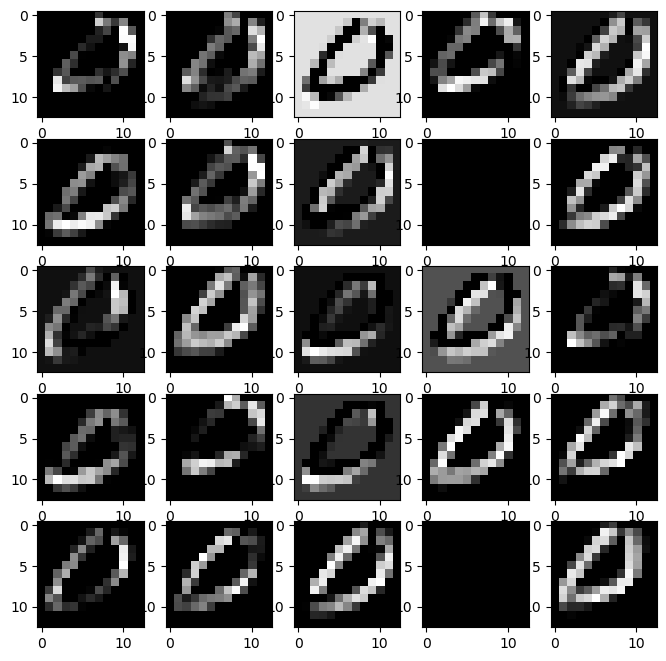

Feature maps of Convo layer 2


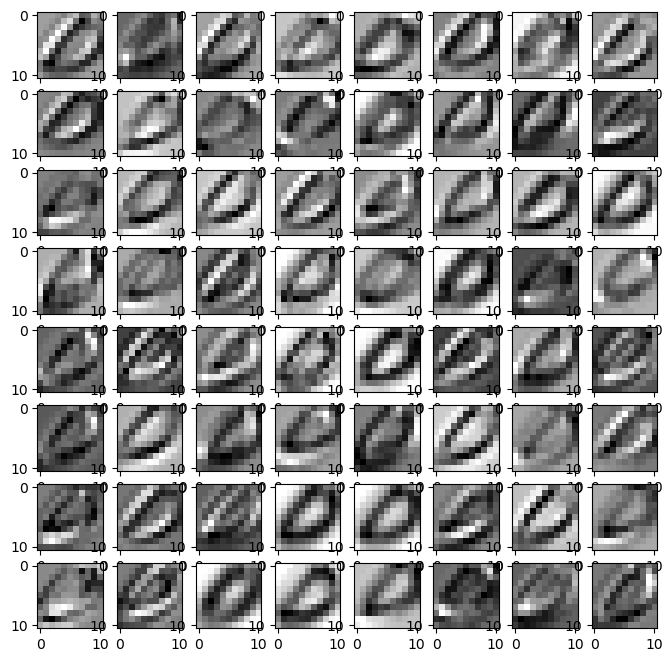

Feature maps of Activation layer 2


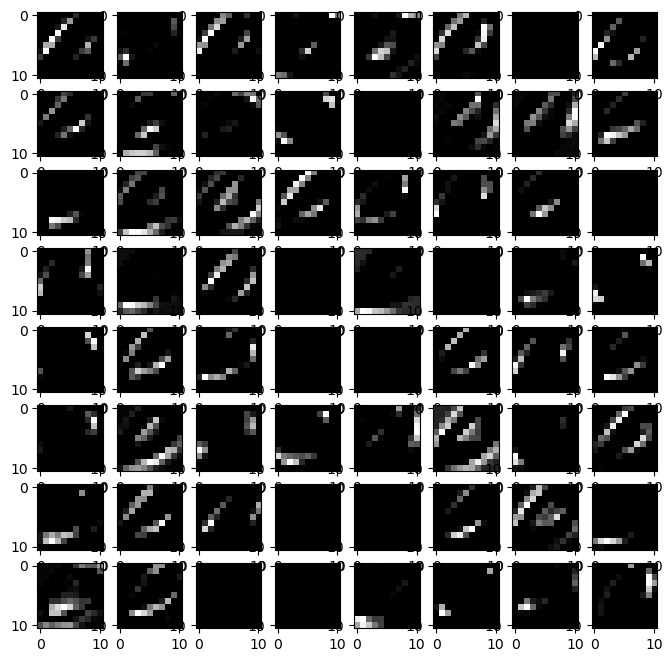

Feature maps of Pooling layer 2


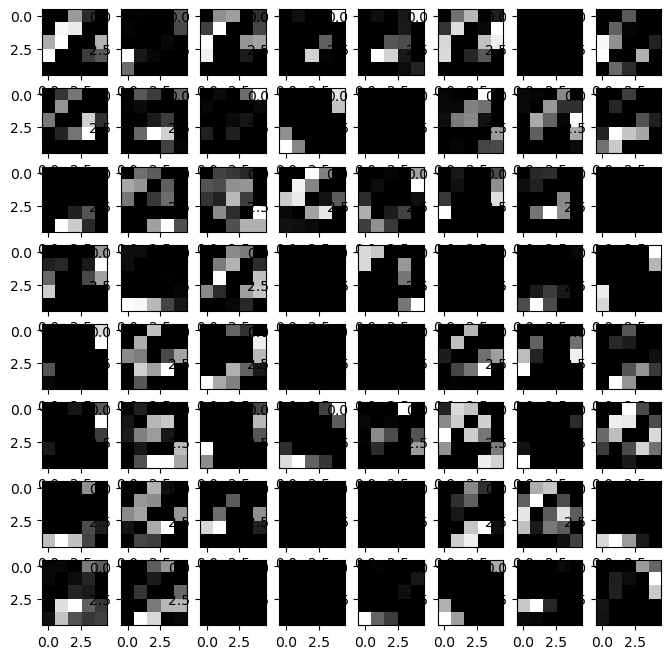

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


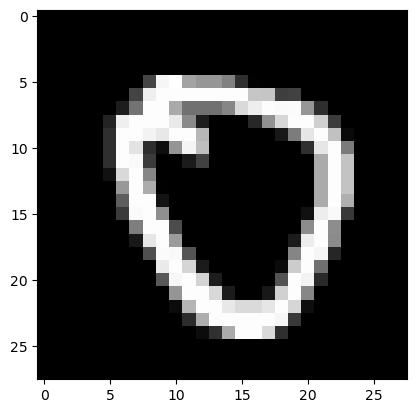

Feature maps of Convo layer 1


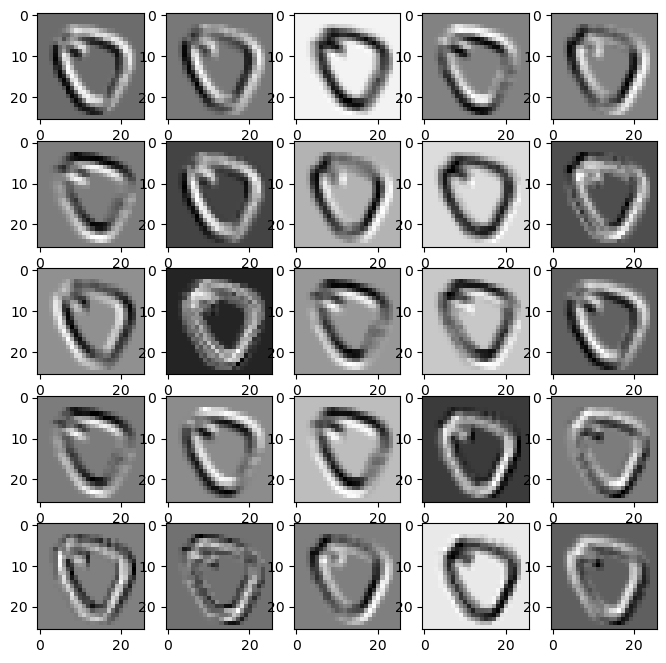

Feature maps of Activation layer 1


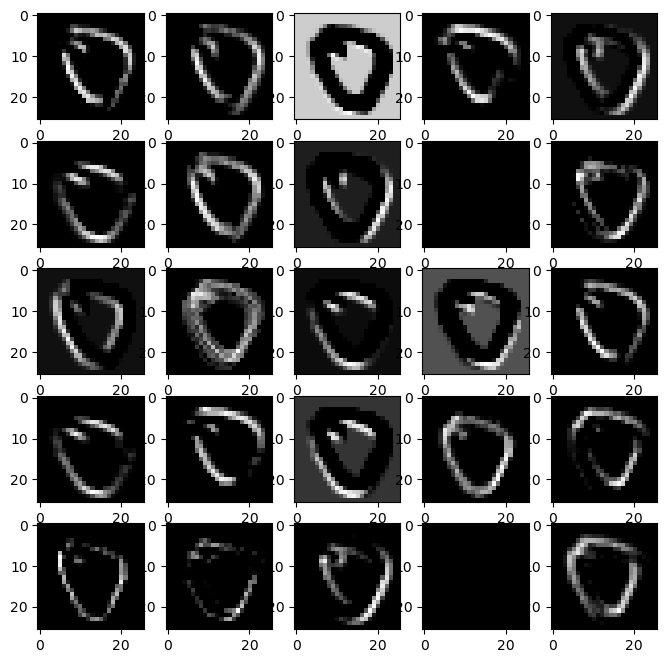

Feature maps of Pooling layer 1


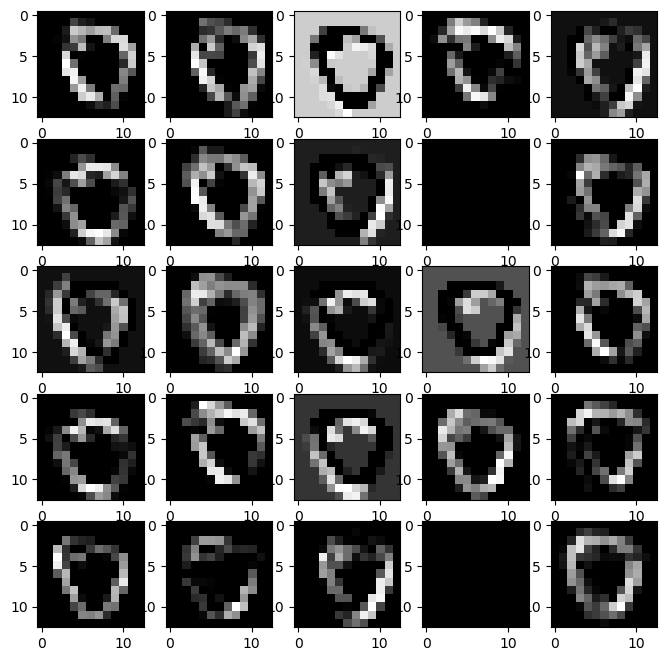

Feature maps of Convo layer 2


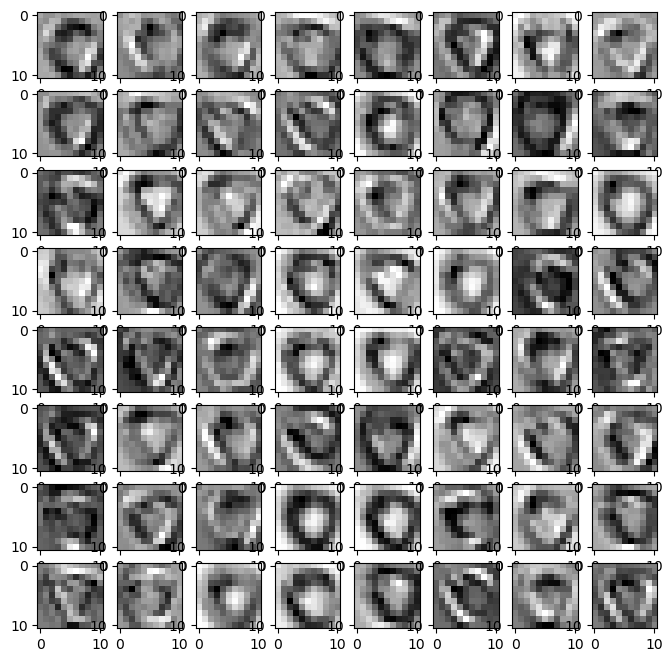

Feature maps of Activation layer 2


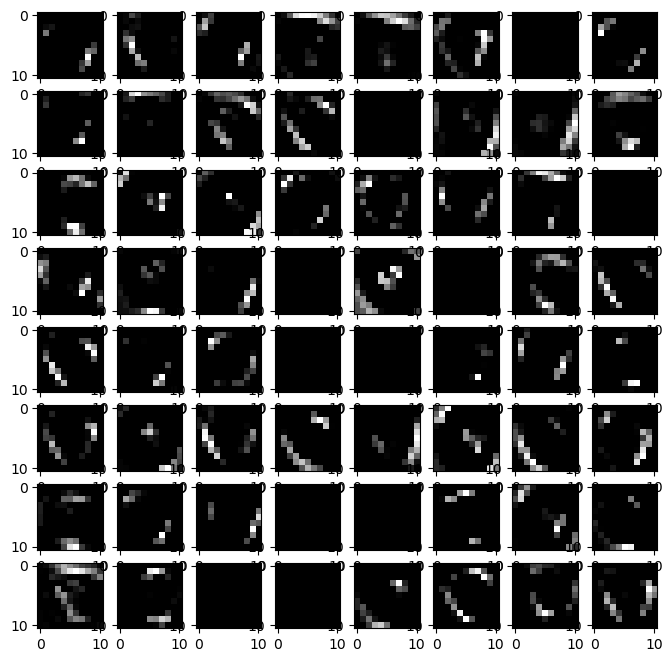

Feature maps of Pooling layer 2


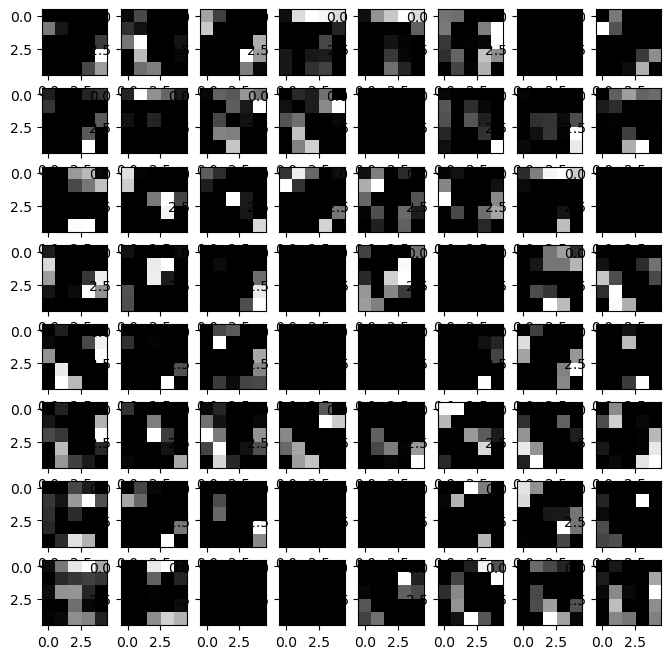

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


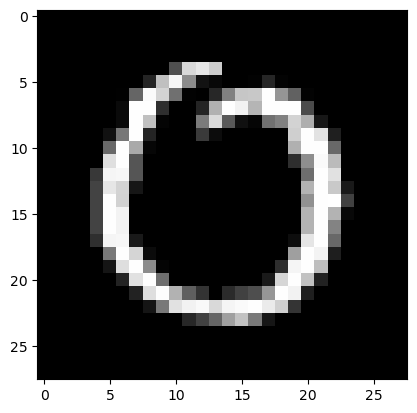

Feature maps of Convo layer 1


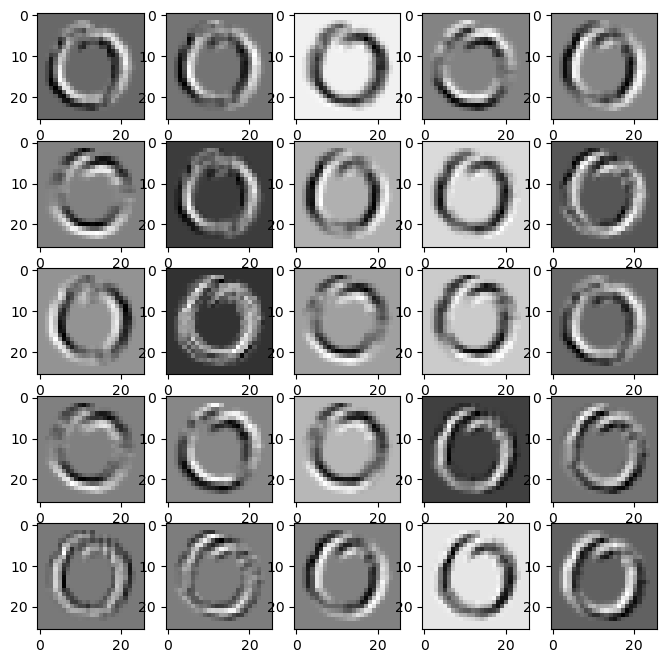

Feature maps of Activation layer 1


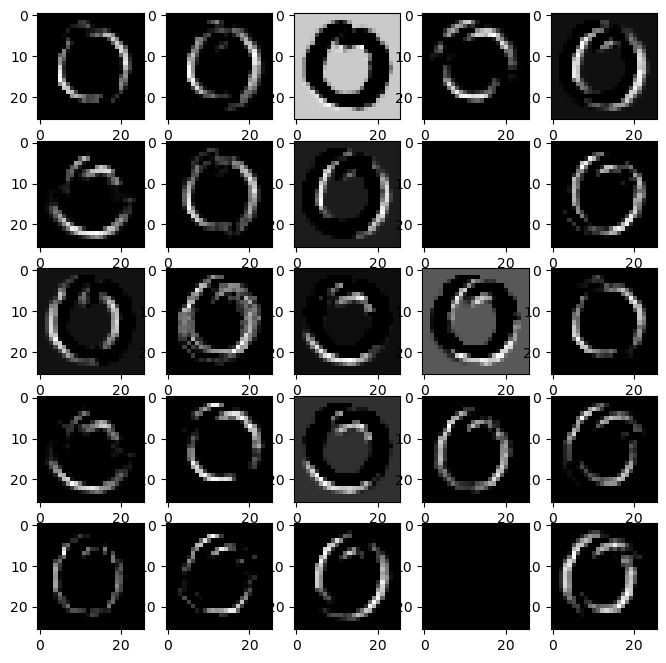

Feature maps of Pooling layer 1


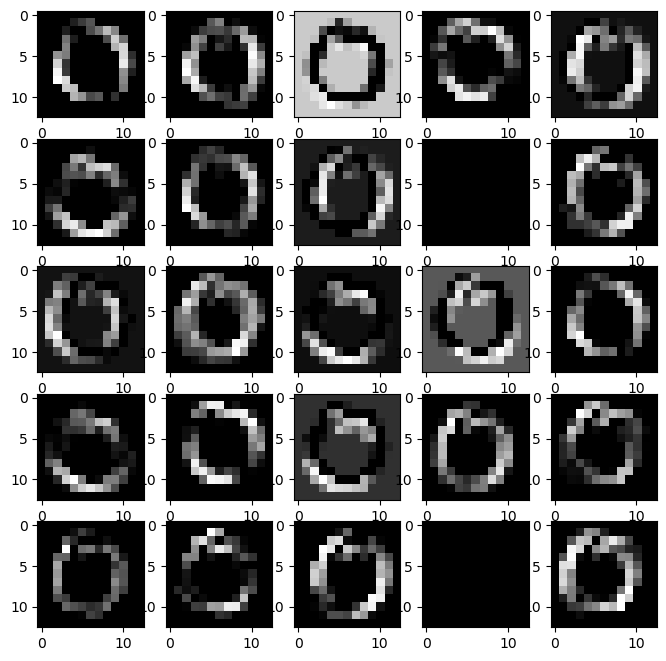

Feature maps of Convo layer 2


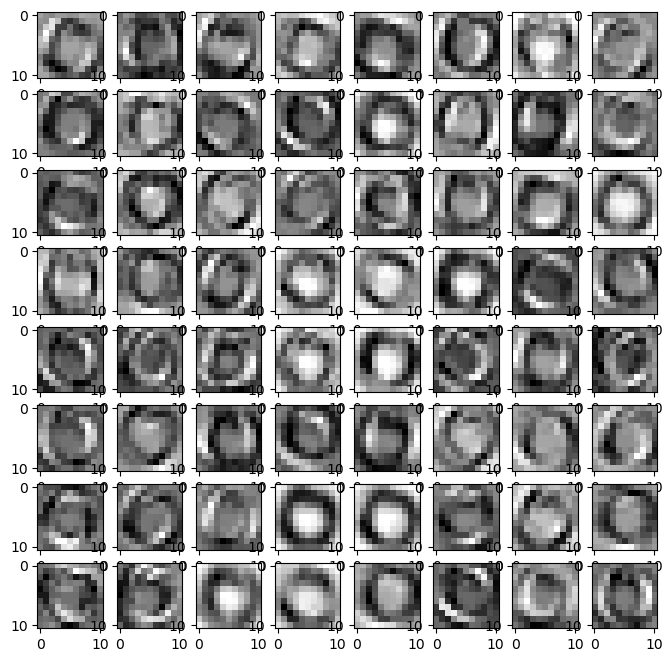

Feature maps of Activation layer 2


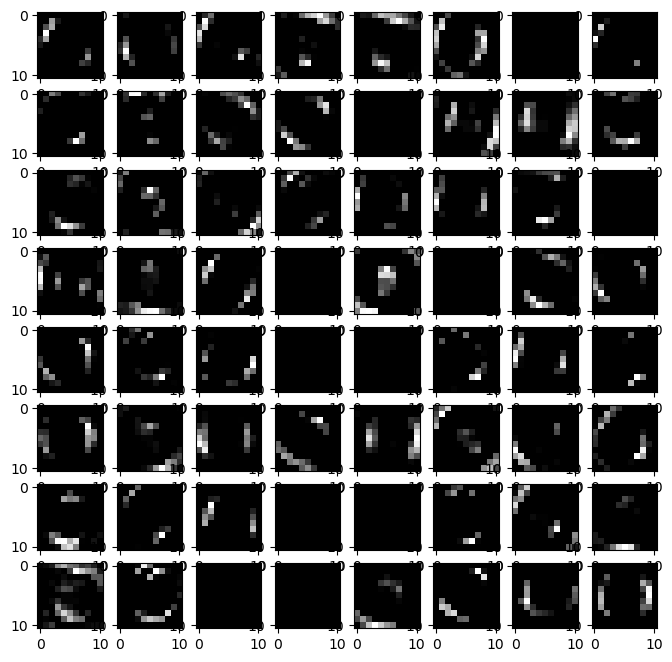

Feature maps of Pooling layer 2


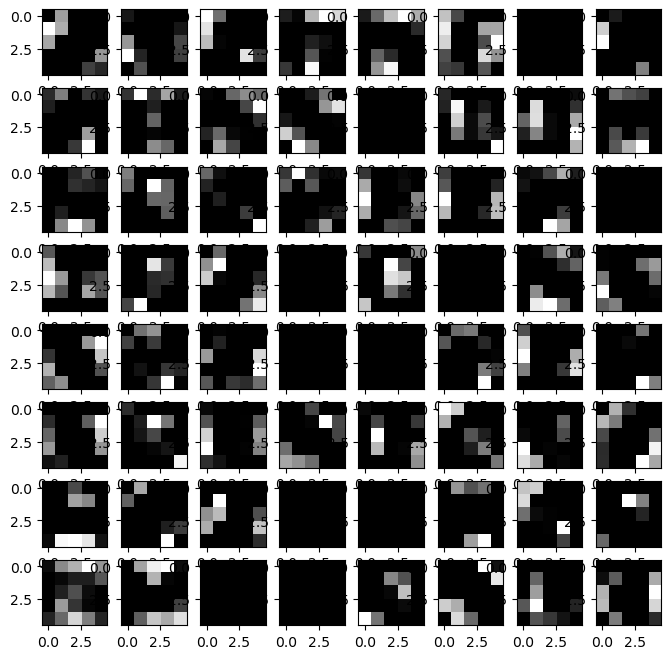

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Orig

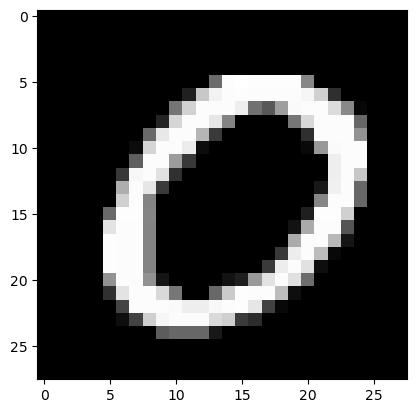

Feature maps of Convo layer 1


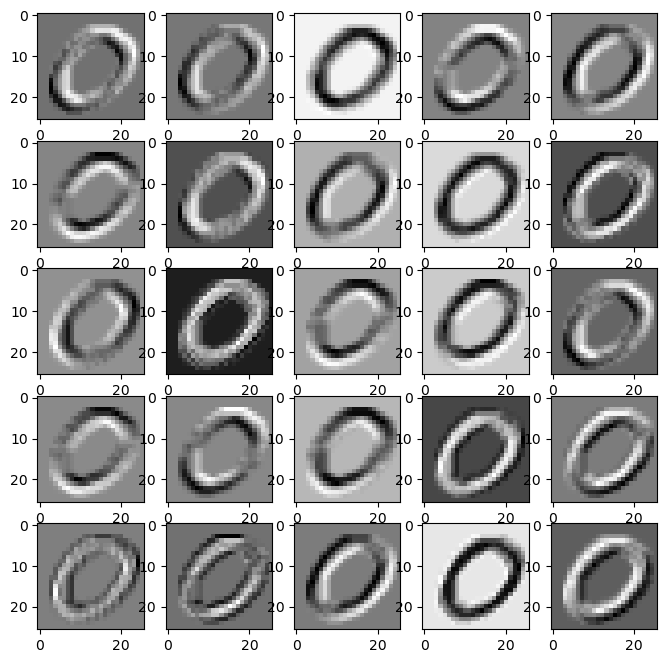

Feature maps of Activation layer 1


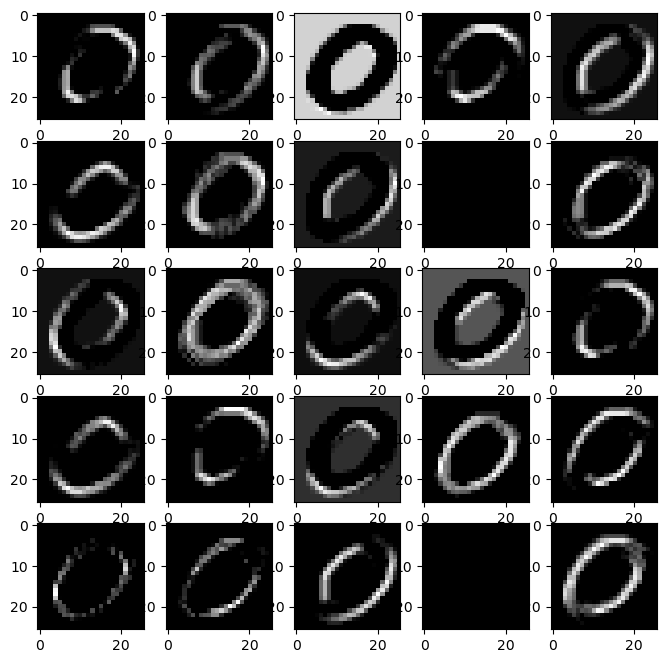

Feature maps of Pooling layer 1


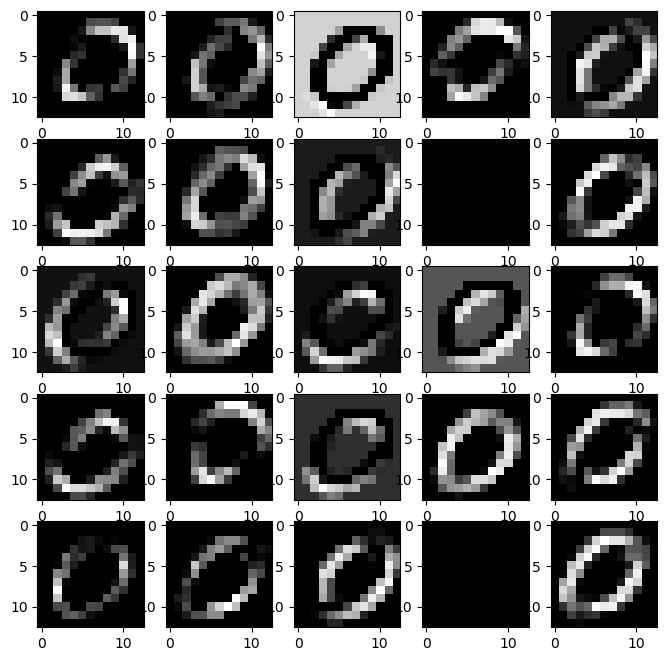

Feature maps of Convo layer 2


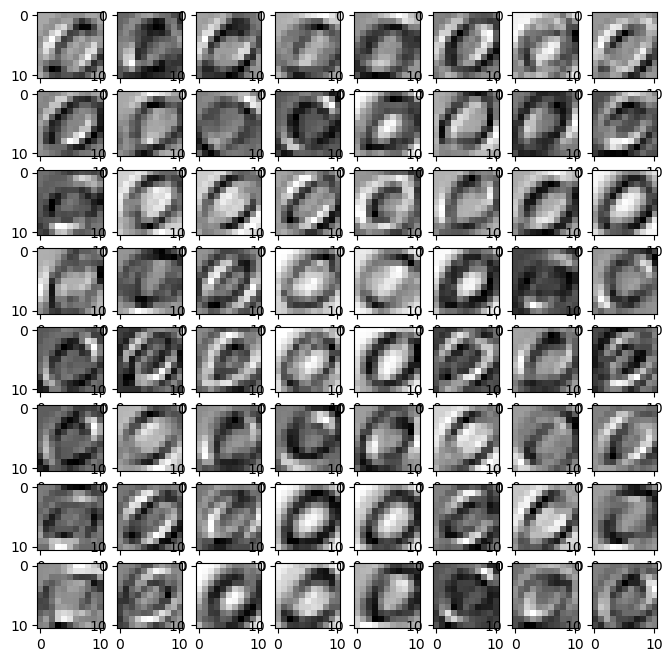

Feature maps of Activation layer 2


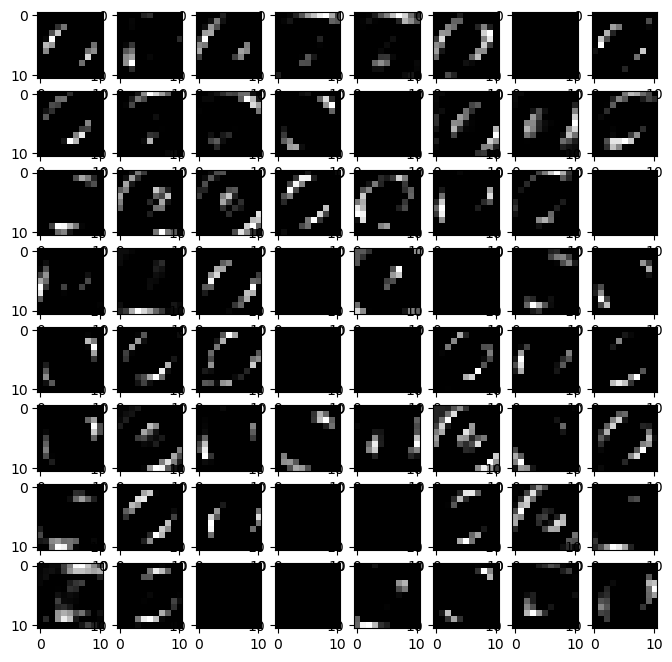

Feature maps of Pooling layer 2


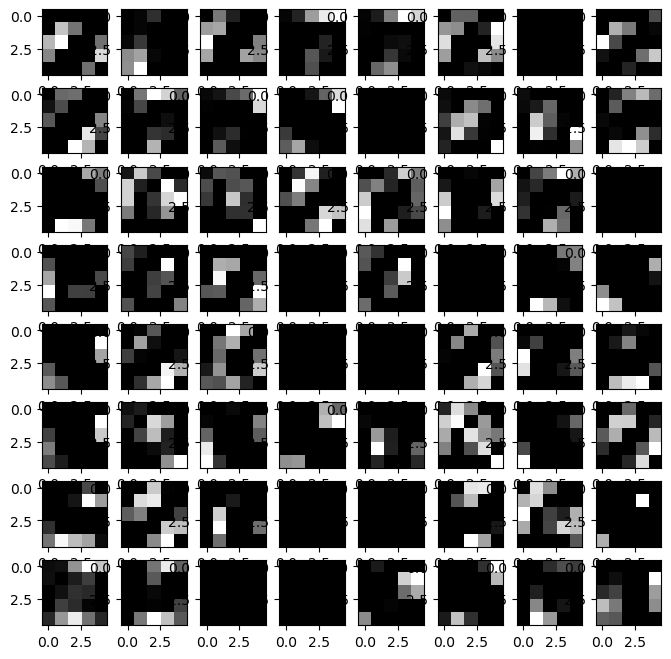

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


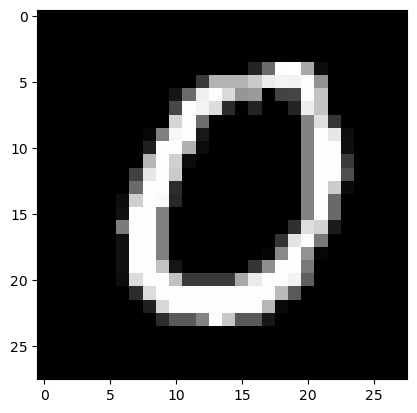

Feature maps of Convo layer 1


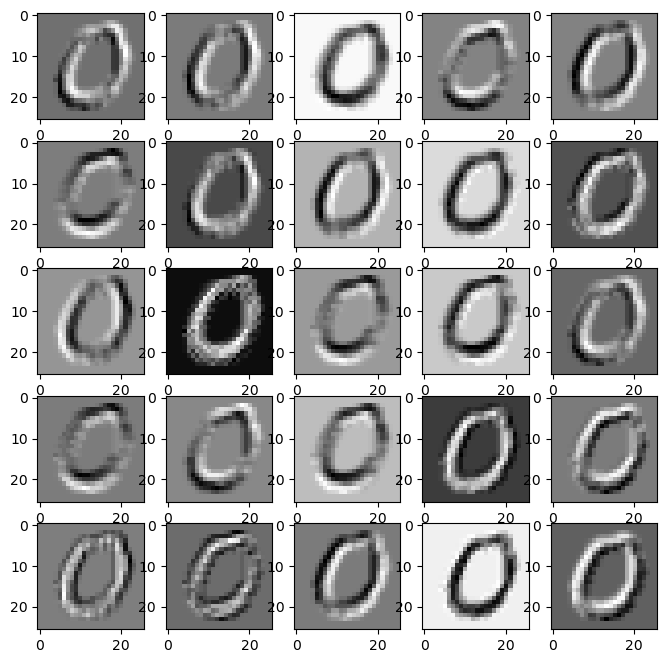

Feature maps of Activation layer 1


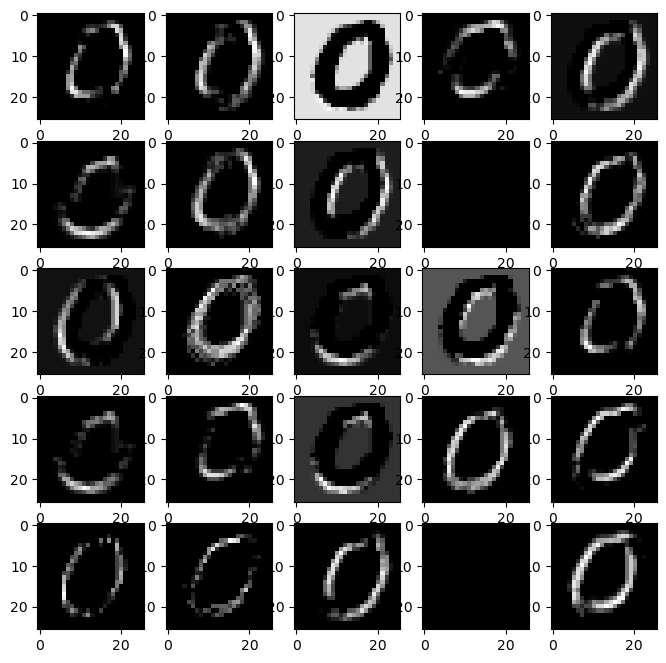

Feature maps of Pooling layer 1


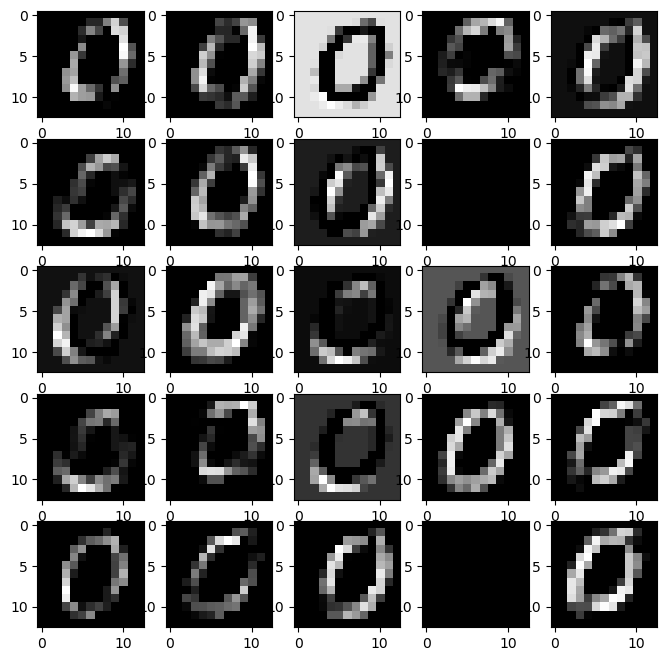

Feature maps of Convo layer 2


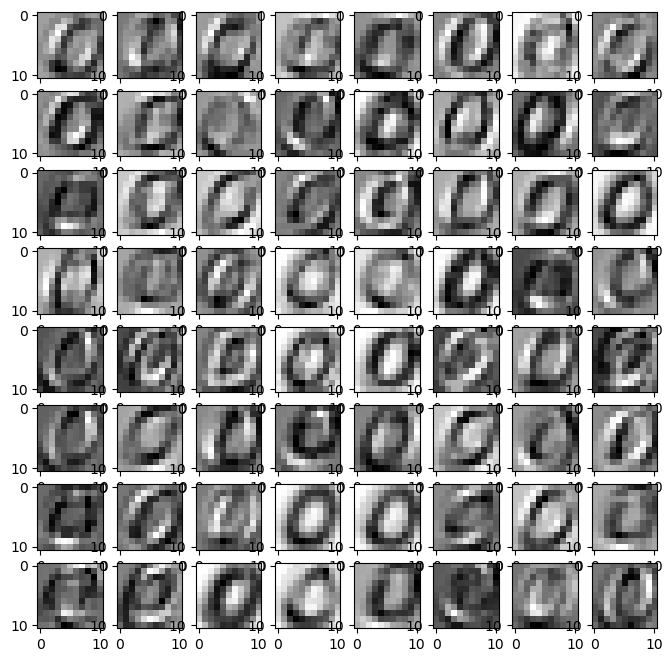

Feature maps of Activation layer 2


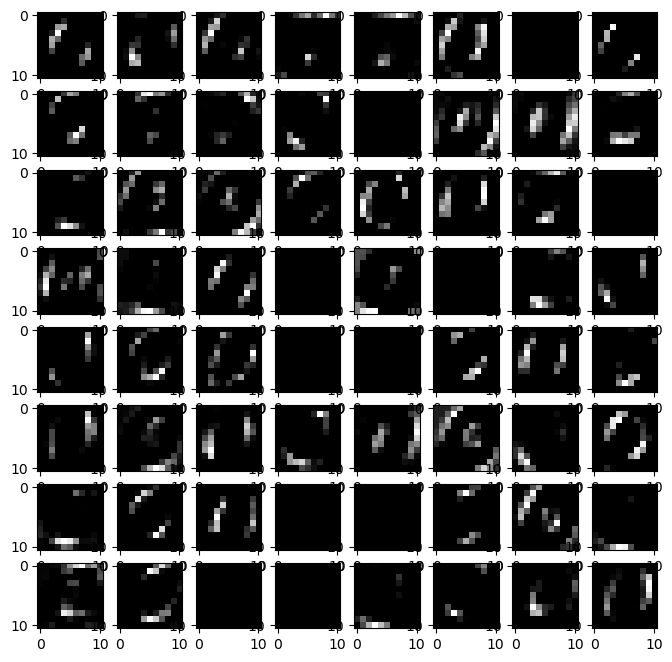

Feature maps of Pooling layer 2


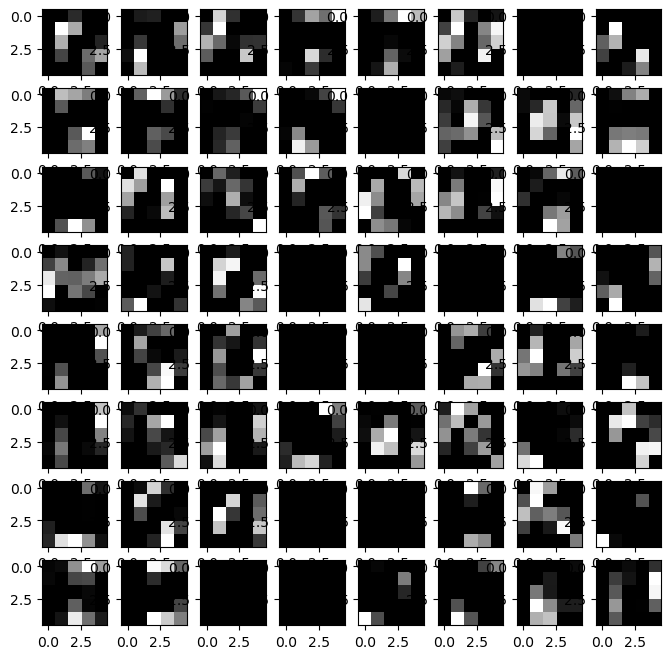

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


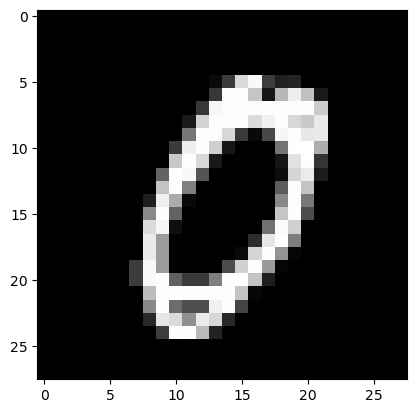

Feature maps of Convo layer 1


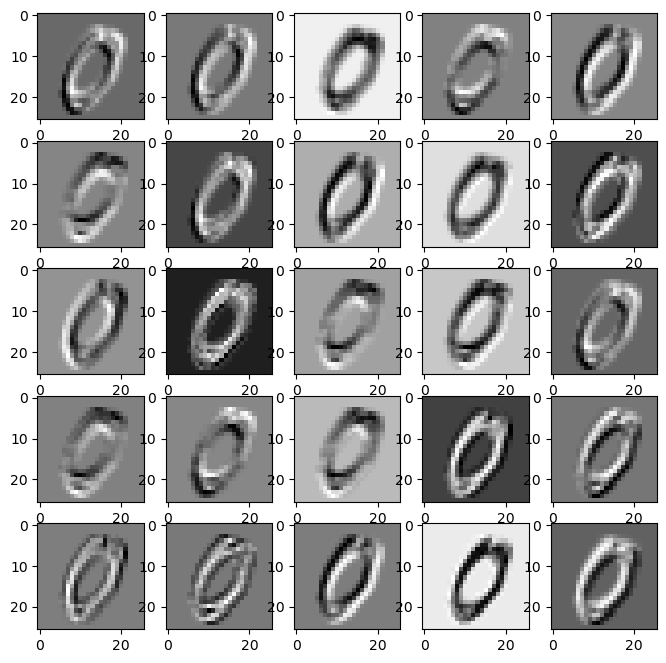

Feature maps of Activation layer 1


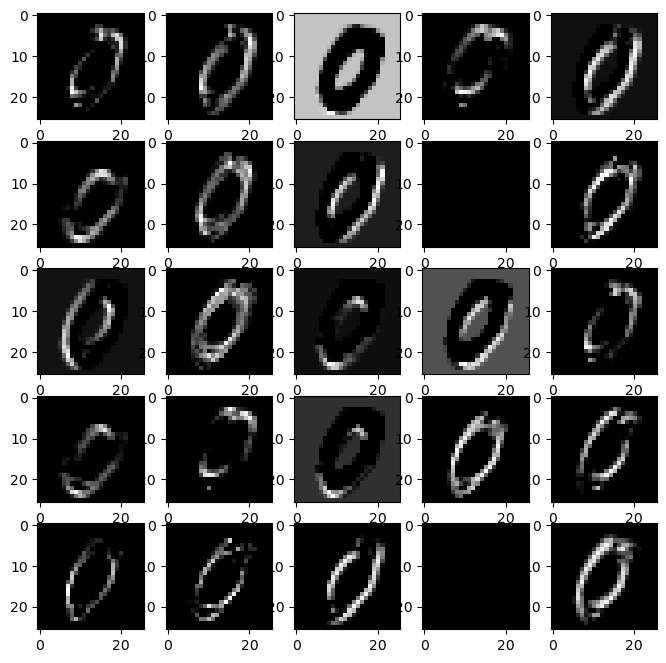

Feature maps of Pooling layer 1


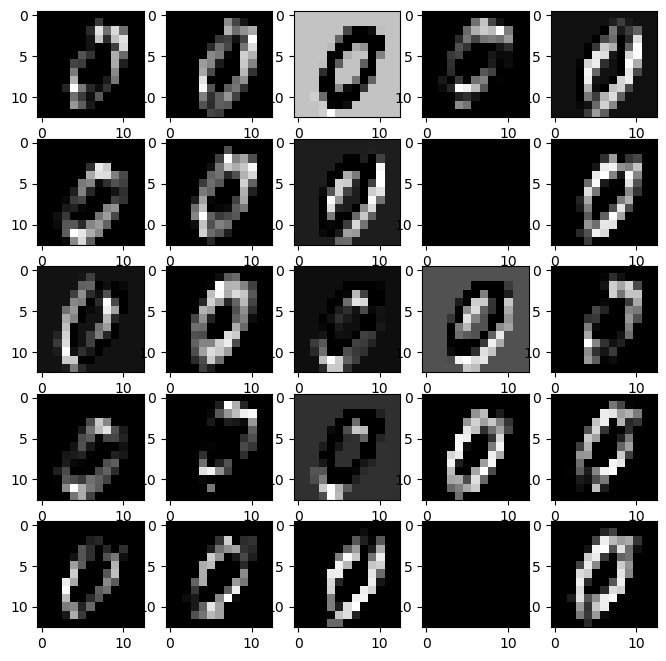

Feature maps of Convo layer 2


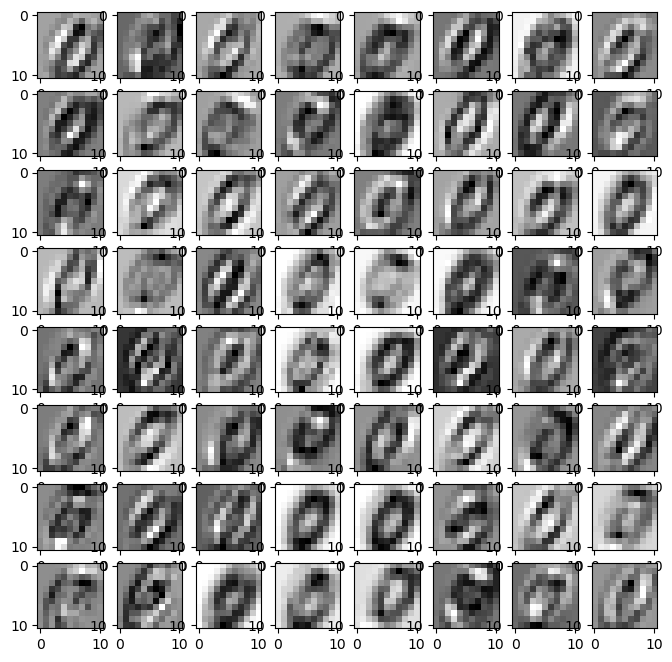

Feature maps of Activation layer 2


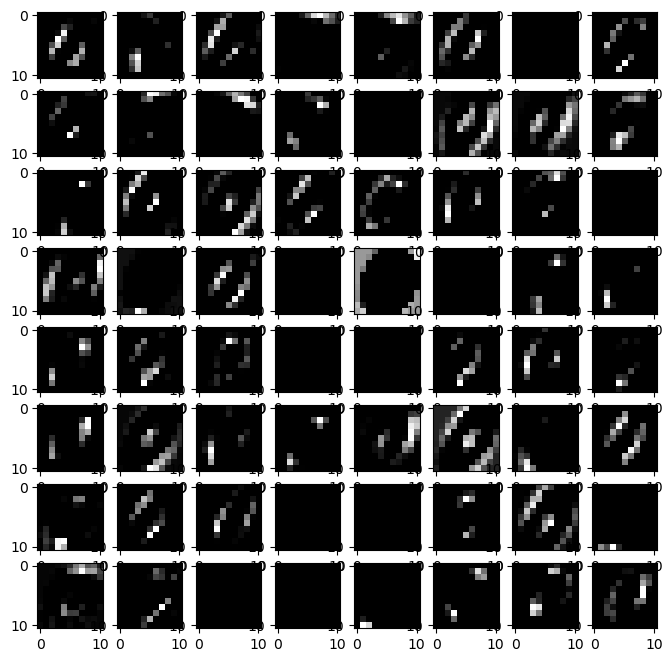

Feature maps of Pooling layer 2


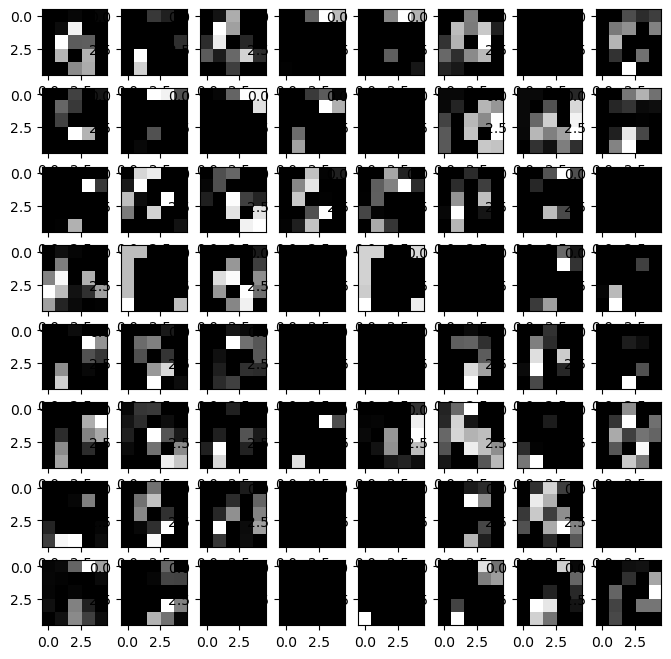

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


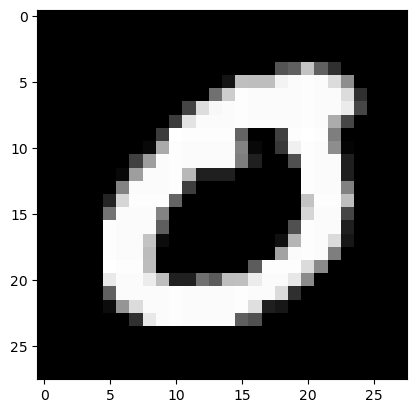

Feature maps of Convo layer 1


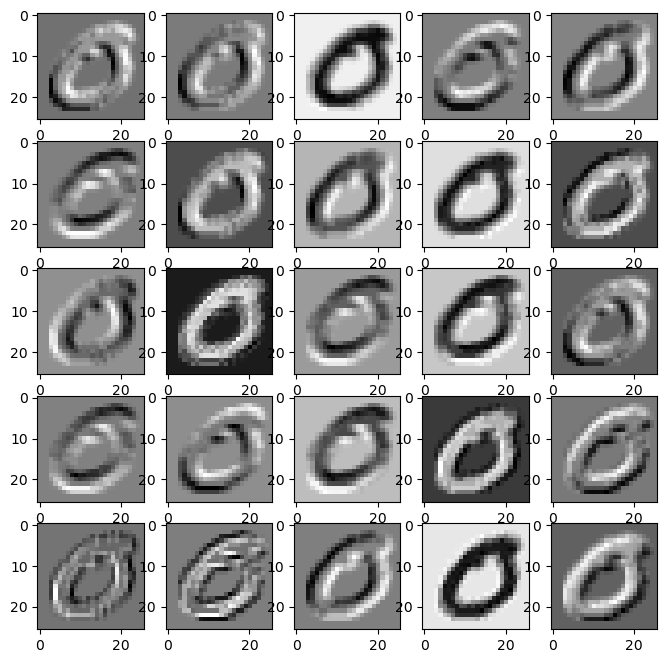

Feature maps of Activation layer 1


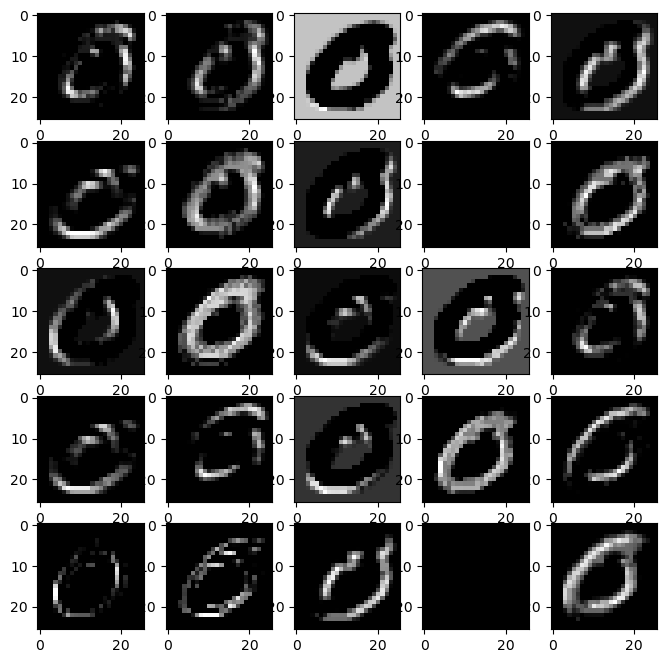

Feature maps of Pooling layer 1


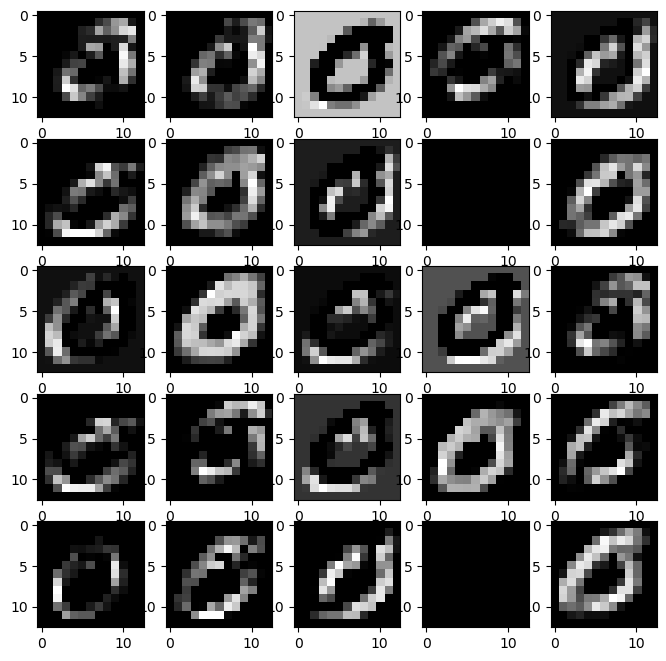

Feature maps of Convo layer 2


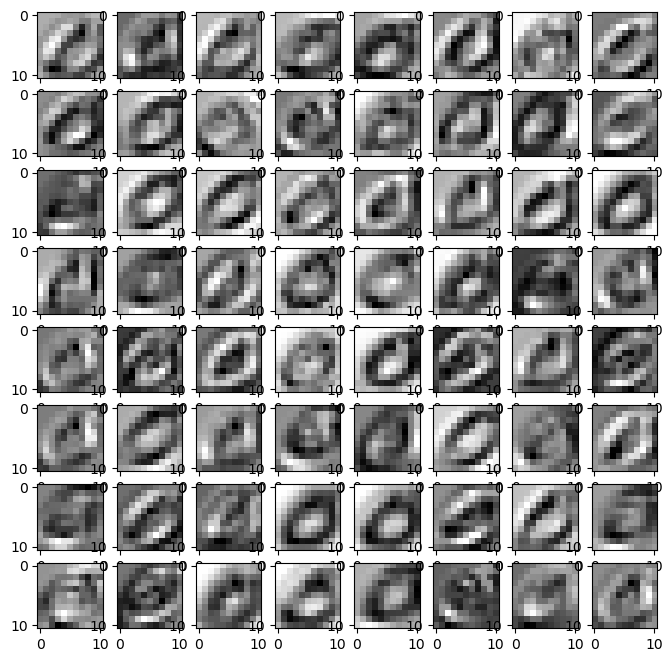

Feature maps of Activation layer 2


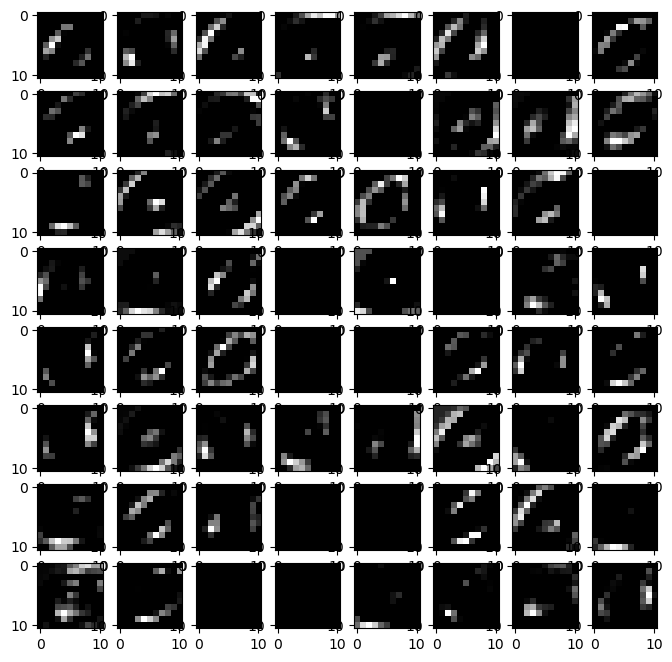

Feature maps of Pooling layer 2


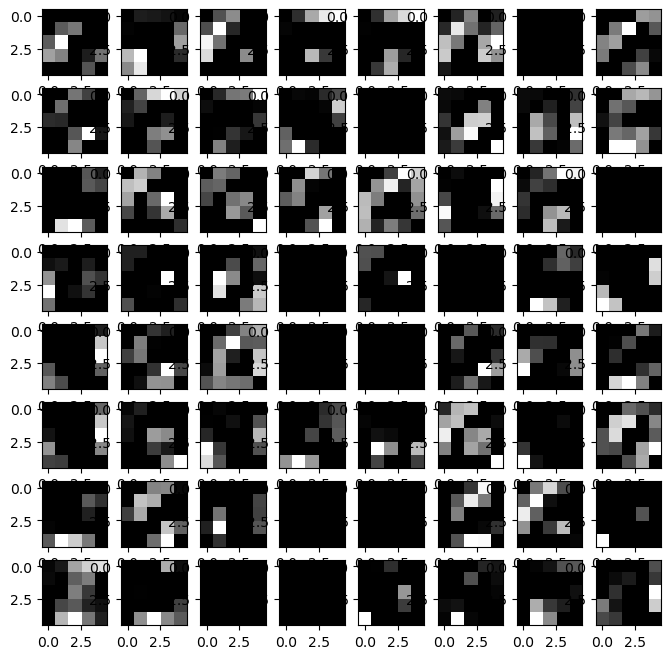

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


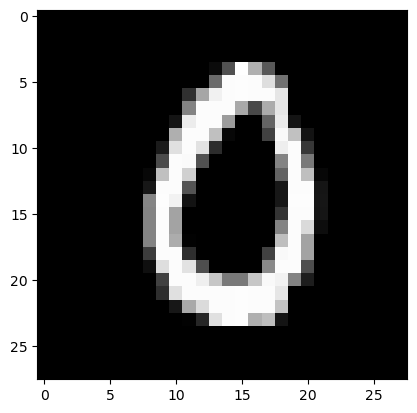

Feature maps of Convo layer 1


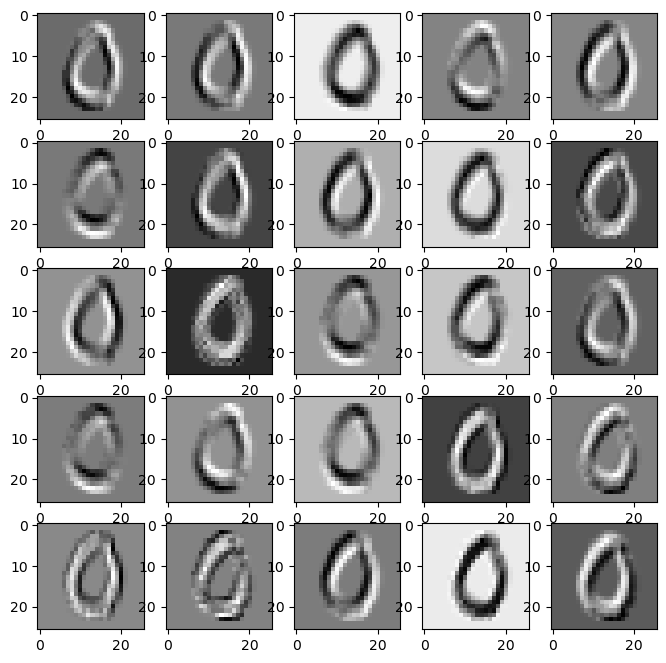

Feature maps of Activation layer 1


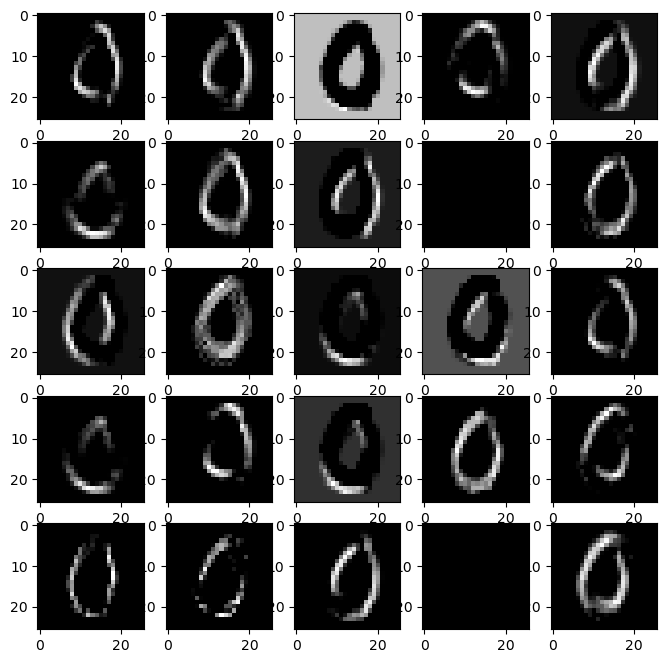

Feature maps of Pooling layer 1


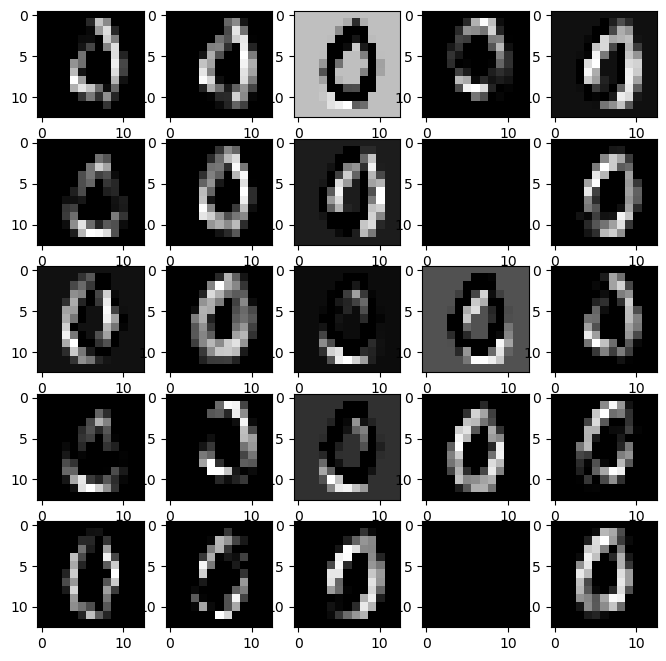

Feature maps of Convo layer 2


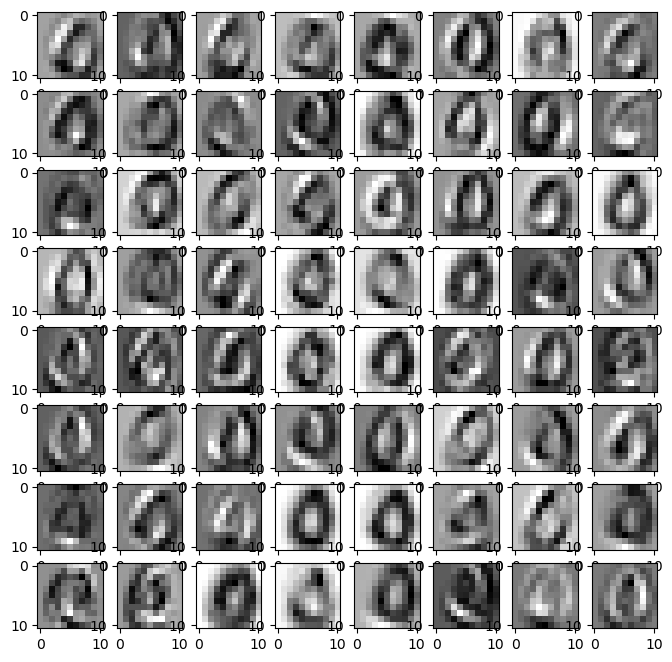

Feature maps of Activation layer 2


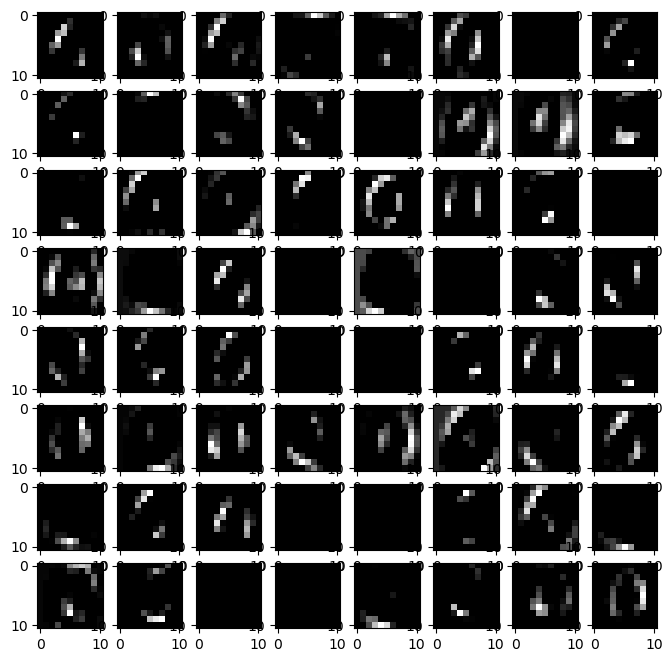

Feature maps of Pooling layer 2


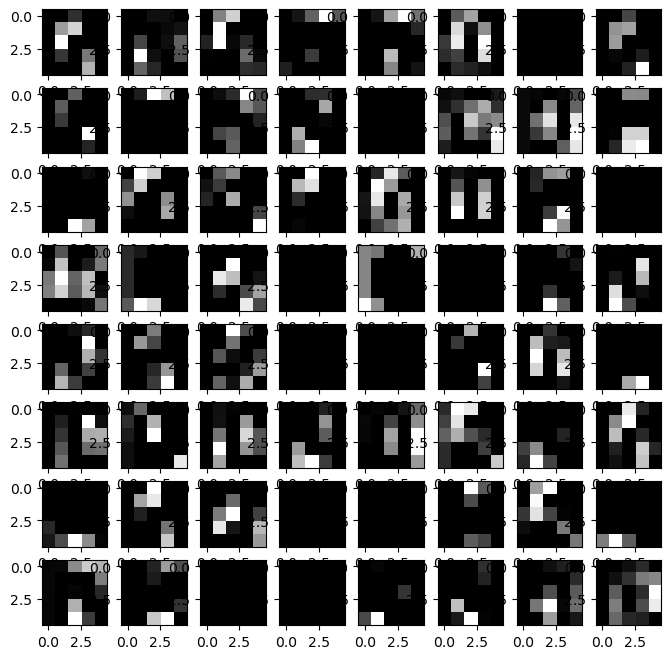

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


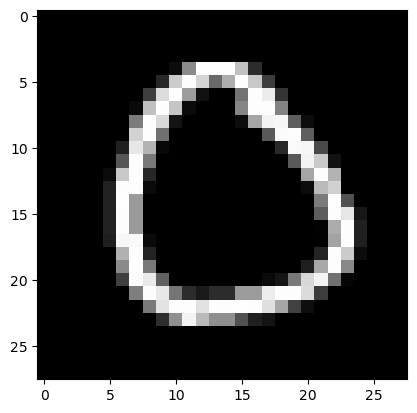

Feature maps of Convo layer 1


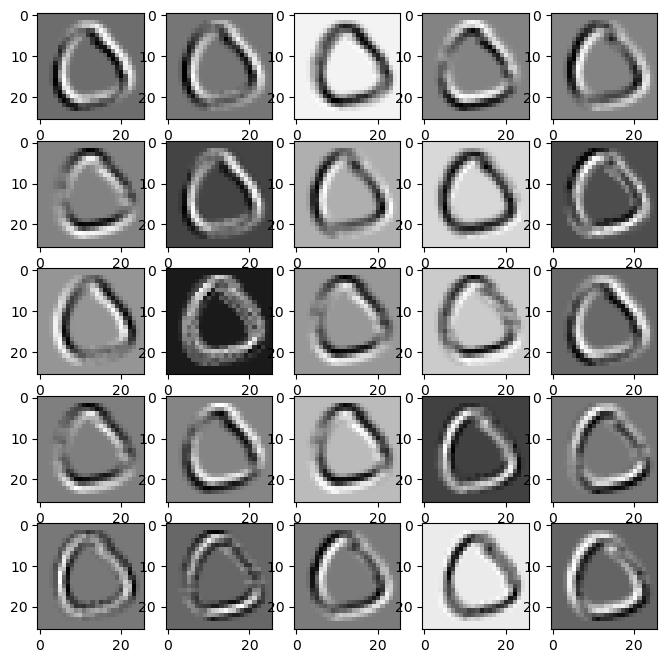

Feature maps of Activation layer 1


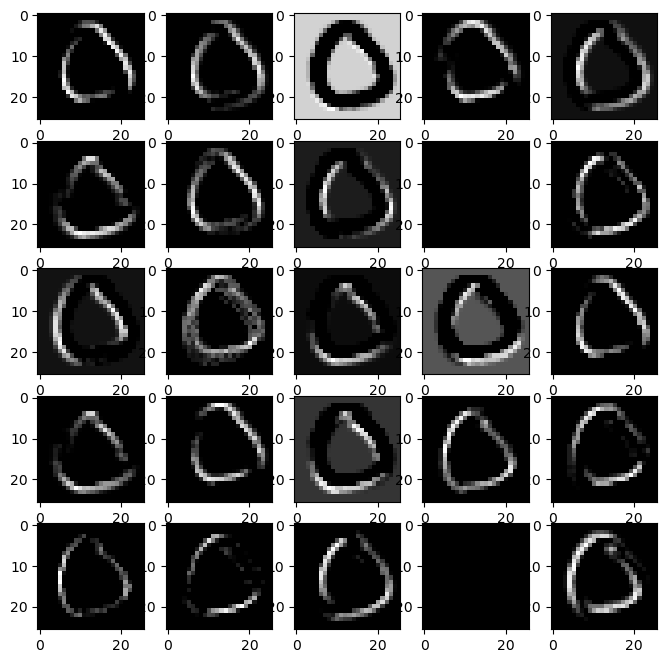

Feature maps of Pooling layer 1


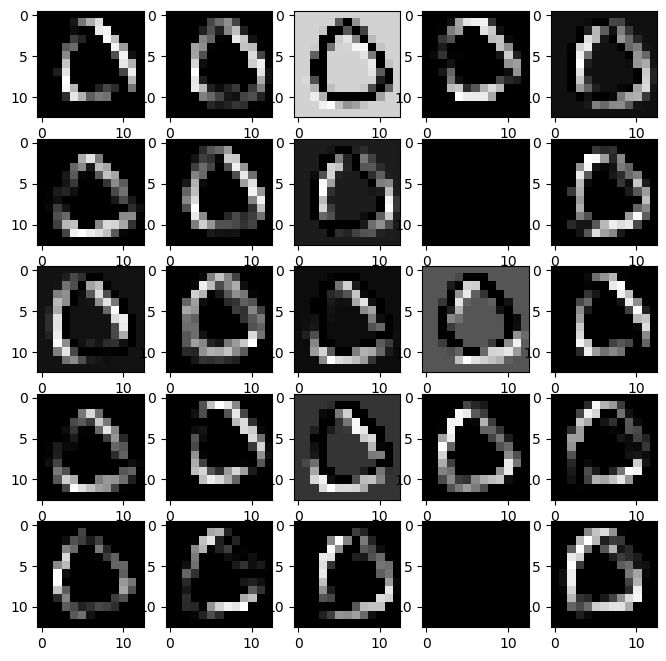

Feature maps of Convo layer 2


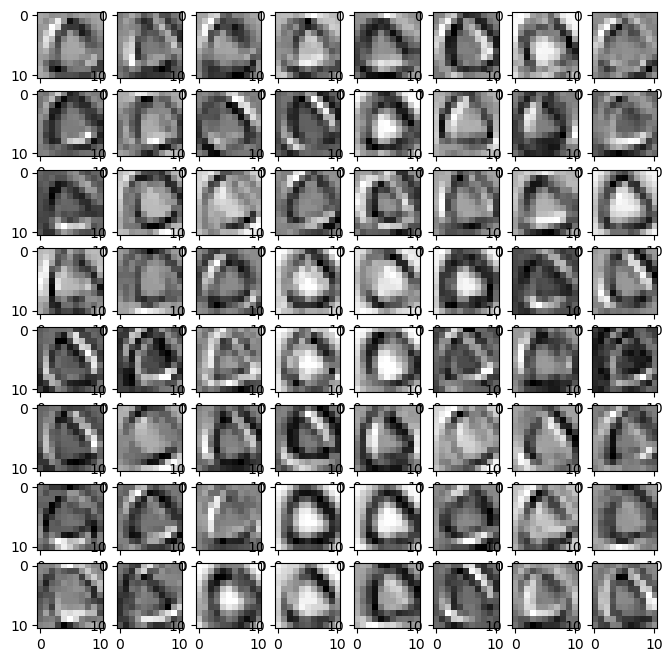

Feature maps of Activation layer 2


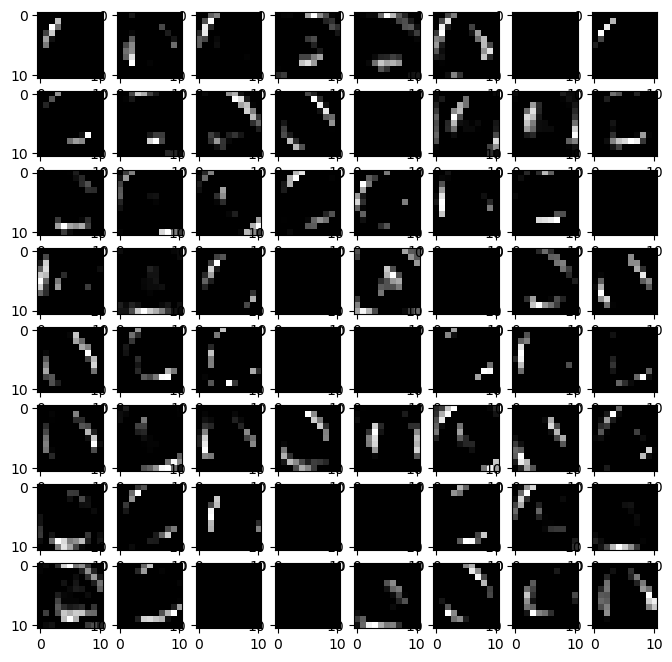

Feature maps of Pooling layer 2


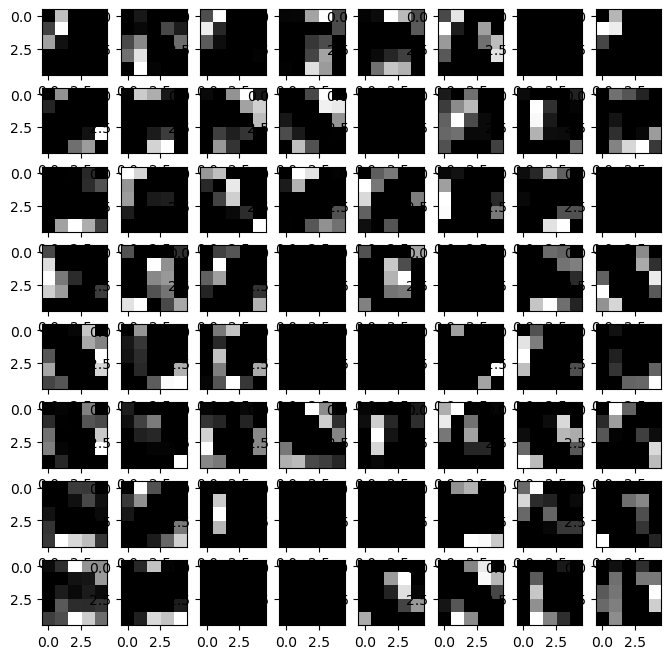

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


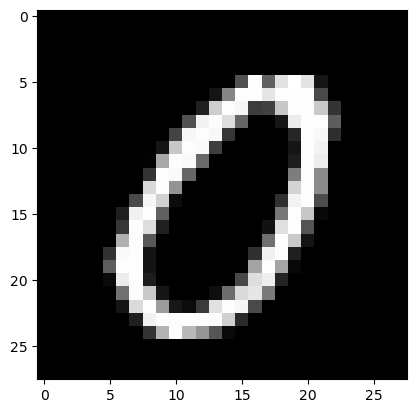

Feature maps of Convo layer 1


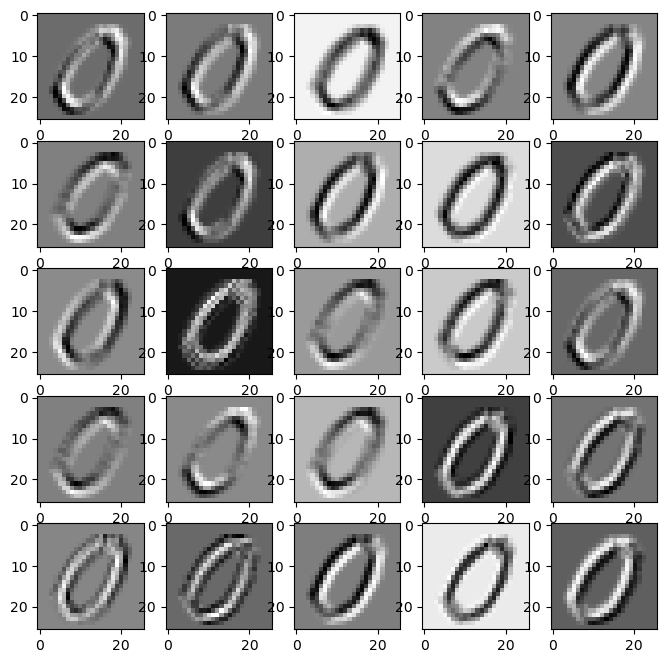

Feature maps of Activation layer 1


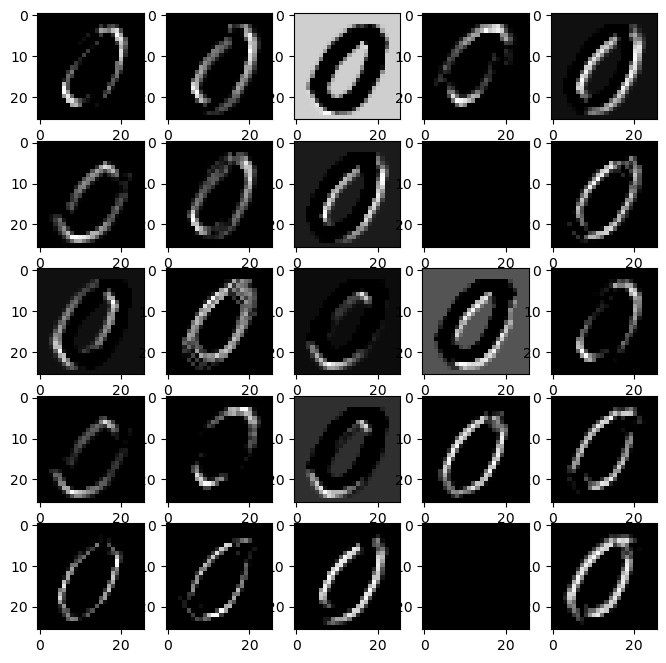

Feature maps of Pooling layer 1


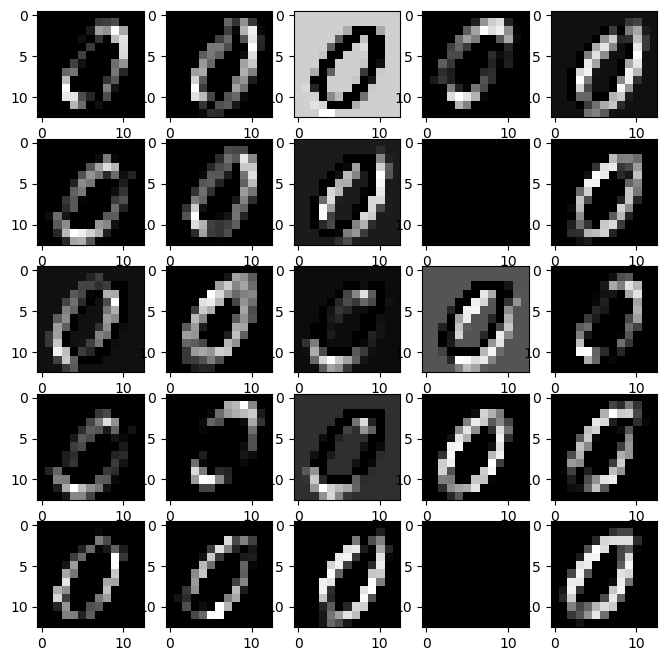

Feature maps of Convo layer 2


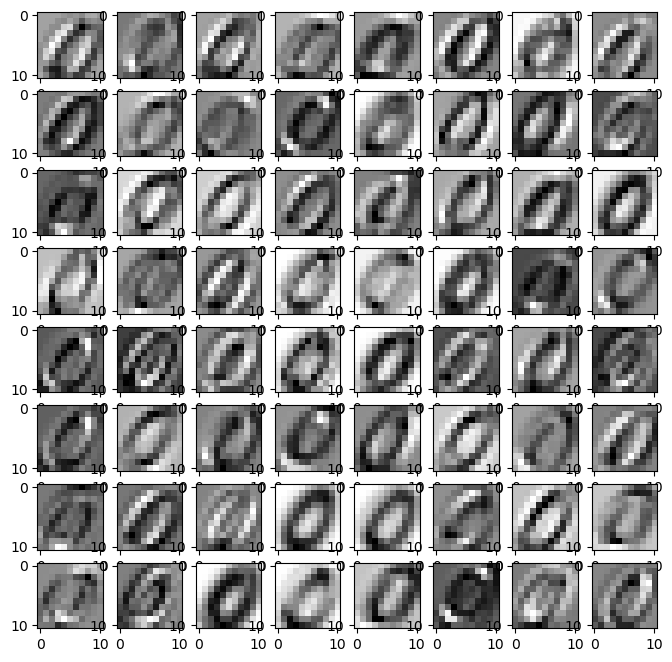

Feature maps of Activation layer 2


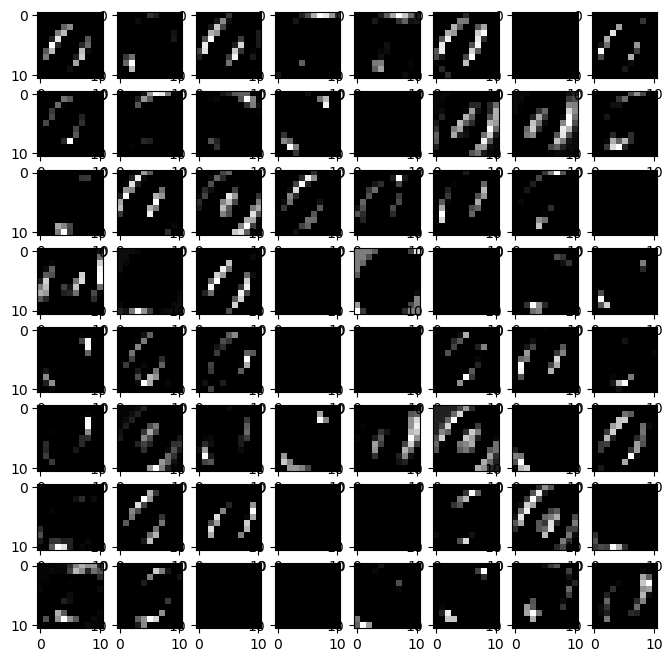

Feature maps of Pooling layer 2


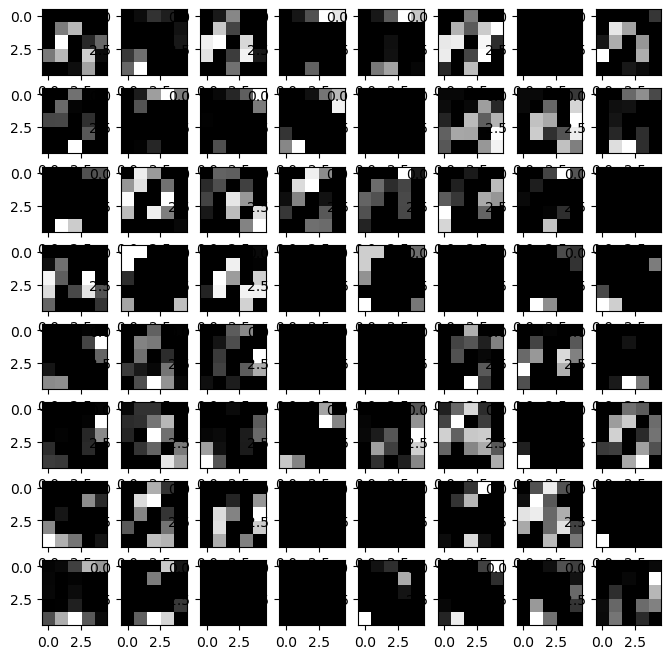

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


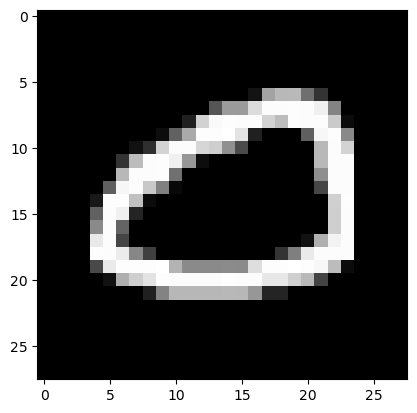

Feature maps of Convo layer 1


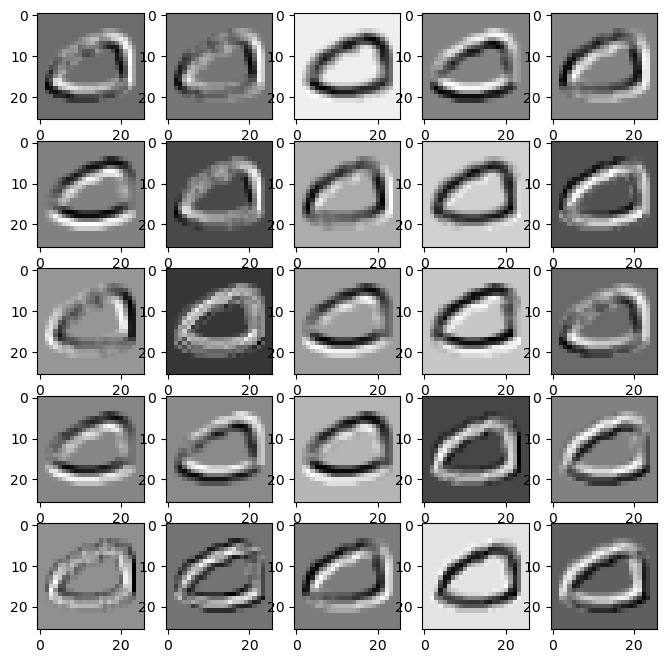

Feature maps of Activation layer 1


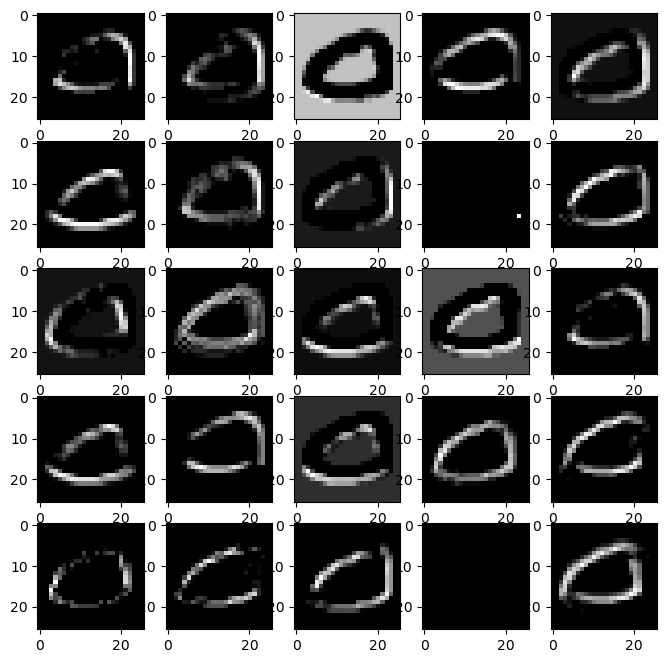

Feature maps of Pooling layer 1


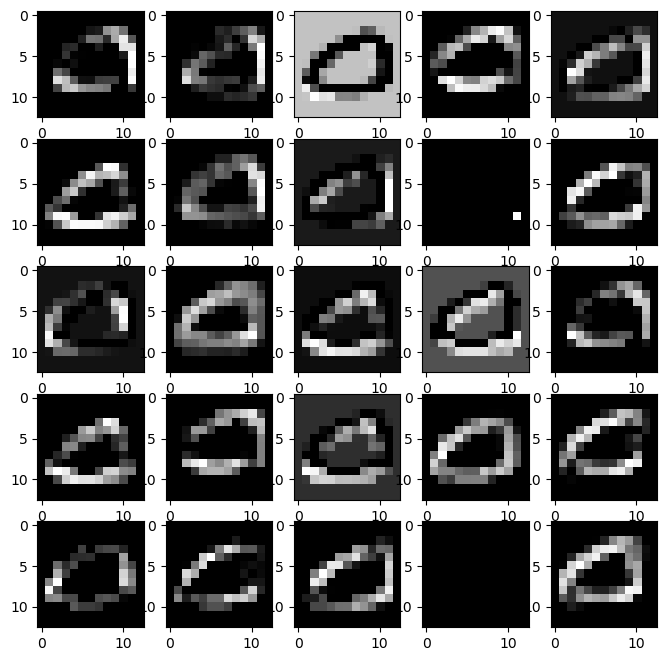

Feature maps of Convo layer 2


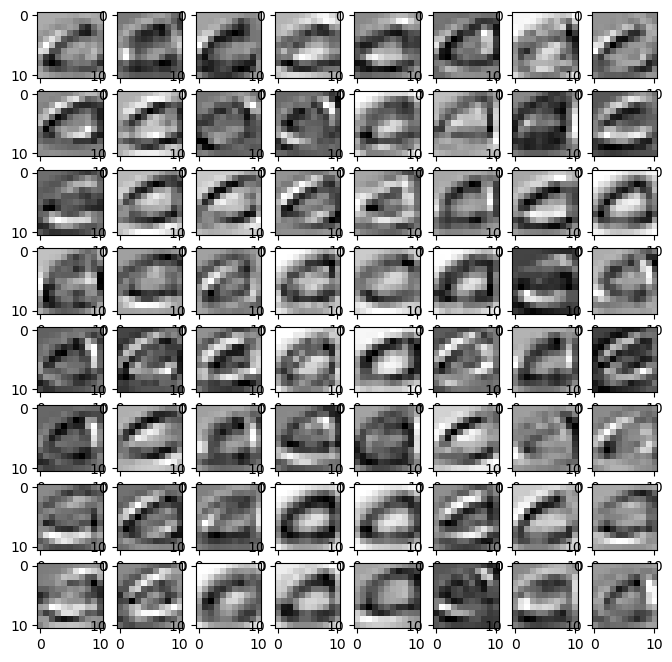

Feature maps of Activation layer 2


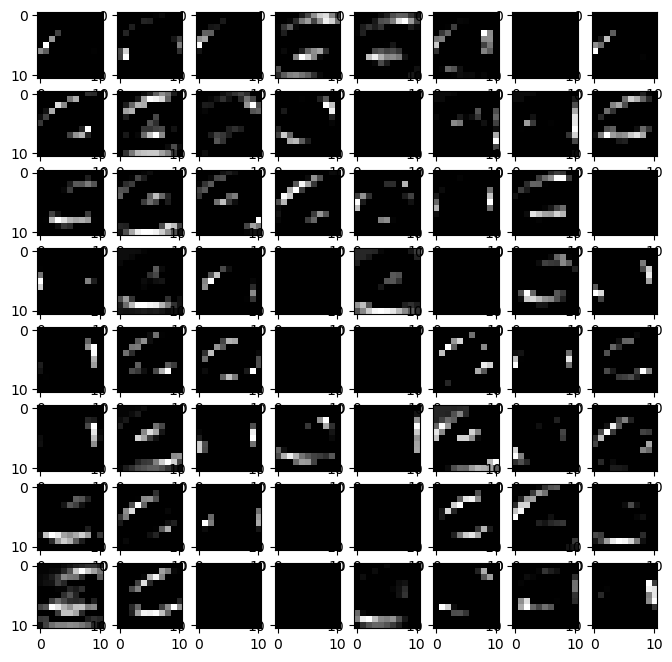

Feature maps of Pooling layer 2


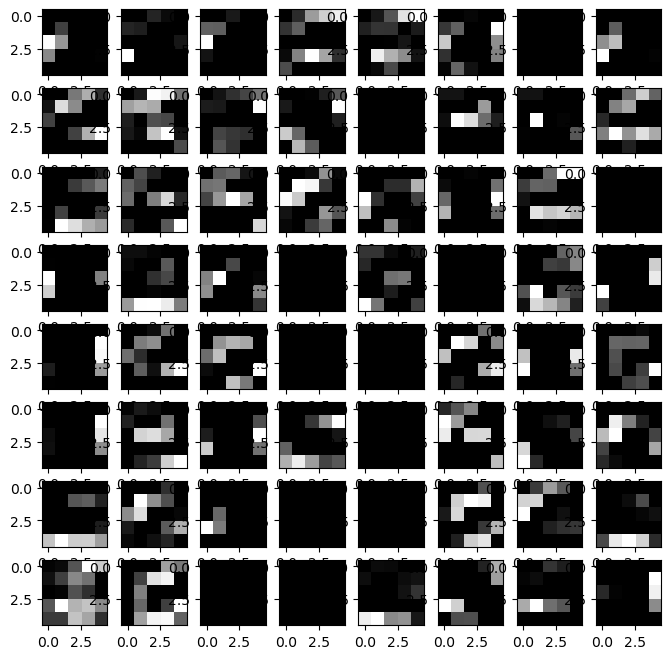

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


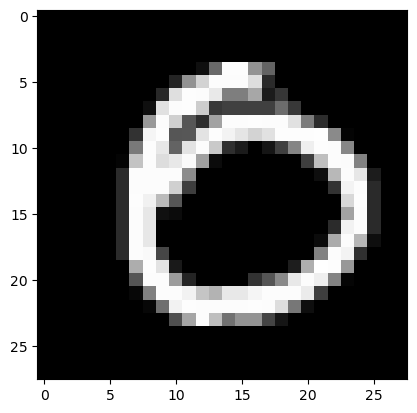

Feature maps of Convo layer 1


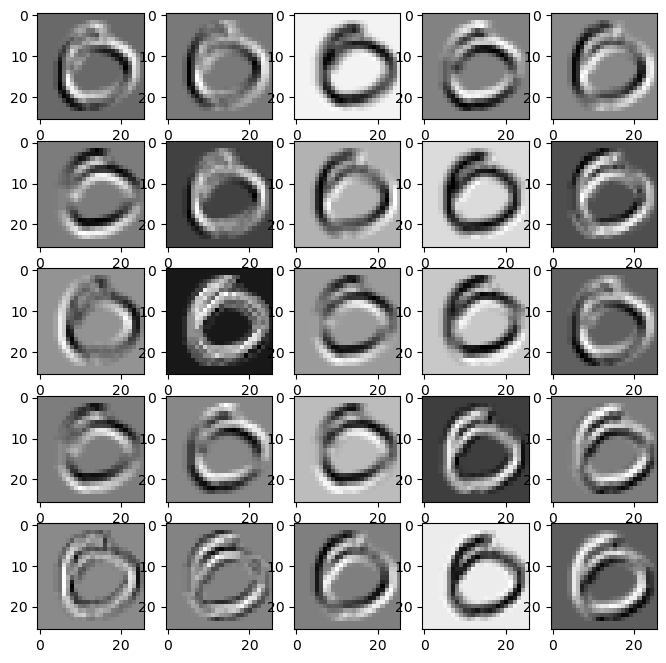

Feature maps of Activation layer 1


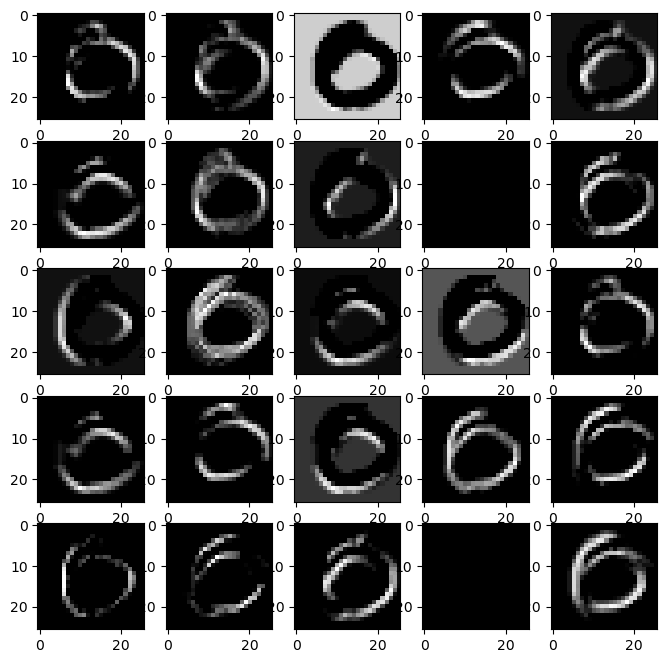

Feature maps of Pooling layer 1


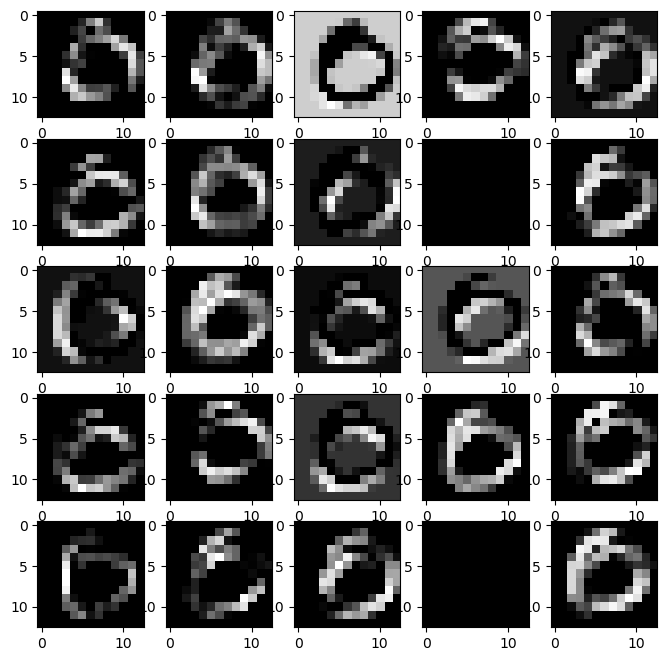

Feature maps of Convo layer 2


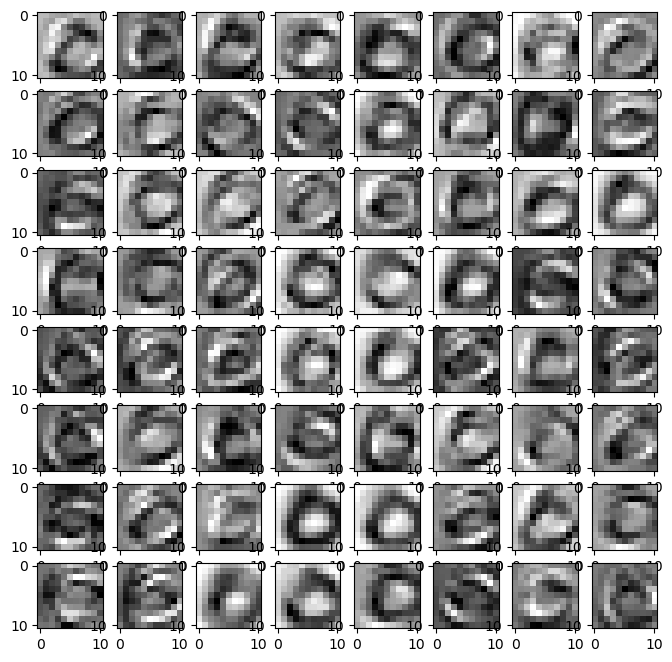

Feature maps of Activation layer 2


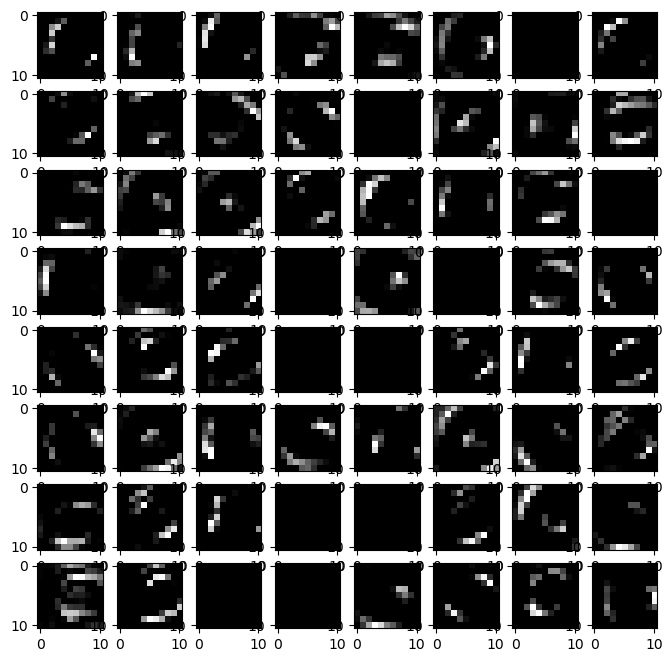

Feature maps of Pooling layer 2


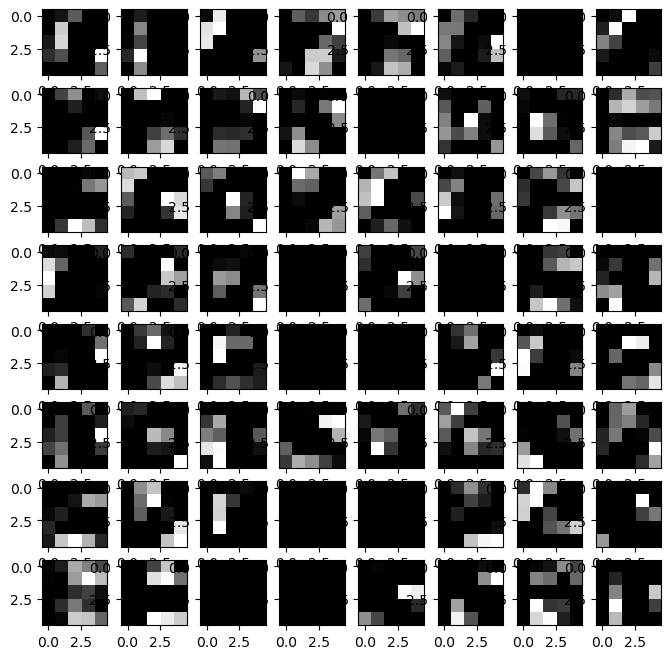

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


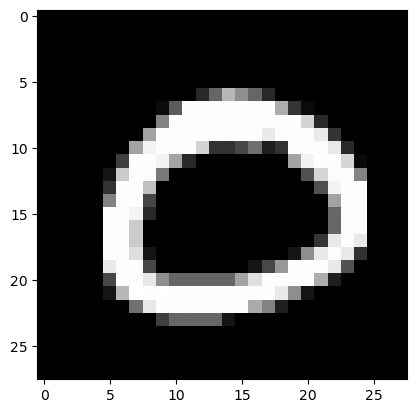

Feature maps of Convo layer 1


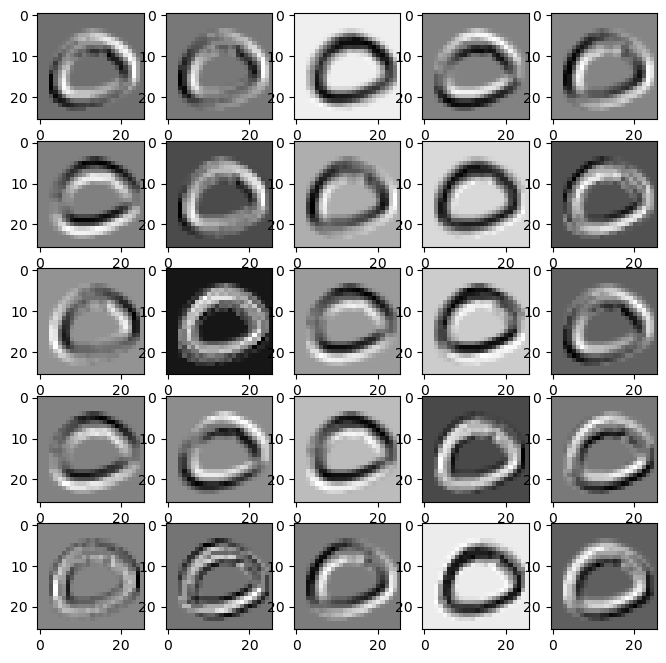

Feature maps of Activation layer 1


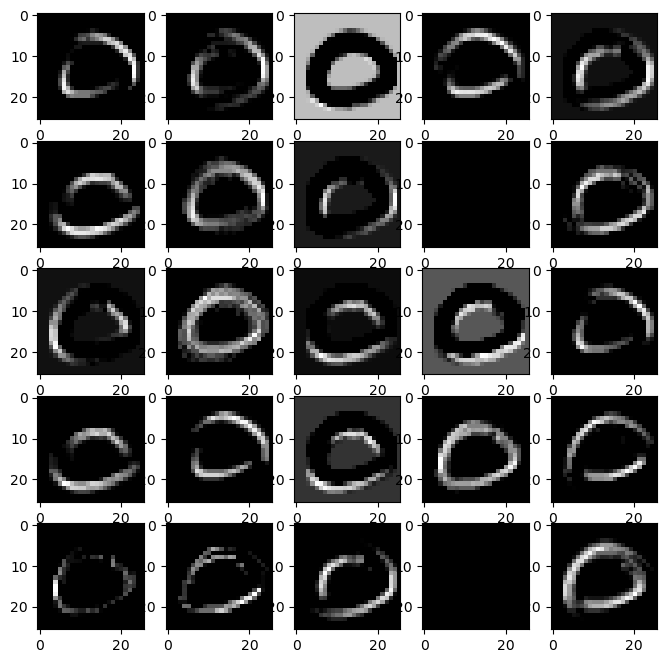

Feature maps of Pooling layer 1


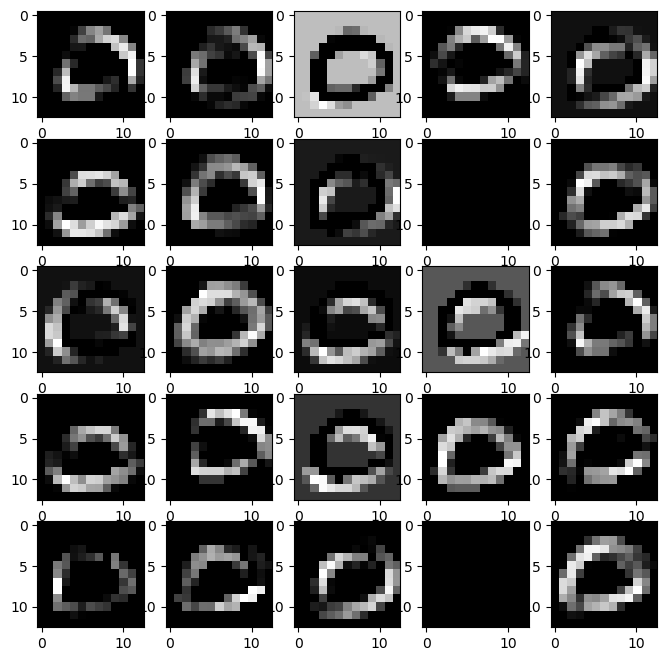

Feature maps of Convo layer 2


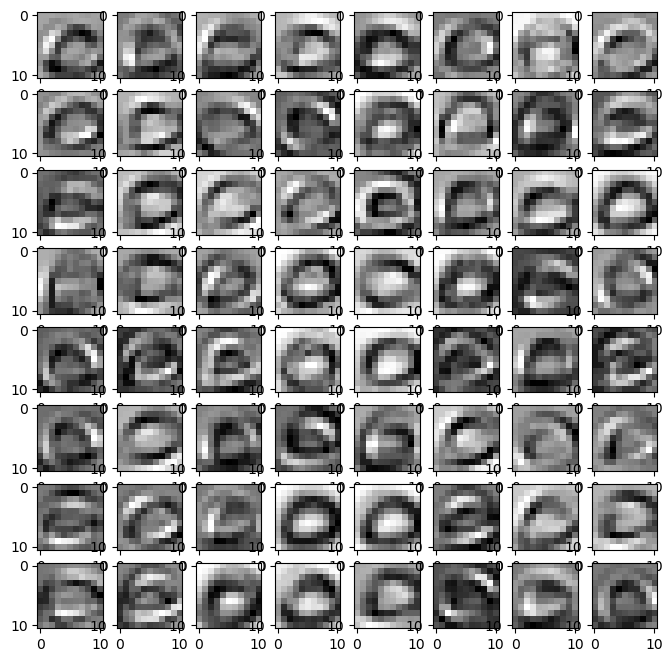

Feature maps of Activation layer 2


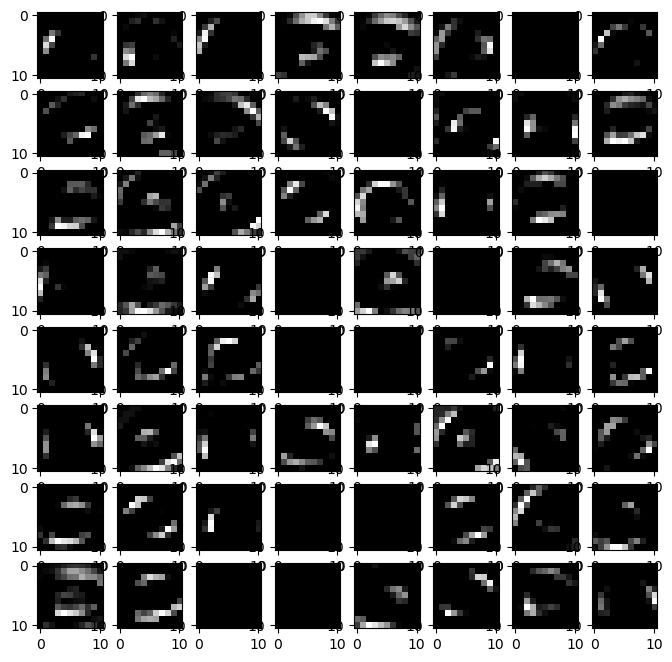

Feature maps of Pooling layer 2


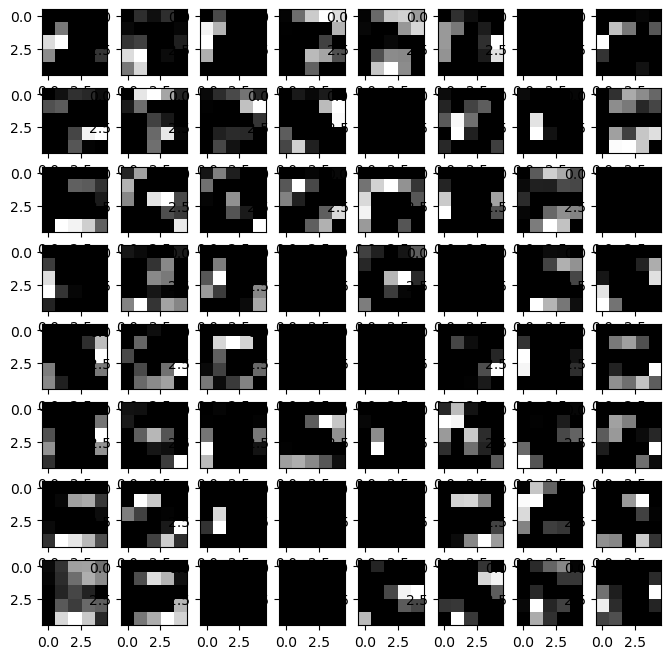

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


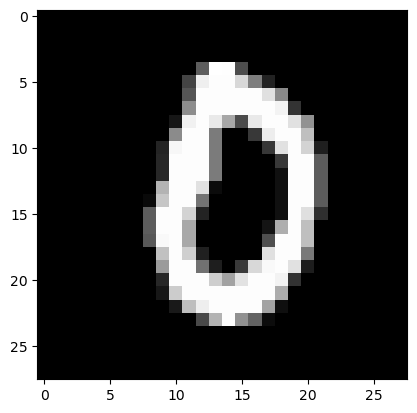

Feature maps of Convo layer 1


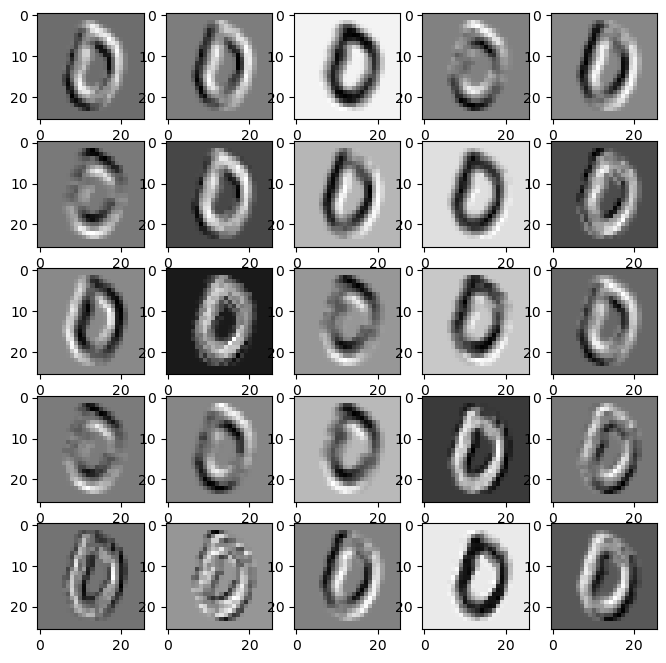

Feature maps of Activation layer 1


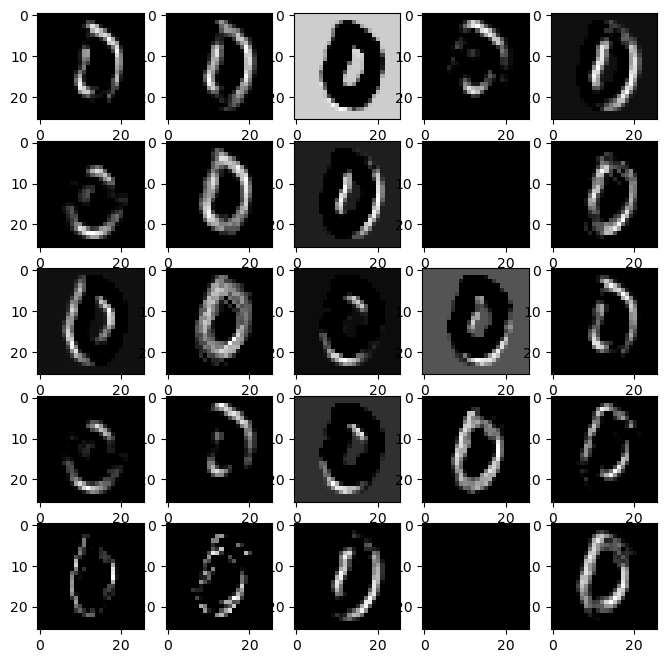

Feature maps of Pooling layer 1


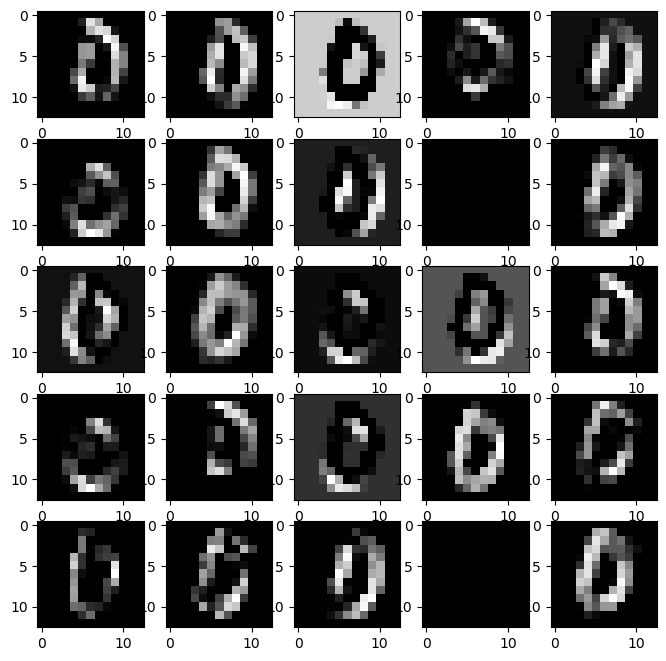

Feature maps of Convo layer 2


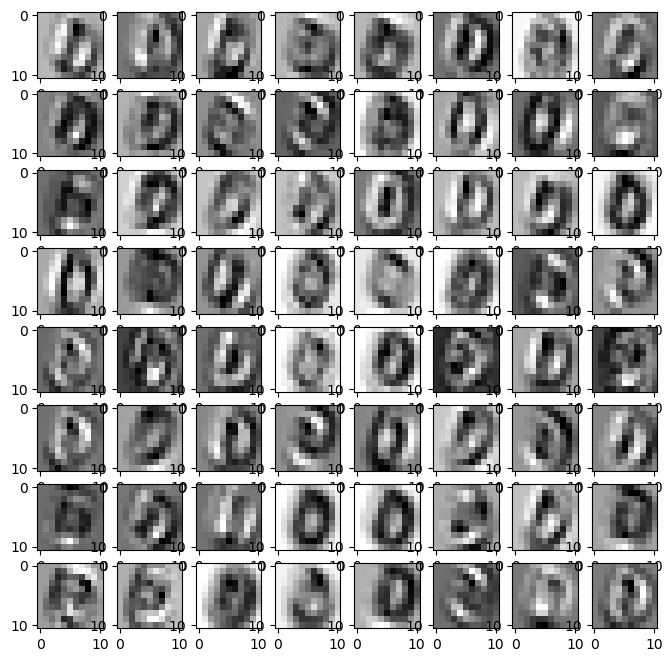

Feature maps of Activation layer 2


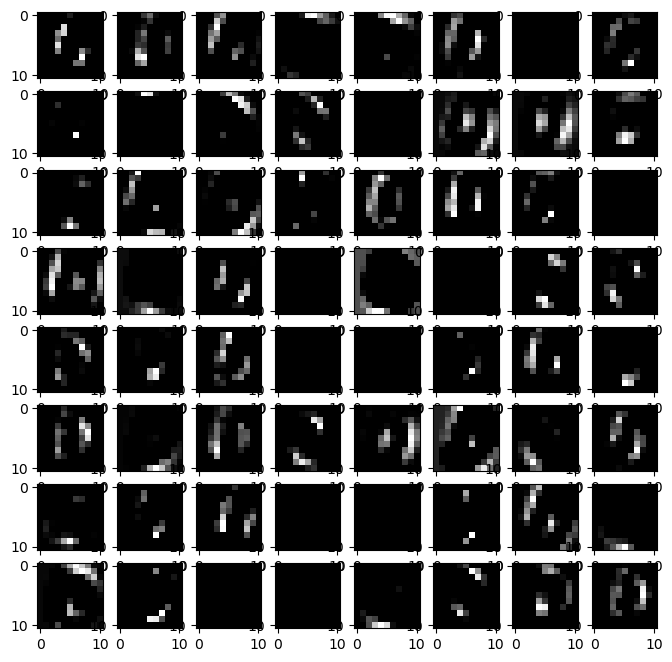

Feature maps of Pooling layer 2


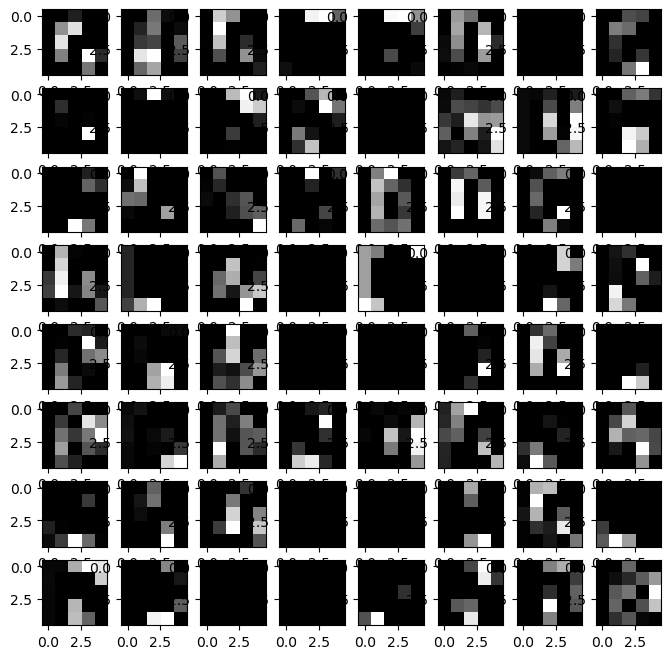

Predicted Class: 0, Actual Class: 0
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
torch.Size([1, 28, 28])
Original Image


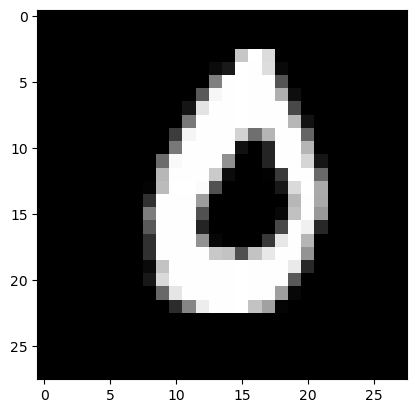

Feature maps of Convo layer 1


KeyboardInterrupt: 

In [14]:
for img, label in mnist_test:
    print(img.shape)
    if(label == 0):
        visualize_feature_maps(model, img, label)

# 4.3

In [17]:
wandb.login()

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: khushi1703 (smai-khushi). Use `wandb login --relogin` to force relogin


True

In [21]:
lrs = [0.001, 0.002]
batch_sizes = [64, 128]
kernel_sizes = [2,3]
epochs = [5,10]
dropouts = [0.0, 0.5]
wandb.init(project = "CNN MNIST")
for batch_size in batch_sizes:
    train_loader = DataLoader(train_dataset_mnist,batch_size = batch_size,shuffle = True)
    val_loader = DataLoader(val_dataset_mnist,batch_size = batch_size,shuffle = True)
#     test_loader = DataLoader(mnist_test,batch_size = batch_size,shuffle = True)
    for lr in lrs:
        for kernel_size in kernel_sizes:
            for dropout in dropouts:
                for epochs_ in epochs:
                    # Instantiate the model
                    model = CNN(1,28,dropout, 10, kernel_size, kernel_size)

                    # Define loss and optimizer
                    criterion = nn.CrossEntropyLoss()
                    optimizer = optim.Adam(model.parameters(), lr)

                    num_epochs = epochs_
                    train_losses = []
                    train_accuracies = []
                    val_losses = []
                    val_accuracies = []

                    for epoch in range(num_epochs):
                        # Training loop
                        model.train()
                        running_loss = 0.0
                        correct = 0
                        total = 0
                        loss = 0
                        loss_train = 0
                        idx = 0
                        for images, labels in train_loader:
                            optimizer.zero_grad()
                            outputs = model(images)
                            loss = criterion(outputs, labels)
                            loss.backward()
                            optimizer.step()
                            idx += 1

                            running_loss += loss.item()
                        
                        loss_train = running_loss / len(train_loader)
                        print(f'Epoch {epoch + 1}/{num_epochs}, Train Loss: {loss_train:.4f}')

                        # Validation
                        model.eval()
                        running_loss = 0.0
                        correct = 0
                        total = 0
                        loss = 0
                        loss_test = 0
                        idx = 0
                        accuracy = 0
                        val_acc = 0

                        with torch.no_grad():
                            for images, labels in val_loader:
                                outputs = model(images)
                                predicted = torch.argmax(outputs, dim = 1)
                                correct = torch.sum(torch.where(predicted == labels,1.0,0.0))
                                loss = criterion(outputs, labels)
                                running_loss += loss.item()
                                idx += 1
                                accuracy += correct / images.shape[0]
                        
                        loss_test = running_loss / len(val_loader)
                        val_acc = accuracy / len(val_loader)
                        print(f'Epoch {epoch + 1}/{num_epochs}, Val Loss: {loss_test:.4f}')
                        print(f'Epoch {epoch + 1}/{num_epochs}, Val Accuracy: {val_acc:.4f}')
                        wandb.log({
                            "Batch size": batch_size,
                            "learning_rate": lr,
                            "epochs": epochs_,
                            "Kernel Size": kernel_size,
                            "dropout": dropout,
                            "Training Loss": loss_train,
                            "Validation Loss": loss_test,
                            "Validation Accuracy": val_acc,
                        })
wandb.finish()

wandb: WARNING Source type is set to 'repo' but some required information is missing from the environment. A job will not be created from this run. See https://docs.wandb.ai/guides/launch/create-job


Kernel Size,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁████████████
Training Loss,▆▂▂▂▁▆▂▂▂▁▁▁▁▁█▃▃▂▂█▃▃▂▂▂▂▂▂▅▂▂▁▁▅▂▂▁▁▁▁
Validation Accuracy,▃▅▆▇▇▃▄▅▆▆▇▆▇▆▁▄▅▆▆▁▄▅▆▆▆▇▇▇▅▇██▇▄▆▇████
Validation Loss,▆▄▃▂▂▇▅▄▂▃▂▃▂▃█▅▄▃▃█▅▄▃▃▃▃▂▂▄▂▁▁▂▅▃▂▁▁▁▁
dropout,▁▁▁▁▁▁▁▁▁▁▁▁▁▁██████████████▁▁▁▁▁▁▁▁▁▁▁▁
epochs,▁▁▁▁▁█████████▁▁▁▁▁█████████▁▁▁▁▁███████
learning_rate,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
Kernel Size,3
Training Loss,0.01936
Validation Accuracy,0.98512
Validation Loss,0.05389


Epoch 1/5, Train Loss: 0.3116
Epoch 1/5, Val Loss: 0.1141
Epoch 1/5, Val Accuracy: 0.9659
Epoch 2/5, Train Loss: 0.0943
Epoch 2/5, Val Loss: 0.0882
Epoch 2/5, Val Accuracy: 0.9725
Epoch 3/5, Train Loss: 0.0695
Epoch 3/5, Val Loss: 0.0759
Epoch 3/5, Val Accuracy: 0.9773
Epoch 4/5, Train Loss: 0.0550
Epoch 4/5, Val Loss: 0.0688
Epoch 4/5, Val Accuracy: 0.9794
Epoch 5/5, Train Loss: 0.0455
Epoch 5/5, Val Loss: 0.0751
Epoch 5/5, Val Accuracy: 0.9769
Epoch 1/10, Train Loss: 0.3271
Epoch 1/10, Val Loss: 0.1200
Epoch 1/10, Val Accuracy: 0.9652
Epoch 2/10, Train Loss: 0.0912
Epoch 2/10, Val Loss: 0.0811
Epoch 2/10, Val Accuracy: 0.9754
Epoch 3/10, Train Loss: 0.0666
Epoch 3/10, Val Loss: 0.0736
Epoch 3/10, Val Accuracy: 0.9787
Epoch 4/10, Train Loss: 0.0529
Epoch 4/10, Val Loss: 0.0670
Epoch 4/10, Val Accuracy: 0.9802
Epoch 5/10, Train Loss: 0.0457
Epoch 5/10, Val Loss: 0.0678
Epoch 5/10, Val Accuracy: 0.9804
Epoch 6/10, Train Loss: 0.0377
Epoch 6/10, Val Loss: 0.0641
Epoch 6/10, Val Accuracy:

Epoch 10/10, Train Loss: 0.0527
Epoch 10/10, Val Loss: 0.0570
Epoch 10/10, Val Accuracy: 0.9842
Epoch 1/5, Train Loss: 0.1852
Epoch 1/5, Val Loss: 0.0720
Epoch 1/5, Val Accuracy: 0.9793
Epoch 2/5, Train Loss: 0.0565
Epoch 2/5, Val Loss: 0.0643
Epoch 2/5, Val Accuracy: 0.9804
Epoch 3/5, Train Loss: 0.0399
Epoch 3/5, Val Loss: 0.0555
Epoch 3/5, Val Accuracy: 0.9828
Epoch 4/5, Train Loss: 0.0303
Epoch 4/5, Val Loss: 0.0575
Epoch 4/5, Val Accuracy: 0.9832
Epoch 5/5, Train Loss: 0.0229
Epoch 5/5, Val Loss: 0.0494
Epoch 5/5, Val Accuracy: 0.9862
Epoch 1/10, Train Loss: 0.1934
Epoch 1/10, Val Loss: 0.0926
Epoch 1/10, Val Accuracy: 0.9731
Epoch 2/10, Train Loss: 0.0573
Epoch 2/10, Val Loss: 0.0700
Epoch 2/10, Val Accuracy: 0.9797
Epoch 3/10, Train Loss: 0.0403
Epoch 3/10, Val Loss: 0.0544
Epoch 3/10, Val Accuracy: 0.9835
Epoch 4/10, Train Loss: 0.0317
Epoch 4/10, Val Loss: 0.0486
Epoch 4/10, Val Accuracy: 0.9857
Epoch 5/10, Train Loss: 0.0247
Epoch 5/10, Val Loss: 0.0551
Epoch 5/10, Val Accura

Epoch 9/10, Train Loss: 0.0511
Epoch 9/10, Val Loss: 0.0508
Epoch 9/10, Val Accuracy: 0.9854
Epoch 10/10, Train Loss: 0.0444
Epoch 10/10, Val Loss: 0.0443
Epoch 10/10, Val Accuracy: 0.9879
Epoch 1/5, Train Loss: 0.2891
Epoch 1/5, Val Loss: 0.1026
Epoch 1/5, Val Accuracy: 0.9683
Epoch 2/5, Train Loss: 0.0812
Epoch 2/5, Val Loss: 0.0739
Epoch 2/5, Val Accuracy: 0.9788
Epoch 3/5, Train Loss: 0.0597
Epoch 3/5, Val Loss: 0.0663
Epoch 3/5, Val Accuracy: 0.9804
Epoch 4/5, Train Loss: 0.0465
Epoch 4/5, Val Loss: 0.0615
Epoch 4/5, Val Accuracy: 0.9818
Epoch 5/5, Train Loss: 0.0404
Epoch 5/5, Val Loss: 0.0605
Epoch 5/5, Val Accuracy: 0.9826
Epoch 1/10, Train Loss: 0.3343
Epoch 1/10, Val Loss: 0.1116
Epoch 1/10, Val Accuracy: 0.9657
Epoch 2/10, Train Loss: 0.0862
Epoch 2/10, Val Loss: 0.0891
Epoch 2/10, Val Accuracy: 0.9725
Epoch 3/10, Train Loss: 0.0631
Epoch 3/10, Val Loss: 0.0669
Epoch 3/10, Val Accuracy: 0.9797
Epoch 4/10, Train Loss: 0.0496
Epoch 4/10, Val Loss: 0.0690
Epoch 4/10, Val Accura

wandb: WARNING Source type is set to 'repo' but some required information is missing from the environment. A job will not be created from this run. See https://docs.wandb.ai/guides/launch/create-job


Batch size,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁████████████████████
Kernel Size,▁▁▁▁▁█████▁▁▁▁▁█████▁▁▁▁▁█████▁▁▁▁▁█████
Training Loss,▂▂▁▂▂▂▂▁▂▂▂▂▁▂▂▂▁▁▂▂▂▂█▃▂▂▁▆▃▂▁▁▆▃▂▁▁▅▂▁
Validation Accuracy,▅▆▇▆▆▆▇█▇█▅▇▇▇▇▇▇███▇▆▁▃▇▇▇▄▆█▇▇▃▅▇▇█▅▆█
Validation Loss,▃▃▂▂▃▂▂▁▁▁▃▂▂▂▂▂▂▂▁▁▂▃█▅▂▂▂▅▃▁▂▂▆▃▂▂▁▄▂▁
dropout,▁▁▁██▁▁▁██▁▁▁██▁▁▁██▁▁███▁▁███▁▁███▁▁███
epochs,▁██▁█▁██▁█▁██▁█▁██▁█▁█▁██▁█▁██▁█▁██▁█▁██
learning_rate,▁▁▁▁▁▁▁▁▁▁██████████▁▁▁▁▁▁▁▁▁▁██████████
Batch size,128
Kernel Size,3
Training Loss,0.04644


The dropout doent effect the model severly since the model is also generalising well even without dropout layer. However adding dropout is still better since some form of regularisation is always preferred and improves the overall performance and reliability of the model

# 4.4
Best model = lr = 0.002, epochs = 10, batch_size = 64, kernel = 3

In [23]:
train_loader = DataLoader(train_dataset_mnist,batch_size = 64,shuffle = True)
val_loader = DataLoader(val_dataset_mnist,batch_size = 64,shuffle = True)
test_loader = DataLoader(mnist_test,batch_size = 64,shuffle = True)

In [30]:
# Instantiate the model
model = CNN(1,28,dropout, 10, 3, 3)

# Define loss and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = 0.002)

num_epochs = 10
train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []

for epoch in range(num_epochs):
    # Training loop
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    loss = 0
    loss_train = 0
    idx = 0
    for images, labels in train_loader:
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        idx += 1

        running_loss += loss.item()

    loss_train = running_loss / len(train_loader)
    print(f'Epoch {epoch + 1}/{num_epochs}, Train Loss: {loss_train:.4f}')

# Validation
model.eval()
running_loss = 0.0
correct = 0
total = 0
loss = 0
loss_val = 0
idx = 0
accuracy = 0
val_acc = 0

with torch.no_grad():
    for images, labels in val_loader:
        outputs = model(images)
        predicted = torch.argmax(outputs, dim = 1)
        correct = torch.sum(torch.where(predicted == labels,1.0,0.0))
        loss = criterion(outputs, labels)
        running_loss += loss.item()
        idx += 1
        accuracy += correct / images.shape[0]

loss_val = running_loss / len(val_loader)
val_acc = accuracy / len(val_loader)
print(f'Val Loss: {loss_val:.4f}')
print(f'Val Accuracy: {val_acc:.4f}')


# Testing
model.eval()
running_loss = 0.0
correct = 0
total = 0
loss = 0
loss_test = 0
idx = 0
accuracy = 0
test_acc = 0
with torch.no_grad():
    for images, labels in test_loader:
        outputs = model(images)
        predicted = torch.argmax(outputs, dim = 1)
        correct = torch.sum(torch.where(predicted == labels,1.0,0.0))
        loss = criterion(outputs, labels)
        running_loss += loss.item()
        idx += 1
        accuracy += correct / images.shape[0]

loss_test = running_loss / len(test_loader)
test_acc = accuracy / len(test_loader)
print(f'Test Loss: {loss_test:.4f}')
print(f'Test Accuracy: {test_acc:.4f}')
# print(f"Test report")


Epoch 1/10, Train Loss: 0.2436
Epoch 2/10, Train Loss: 0.0933
Epoch 3/10, Train Loss: 0.0720
Epoch 4/10, Train Loss: 0.0613
Epoch 5/10, Train Loss: 0.0542
Epoch 6/10, Train Loss: 0.0489
Epoch 7/10, Train Loss: 0.0464
Epoch 8/10, Train Loss: 0.0429
Epoch 9/10, Train Loss: 0.0399
Epoch 10/10, Train Loss: 0.0382
Val Loss: 0.0396
Val Accuracy: 0.9887
Test Loss: 0.0295
Test Accuracy: 0.9904


In [34]:
print(classification_report(labels,predicted,zero_division=0))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         4
           1       1.00      1.00      1.00         3
           2       1.00      1.00      1.00         1
           3       1.00      1.00      1.00         1
           4       1.00      1.00      1.00         1
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         1
           9       1.00      1.00      1.00         1

    accuracy                           1.00        16
   macro avg       1.00      1.00      1.00        16
weighted avg       1.00      1.00      1.00        16



In [36]:
print(confusion_matrix(labels,predicted))

[[4 0 0 0 0 0 0 0 0]
 [0 3 0 0 0 0 0 0 0]
 [0 0 1 0 0 0 0 0 0]
 [0 0 0 1 0 0 0 0 0]
 [0 0 0 0 1 0 0 0 0]
 [0 0 0 0 0 2 0 0 0]
 [0 0 0 0 0 0 2 0 0]
 [0 0 0 0 0 0 0 1 0]
 [0 0 0 0 0 0 0 0 1]]


# 4.5

In [47]:
from scipy.io import loadmat
from torch.utils.data import Dataset

In [48]:
mat_data = loadmat('Data/mnist-with-awgn.mat')
class CustomImageDataset(Dataset):
    def __init__(self,train = 0):
        if(train == 1):
            self.x = mat_data['train_x']
            self.y = mat_data['train_y']
        else:
            self.x = mat_data['test_x']
            self.y = mat_data['test_y']
    
    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        return torch.tensor(self.x[idx].reshape(1,28,28),dtype = torch.float)/255, torch.tensor(np.argmax(self.y[idx]))

class mnistNoised(Dataset):
    def __init__(self):
        self.x = train_dataset_mnist
    
    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        image = self.x[idx][0]
        awgn = torch.normal(0.0, 0.3, image.shape)
        return image, torch.clamp(image + awgn, 0.0, 1.0)

In [49]:
mnist_noisy_train = CustomImageDataset(train = 1)
mnist_noisy_test = CustomImageDataset(train = 0)

In [50]:
mnist_noised = mnistNoised()

In [51]:
train_dataset_, val_dataset_ = random_split(mnist_noisy_train, [len(mnist_noisy_train) - 20000, 20000])
train_loader_noisy = DataLoader(train_dataset_,batch_size = 64,shuffle = True)
val_loader_noisy = DataLoader(val_dataset_,batch_size = 64,shuffle = True)
test_loader_noisy = DataLoader(mnist_noisy_test,batch_size = 64,shuffle = True)

In [43]:
# Instantiate the model
model = CNN(1,28, 0.5, 10, 3, 3)

# Define loss and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.002)

num_epochs = 10
train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []

for epoch in range(num_epochs):
    # Training loop
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    loss = 0
    idx = 0
    for images, labels in train_loader_noisy:
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
#         print(f'Epoch {epoch + 1}/{num_epochs},batch [{idx+1}] Train Loss: {loss:.4f}')
        loss.backward()
        optimizer.step()
        idx += 1

        running_loss += loss.item()
        
    print(f'Epoch {epoch + 1}/{num_epochs}, Train Loss: {loss:.4f}')

    # Validation
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    loss = 0
    idx = 0
    accuracy = 0

    with torch.no_grad():
        for images, labels in val_loader_noisy:
            outputs = model(images)
            predicted = torch.argmax(outputs, dim = 1)
            correct = torch.sum(torch.where(predicted == labels,1.0,0.0))
            loss = criterion(outputs, labels)
            idx += 1
            accuracy += correct / images.shape[0]
    print(f'Epoch {epoch + 1}/{num_epochs}, Val Loss: {loss:.4f}')
    print(f'Epoch {epoch + 1}/{num_epochs}, Val accuracy: {accuracy / len(val_loader_noisy):.4f}')

Epoch 1/10, Train Loss: 0.1048
Epoch 1/10, Val Loss: 0.3322
Epoch 1/10, Val accuracy: 0.9544
Epoch 2/10, Train Loss: 0.1331
Epoch 2/10, Val Loss: 0.3855
Epoch 2/10, Val accuracy: 0.9660
Epoch 3/10, Train Loss: 0.0220
Epoch 3/10, Val Loss: 0.0674
Epoch 3/10, Val accuracy: 0.9698
Epoch 4/10, Train Loss: 0.1218
Epoch 4/10, Val Loss: 0.0718
Epoch 4/10, Val accuracy: 0.9722
Epoch 5/10, Train Loss: 0.1966
Epoch 5/10, Val Loss: 0.0675
Epoch 5/10, Val accuracy: 0.9729
Epoch 6/10, Train Loss: 0.0623
Epoch 6/10, Val Loss: 0.0370
Epoch 6/10, Val accuracy: 0.9752
Epoch 7/10, Train Loss: 0.0881
Epoch 7/10, Val Loss: 0.0038
Epoch 7/10, Val accuracy: 0.9764
Epoch 8/10, Train Loss: 0.3922
Epoch 8/10, Val Loss: 0.0408
Epoch 8/10, Val accuracy: 0.9756
Epoch 9/10, Train Loss: 0.3607
Epoch 9/10, Val Loss: 0.0866
Epoch 9/10, Val accuracy: 0.9751
Epoch 10/10, Train Loss: 0.0910
Epoch 10/10, Val Loss: 0.0452
Epoch 10/10, Val accuracy: 0.9761


In [54]:
# visualize_feature_maps(model,val_dataset[0][0],val_dataset[0][1])

# 4.6

In [52]:
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 16, kernel_size=3),
            nn.ReLU()
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(16, 1, kernel_size=3),
            nn.ReLU()
        )
        self.bottleneck_dims = []
        

    def forward(self, x):
        x = self.encoder(x)
        self.bottleneck_dims = x.shape[1:]
        x = self.decoder(x)
        return x
    
    def bottleneck(self,x):
        x = self.encoder(x)
        return x


In [53]:
autoencoder_train = DataLoader(mnist_noised,batch_size = 64,shuffle = True)

In [54]:
autoencoder = Autoencoder()
criterion = nn.MSELoss()
optimizer = optim.Adam(autoencoder.parameters(), lr=0.001)

# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    for img, noised_img in autoencoder_train:
        optimizer.zero_grad()
        output = autoencoder(noised_img)
        loss = criterion(output, img)
        loss.backward()
        optimizer.step()
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item()}')


Epoch [1/10], Loss: 0.006956829689443111
Epoch [2/10], Loss: 0.006494252011179924
Epoch [3/10], Loss: 0.005922028794884682
Epoch [4/10], Loss: 0.005625457968562841
Epoch [5/10], Loss: 0.006134202238172293
Epoch [6/10], Loss: 0.005533326417207718
Epoch [7/10], Loss: 0.005841610953211784
Epoch [8/10], Loss: 0.005936398636549711
Epoch [9/10], Loss: 0.005685837473720312
Epoch [10/10], Loss: 0.0057097794488072395


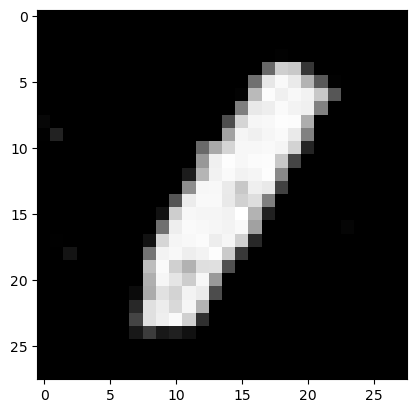

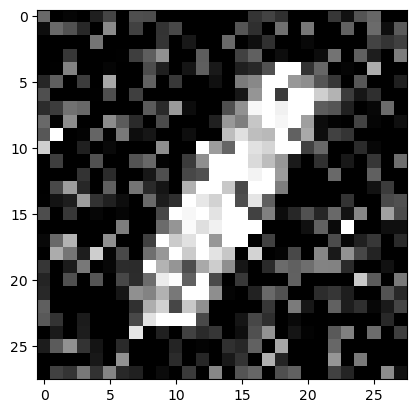

In [55]:
image = val_dataset_[0][0]
with torch.no_grad():
    output = autoencoder(image)
    plt.imshow(output[0],cmap = 'gray')
    plt.show()
    plt.imshow(image[0],cmap = 'gray')
    plt.show()

In [56]:
# Instantiate the model
model = CNN(1,28, 0.5, 10, 3, 3)

# Define loss and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.002)

num_epochs = 10
train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []

for epoch in range(num_epochs):
    # Training loop
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    loss = 0
    idx = 0
    for images, labels in train_loader_noisy:
        with torch.no_grad():
            denoised = autoencoder(images)
        optimizer.zero_grad()
        outputs = model(denoised)
        loss = criterion(outputs, labels)
#         print(f'Epoch {epoch + 1}/{num_epochs},batch [{idx+1}] Train Loss: {loss:.4f}')
        loss.backward()
        optimizer.step()
        idx += 1

        running_loss += loss.item()
        
    print(f'Epoch {epoch + 1}/{num_epochs}, Train Loss: {loss:.4f}')

    # Validation
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    loss = 0
    idx = 0
    accuracy = 0

    with torch.no_grad():
        for images, labels in val_loader:
            denoised = autoencoder(images)
            outputs = model(denoised)
            predicted = torch.argmax(outputs, dim = 1)
            correct = torch.sum(torch.where(predicted == labels,1.0,0.0))
            loss = criterion(outputs, labels)
            idx += 1
            accuracy += correct / images.shape[0]
    print(f'Epoch {epoch + 1}/{num_epochs}, Val Loss: {loss:.4f}')
    print(f'Epoch {epoch + 1}/{num_epochs}, Val accuracy: {accuracy / len(val_loader):.4f}')


Epoch 1/10, Train Loss: 0.1922
Epoch 1/10, Val Loss: 0.0522
Epoch 1/10, Val accuracy: 0.9715
Epoch 2/10, Train Loss: 0.1237
Epoch 2/10, Val Loss: 0.0290
Epoch 2/10, Val accuracy: 0.9810
Epoch 3/10, Train Loss: 0.0499
Epoch 3/10, Val Loss: 0.0035
Epoch 3/10, Val accuracy: 0.9808
Epoch 4/10, Train Loss: 0.2205
Epoch 4/10, Val Loss: 0.0376
Epoch 4/10, Val accuracy: 0.9855
Epoch 5/10, Train Loss: 0.0717
Epoch 5/10, Val Loss: 0.0163
Epoch 5/10, Val accuracy: 0.9859
Epoch 6/10, Train Loss: 0.0377
Epoch 6/10, Val Loss: 0.0230
Epoch 6/10, Val accuracy: 0.9881
Epoch 7/10, Train Loss: 0.0583
Epoch 7/10, Val Loss: 0.0071
Epoch 7/10, Val accuracy: 0.9870
Epoch 8/10, Train Loss: 0.1882
Epoch 8/10, Val Loss: 0.0007
Epoch 8/10, Val accuracy: 0.9898
Epoch 9/10, Train Loss: 0.0368
Epoch 9/10, Val Loss: 0.0015
Epoch 9/10, Val accuracy: 0.9897
Epoch 10/10, Train Loss: 0.0184
Epoch 10/10, Val Loss: 0.0005
Epoch 10/10, Val accuracy: 0.9901


In [57]:
# Testing
model.eval()
running_loss = 0.0
correct = 0
total = 0
loss = 0
idx = 0
accuracy = 0

with torch.no_grad():
    for images, labels in test_loader:
        denoised = autoencoder(images)
        outputs = model(denoised)
        predicted = torch.argmax(outputs, dim = 1)
        correct = torch.sum(torch.where(predicted == labels,1.0,0.0))
        loss = criterion(outputs, labels)
        idx += 1
        accuracy += correct / images.shape[0]
print(f'test Loss: {loss:.4f}')
print(f'test accuracy: {accuracy / len(test_loader):.4f}')


test Loss: 0.0018
test accuracy: 0.9879


As the results are evident, without autoencoder the model wa giving accuracy of about 96-97 %, after denoising the images with autoencoder and then running the model ,the accuracy jumped to about 98.5 - 99 %.

In [58]:
print(classification_report(labels,predicted,zero_division=0))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         1
           1       1.00      1.00      1.00         1
           2       1.00      1.00      1.00         2
           3       1.00      1.00      1.00         1
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         2
           6       1.00      1.00      1.00         2
           7       1.00      1.00      1.00         2
           9       1.00      1.00      1.00         2

    accuracy                           1.00        16
   macro avg       1.00      1.00      1.00        16
weighted avg       1.00      1.00      1.00        16

